In [2]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt


In [3]:
# visualization function
def show(tensor, ch=1, size=(28,28), num=16):
    # tensor : 128(:batch)x768(:28x28)
    data = tensor.detach().cpu().view(-1,ch,*size) # 128x1x28x28 (batchxchxheightxwidth)
    grid = make_grid(data[:num], nrow=4).permute(1,2,0) # 16x1x28x28 = 28x28x1
    plt.imshow(grid)  
    plt.show()

In [4]:
# setup parmeters/hyperparameters
epochs = 300
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 1e-5
loss_func = nn.BCEWithLogitsLoss() # numerically more stable

bs = 128
device = 'cuda'

dataloader = DataLoader(MNIST('.', download=True, transform = transforms.ToTensor()), shuffle=True, batch_size=bs)

# number of steps = 60000 / 128 = 468.75

In [5]:
# Declare models

# Generator
# 1
def genBlock(inp, out):
    return nn.Sequential(
        nn.Linear(inp, out),
        nn.BatchNorm1d(out),
        nn.ReLU(inplace=True)
    )
   
# 2    
class Generator(nn.Module):
    def __init__(self, z_dim=64, i_dim=784, h_dim=128):
        super().__init__()
        self.gen = nn.Sequential(
            genBlock(z_dim, h_dim),
            genBlock(h_dim,h_dim*2),
            genBlock(h_dim*2, h_dim*4),
            genBlock(h_dim*4, h_dim*8),
            nn.Linear(h_dim*8, i_dim),
            nn.Sigmoid(),
        )
        
    def forward(self, noise):
        return self.gen(noise)

# 3    
def gen_noise(number, z_dim):
    return torch.randn(number, z_dim).to(device)

# 4
# Discriminator
def disBlock(inp, out):
    return nn.Sequential(
        nn.Linear(inp, out),
        nn.LeakyReLU(0.2)
    )

# 5    
class Discriminator(nn.Module):
    def __init__(self, i_dim=784, h_dim=256):
        super().__init__()
        self.disc = nn.Sequential(
            disBlock(i_dim, h_dim*4),
            disBlock(h_dim*4, h_dim*2),
            disBlock(h_dim*2, h_dim),
            nn.Linear(h_dim,1)
        )
        
    def forward(self, image):
        return self.disc(image)

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)

disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [7]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [8]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [9]:
x,y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([0, 4, 8, 0, 6, 4, 8, 2, 9, 3])


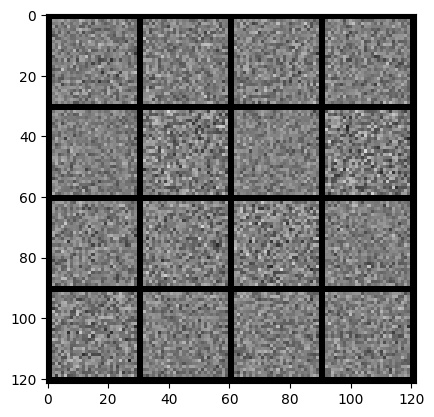

In [10]:
noise = gen_noise(bs,z_dim)
fake = gen(noise)
show(fake) # initial noise output of Generator

In [11]:
# calculating the loss

# generator loss
def calc_gen_loss(loss_func, gen, disc, number, z_dim):
   noise = gen_noise(number, z_dim)
   fake = gen(noise)
   pred = disc(fake)
   targets=torch.ones_like(pred)
   gen_loss=loss_func(pred,targets)

   return gen_loss


def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
   noise = gen_noise(number, z_dim)
   fake = gen(noise)
   disc_fake = disc(fake.detach())
   disc_fake_targets=torch.zeros_like(disc_fake)
   disc_fake_loss=loss_func(disc_fake, disc_fake_targets)

   disc_real = disc(real)
   disc_real_targets=torch.ones_like(disc_real)
   disc_real_loss=loss_func(disc_real, disc_real_targets)

   disc_loss=(disc_fake_loss+disc_real_loss)/2

   return disc_loss

  0%|          | 0/469 [00:00<?, ?it/s]

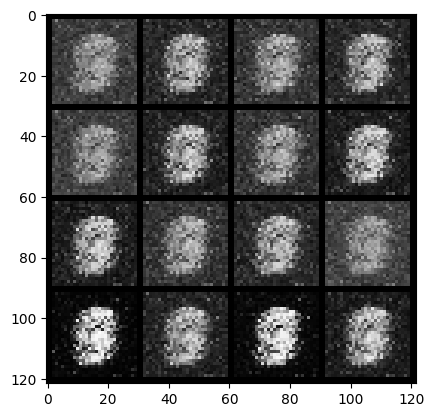

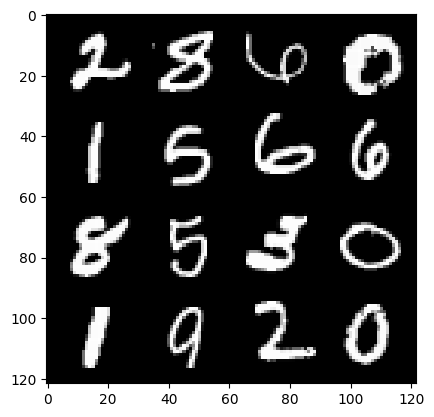

0:step 300 / Gen loss: 1.978306153217952 / Disc loss: 0.33175906342764716


  0%|          | 0/469 [00:00<?, ?it/s]

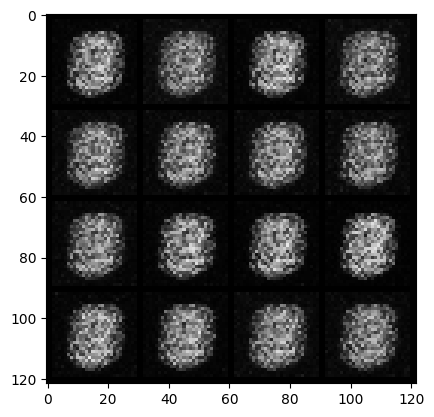

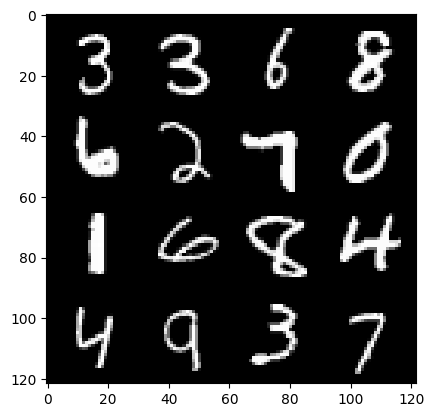

1:step 600 / Gen loss: 3.5139790956179304 / Disc loss: 0.11322760889927545


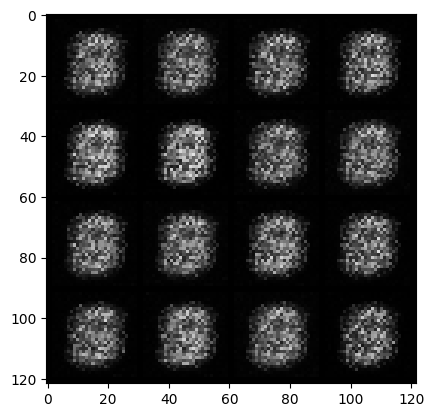

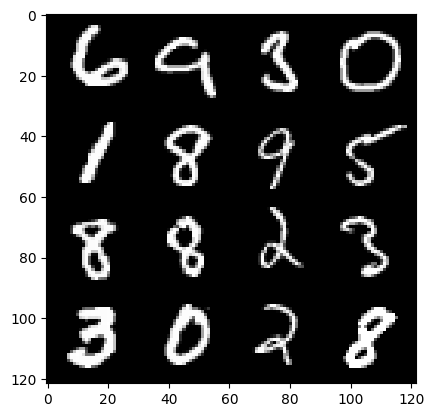

1:step 900 / Gen loss: 3.439491616884868 / Disc loss: 0.05640732722977796


  0%|          | 0/469 [00:00<?, ?it/s]

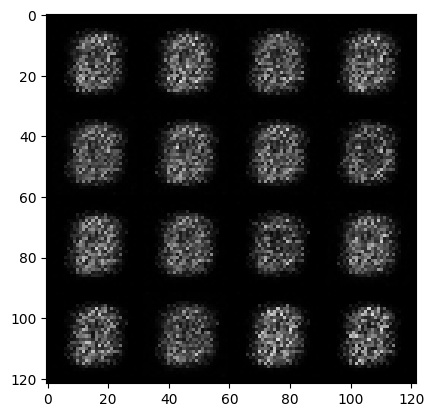

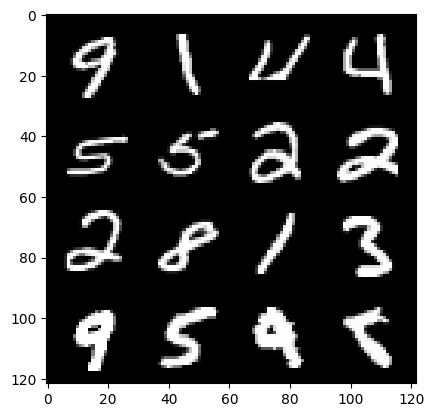

2:step 1200 / Gen loss: 3.446363358497621 / Disc loss: 0.040037136779477164


  0%|          | 0/469 [00:00<?, ?it/s]

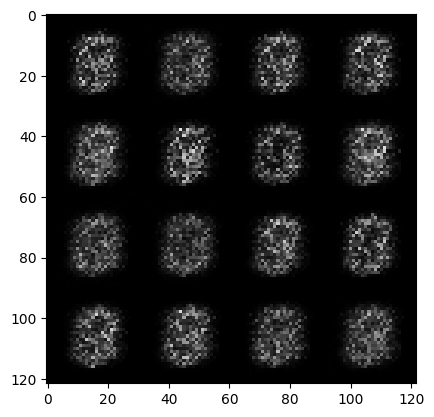

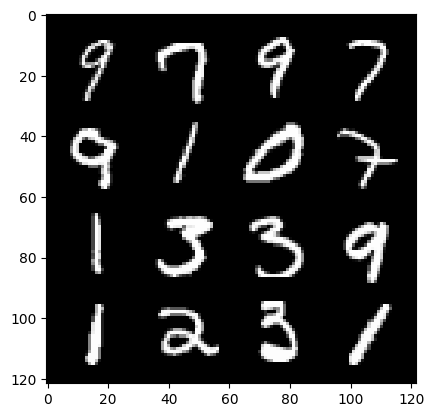

3:step 1500 / Gen loss: 3.369335983594259 / Disc loss: 0.04428355089699229


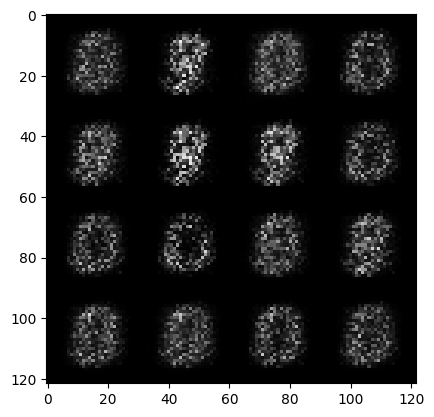

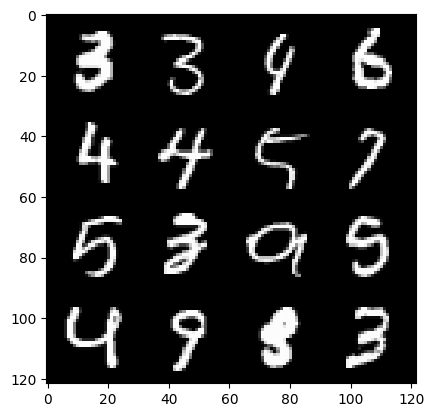

3:step 1800 / Gen loss: 3.4492468786239643 / Disc loss: 0.04395518353829782


  0%|          | 0/469 [00:00<?, ?it/s]

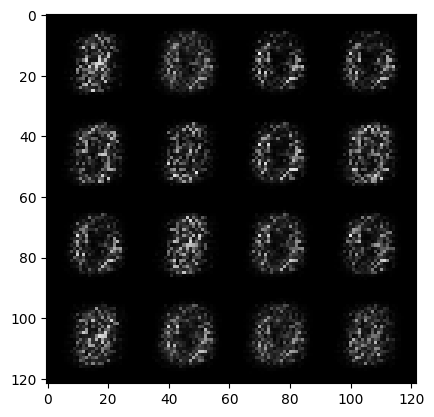

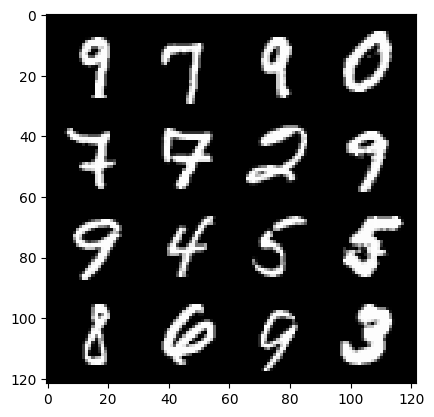

4:step 2100 / Gen loss: 3.791214525699617 / Disc loss: 0.0365029656390349


  0%|          | 0/469 [00:00<?, ?it/s]

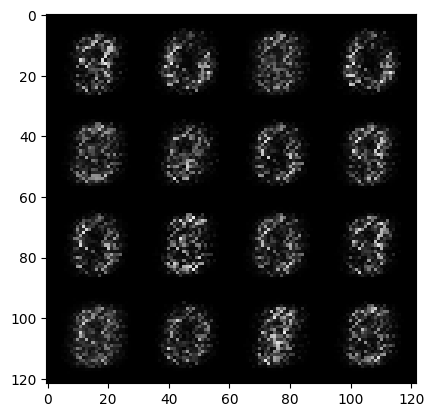

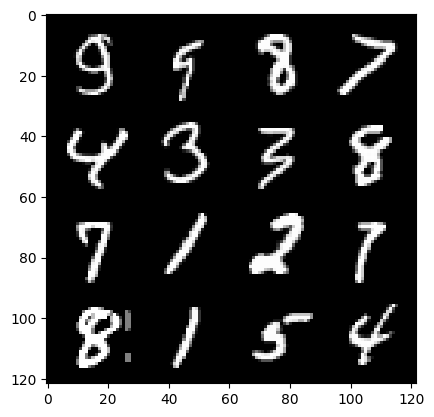

5:step 2400 / Gen loss: 4.134826700687408 / Disc loss: 0.027798709996665505


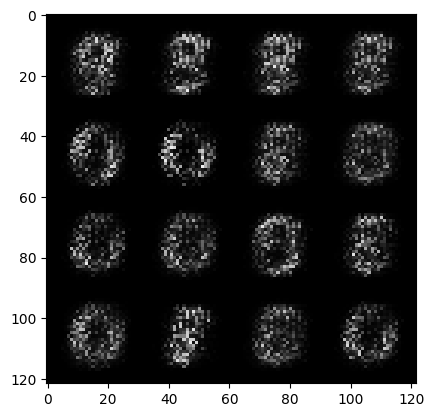

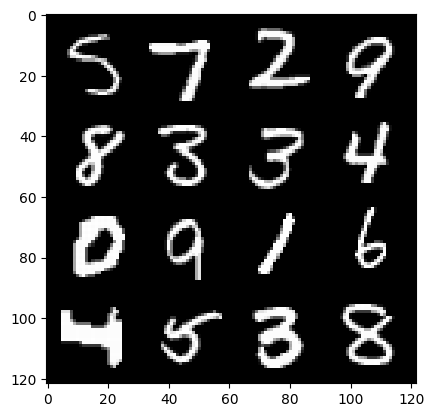

5:step 2700 / Gen loss: 4.47136703650157 / Disc loss: 0.024540848471224286


  0%|          | 0/469 [00:00<?, ?it/s]

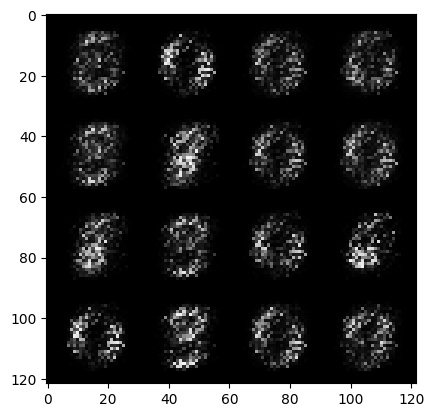

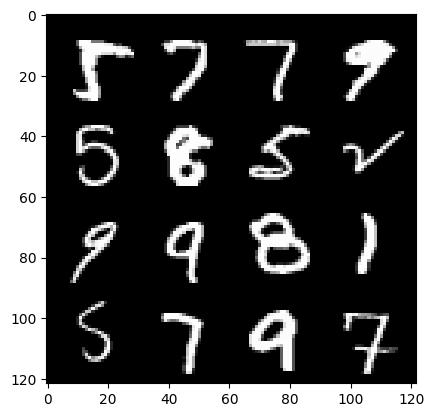

6:step 3000 / Gen loss: 4.874816176096598 / Disc loss: 0.02235810278604428


  0%|          | 0/469 [00:00<?, ?it/s]

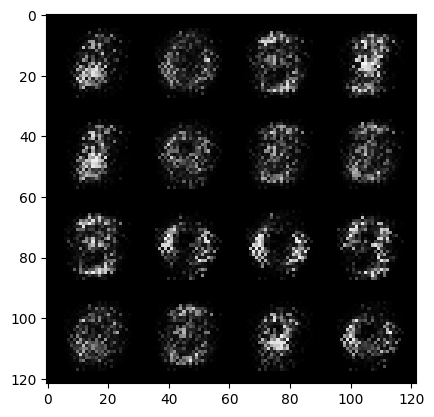

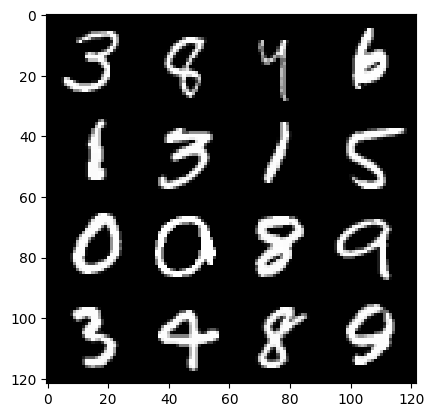

7:step 3300 / Gen loss: 5.151804310480748 / Disc loss: 0.021040598700443905


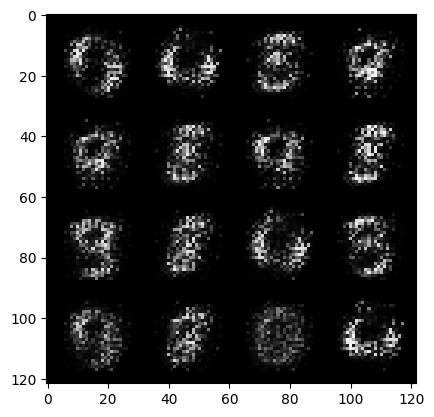

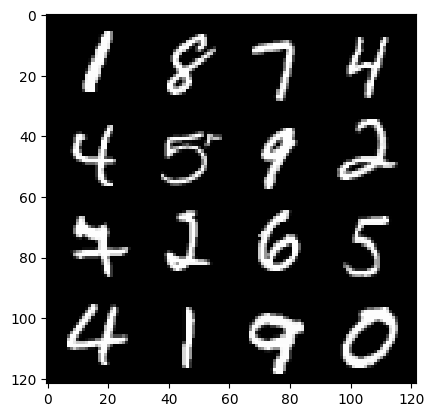

7:step 3600 / Gen loss: 5.239496555328368 / Disc loss: 0.022019893589119124


  0%|          | 0/469 [00:00<?, ?it/s]

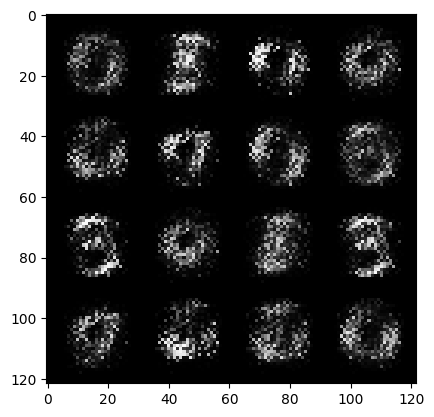

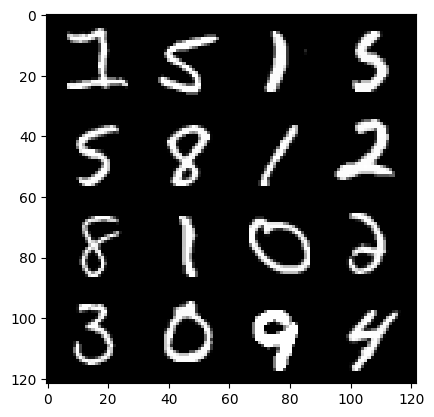

8:step 3900 / Gen loss: 5.436453520456951 / Disc loss: 0.017571670608595005


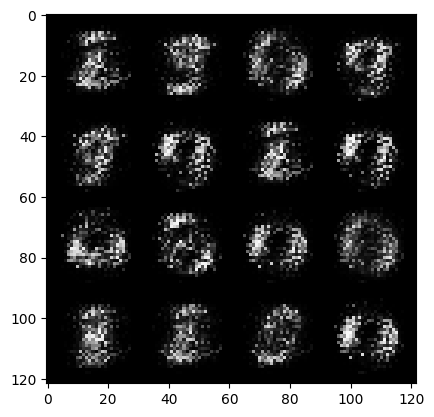

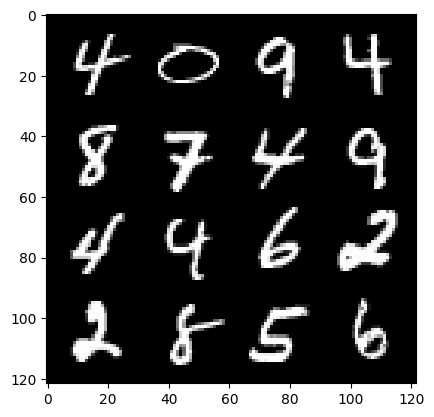

8:step 4200 / Gen loss: 5.993726646105448 / Disc loss: 0.014758570628861583


  0%|          | 0/469 [00:00<?, ?it/s]

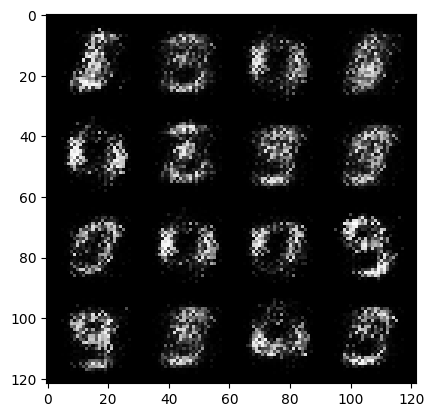

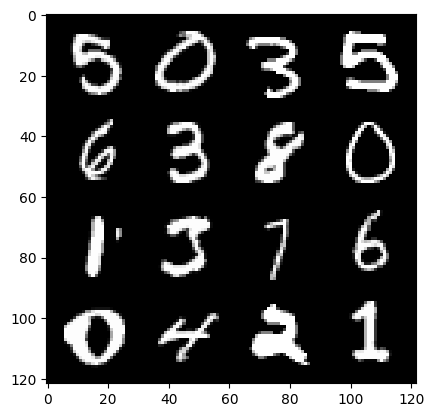

9:step 4500 / Gen loss: 6.137567311922709 / Disc loss: 0.01617005942699809


  0%|          | 0/469 [00:00<?, ?it/s]

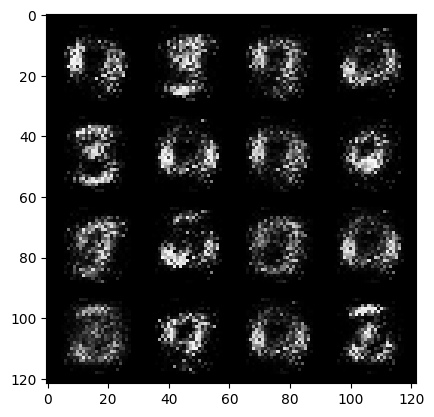

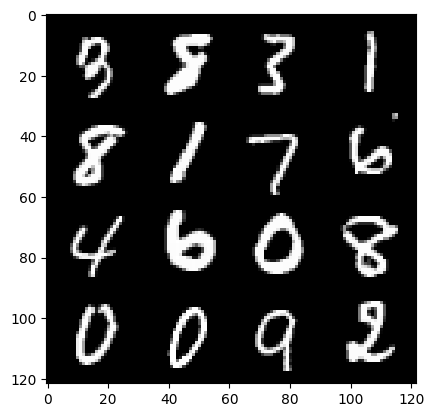

10:step 4800 / Gen loss: 6.152197658220927 / Disc loss: 0.0161883253014336


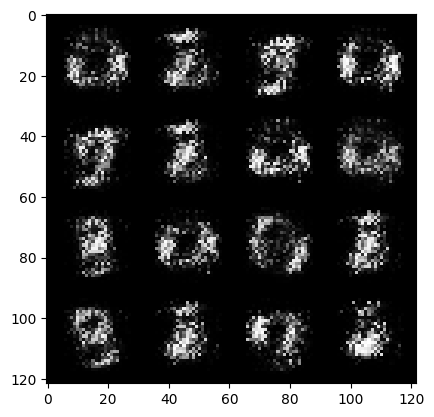

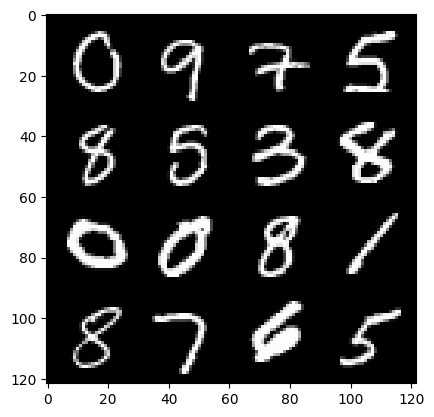

10:step 5100 / Gen loss: 6.172964045206707 / Disc loss: 0.014661039041044818


  0%|          | 0/469 [00:00<?, ?it/s]

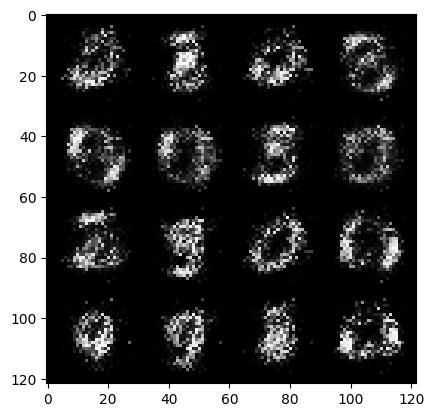

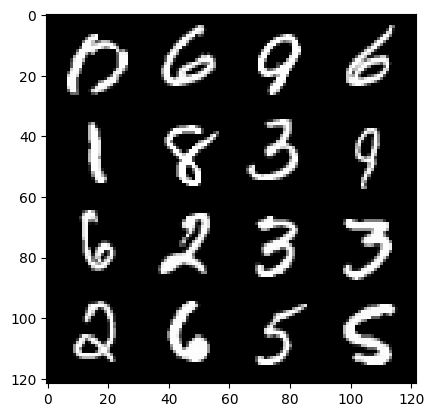

11:step 5400 / Gen loss: 6.368449832598372 / Disc loss: 0.013070942515817786


  0%|          | 0/469 [00:00<?, ?it/s]

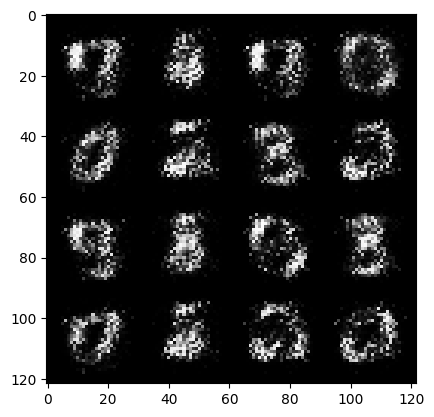

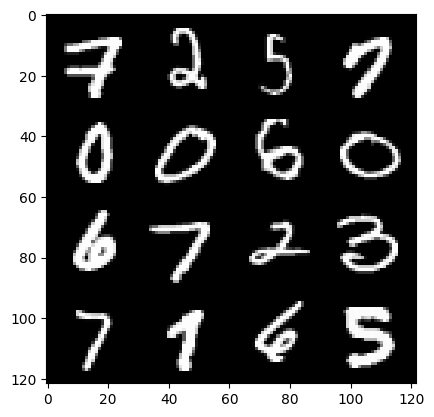

12:step 5700 / Gen loss: 6.404758224487308 / Disc loss: 0.011585872592404494


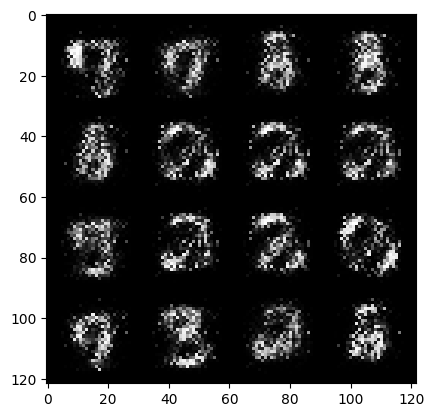

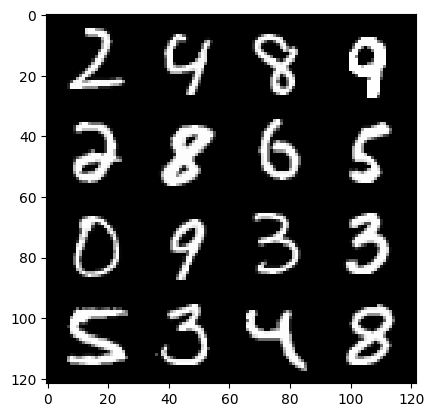

12:step 6000 / Gen loss: 6.472918400764467 / Disc loss: 0.009503264006537693


  0%|          | 0/469 [00:00<?, ?it/s]

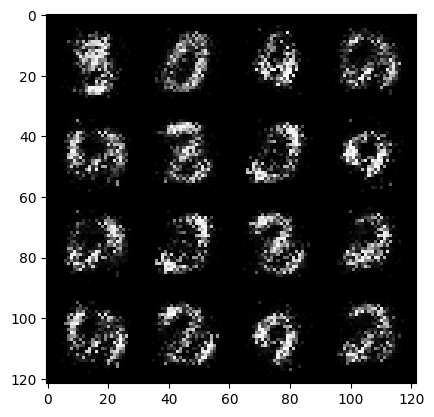

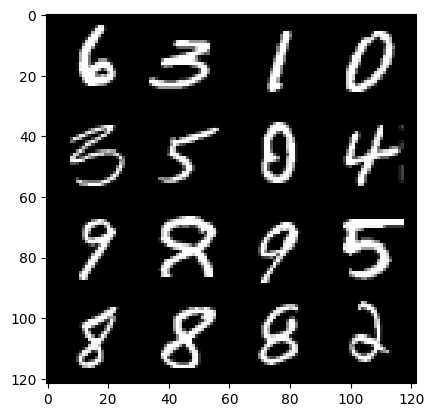

13:step 6300 / Gen loss: 6.718677061398823 / Disc loss: 0.010519471099444979


  0%|          | 0/469 [00:00<?, ?it/s]

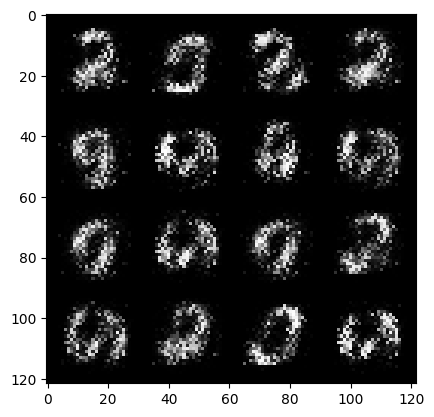

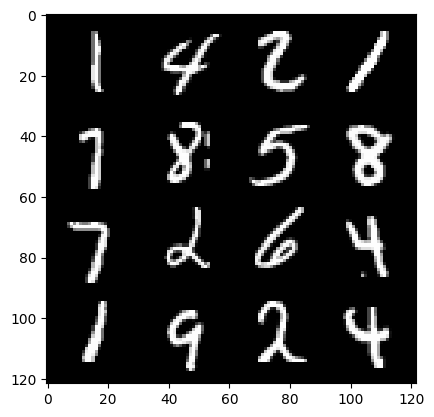

14:step 6600 / Gen loss: 6.788460170427964 / Disc loss: 0.010412037676045057


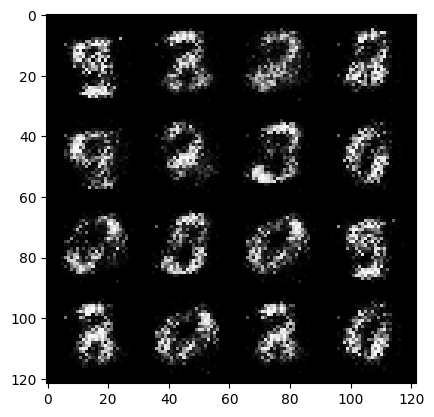

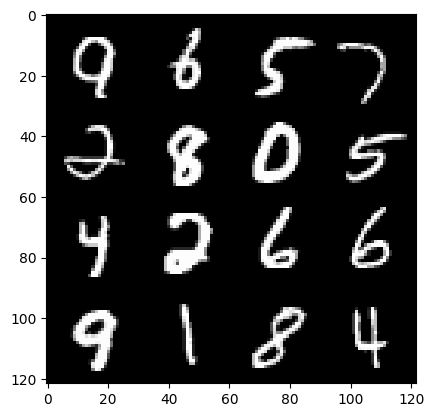

14:step 6900 / Gen loss: 6.84061956246694 / Disc loss: 0.010634013818732151


  0%|          | 0/469 [00:00<?, ?it/s]

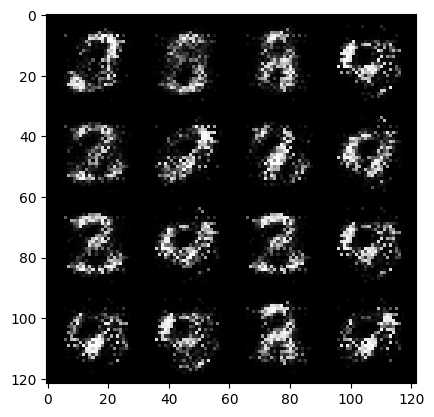

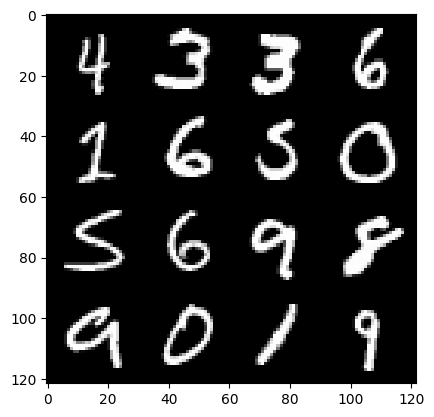

15:step 7200 / Gen loss: 6.708684620857239 / Disc loss: 0.010666210468237602


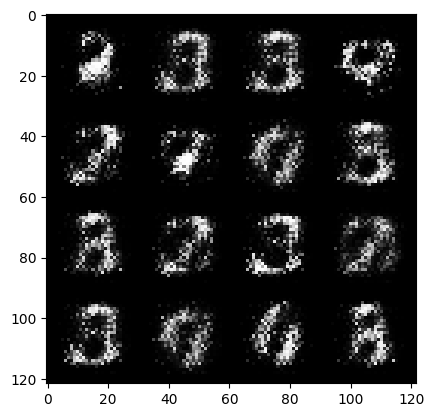

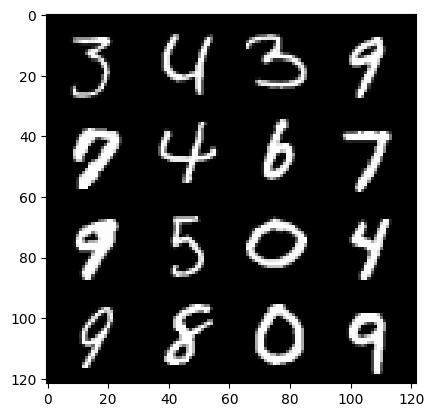

15:step 7500 / Gen loss: 7.082226910591131 / Disc loss: 0.00795462227271249


  0%|          | 0/469 [00:00<?, ?it/s]

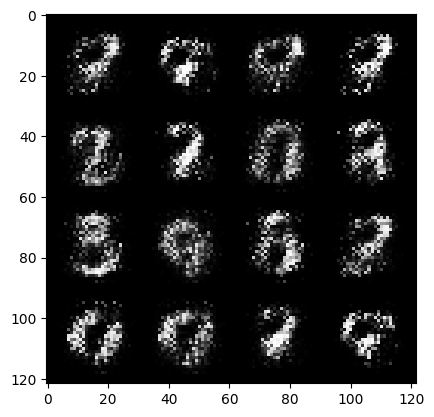

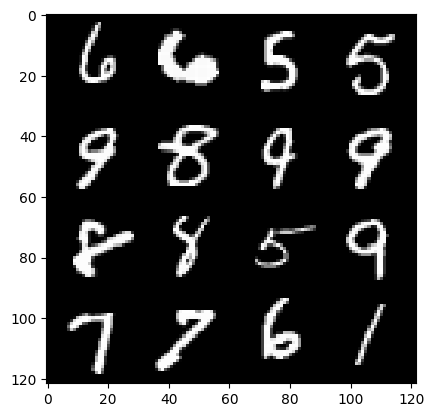

16:step 7800 / Gen loss: 7.107612217267353 / Disc loss: 0.0076614714250899845


  0%|          | 0/469 [00:00<?, ?it/s]

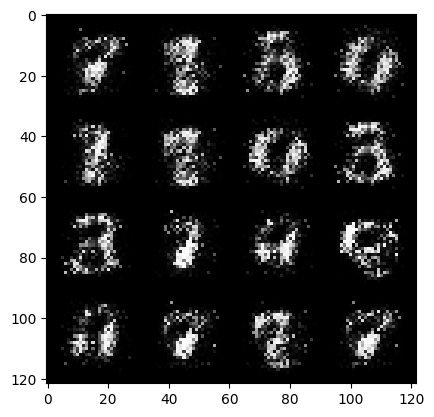

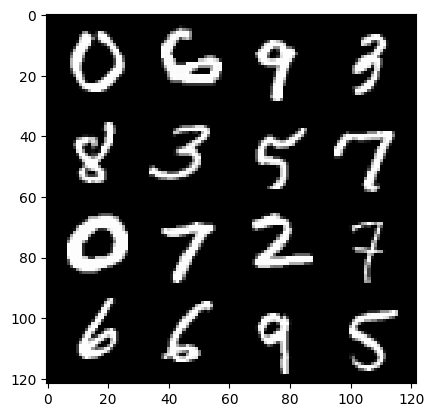

17:step 8100 / Gen loss: 7.440553496678667 / Disc loss: 0.007442553662694993


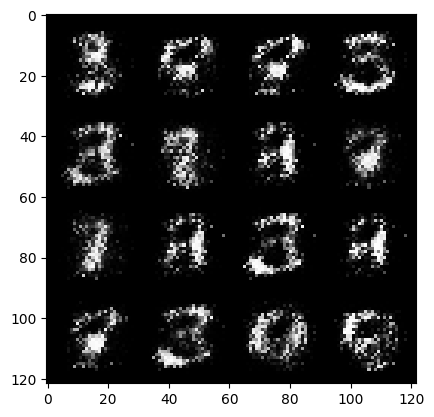

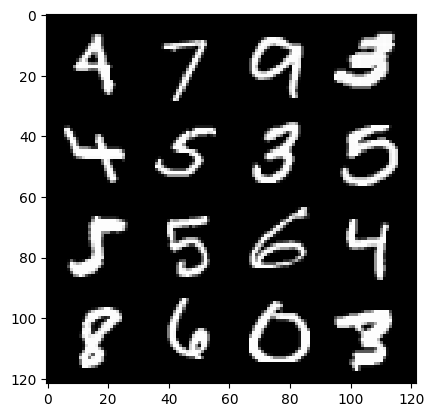

17:step 8400 / Gen loss: 7.687934220631912 / Disc loss: 0.009585180173550426


  0%|          | 0/469 [00:00<?, ?it/s]

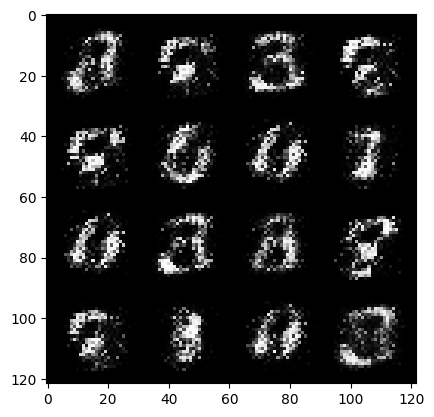

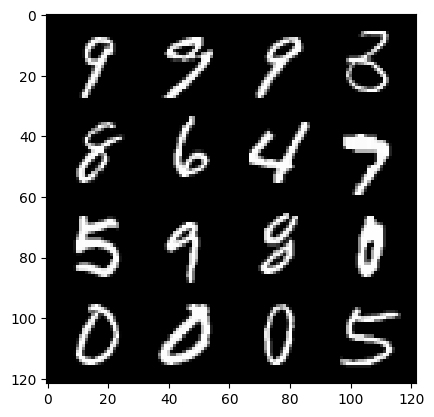

18:step 8700 / Gen loss: 7.381982879638675 / Disc loss: 0.012496848211158063


  0%|          | 0/469 [00:00<?, ?it/s]

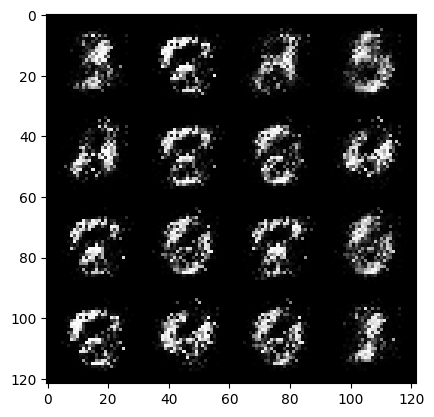

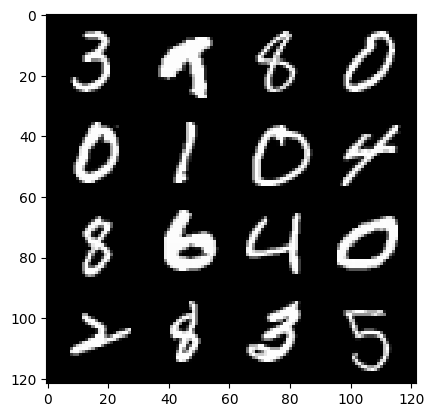

19:step 9000 / Gen loss: 7.270536260604854 / Disc loss: 0.011448978610181557


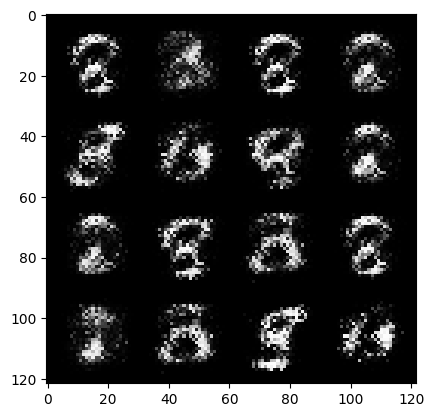

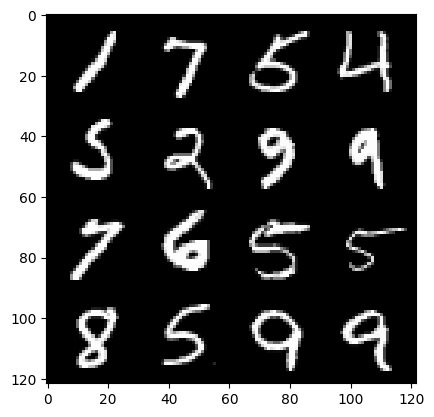

19:step 9300 / Gen loss: 8.058189404805502 / Disc loss: 0.013198467406133813


  0%|          | 0/469 [00:00<?, ?it/s]

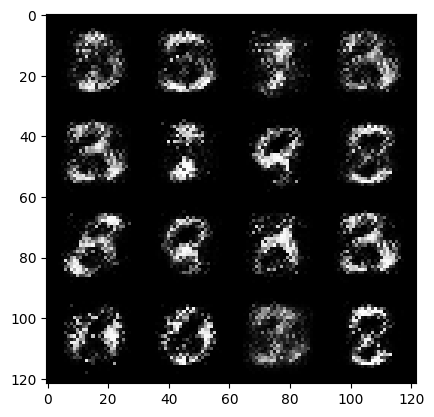

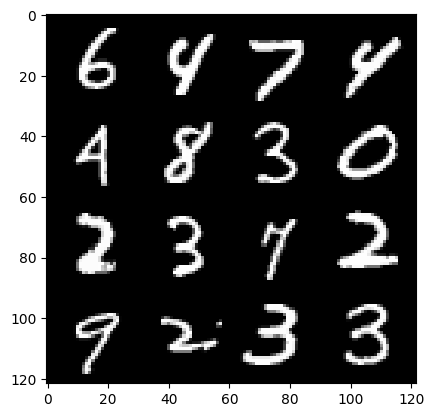

20:step 9600 / Gen loss: 7.879563727378847 / Disc loss: 0.01301558424253016


  0%|          | 0/469 [00:00<?, ?it/s]

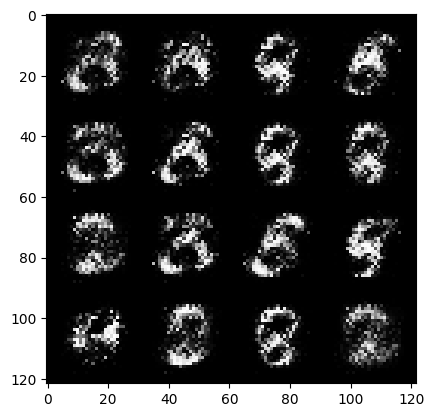

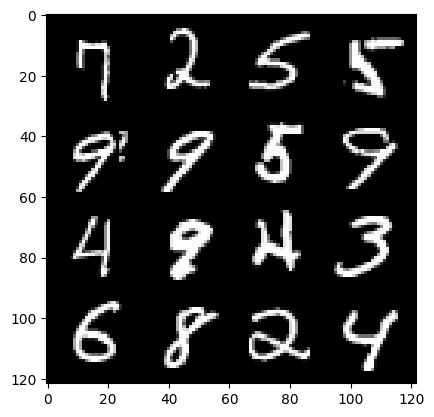

21:step 9900 / Gen loss: 7.294321358998621 / Disc loss: 0.011593388218898323


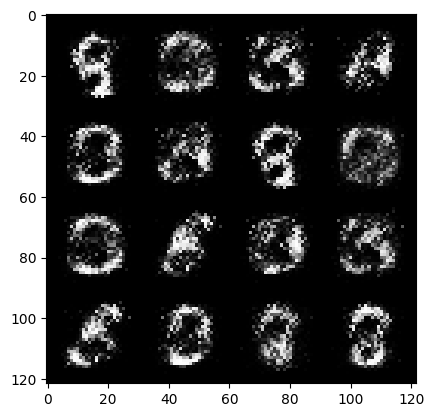

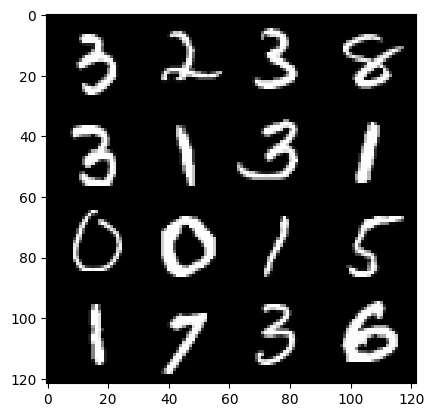

21:step 10200 / Gen loss: 7.1085007810592655 / Disc loss: 0.010928506376997877


  0%|          | 0/469 [00:00<?, ?it/s]

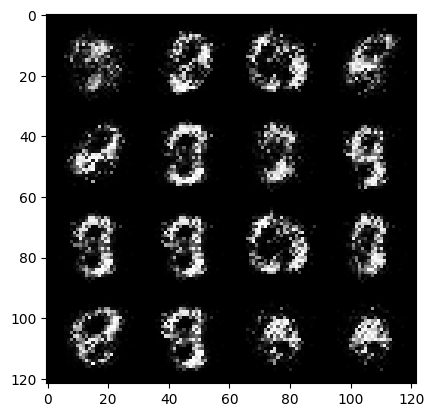

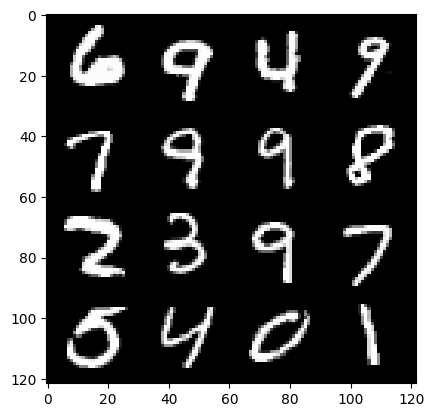

22:step 10500 / Gen loss: 7.361750713984173 / Disc loss: 0.011792245187098172


  0%|          | 0/469 [00:00<?, ?it/s]

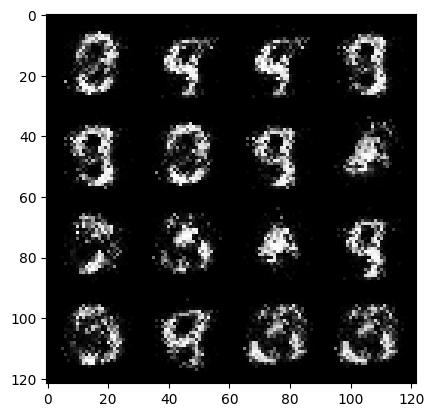

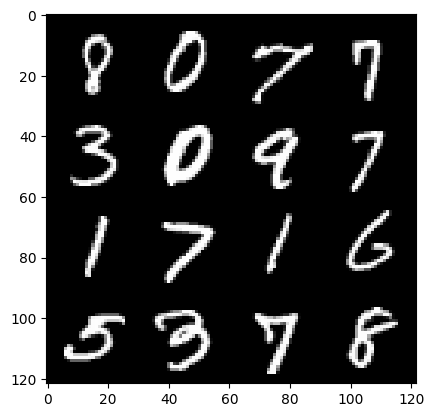

23:step 10800 / Gen loss: 7.37768257300059 / Disc loss: 0.014484942972970503


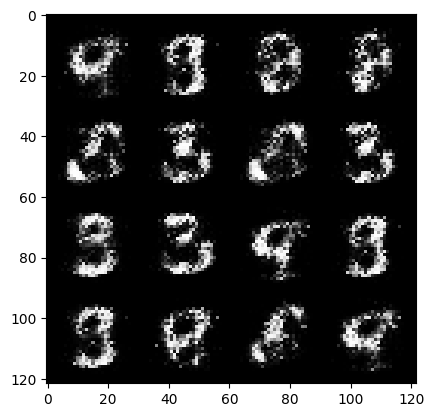

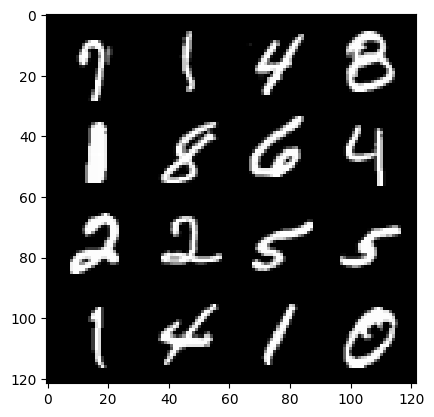

23:step 11100 / Gen loss: 7.058005324999489 / Disc loss: 0.015135643598623572


  0%|          | 0/469 [00:00<?, ?it/s]

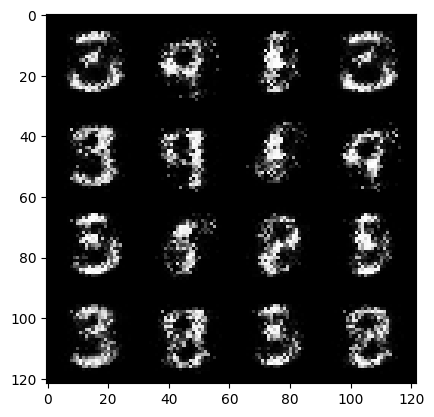

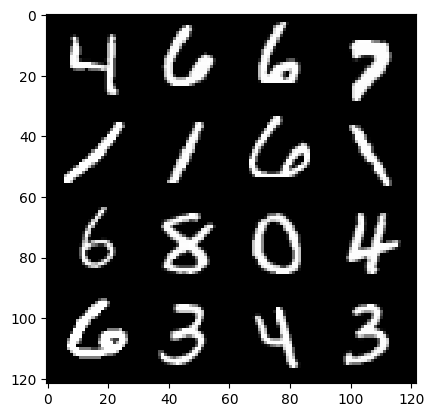

24:step 11400 / Gen loss: 6.922250347137454 / Disc loss: 0.013243940901787333


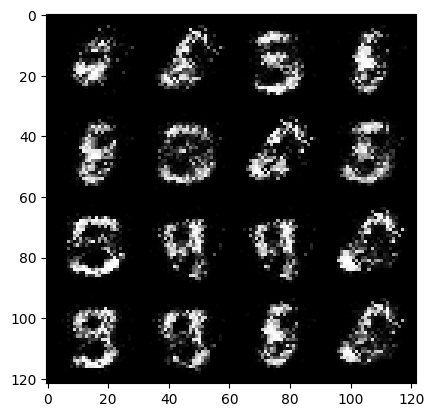

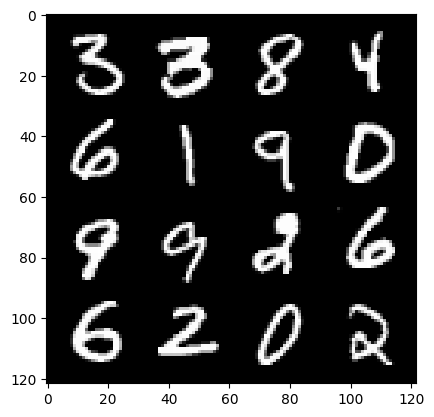

24:step 11700 / Gen loss: 6.893623534838361 / Disc loss: 0.014368799248089398


  0%|          | 0/469 [00:00<?, ?it/s]

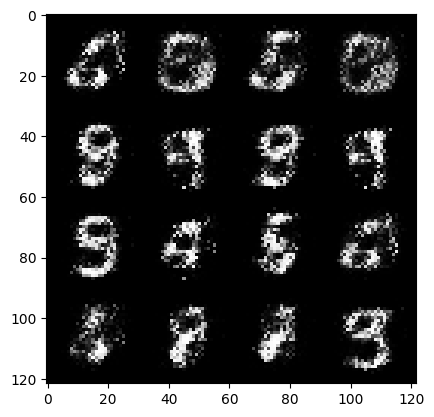

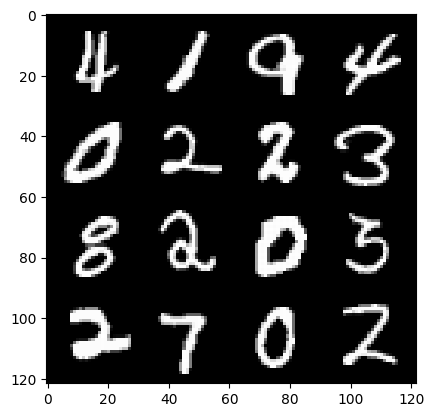

25:step 12000 / Gen loss: 7.029029375712073 / Disc loss: 0.012760855977733939


  0%|          | 0/469 [00:00<?, ?it/s]

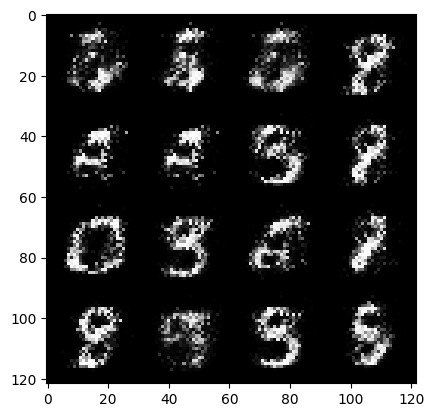

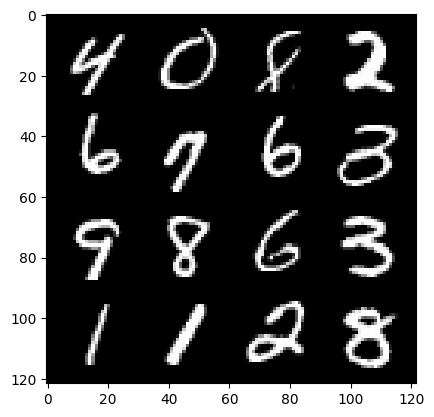

26:step 12300 / Gen loss: 7.325862545967102 / Disc loss: 0.011028770895985269


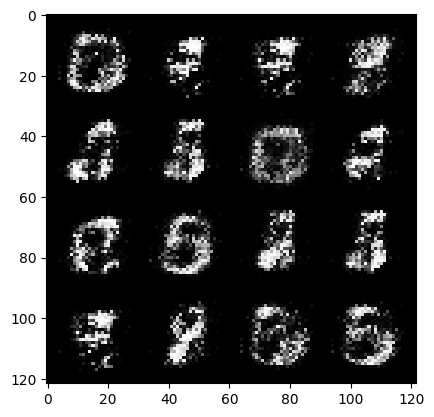

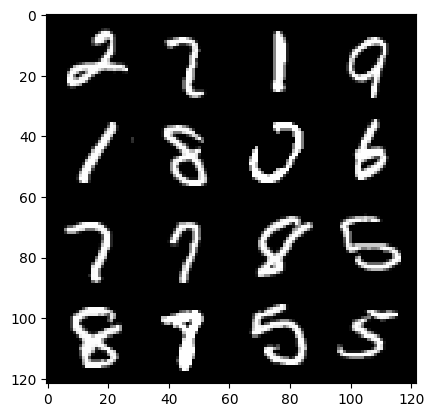

26:step 12600 / Gen loss: 7.049036838213599 / Disc loss: 0.012936988462073109


  0%|          | 0/469 [00:00<?, ?it/s]

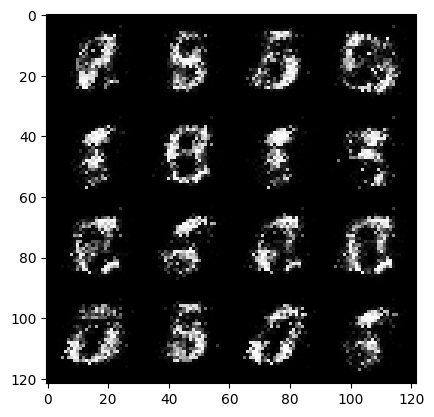

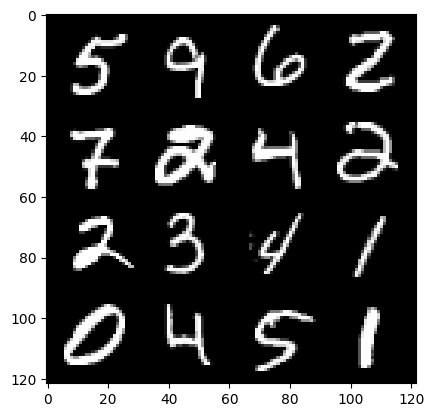

27:step 12900 / Gen loss: 7.4193149375915555 / Disc loss: 0.011740546128712594


  0%|          | 0/469 [00:00<?, ?it/s]

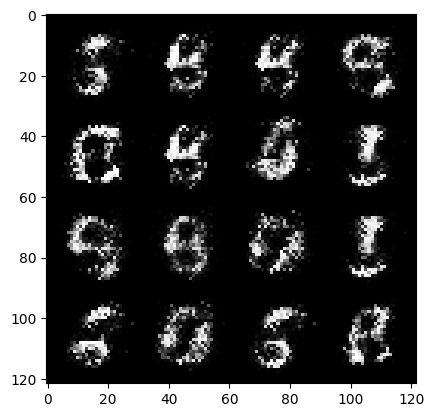

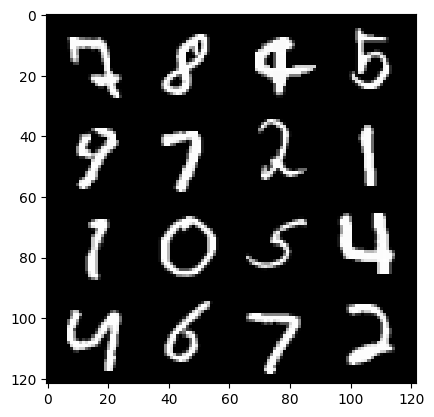

28:step 13200 / Gen loss: 7.618426248232521 / Disc loss: 0.014488367765055347


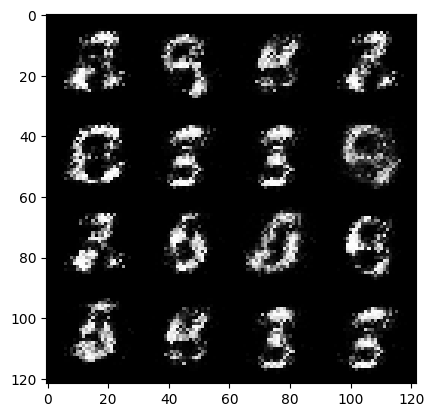

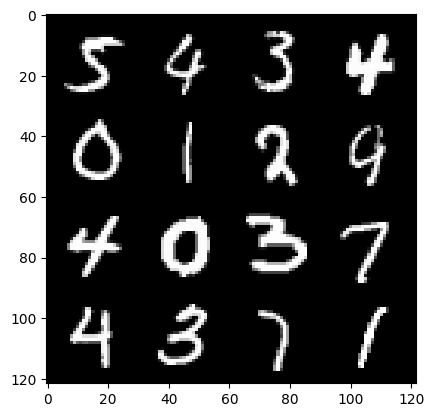

28:step 13500 / Gen loss: 7.143017724355062 / Disc loss: 0.018083525686524816


  0%|          | 0/469 [00:00<?, ?it/s]

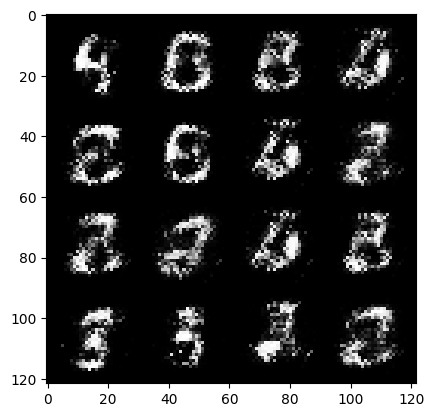

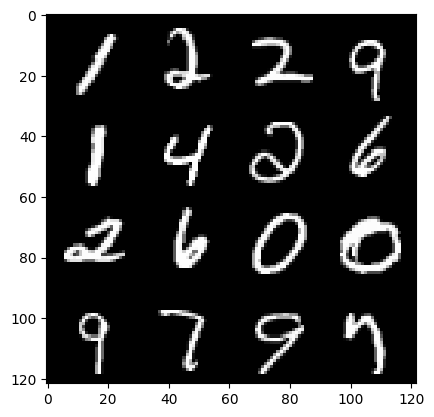

29:step 13800 / Gen loss: 7.307764929135644 / Disc loss: 0.01919808376425258


  0%|          | 0/469 [00:00<?, ?it/s]

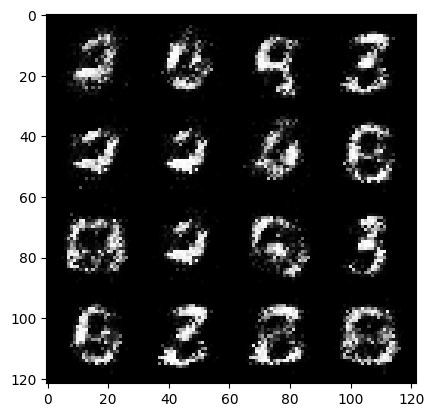

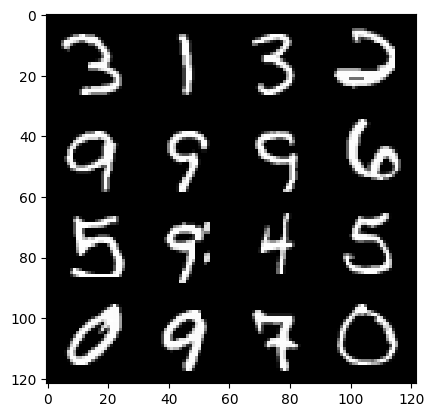

30:step 14100 / Gen loss: 7.497788872718816 / Disc loss: 0.01885665413147459


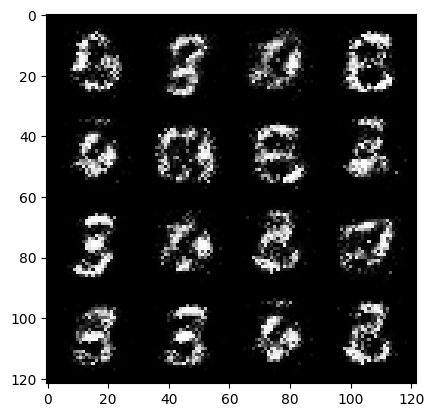

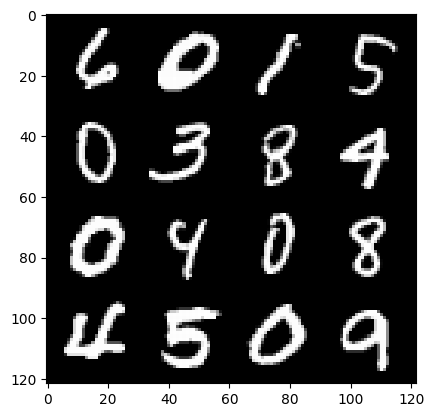

30:step 14400 / Gen loss: 7.126758597691853 / Disc loss: 0.020452837323925162


  0%|          | 0/469 [00:00<?, ?it/s]

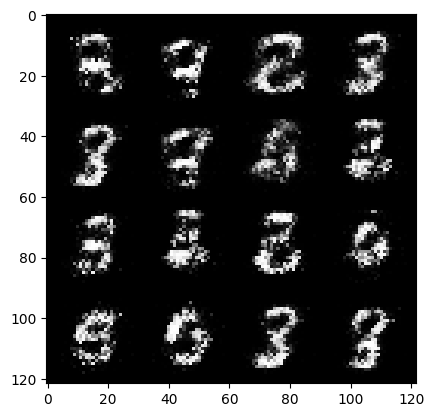

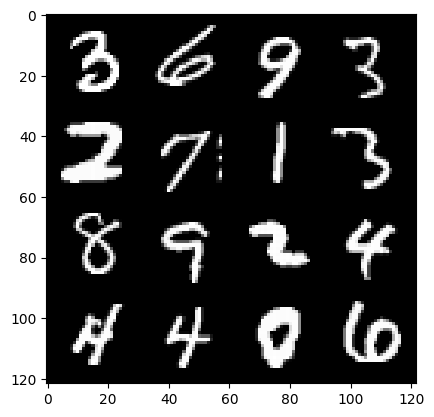

31:step 14700 / Gen loss: 7.249443017641699 / Disc loss: 0.017996934860323867


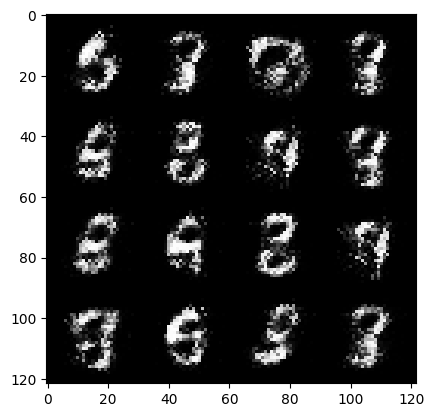

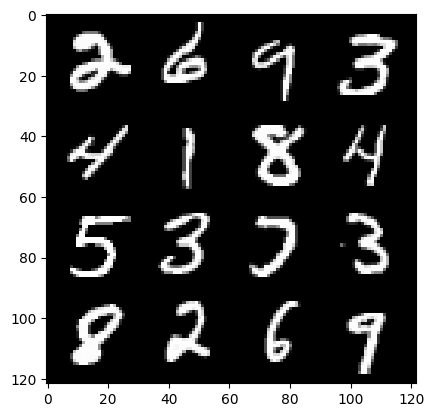

31:step 15000 / Gen loss: 6.584194053014122 / Disc loss: 0.024899799486932647


  0%|          | 0/469 [00:00<?, ?it/s]

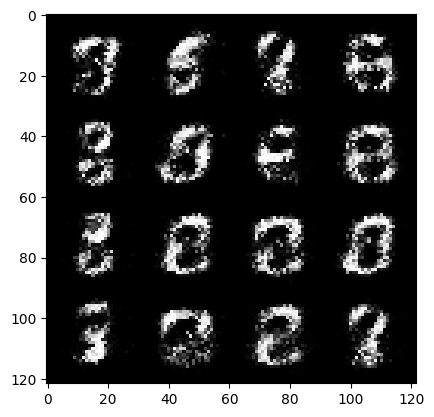

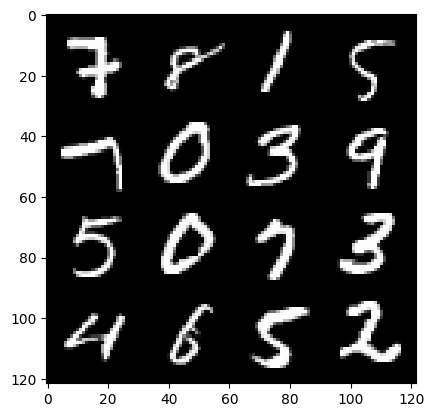

32:step 15300 / Gen loss: 6.36390874385834 / Disc loss: 0.027455760464072235


  0%|          | 0/469 [00:00<?, ?it/s]

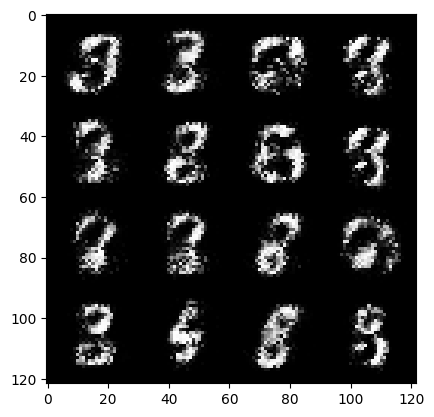

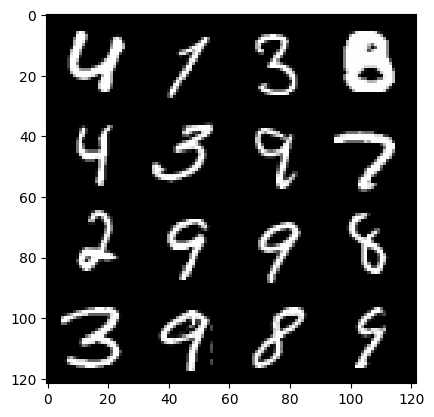

33:step 15600 / Gen loss: 6.2649713579813575 / Disc loss: 0.025621986418652026


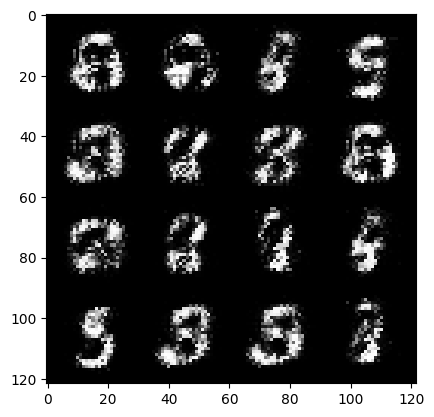

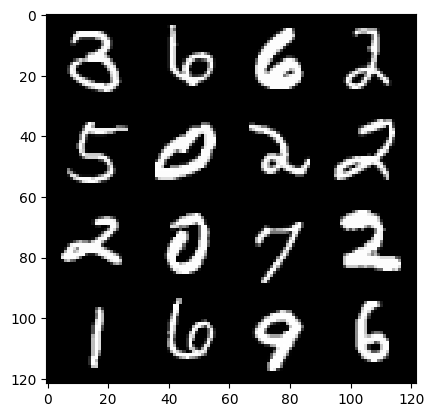

33:step 15900 / Gen loss: 6.165481746991481 / Disc loss: 0.02287233440981558


  0%|          | 0/469 [00:00<?, ?it/s]

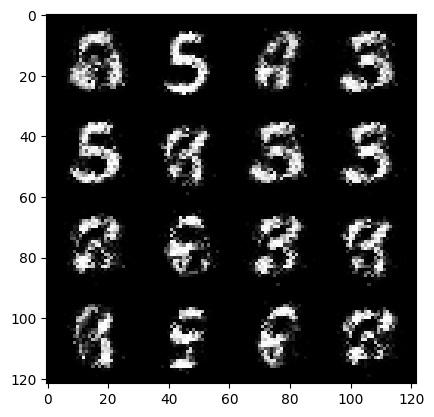

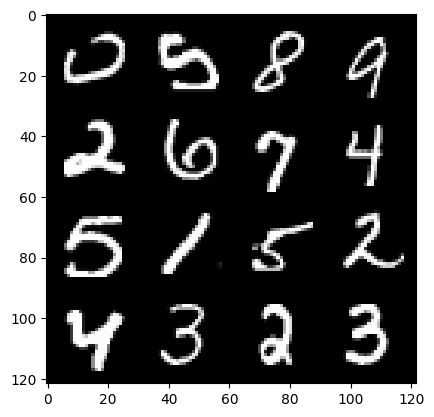

34:step 16200 / Gen loss: 6.3076168553034515 / Disc loss: 0.022662132537613303


  0%|          | 0/469 [00:00<?, ?it/s]

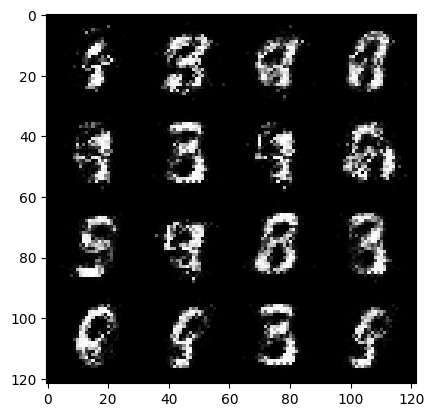

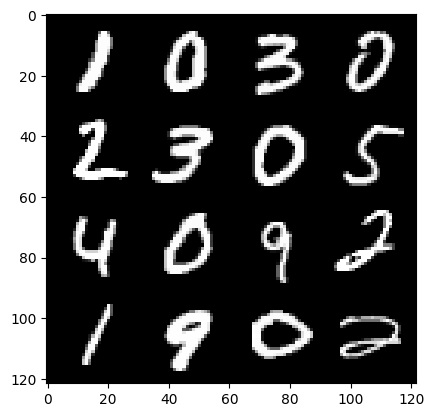

35:step 16500 / Gen loss: 6.295393341382347 / Disc loss: 0.020923104587321478


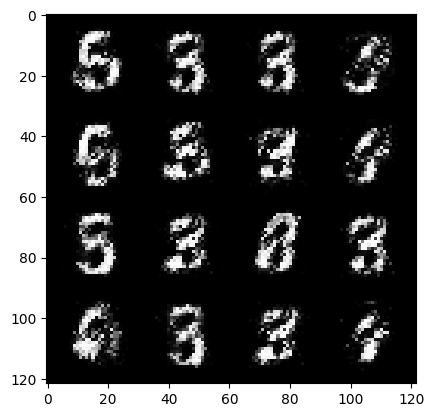

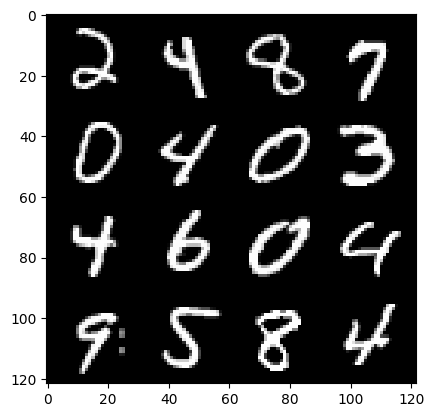

35:step 16800 / Gen loss: 6.1760468784968054 / Disc loss: 0.02183891146133342


  0%|          | 0/469 [00:00<?, ?it/s]

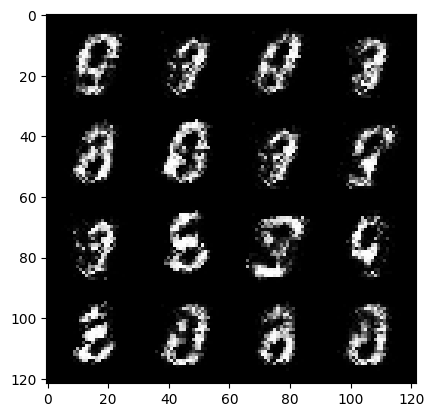

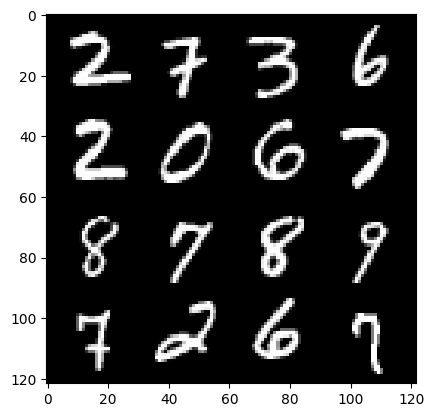

36:step 17100 / Gen loss: 5.857955711682632 / Disc loss: 0.025294286149243506


  0%|          | 0/469 [00:00<?, ?it/s]

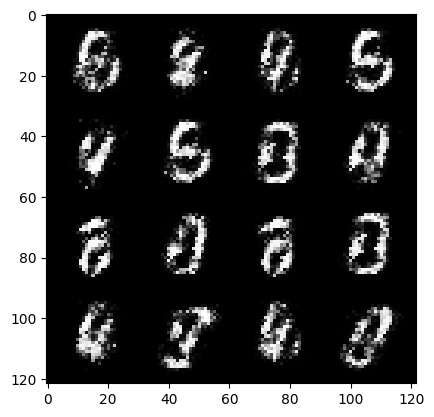

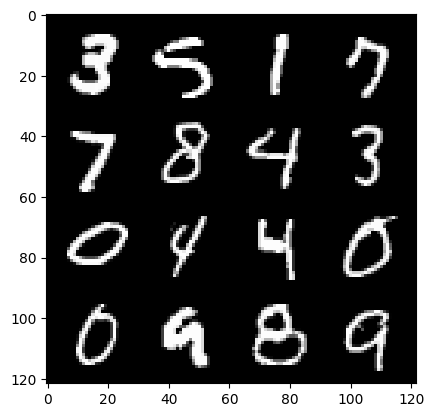

37:step 17400 / Gen loss: 5.9550550985336335 / Disc loss: 0.029618152040056887


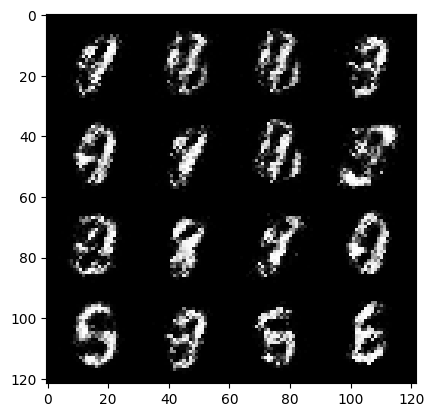

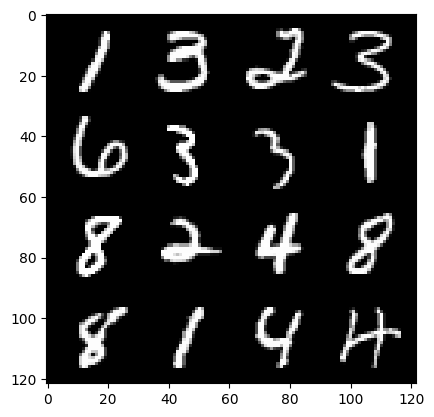

37:step 17700 / Gen loss: 6.080879782040915 / Disc loss: 0.030607149101172876


  0%|          | 0/469 [00:00<?, ?it/s]

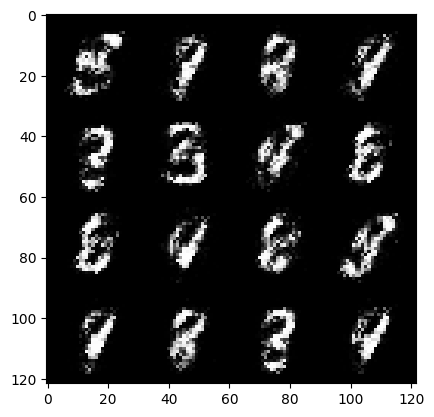

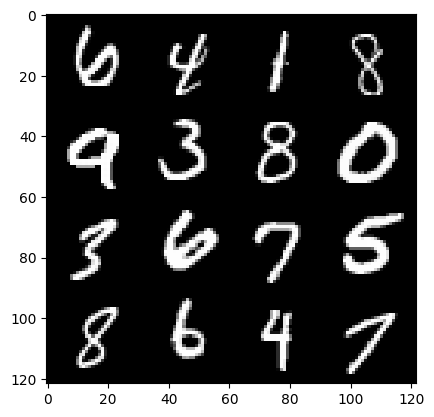

38:step 18000 / Gen loss: 6.057813247044879 / Disc loss: 0.03021096188264589


  0%|          | 0/469 [00:00<?, ?it/s]

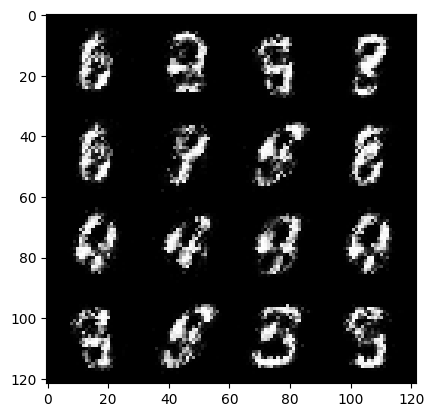

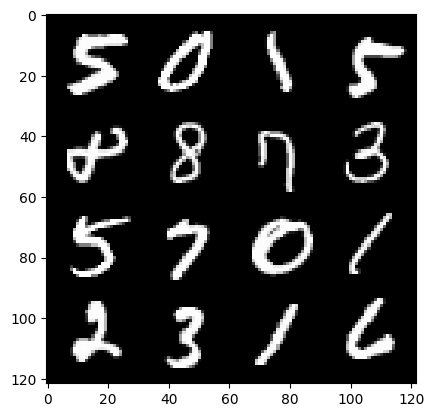

39:step 18300 / Gen loss: 6.152820839881895 / Disc loss: 0.025918607266309356


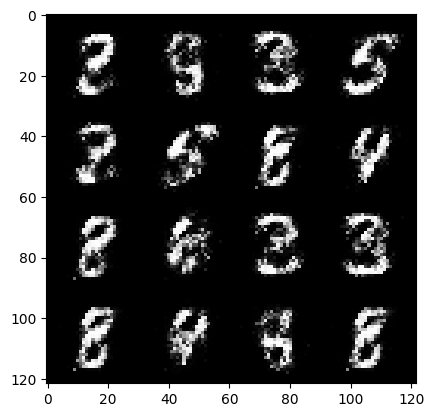

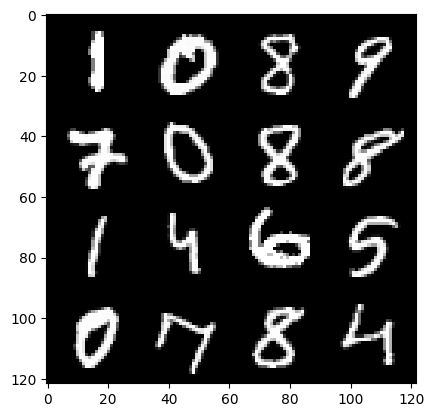

39:step 18600 / Gen loss: 6.333485272725427 / Disc loss: 0.028590240785852095


  0%|          | 0/469 [00:00<?, ?it/s]

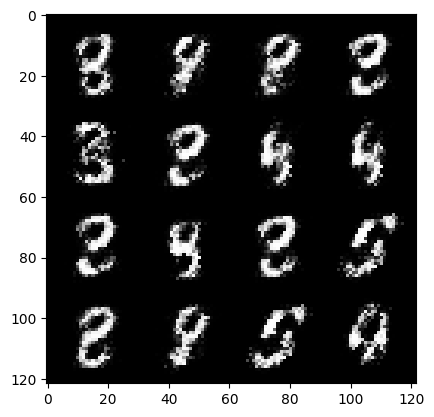

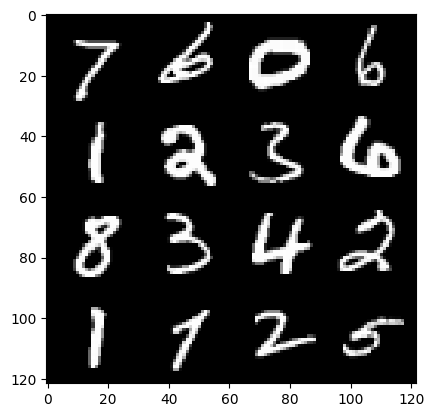

40:step 18900 / Gen loss: 6.085851632754011 / Disc loss: 0.027195083000697205


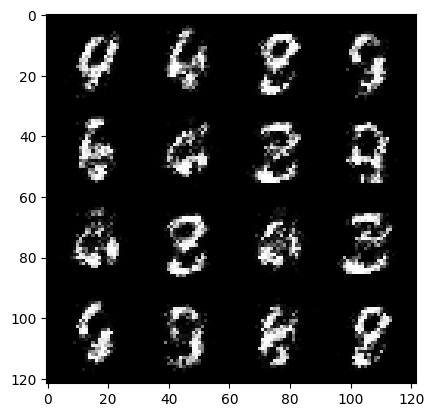

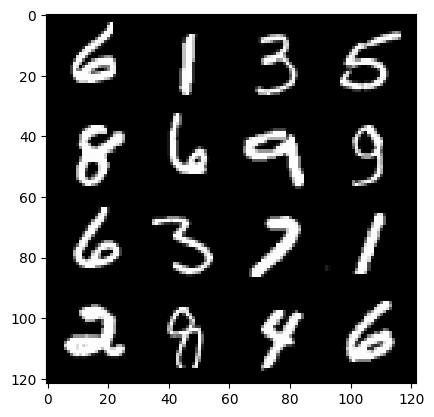

40:step 19200 / Gen loss: 6.091784685452775 / Disc loss: 0.03018864136810105


  0%|          | 0/469 [00:00<?, ?it/s]

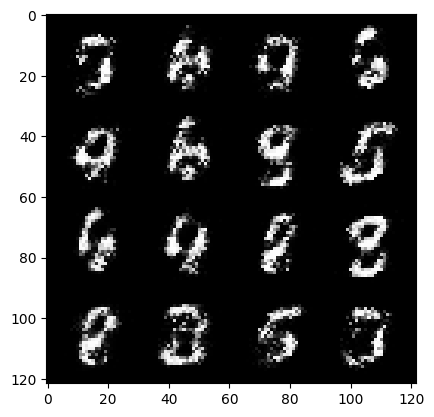

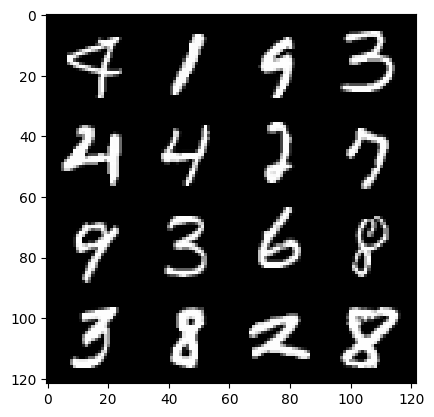

41:step 19500 / Gen loss: 6.082056748072306 / Disc loss: 0.034825859195552755


  0%|          | 0/469 [00:00<?, ?it/s]

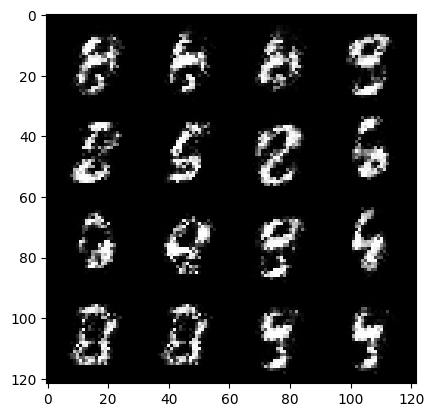

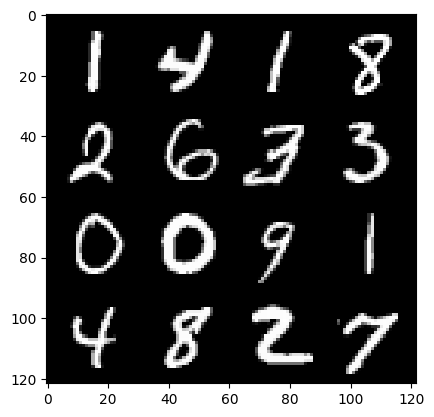

42:step 19800 / Gen loss: 5.735288174947098 / Disc loss: 0.03842846447601917


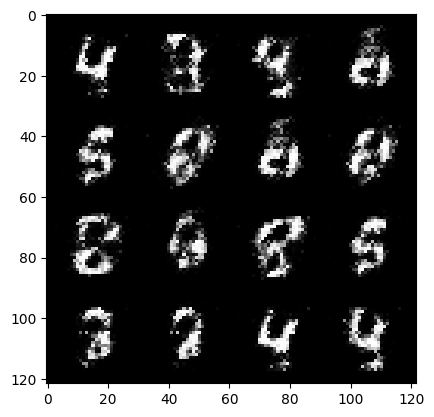

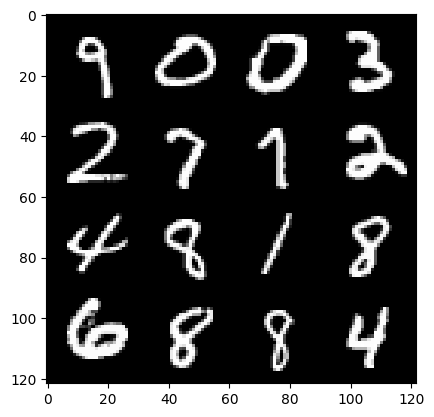

42:step 20100 / Gen loss: 5.854185910224916 / Disc loss: 0.04093510287813839


  0%|          | 0/469 [00:00<?, ?it/s]

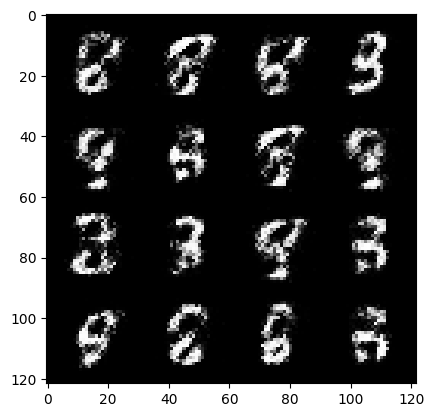

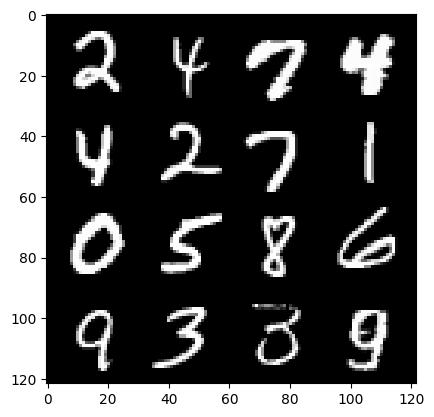

43:step 20400 / Gen loss: 5.714019085566208 / Disc loss: 0.0446316826591889


  0%|          | 0/469 [00:00<?, ?it/s]

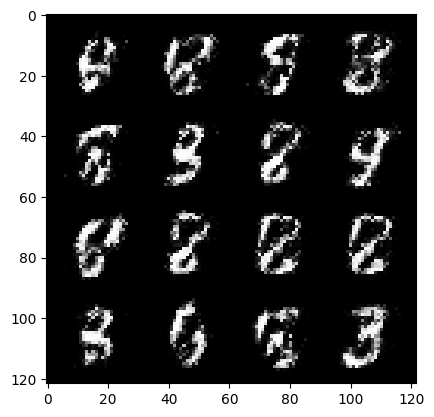

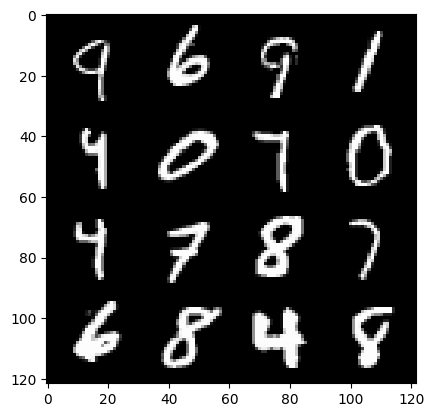

44:step 20700 / Gen loss: 5.473303275108339 / Disc loss: 0.05006864873071512


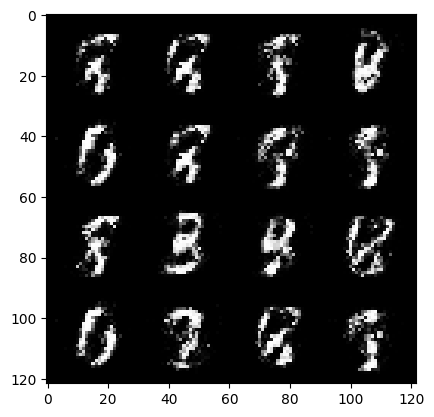

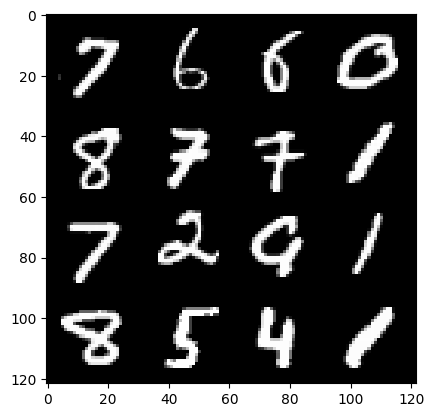

44:step 21000 / Gen loss: 5.415377602577206 / Disc loss: 0.04151811295188966


  0%|          | 0/469 [00:00<?, ?it/s]

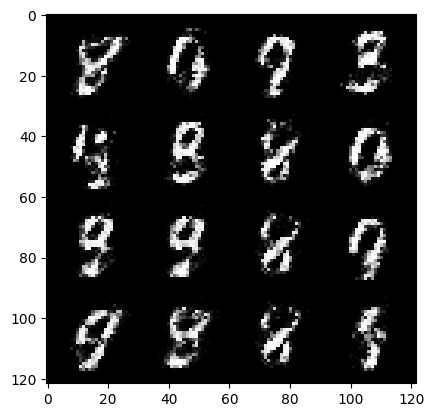

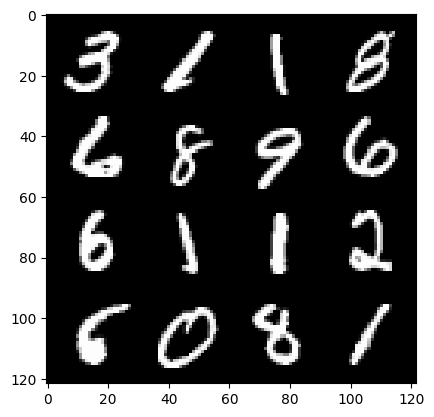

45:step 21300 / Gen loss: 5.556641591389975 / Disc loss: 0.03699633537170787


  0%|          | 0/469 [00:00<?, ?it/s]

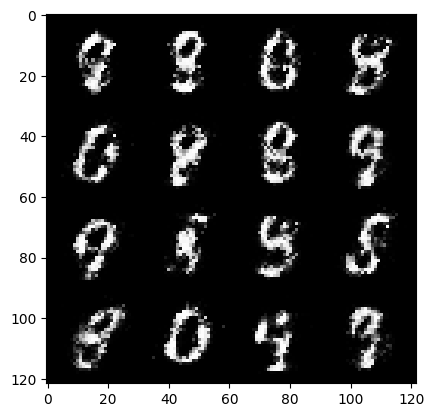

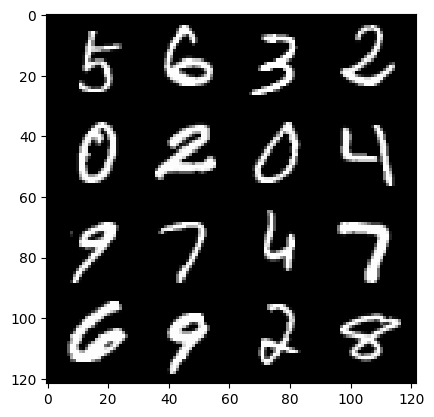

46:step 21600 / Gen loss: 5.512140161196391 / Disc loss: 0.04813103856518862


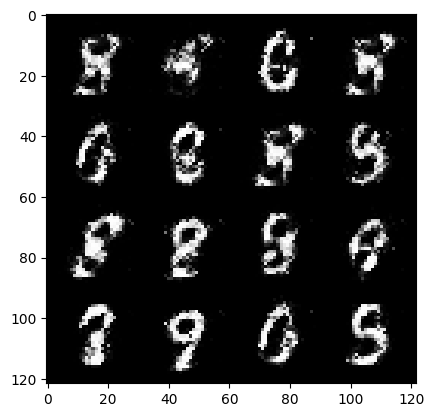

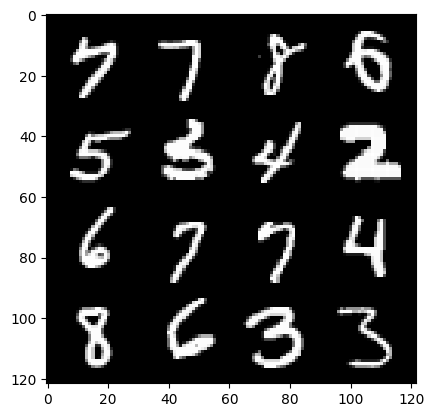

46:step 21900 / Gen loss: 5.30481861114502 / Disc loss: 0.04445336517256998


  0%|          | 0/469 [00:00<?, ?it/s]

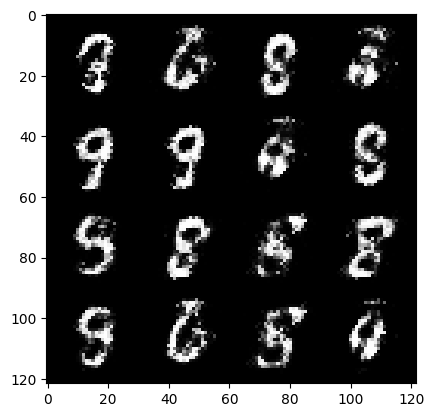

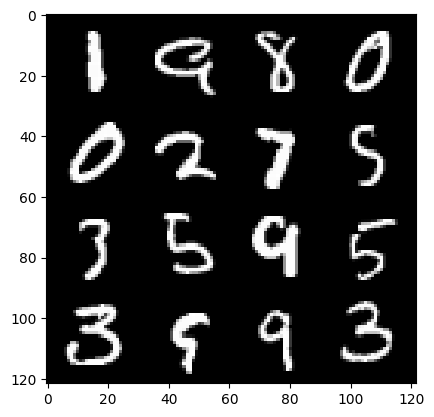

47:step 22200 / Gen loss: 5.619971642494201 / Disc loss: 0.049891848219558575


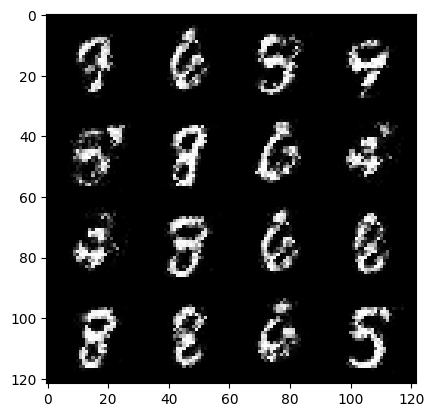

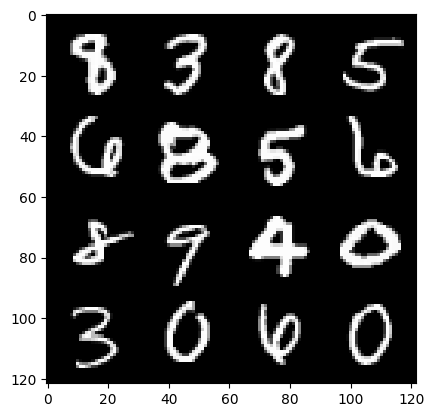

47:step 22500 / Gen loss: 5.5327726689974455 / Disc loss: 0.059980943150197454


  0%|          | 0/469 [00:00<?, ?it/s]

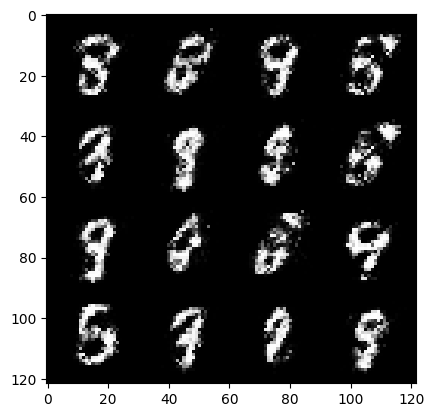

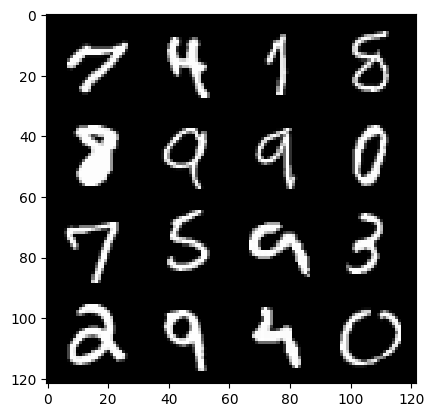

48:step 22800 / Gen loss: 5.217768114407857 / Disc loss: 0.0636418711145719


  0%|          | 0/469 [00:00<?, ?it/s]

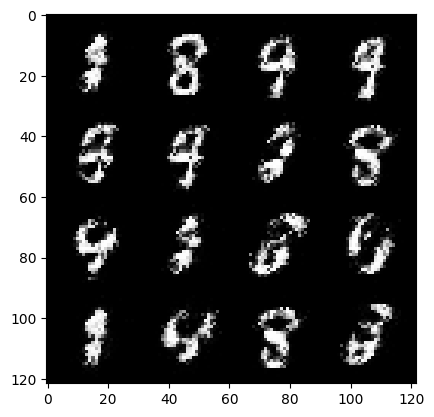

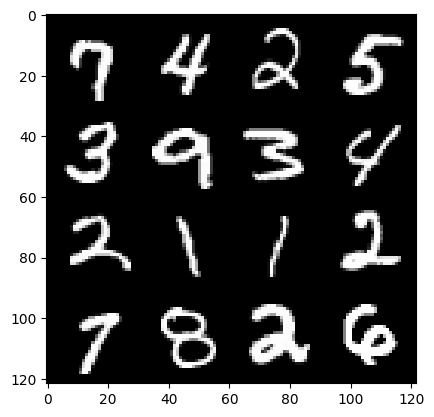

49:step 23100 / Gen loss: 5.227965376377104 / Disc loss: 0.060440325178205974


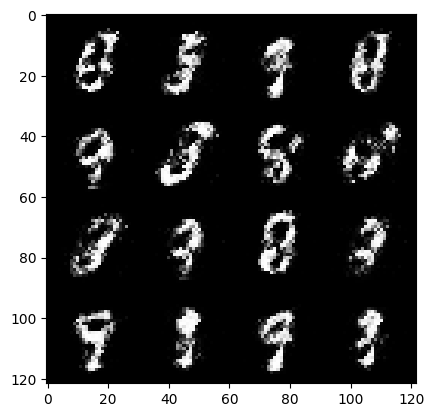

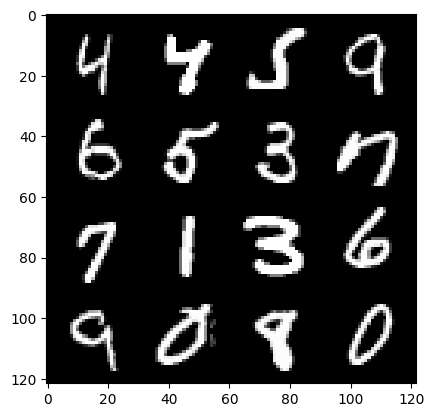

49:step 23400 / Gen loss: 5.463632405598959 / Disc loss: 0.05379530934306484


  0%|          | 0/469 [00:00<?, ?it/s]

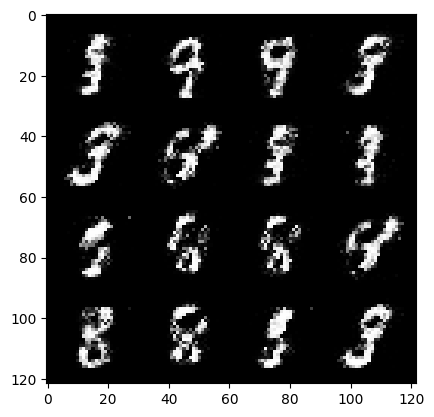

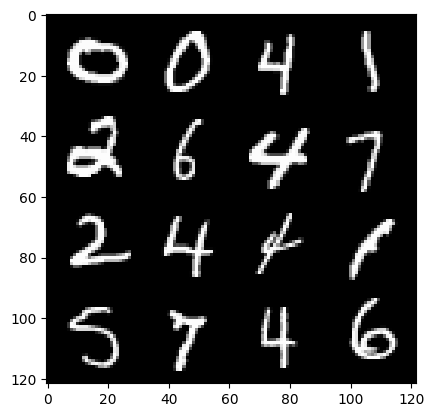

50:step 23700 / Gen loss: 5.0864183108011884 / Disc loss: 0.05934011453141765


  0%|          | 0/469 [00:00<?, ?it/s]

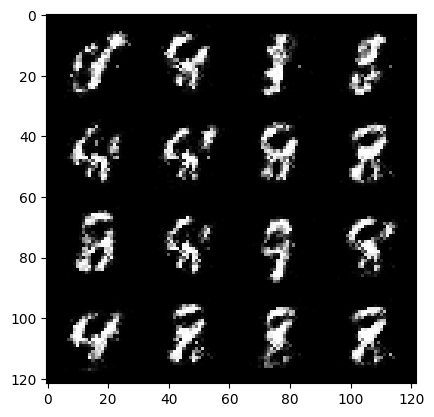

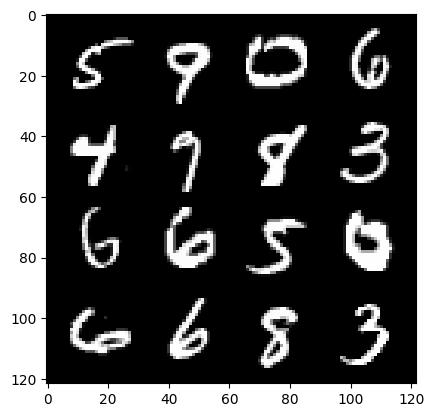

51:step 24000 / Gen loss: 5.324201707839967 / Disc loss: 0.051872959931691456


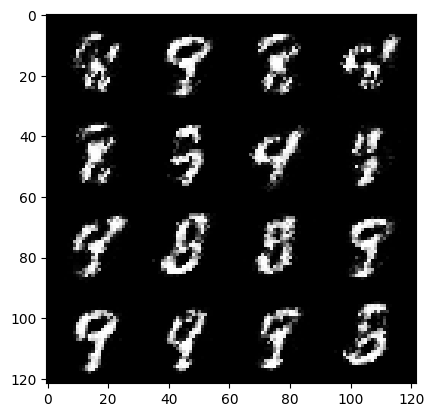

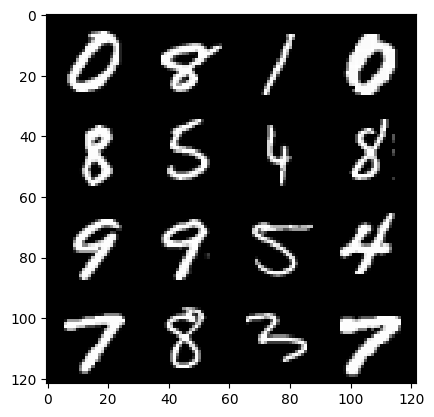

51:step 24300 / Gen loss: 5.1170023806889855 / Disc loss: 0.07489659041476747


  0%|          | 0/469 [00:00<?, ?it/s]

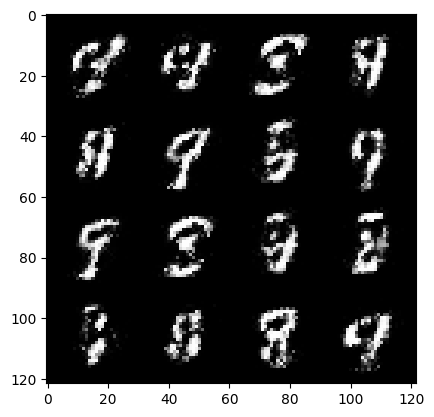

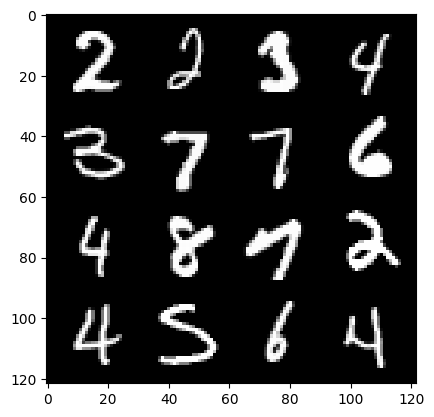

52:step 24600 / Gen loss: 4.759566280841828 / Disc loss: 0.07899482821424801


  0%|          | 0/469 [00:00<?, ?it/s]

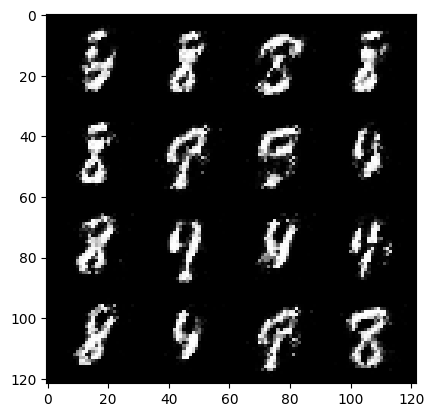

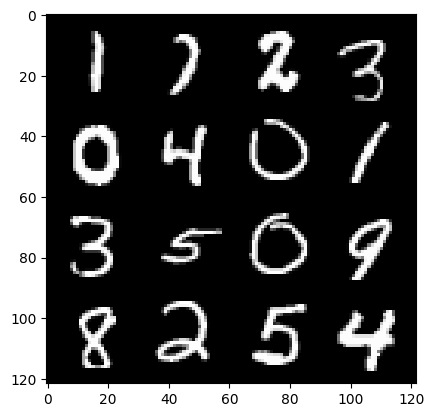

53:step 24900 / Gen loss: 4.694743629296622 / Disc loss: 0.08445209084078671


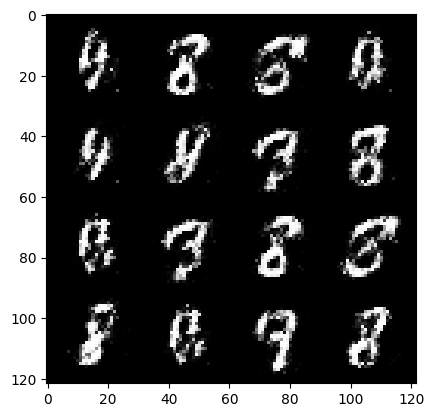

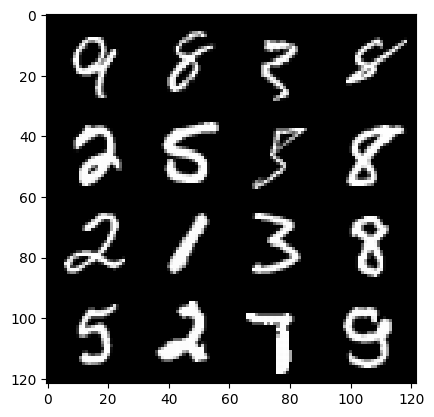

53:step 25200 / Gen loss: 4.820842286745705 / Disc loss: 0.07900989877060051


  0%|          | 0/469 [00:00<?, ?it/s]

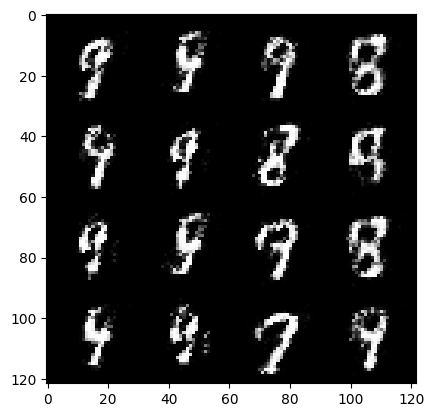

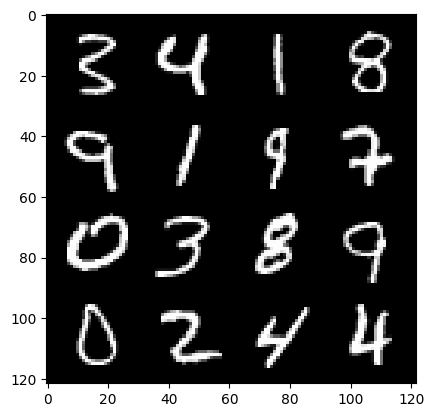

54:step 25500 / Gen loss: 4.776527991294861 / Disc loss: 0.06187276659533382


  0%|          | 0/469 [00:00<?, ?it/s]

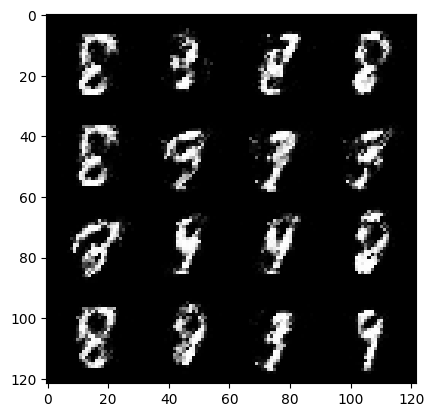

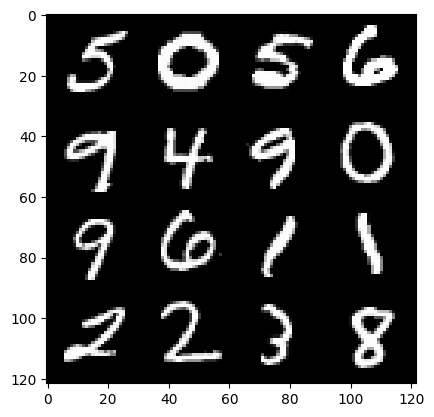

55:step 25800 / Gen loss: 4.752218066056563 / Disc loss: 0.067823610175401


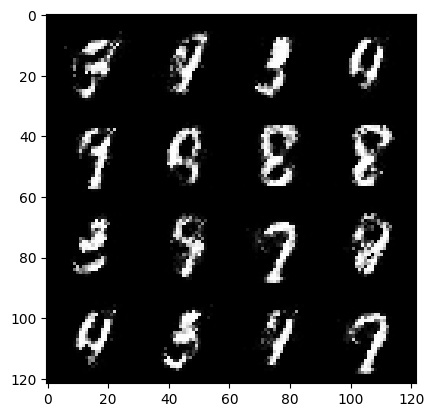

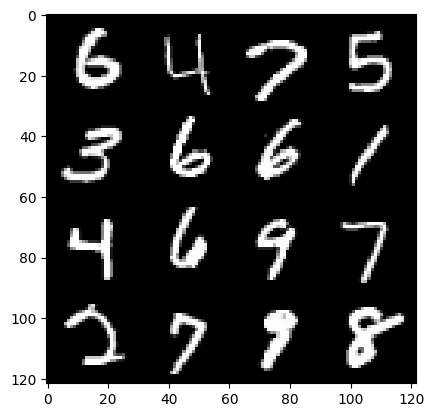

55:step 26100 / Gen loss: 4.728126144409183 / Disc loss: 0.07476480875785158


  0%|          | 0/469 [00:00<?, ?it/s]

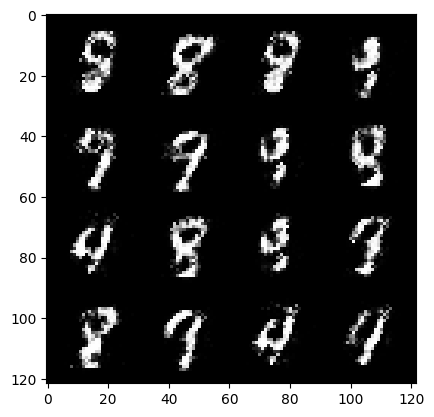

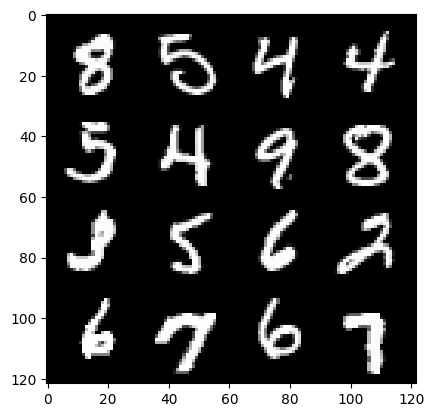

56:step 26400 / Gen loss: 4.531149621804556 / Disc loss: 0.08164258860051633


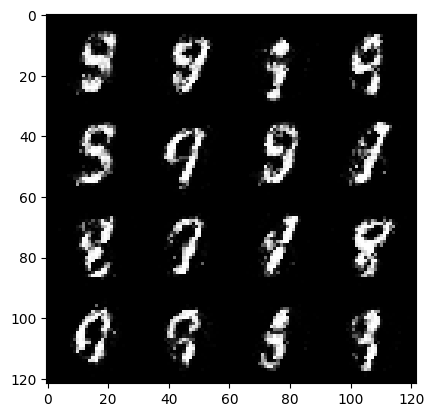

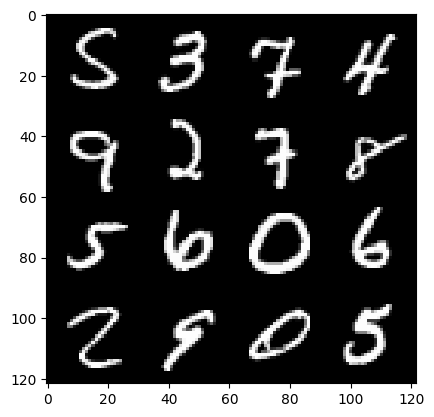

56:step 26700 / Gen loss: 4.612435587247217 / Disc loss: 0.09552712907393779


  0%|          | 0/469 [00:00<?, ?it/s]

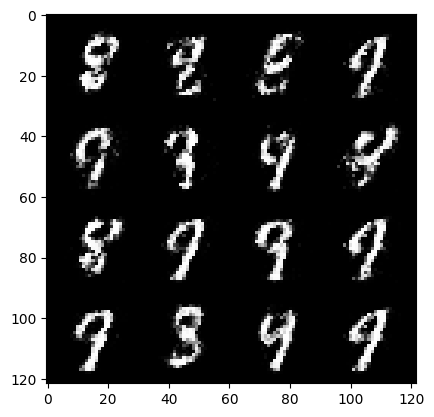

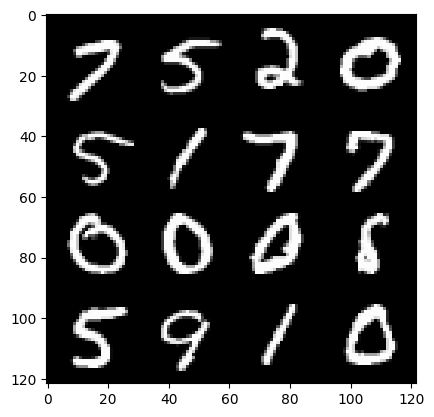

57:step 27000 / Gen loss: 4.3515168468157475 / Disc loss: 0.09617779343699413


  0%|          | 0/469 [00:00<?, ?it/s]

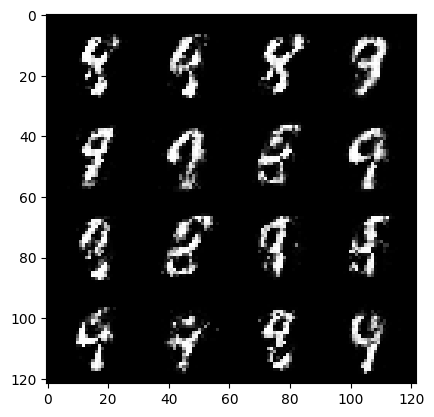

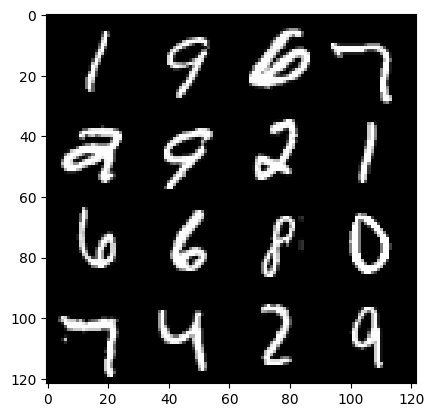

58:step 27300 / Gen loss: 4.235258979797363 / Disc loss: 0.09919213493665055


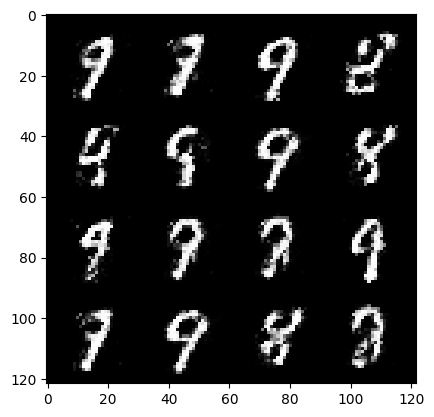

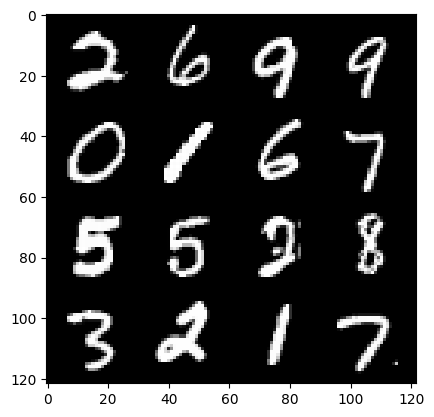

58:step 27600 / Gen loss: 4.223077987829845 / Disc loss: 0.09399937697996691


  0%|          | 0/469 [00:00<?, ?it/s]

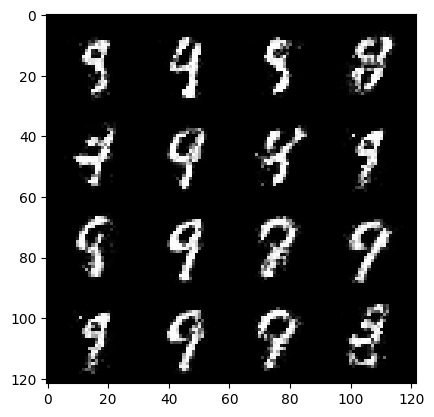

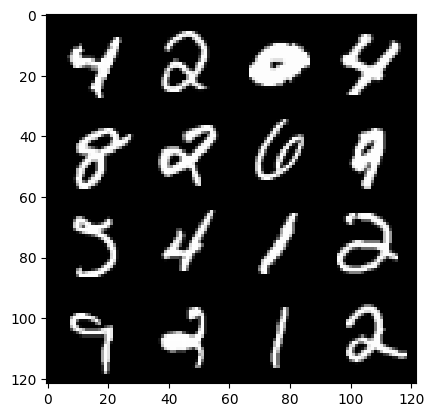

59:step 27900 / Gen loss: 4.152171773910523 / Disc loss: 0.1022786687873305


  0%|          | 0/469 [00:00<?, ?it/s]

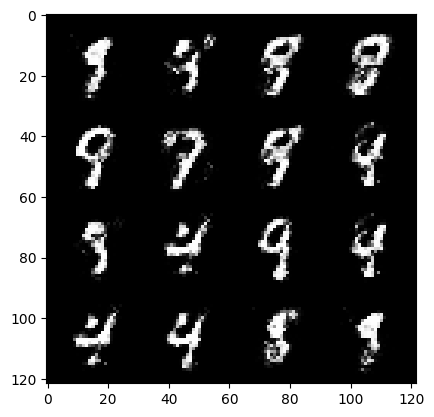

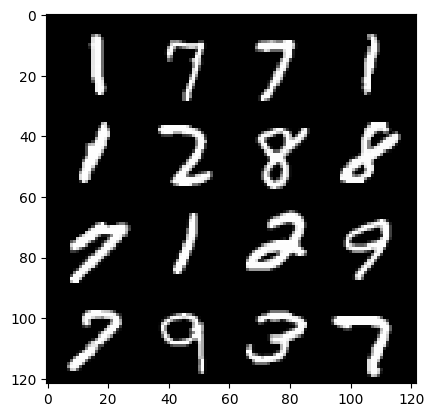

60:step 28200 / Gen loss: 4.216442663669583 / Disc loss: 0.09499736598382394


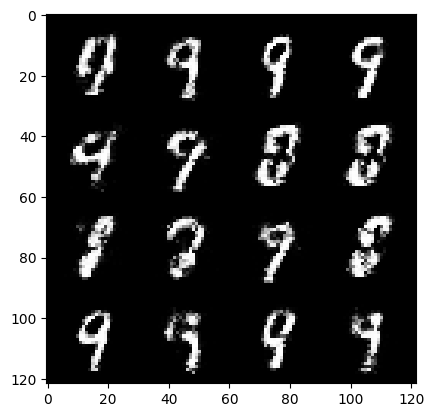

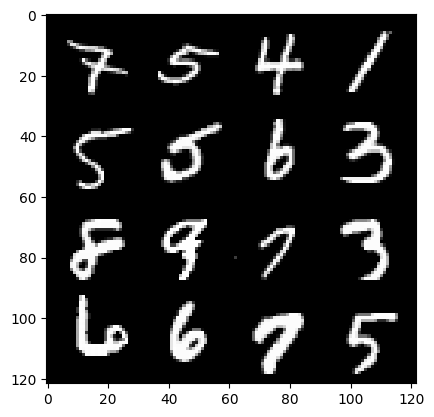

60:step 28500 / Gen loss: 4.253605594635006 / Disc loss: 0.10008913341909646


  0%|          | 0/469 [00:00<?, ?it/s]

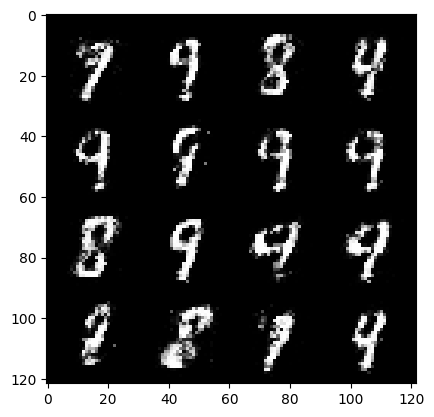

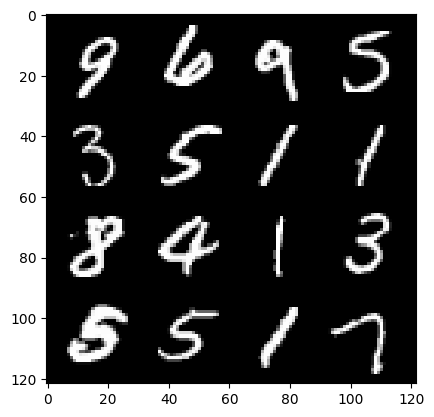

61:step 28800 / Gen loss: 3.9831075135866807 / Disc loss: 0.11355159501234692


  0%|          | 0/469 [00:00<?, ?it/s]

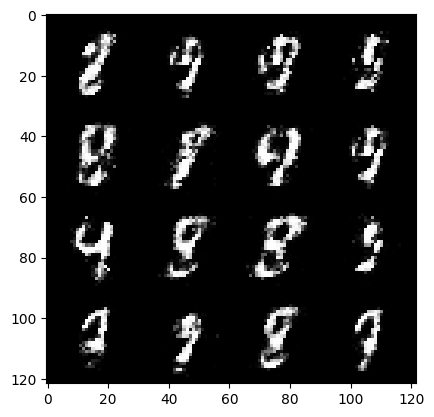

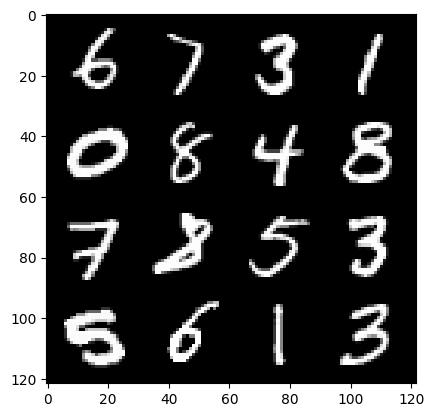

62:step 29100 / Gen loss: 3.954881535371148 / Disc loss: 0.10901251240322994


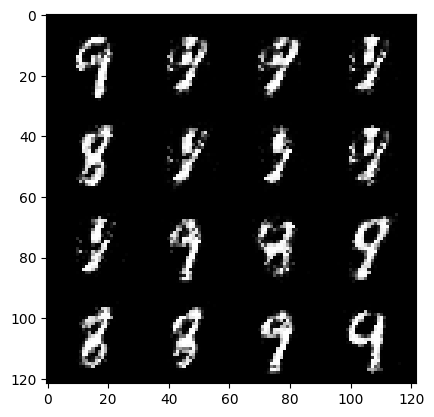

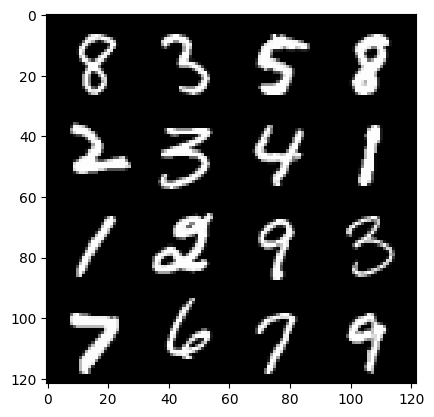

62:step 29400 / Gen loss: 4.171630519231157 / Disc loss: 0.09424053639173513


  0%|          | 0/469 [00:00<?, ?it/s]

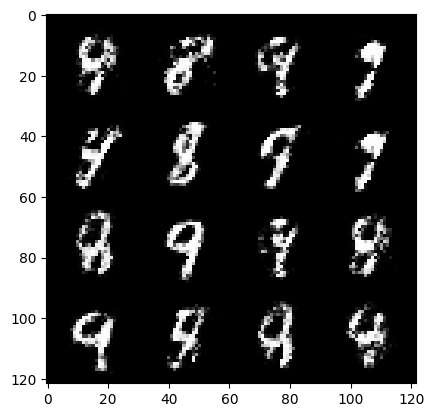

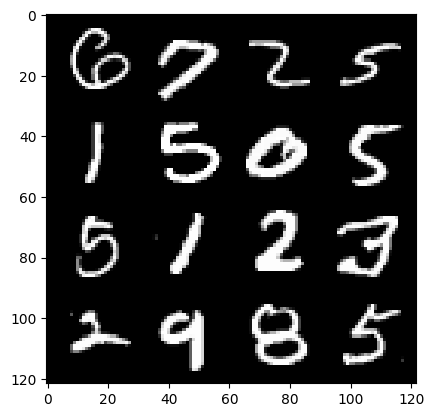

63:step 29700 / Gen loss: 3.9825585444768277 / Disc loss: 0.11411903042967124


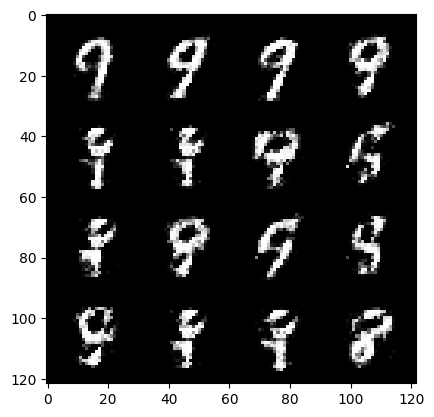

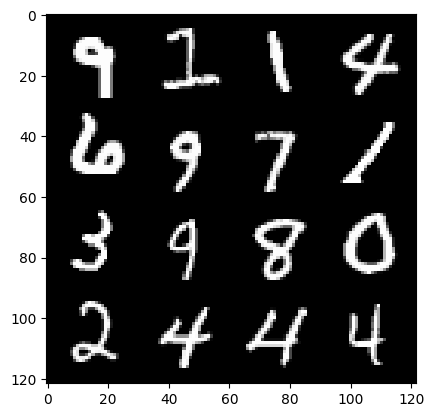

63:step 30000 / Gen loss: 3.881760052839917 / Disc loss: 0.11668045905729131


  0%|          | 0/469 [00:00<?, ?it/s]

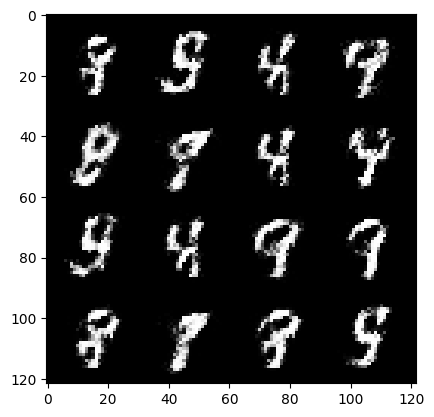

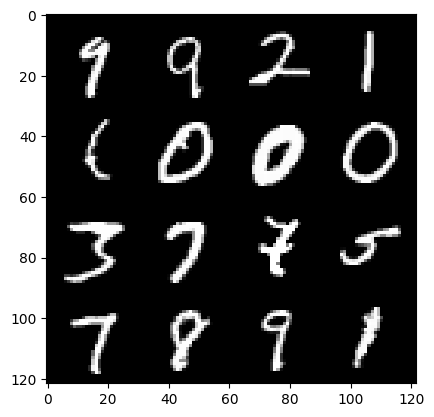

64:step 30300 / Gen loss: 3.9851015019416804 / Disc loss: 0.10180641518284875


  0%|          | 0/469 [00:00<?, ?it/s]

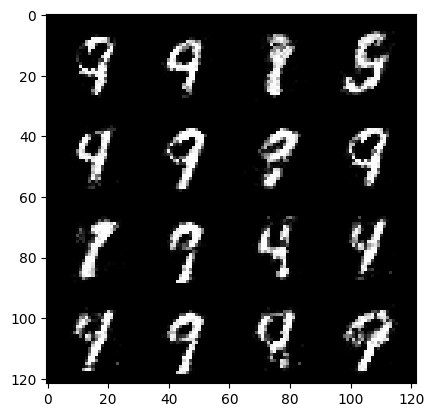

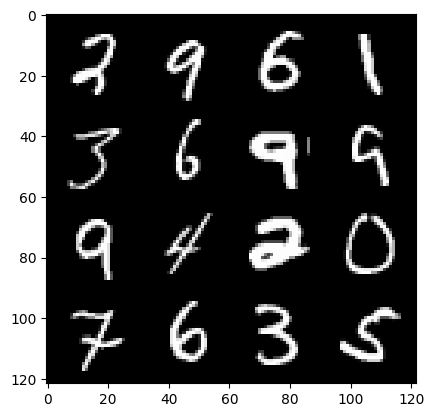

65:step 30600 / Gen loss: 3.9325079059600823 / Disc loss: 0.11235776814321677


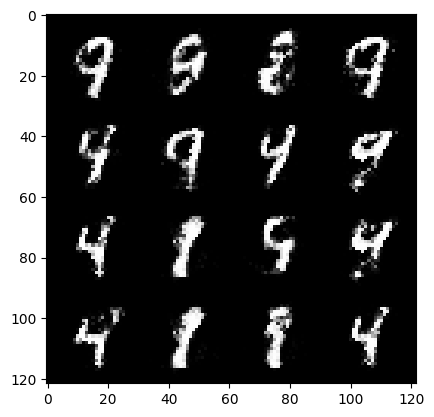

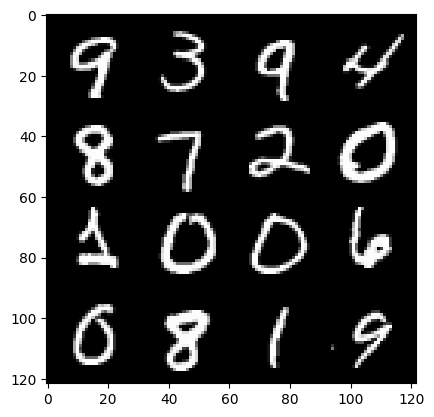

65:step 30900 / Gen loss: 3.851242965062457 / Disc loss: 0.11214580234140153


  0%|          | 0/469 [00:00<?, ?it/s]

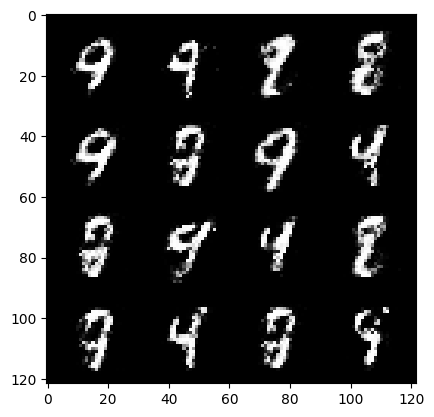

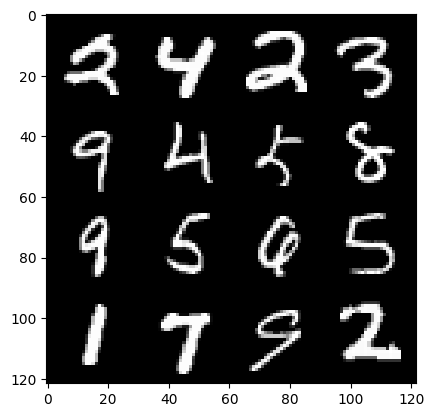

66:step 31200 / Gen loss: 3.890542039076486 / Disc loss: 0.11084135433038073


  0%|          | 0/469 [00:00<?, ?it/s]

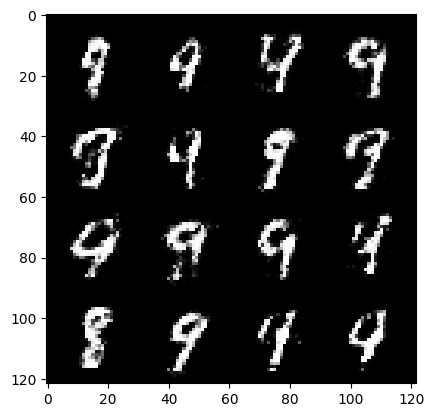

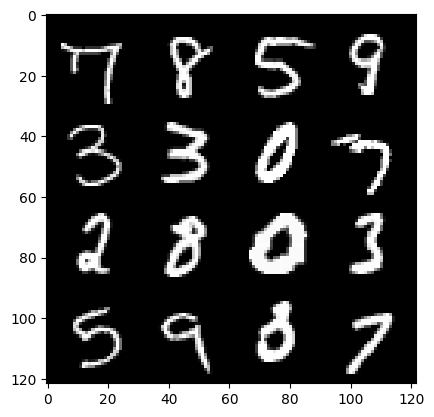

67:step 31500 / Gen loss: 3.806737128098805 / Disc loss: 0.11811331015080209


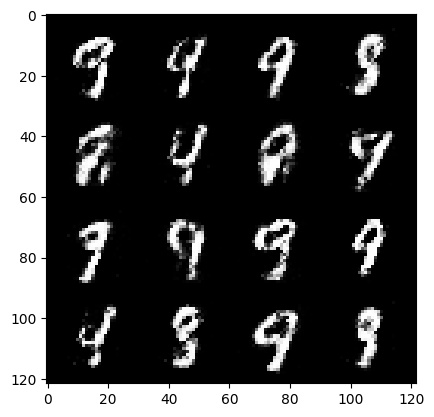

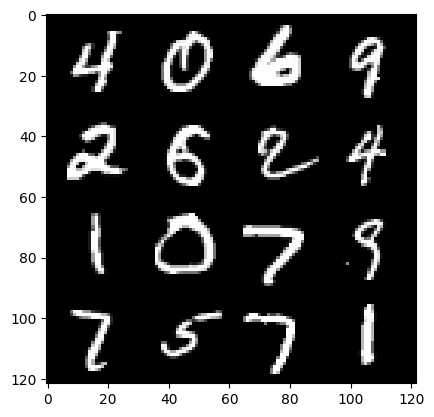

67:step 31800 / Gen loss: 3.6765827695528657 / Disc loss: 0.12232193176945055


  0%|          | 0/469 [00:00<?, ?it/s]

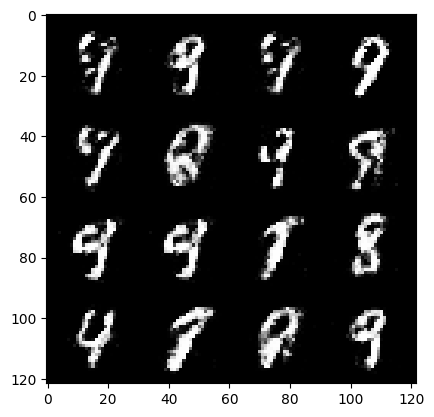

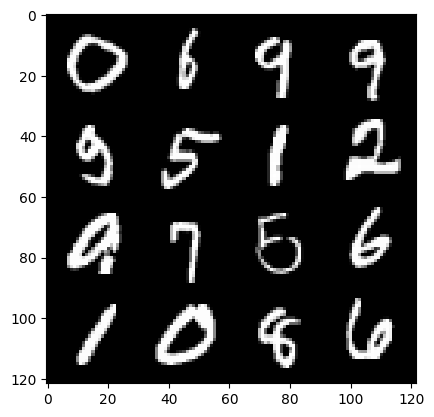

68:step 32100 / Gen loss: 3.4115189441045177 / Disc loss: 0.15878691251079247


  0%|          | 0/469 [00:00<?, ?it/s]

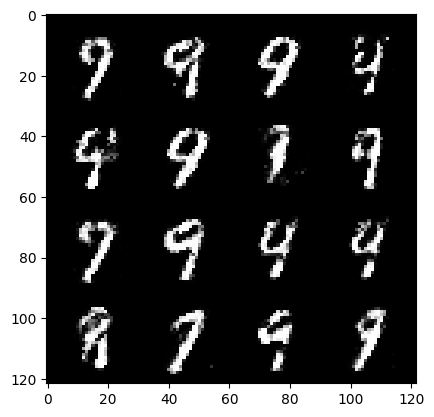

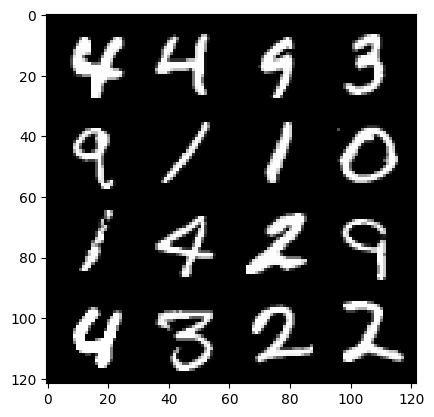

69:step 32400 / Gen loss: 3.365326890150707 / Disc loss: 0.13863064875205364


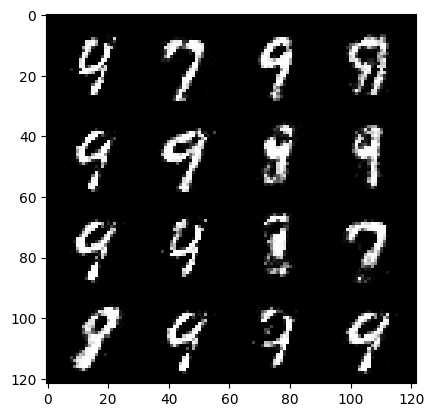

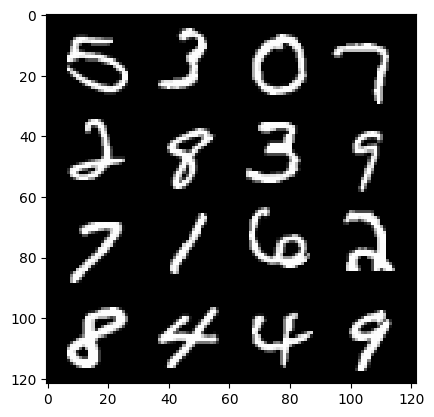

69:step 32700 / Gen loss: 3.380362983544667 / Disc loss: 0.15501309538880986


  0%|          | 0/469 [00:00<?, ?it/s]

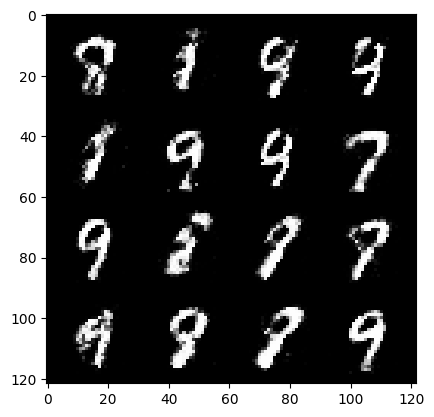

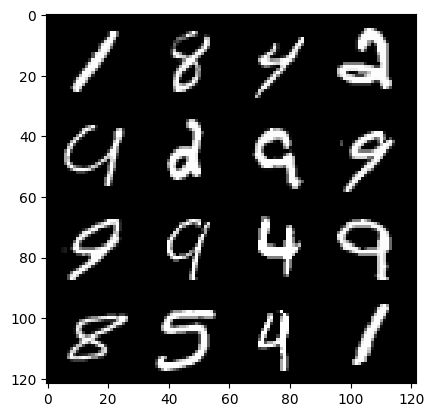

70:step 33000 / Gen loss: 3.328617793718971 / Disc loss: 0.14633057904740177


  0%|          | 0/469 [00:00<?, ?it/s]

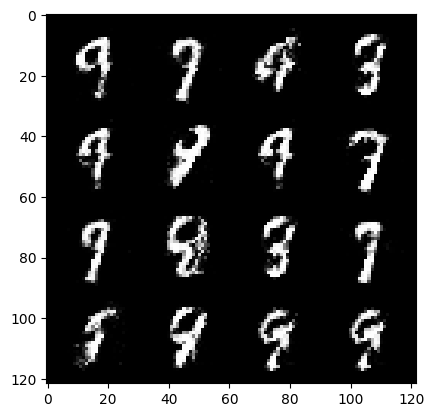

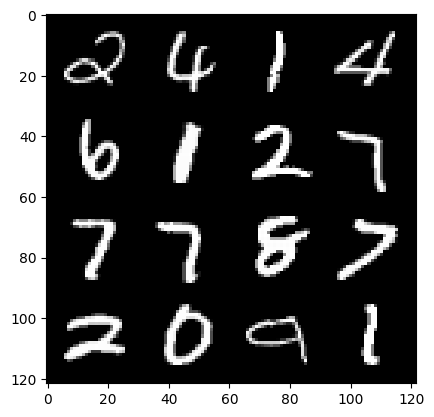

71:step 33300 / Gen loss: 3.3880388792355856 / Disc loss: 0.1487116245428722


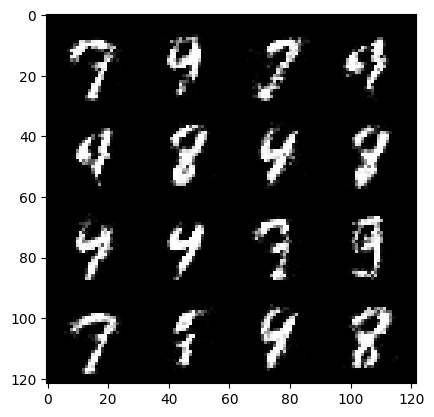

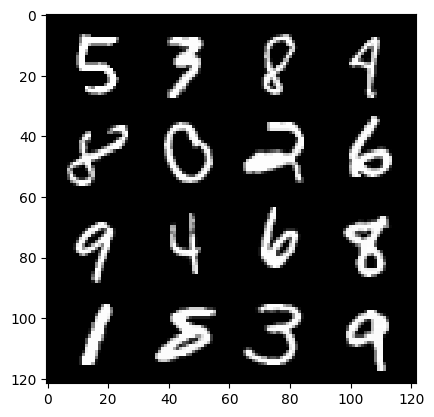

71:step 33600 / Gen loss: 3.630325952370958 / Disc loss: 0.1377242822572588


  0%|          | 0/469 [00:00<?, ?it/s]

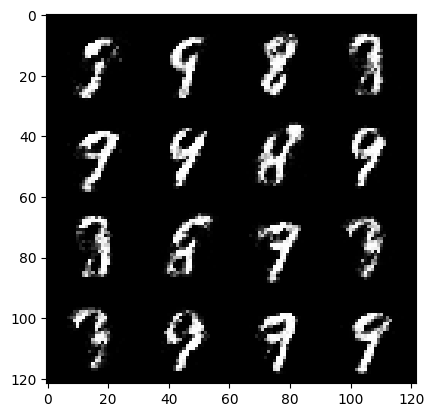

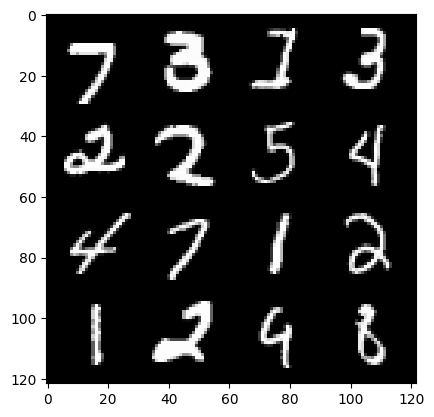

72:step 33900 / Gen loss: 3.5038778893152887 / Disc loss: 0.15172498365243273


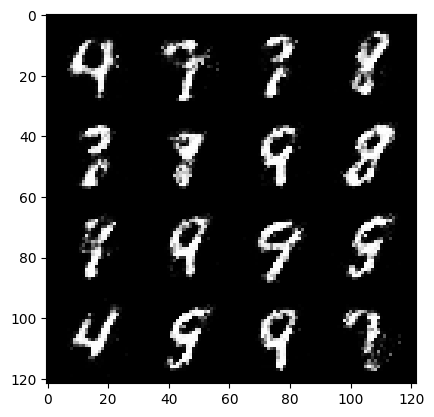

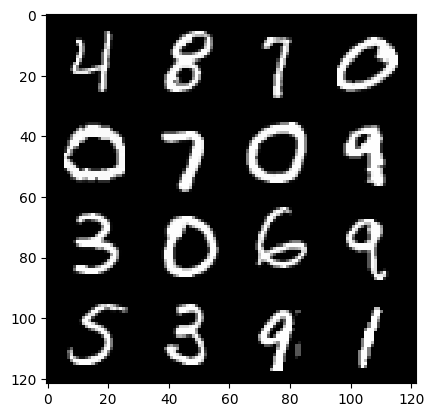

72:step 34200 / Gen loss: 3.531571792761486 / Disc loss: 0.1511995502809684


  0%|          | 0/469 [00:00<?, ?it/s]

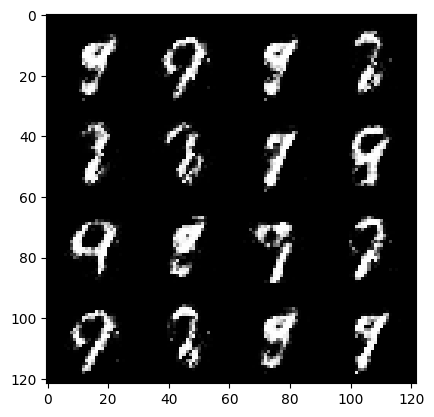

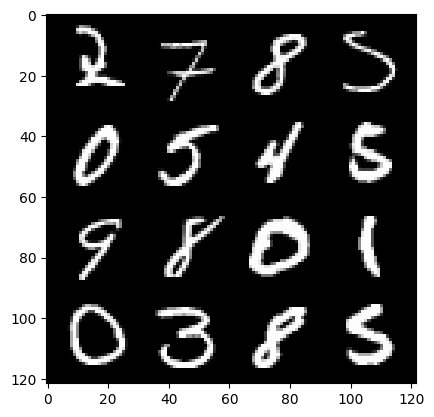

73:step 34500 / Gen loss: 3.416511370340983 / Disc loss: 0.15831542953848846


  0%|          | 0/469 [00:00<?, ?it/s]

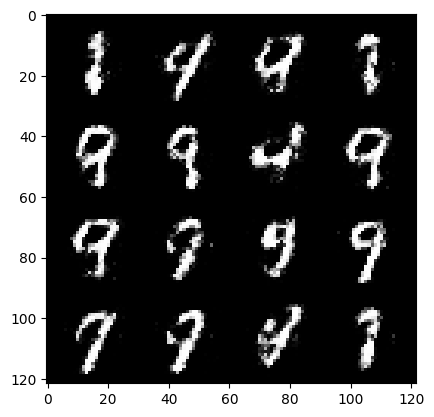

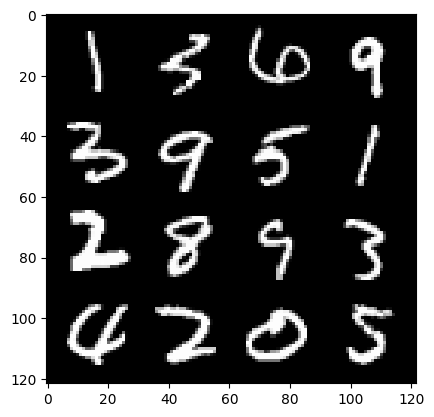

74:step 34800 / Gen loss: 3.2905022589365616 / Disc loss: 0.15755738111833728


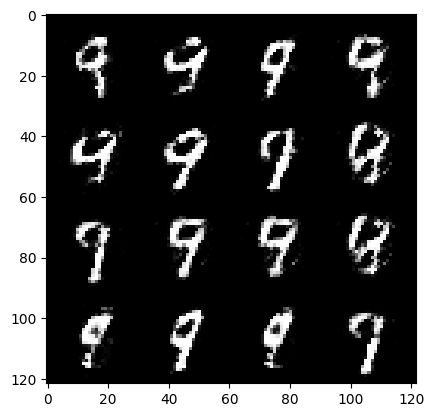

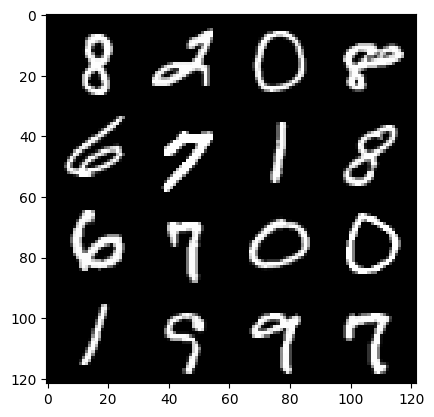

74:step 35100 / Gen loss: 3.329775563081104 / Disc loss: 0.1566531608998776


  0%|          | 0/469 [00:00<?, ?it/s]

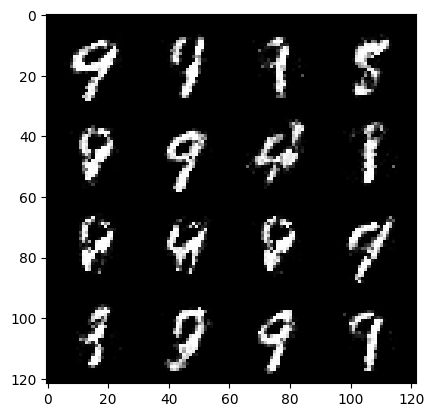

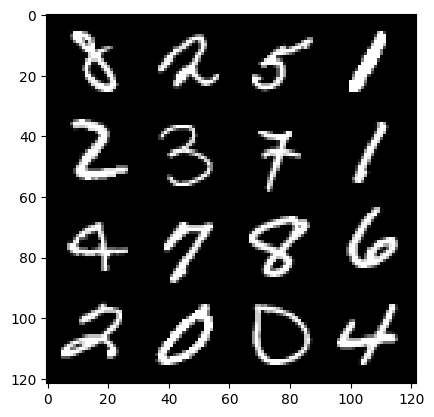

75:step 35400 / Gen loss: 3.36501380999883 / Disc loss: 0.1451702028264603


  0%|          | 0/469 [00:00<?, ?it/s]

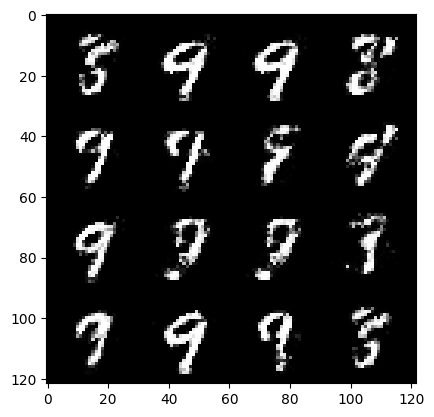

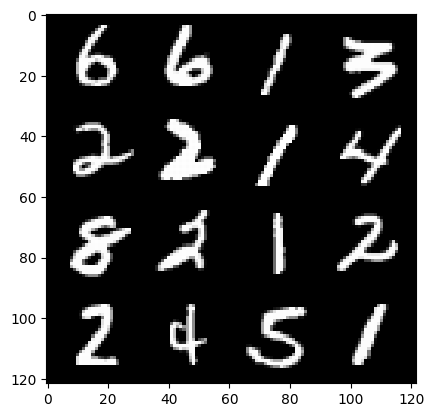

76:step 35700 / Gen loss: 3.3477274115880347 / Disc loss: 0.16025693545738867


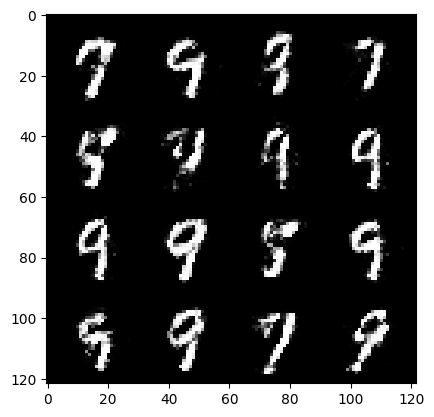

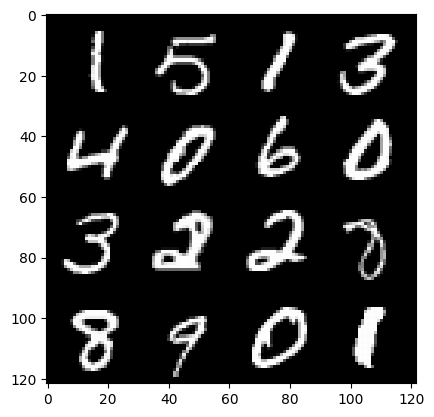

76:step 36000 / Gen loss: 3.2749711481730155 / Disc loss: 0.15836193871994808


  0%|          | 0/469 [00:00<?, ?it/s]

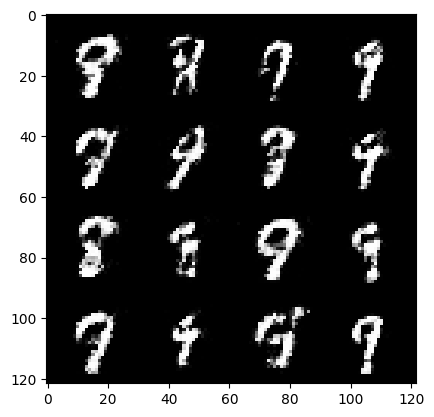

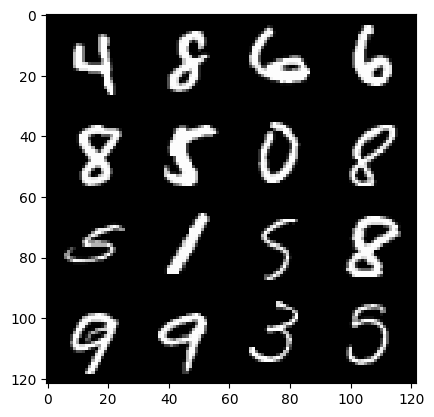

77:step 36300 / Gen loss: 3.2422287623087556 / Disc loss: 0.16883038575450593


  0%|          | 0/469 [00:00<?, ?it/s]

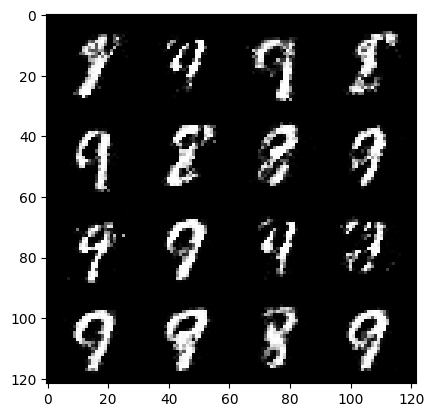

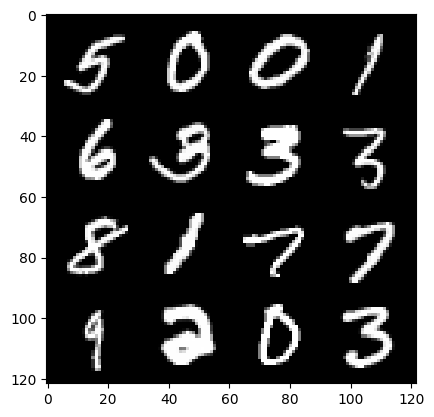

78:step 36600 / Gen loss: 3.2142430559794106 / Disc loss: 0.16534715078771134


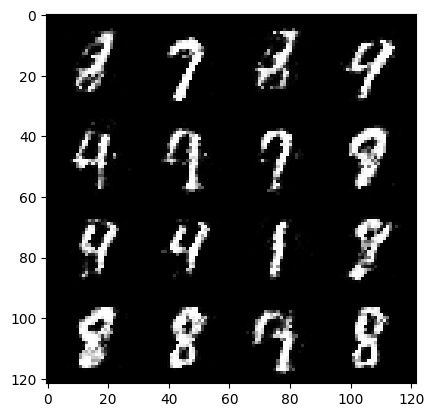

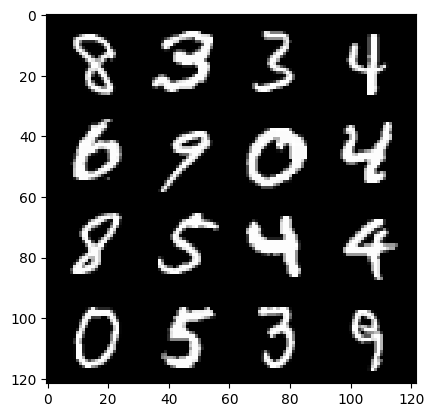

78:step 36900 / Gen loss: 3.522385080655416 / Disc loss: 0.13729084193706503


  0%|          | 0/469 [00:00<?, ?it/s]

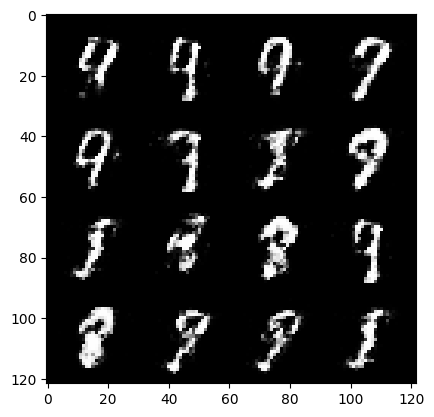

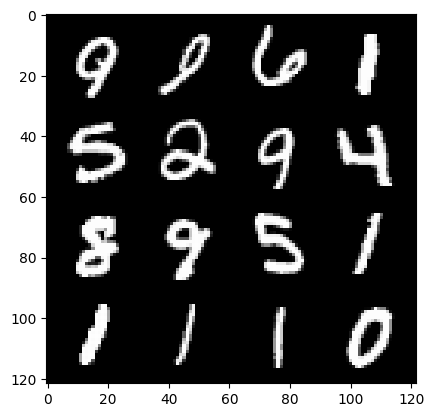

79:step 37200 / Gen loss: 3.2213806343078604 / Disc loss: 0.15957016679147884


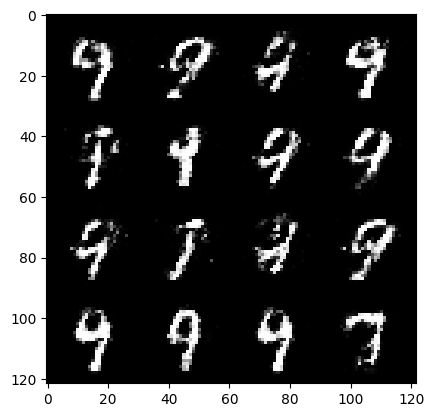

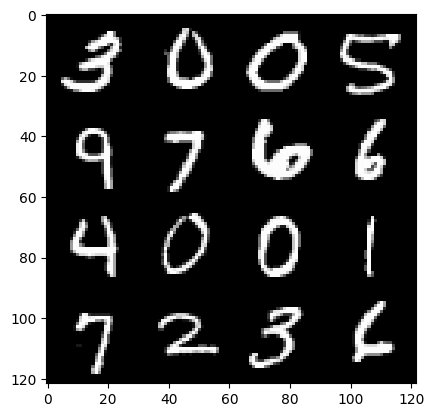

79:step 37500 / Gen loss: 3.200340531667073 / Disc loss: 0.15788584083318696


  0%|          | 0/469 [00:00<?, ?it/s]

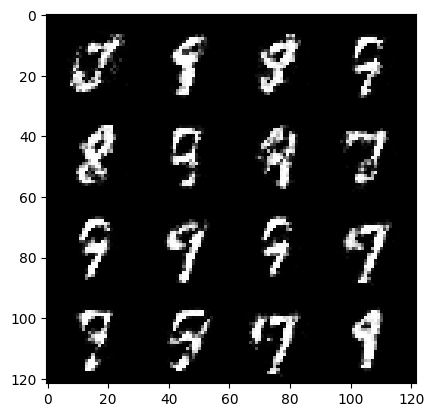

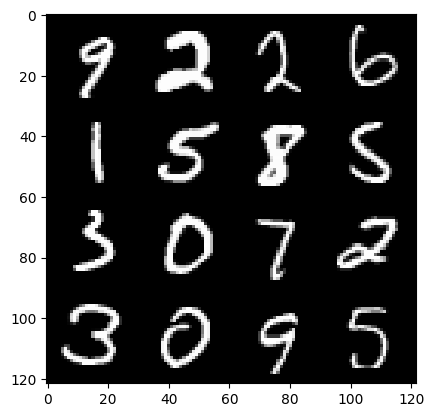

80:step 37800 / Gen loss: 3.1020862913131744 / Disc loss: 0.1733485161016385


  0%|          | 0/469 [00:00<?, ?it/s]

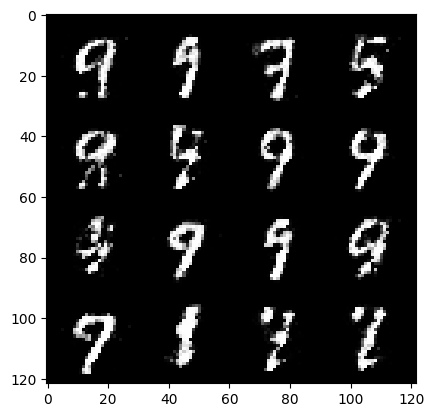

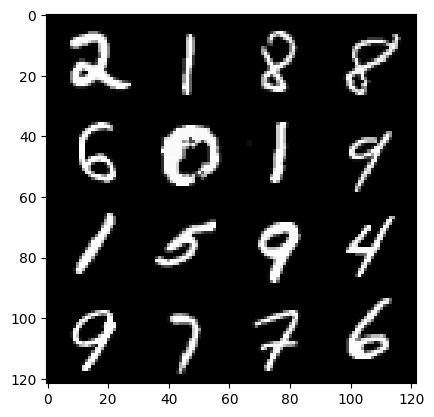

81:step 38100 / Gen loss: 3.0544382516543096 / Disc loss: 0.18218933127820486


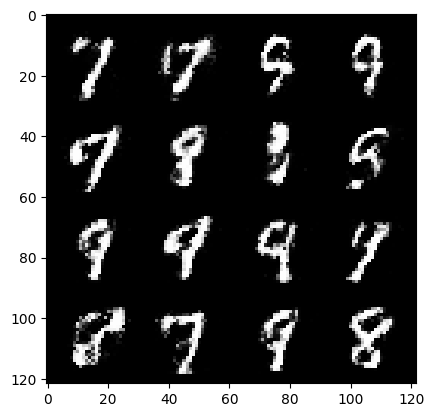

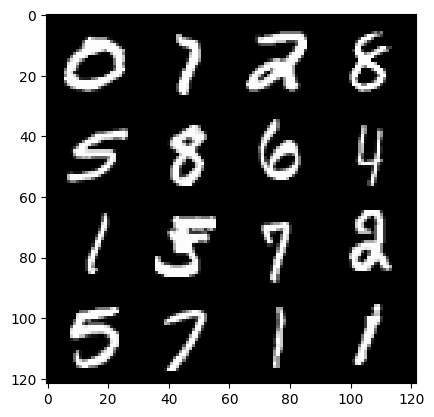

81:step 38400 / Gen loss: 3.1265183663368235 / Disc loss: 0.1608783382674059


  0%|          | 0/469 [00:00<?, ?it/s]

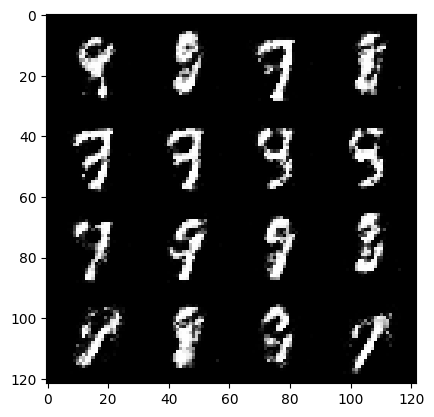

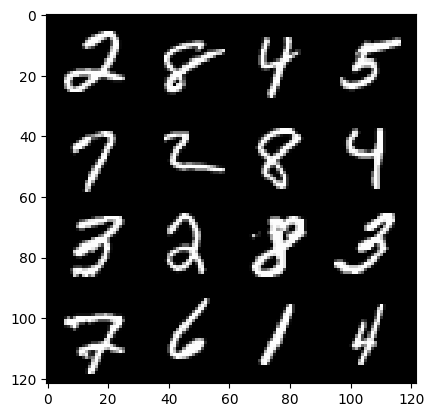

82:step 38700 / Gen loss: 3.141970518430074 / Disc loss: 0.15820094674825674


  0%|          | 0/469 [00:00<?, ?it/s]

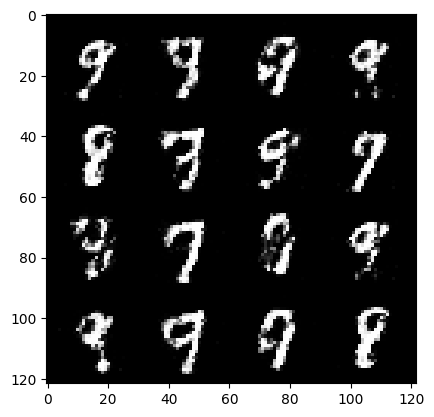

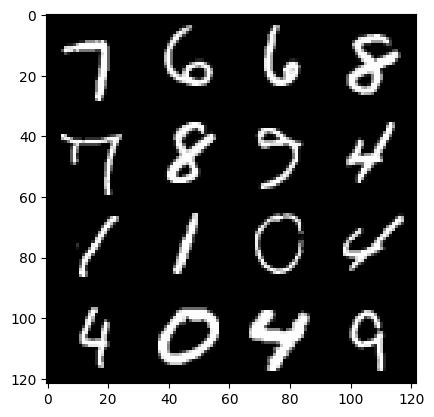

83:step 39000 / Gen loss: 3.3554593396186827 / Disc loss: 0.14026761593918002


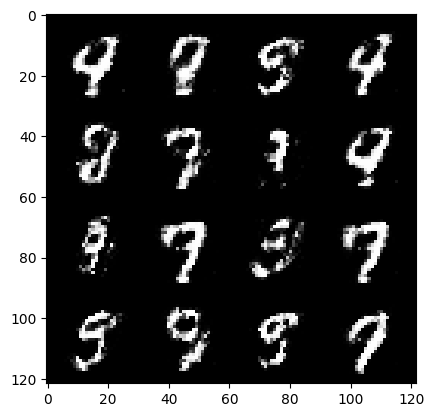

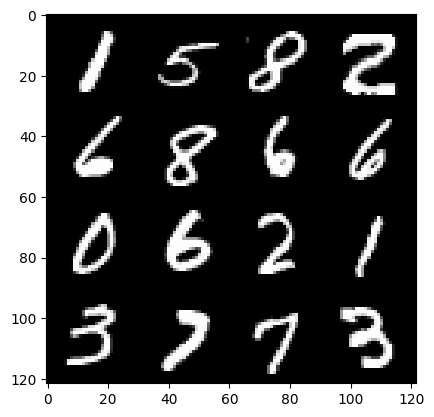

83:step 39300 / Gen loss: 3.252635811964671 / Disc loss: 0.15688855667909


  0%|          | 0/469 [00:00<?, ?it/s]

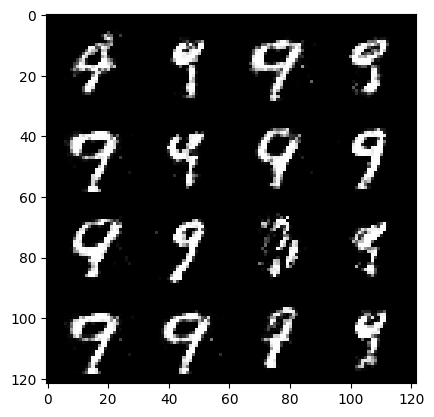

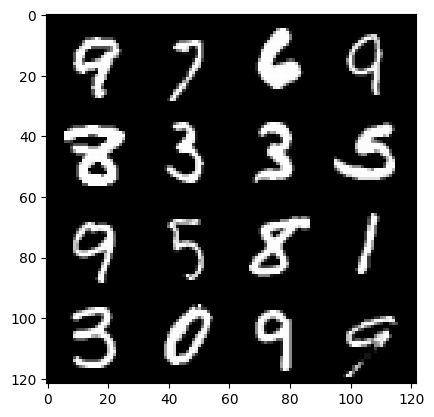

84:step 39600 / Gen loss: 3.0825180482864383 / Disc loss: 0.15780155894656975


  0%|          | 0/469 [00:00<?, ?it/s]

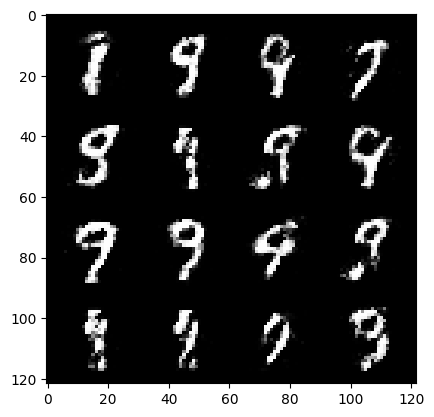

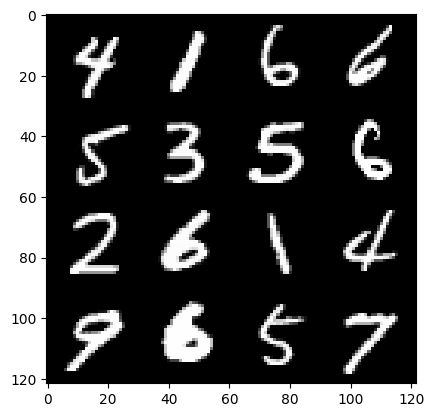

85:step 39900 / Gen loss: 3.2573357439041133 / Disc loss: 0.15279459456602726


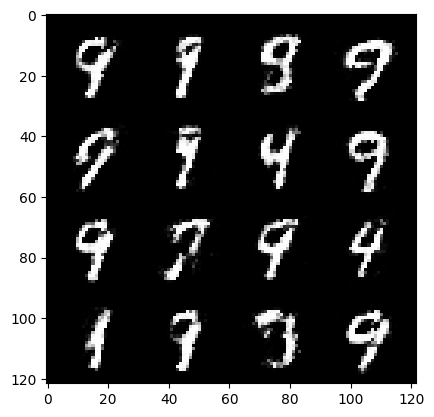

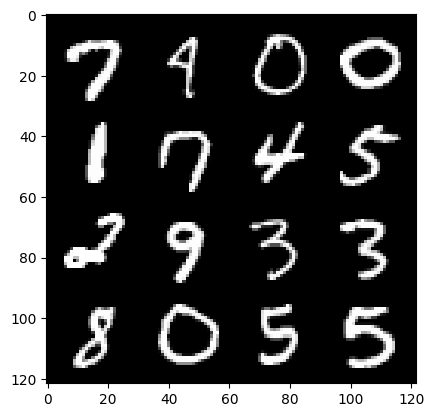

85:step 40200 / Gen loss: 3.066727151075999 / Disc loss: 0.163876080562671


  0%|          | 0/469 [00:00<?, ?it/s]

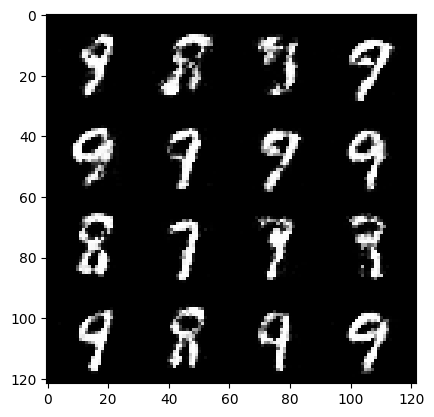

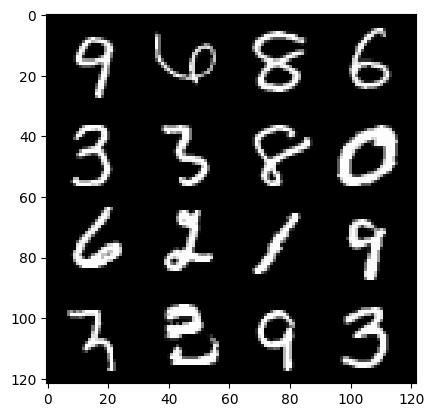

86:step 40500 / Gen loss: 3.0867223628362006 / Disc loss: 0.17617331601679323


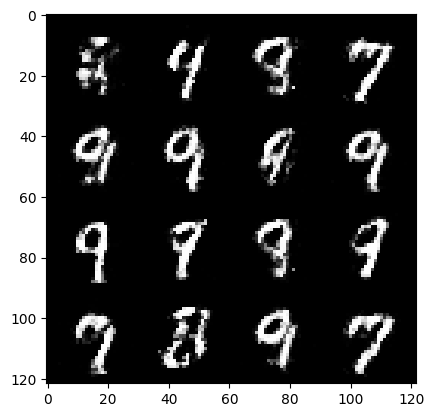

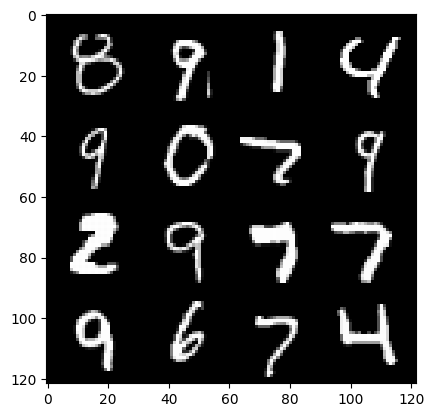

86:step 40800 / Gen loss: 2.945575408935544 / Disc loss: 0.20250621477762862


  0%|          | 0/469 [00:00<?, ?it/s]

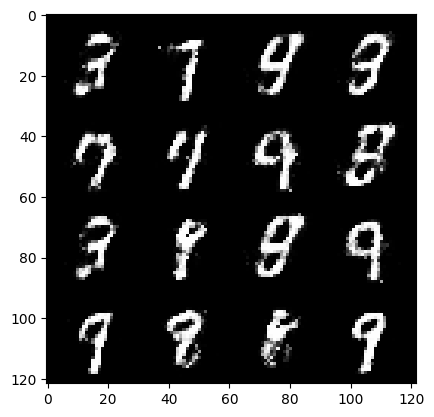

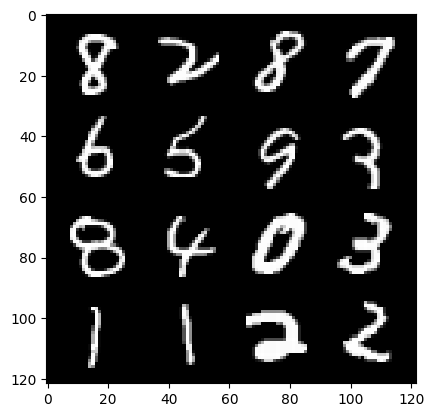

87:step 41100 / Gen loss: 2.778911250432333 / Disc loss: 0.21179958708584312


  0%|          | 0/469 [00:00<?, ?it/s]

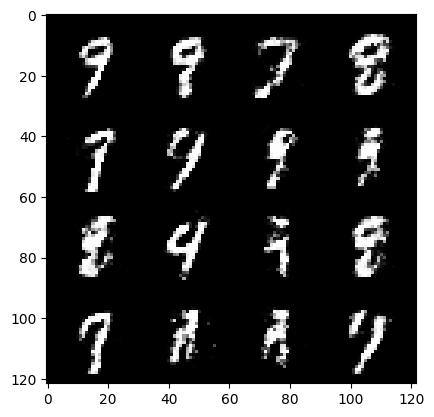

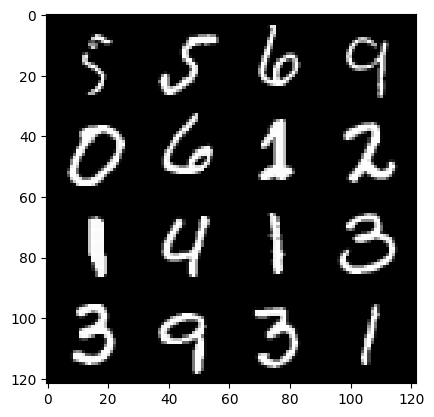

88:step 41400 / Gen loss: 2.857555799484253 / Disc loss: 0.19015285454690467


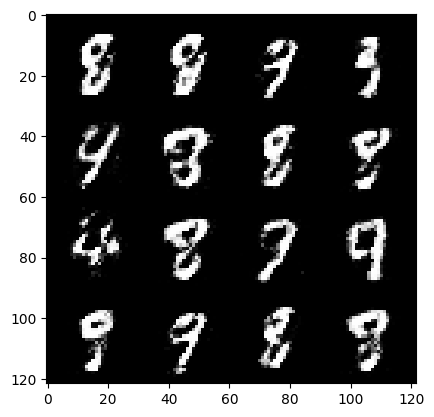

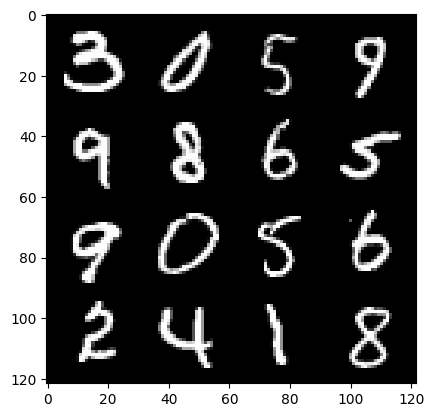

88:step 41700 / Gen loss: 2.8493688273429862 / Disc loss: 0.20426312434176616


  0%|          | 0/469 [00:00<?, ?it/s]

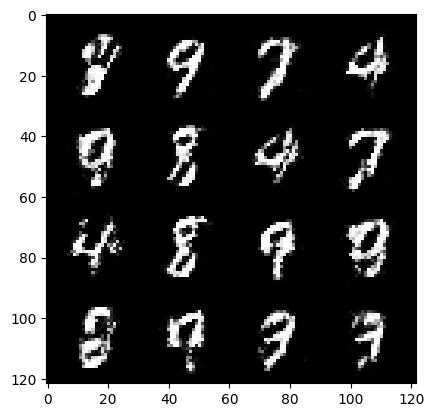

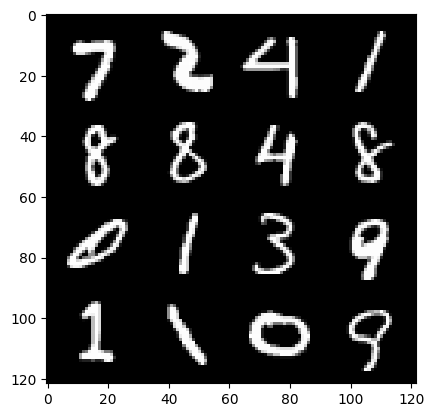

89:step 42000 / Gen loss: 2.9692446859677624 / Disc loss: 0.17697255045175556


  0%|          | 0/469 [00:00<?, ?it/s]

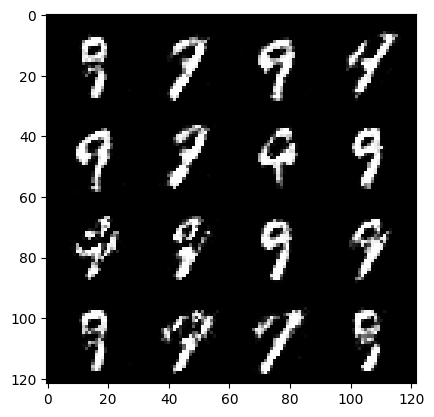

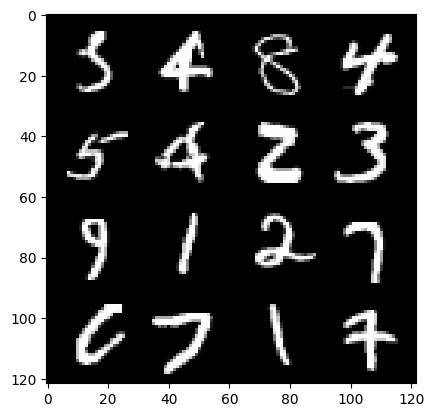

90:step 42300 / Gen loss: 3.117940131028494 / Disc loss: 0.1568611671278875


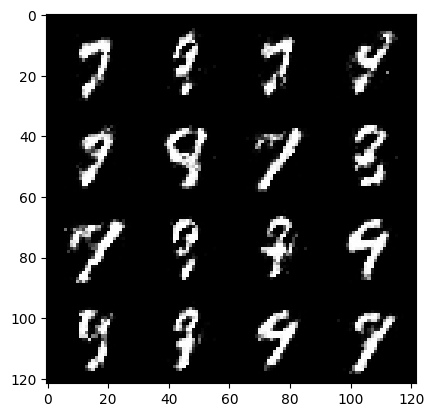

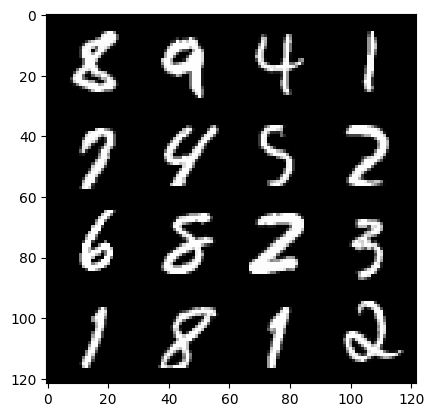

90:step 42600 / Gen loss: 2.9373602819442723 / Disc loss: 0.1786791239182154


  0%|          | 0/469 [00:00<?, ?it/s]

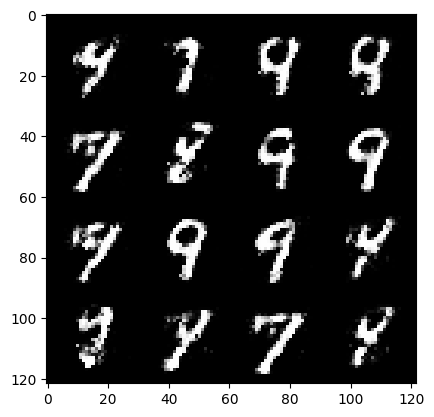

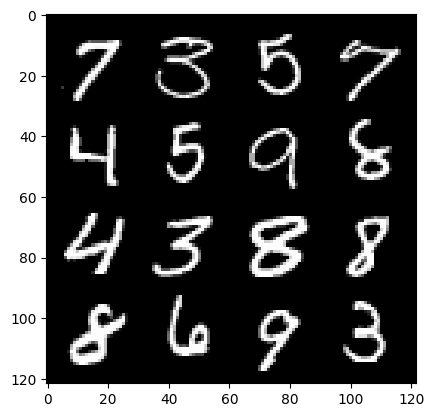

91:step 42900 / Gen loss: 3.0645712733268735 / Disc loss: 0.15672280209759865


  0%|          | 0/469 [00:00<?, ?it/s]

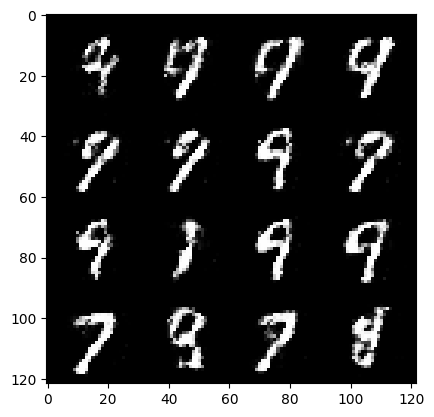

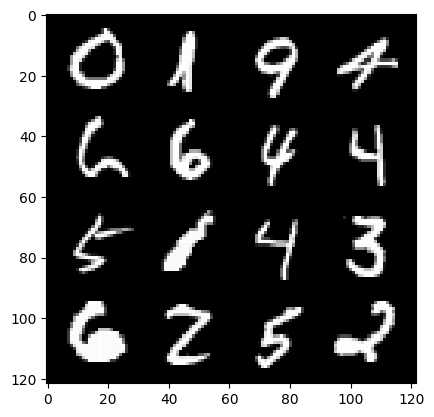

92:step 43200 / Gen loss: 3.086977047125499 / Disc loss: 0.16768214531242856


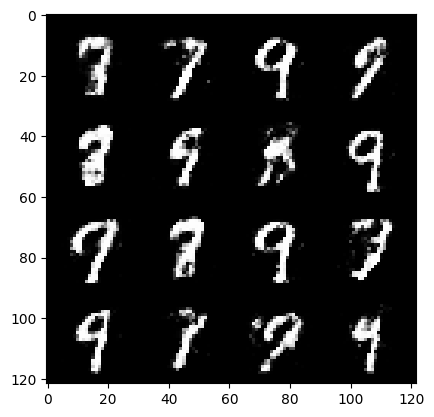

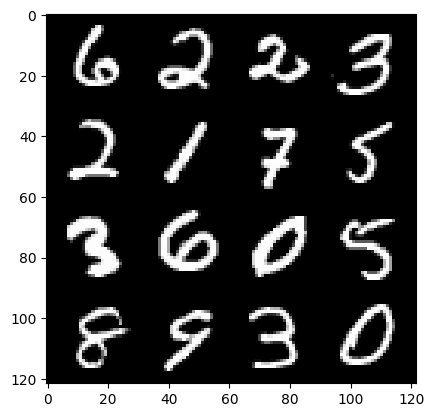

92:step 43500 / Gen loss: 2.8772907551129663 / Disc loss: 0.18476336901386592


  0%|          | 0/469 [00:00<?, ?it/s]

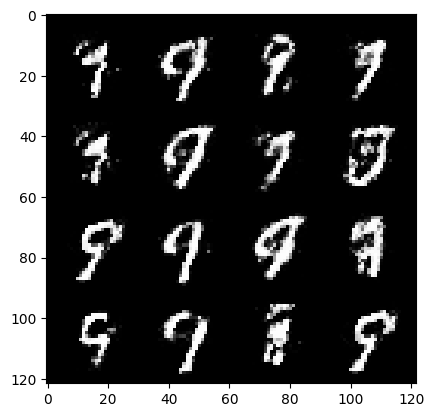

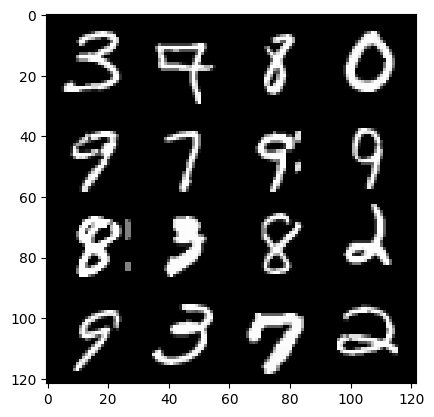

93:step 43800 / Gen loss: 2.936877582073214 / Disc loss: 0.1918154306461414


  0%|          | 0/469 [00:00<?, ?it/s]

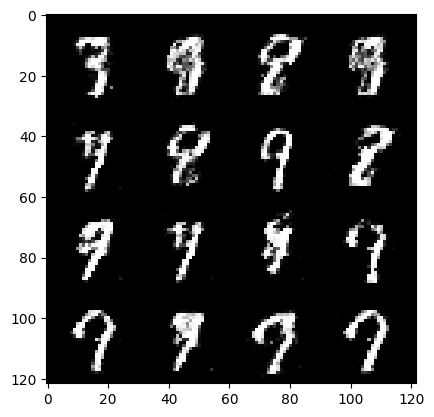

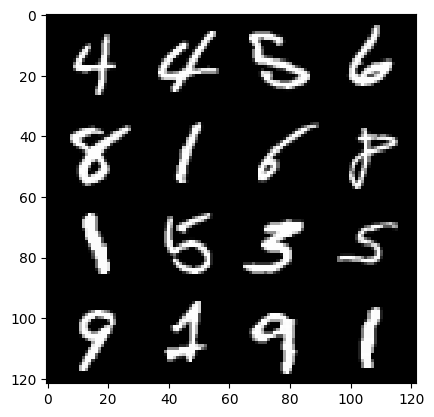

94:step 44100 / Gen loss: 2.6891735355059283 / Disc loss: 0.20923264985283221


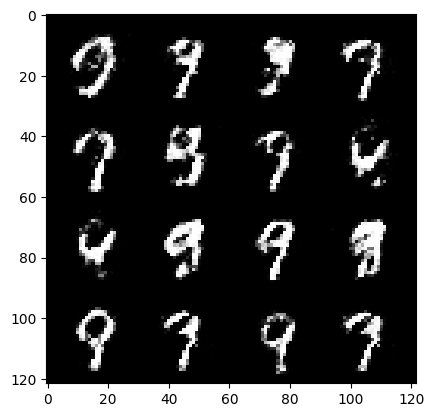

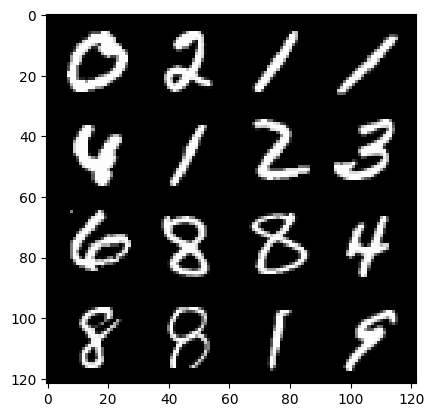

94:step 44400 / Gen loss: 2.71690497716268 / Disc loss: 0.20618702953060475


  0%|          | 0/469 [00:00<?, ?it/s]

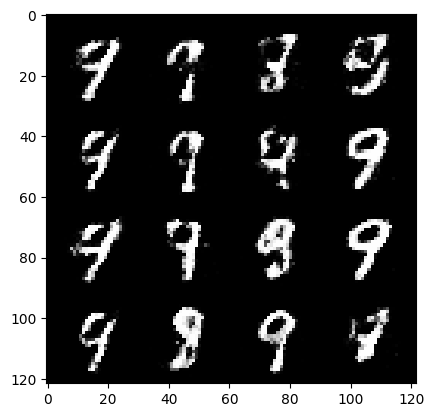

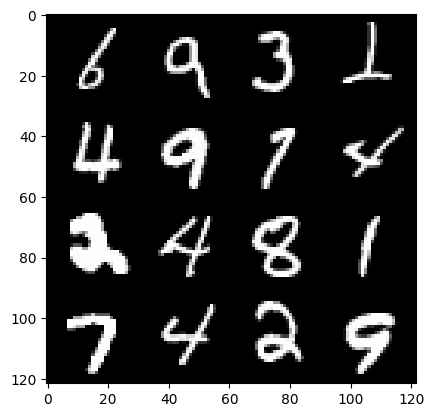

95:step 44700 / Gen loss: 2.784400329589841 / Disc loss: 0.19580699833730858


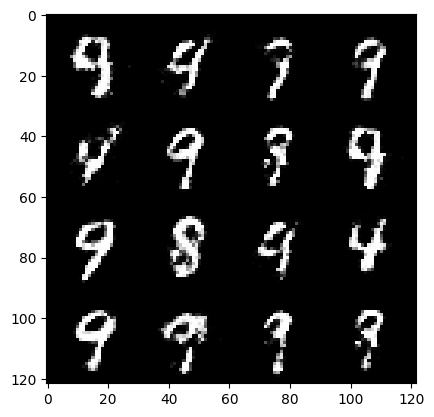

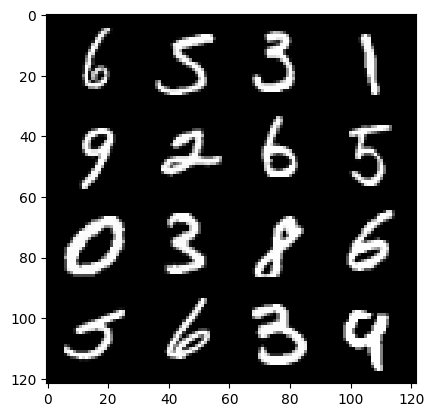

95:step 45000 / Gen loss: 2.783400171597797 / Disc loss: 0.1970734981199107


  0%|          | 0/469 [00:00<?, ?it/s]

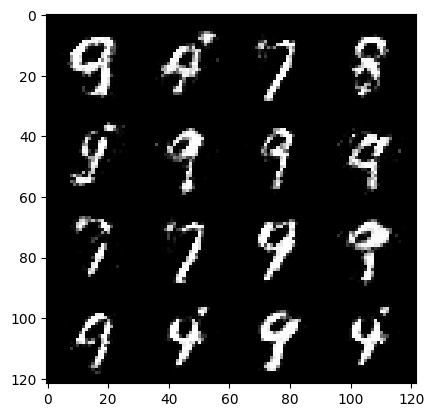

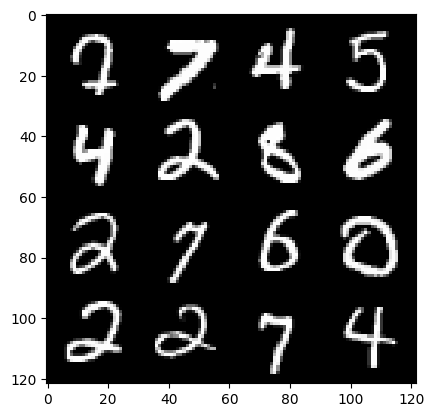

96:step 45300 / Gen loss: 2.7312620115280155 / Disc loss: 0.20851809402306873


  0%|          | 0/469 [00:00<?, ?it/s]

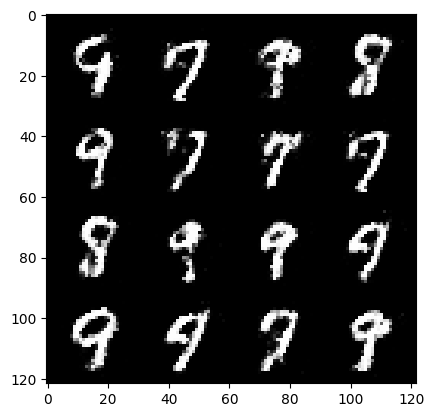

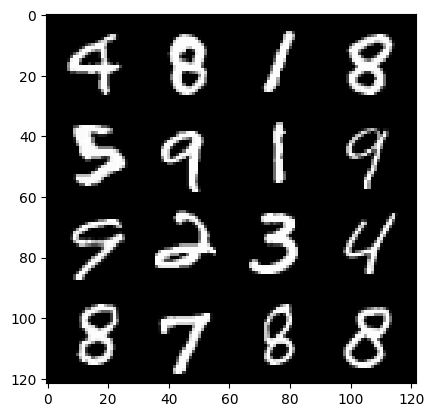

97:step 45600 / Gen loss: 2.7461524677276588 / Disc loss: 0.20870890463391942


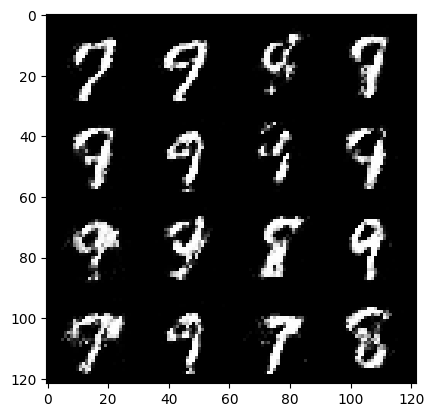

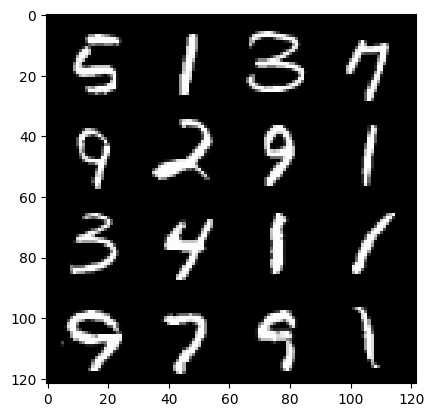

97:step 45900 / Gen loss: 2.8447407492001844 / Disc loss: 0.18816686570644384


  0%|          | 0/469 [00:00<?, ?it/s]

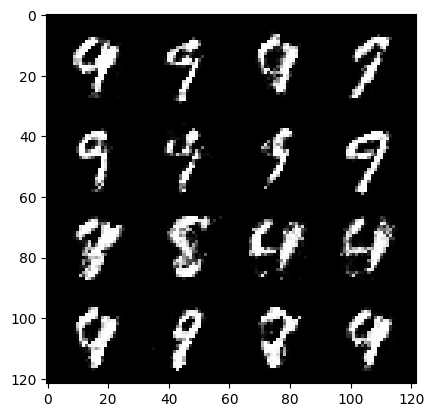

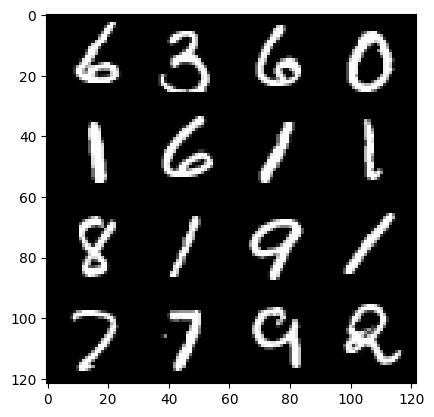

98:step 46200 / Gen loss: 2.8038189633687343 / Disc loss: 0.20381855544944605


  0%|          | 0/469 [00:00<?, ?it/s]

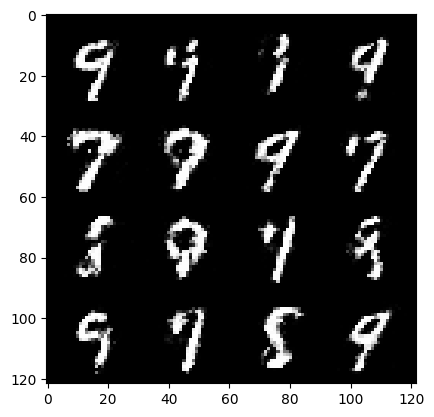

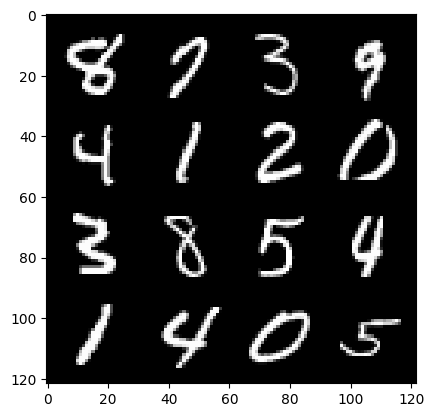

99:step 46500 / Gen loss: 2.6733711246649428 / Disc loss: 0.22155947779615712


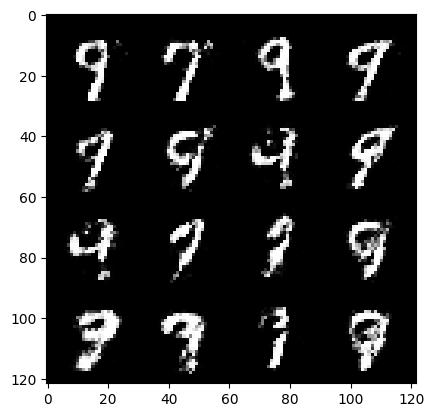

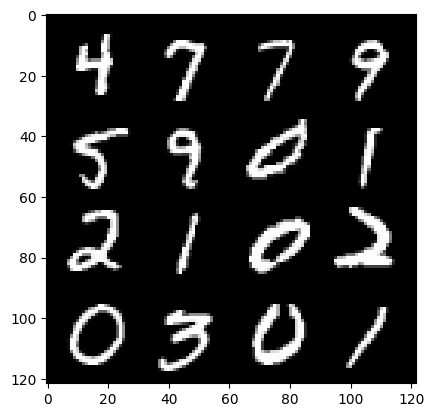

99:step 46800 / Gen loss: 2.6628447500864665 / Disc loss: 0.22852008367578178


  0%|          | 0/469 [00:00<?, ?it/s]

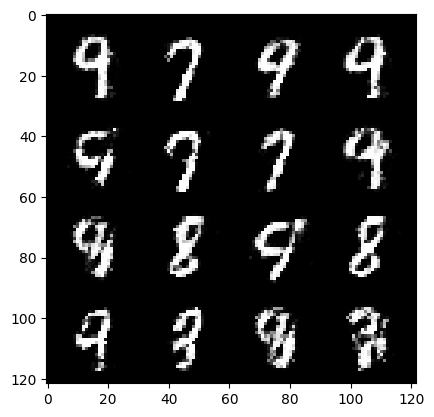

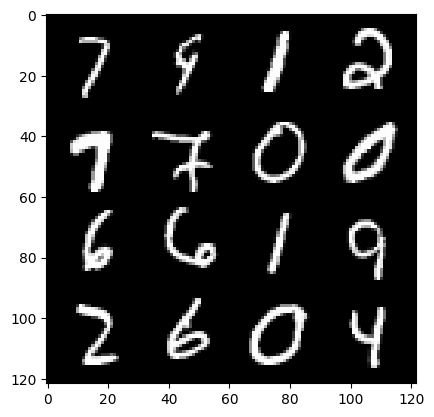

100:step 47100 / Gen loss: 2.57884714682897 / Disc loss: 0.22783408805727953


  0%|          | 0/469 [00:00<?, ?it/s]

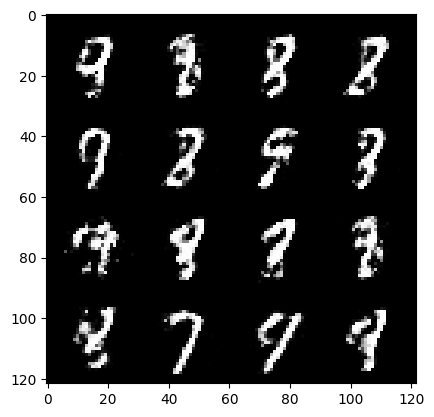

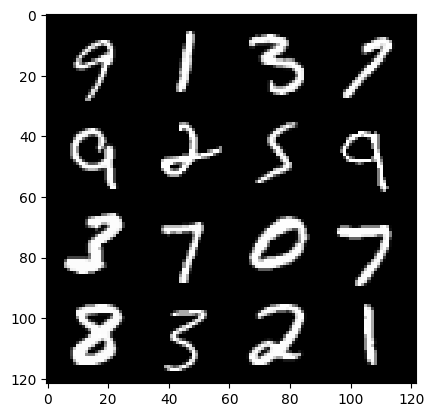

101:step 47400 / Gen loss: 2.668952697118124 / Disc loss: 0.21153317506114624


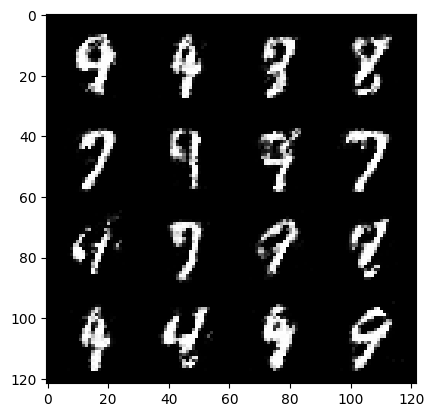

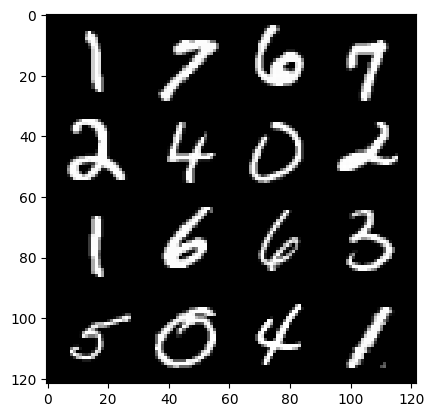

101:step 47700 / Gen loss: 2.666055568059285 / Disc loss: 0.210407700240612


  0%|          | 0/469 [00:00<?, ?it/s]

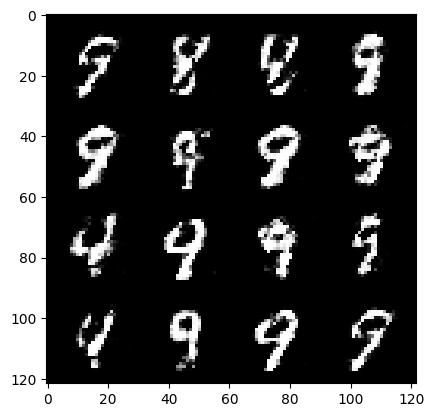

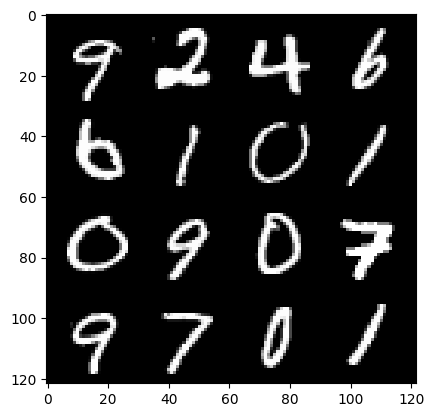

102:step 48000 / Gen loss: 2.6126623336474113 / Disc loss: 0.21500324229399354


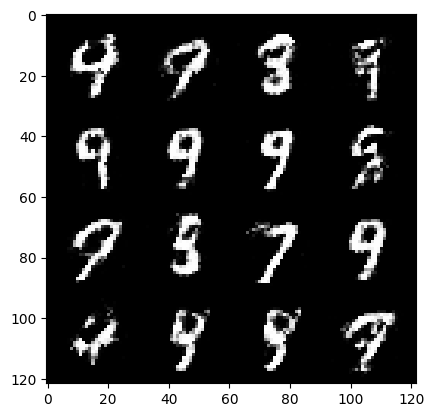

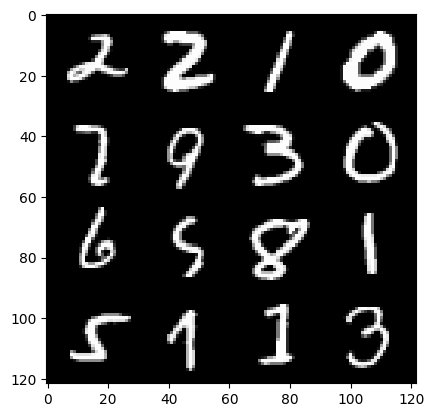

102:step 48300 / Gen loss: 2.6744583741823837 / Disc loss: 0.19815487382312622


  0%|          | 0/469 [00:00<?, ?it/s]

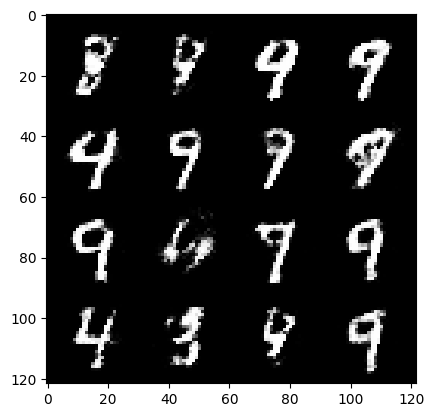

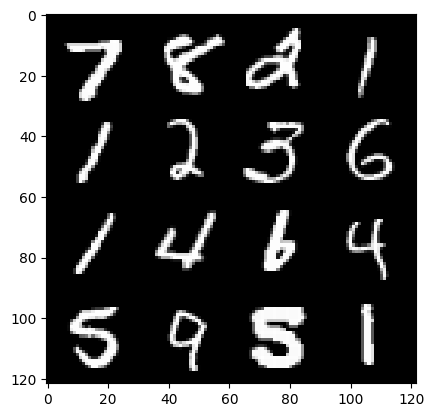

103:step 48600 / Gen loss: 2.583753536542257 / Disc loss: 0.24289631520708393


  0%|          | 0/469 [00:00<?, ?it/s]

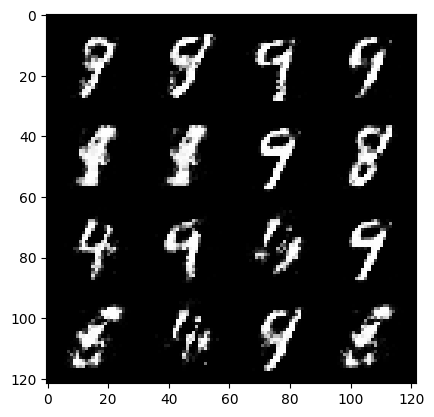

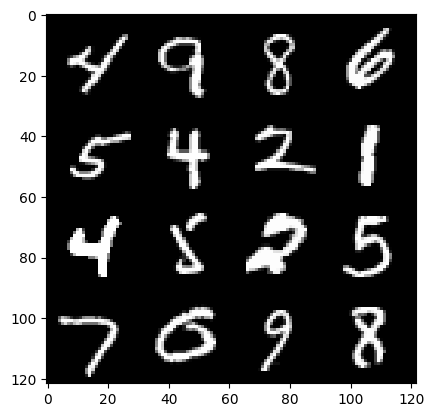

104:step 48900 / Gen loss: 2.4172520975271863 / Disc loss: 0.2669066440562406


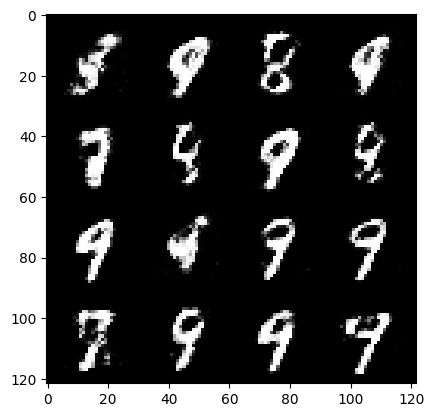

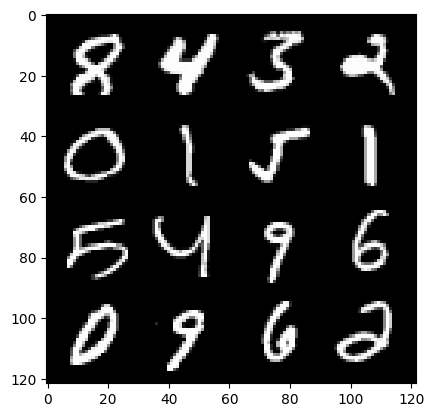

104:step 49200 / Gen loss: 2.4900891423225393 / Disc loss: 0.23519621719916659


  0%|          | 0/469 [00:00<?, ?it/s]

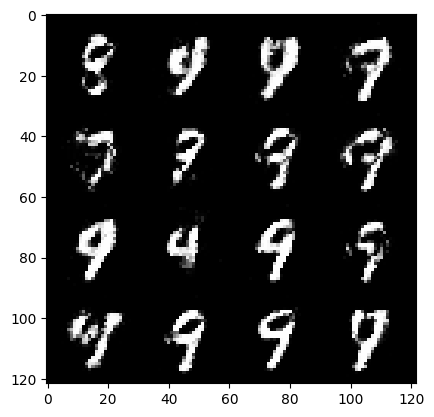

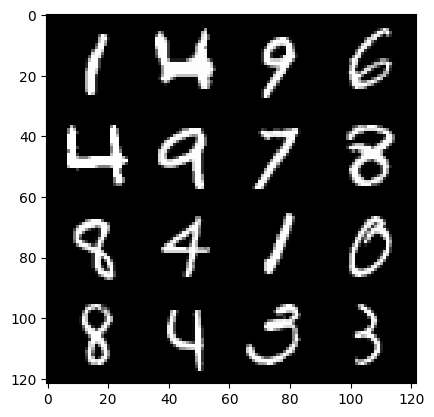

105:step 49500 / Gen loss: 2.5669909016291292 / Disc loss: 0.21786819795767487


  0%|          | 0/469 [00:00<?, ?it/s]

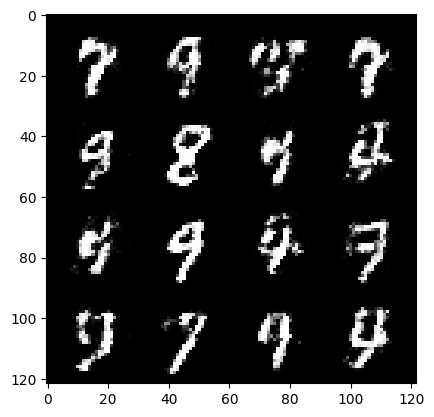

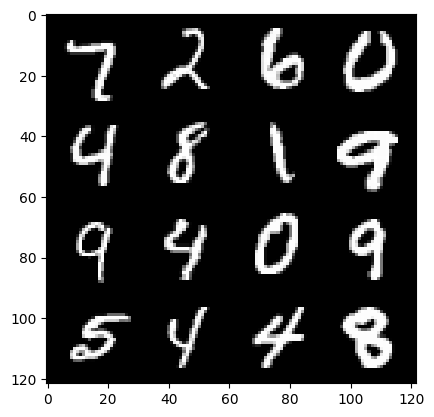

106:step 49800 / Gen loss: 2.6133566999435427 / Disc loss: 0.19982719113429376


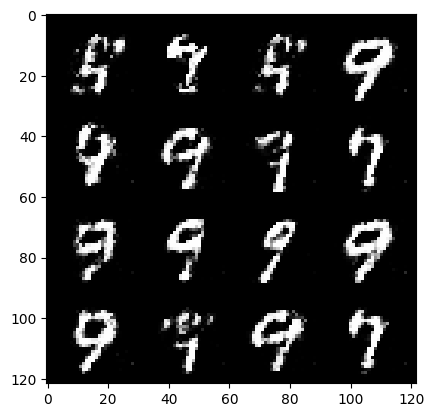

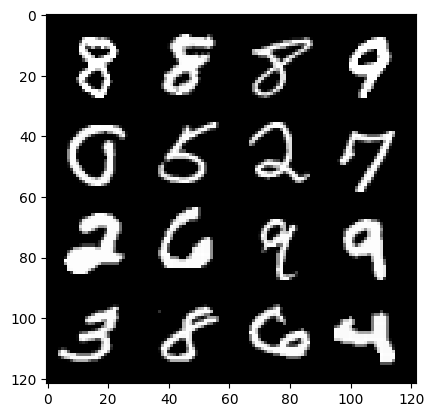

106:step 50100 / Gen loss: 2.626442858378094 / Disc loss: 0.21830245564381284


  0%|          | 0/469 [00:00<?, ?it/s]

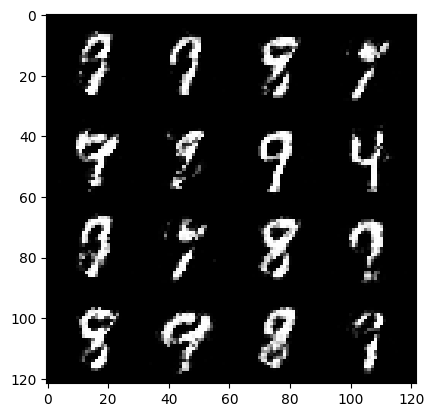

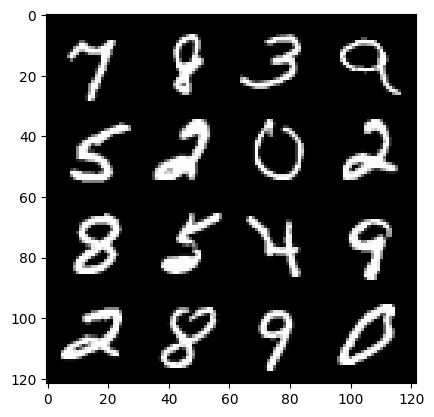

107:step 50400 / Gen loss: 2.568890557686486 / Disc loss: 0.2108499493201573


  0%|          | 0/469 [00:00<?, ?it/s]

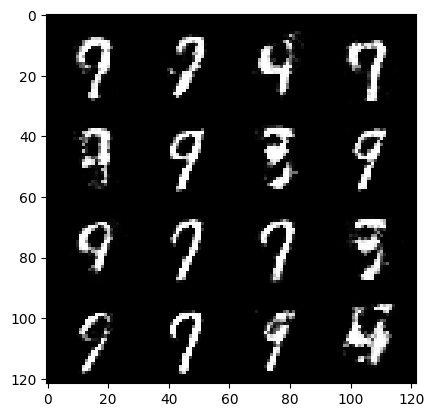

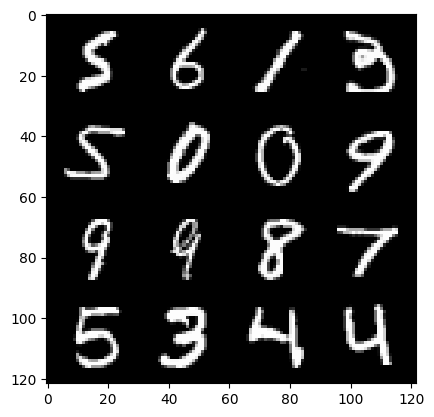

108:step 50700 / Gen loss: 2.548230292797088 / Disc loss: 0.2171468144158522


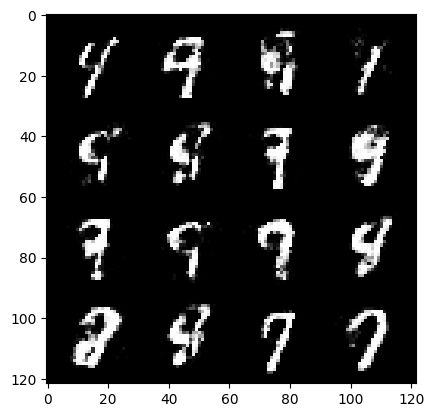

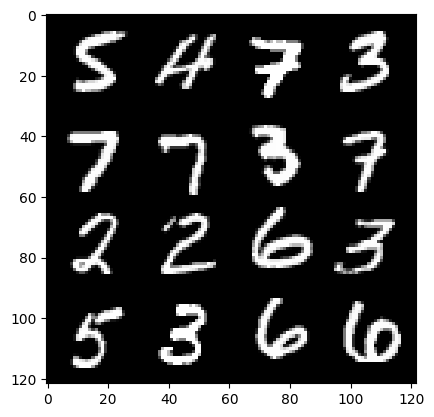

108:step 51000 / Gen loss: 2.573024211327237 / Disc loss: 0.21433238387107853


  0%|          | 0/469 [00:00<?, ?it/s]

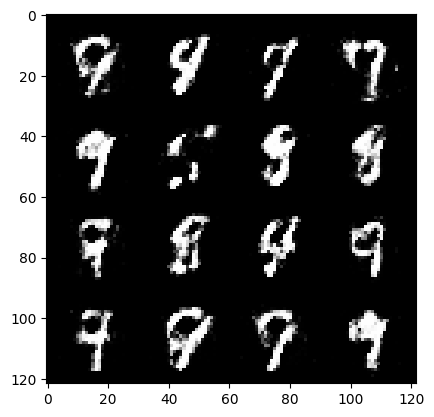

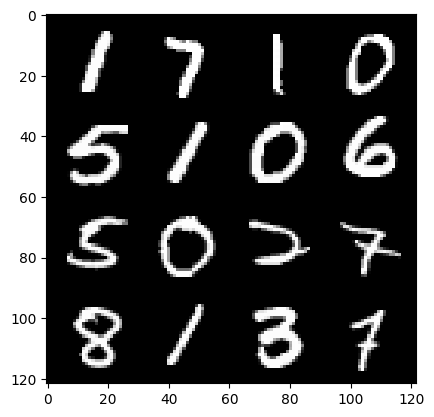

109:step 51300 / Gen loss: 2.6009141993522653 / Disc loss: 0.20767456005016952


  0%|          | 0/469 [00:00<?, ?it/s]

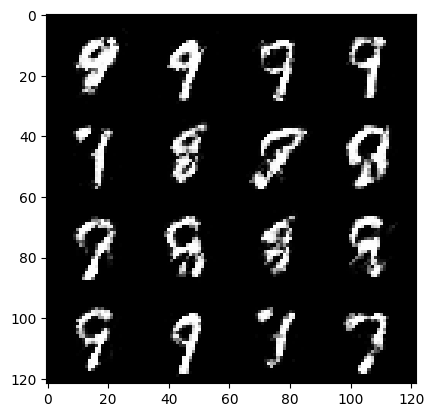

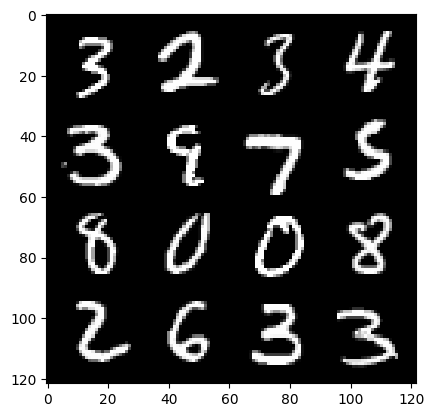

110:step 51600 / Gen loss: 2.6718290837605787 / Disc loss: 0.20040721776584783


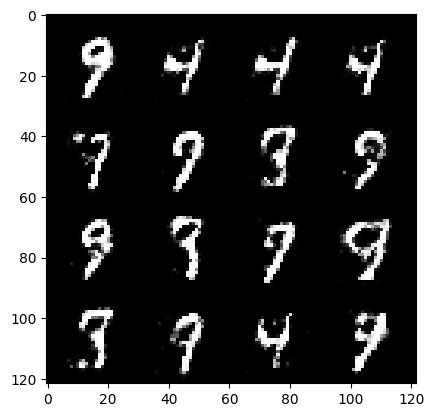

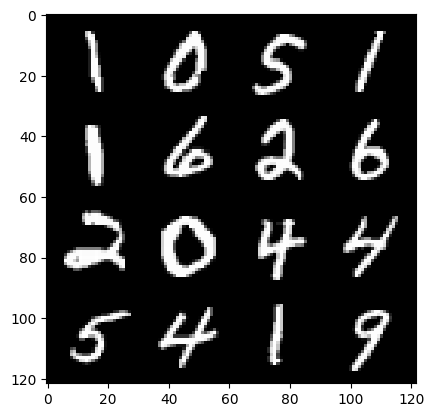

110:step 51900 / Gen loss: 2.6425593177477507 / Disc loss: 0.21032215351859734


  0%|          | 0/469 [00:00<?, ?it/s]

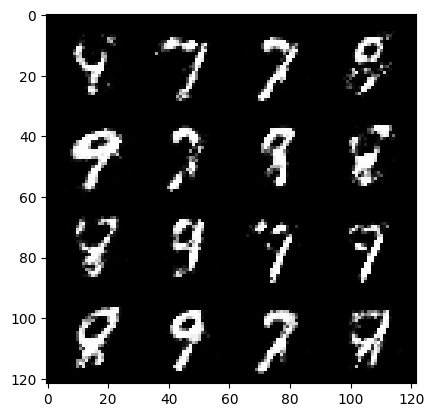

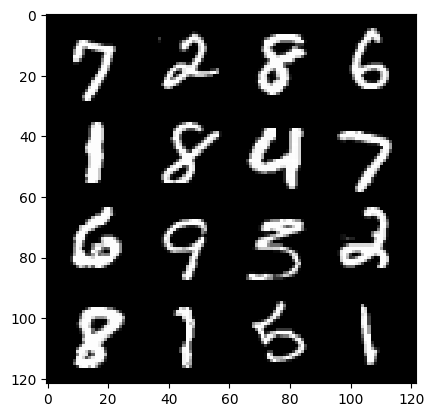

111:step 52200 / Gen loss: 2.632702199220659 / Disc loss: 0.21242374512056508


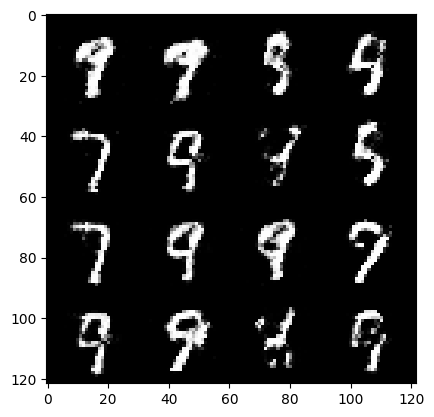

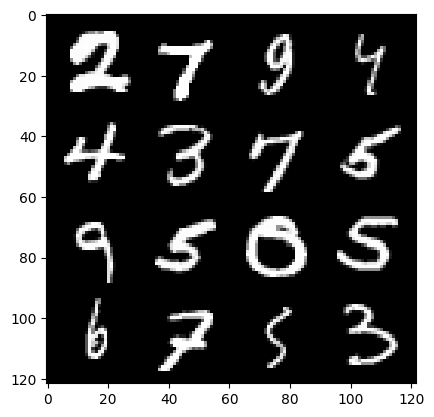

111:step 52500 / Gen loss: 2.546851267019909 / Disc loss: 0.2305247362454733


  0%|          | 0/469 [00:00<?, ?it/s]

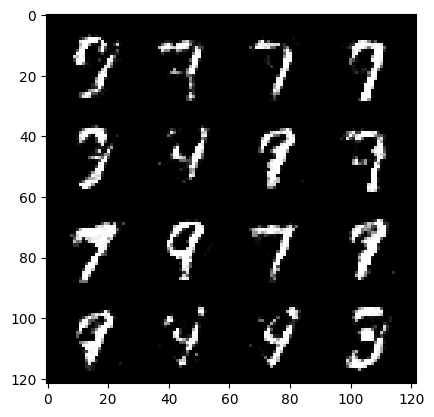

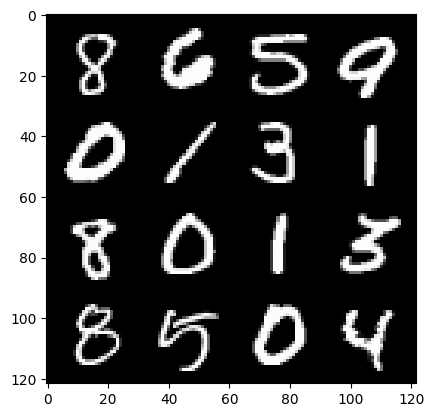

112:step 52800 / Gen loss: 2.384716466665267 / Disc loss: 0.24227293004592265


  0%|          | 0/469 [00:00<?, ?it/s]

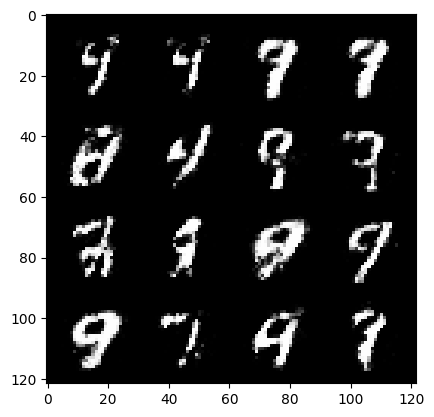

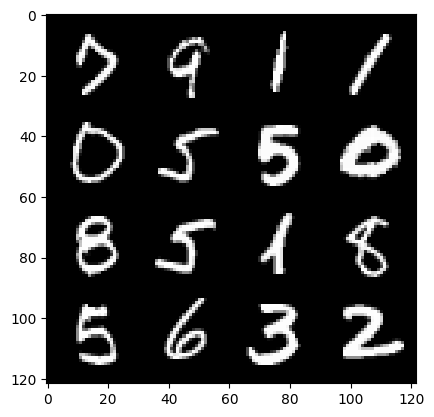

113:step 53100 / Gen loss: 2.501666419506073 / Disc loss: 0.2176952584584554


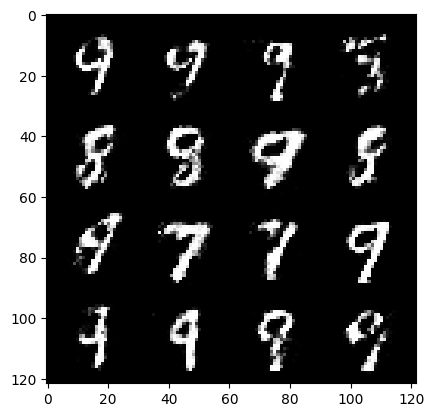

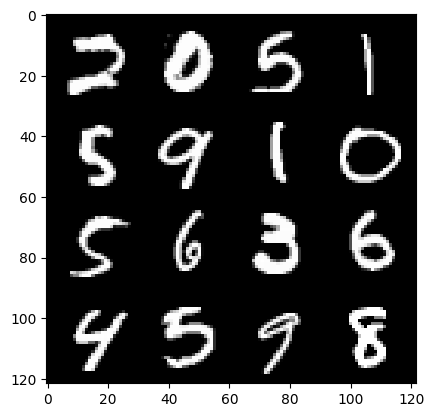

113:step 53400 / Gen loss: 2.361945519049961 / Disc loss: 0.24087458789348606


  0%|          | 0/469 [00:00<?, ?it/s]

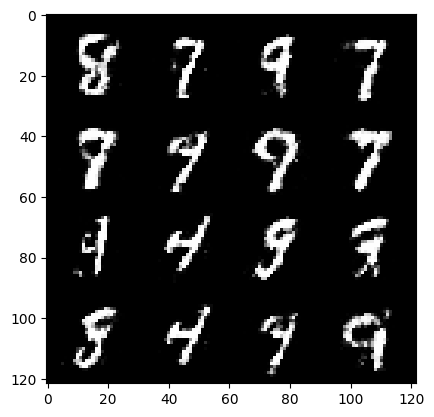

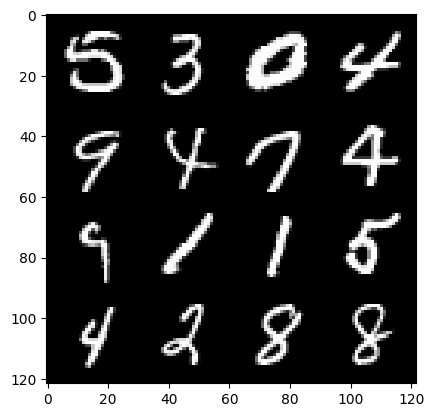

114:step 53700 / Gen loss: 2.451725280284879 / Disc loss: 0.22001217767596254


  0%|          | 0/469 [00:00<?, ?it/s]

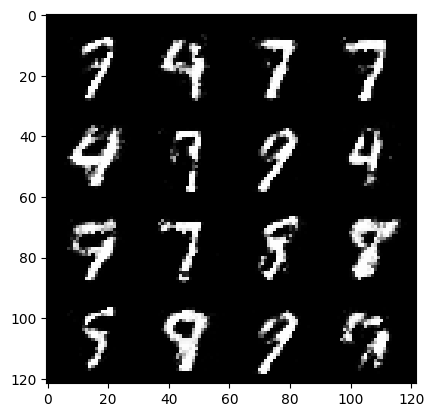

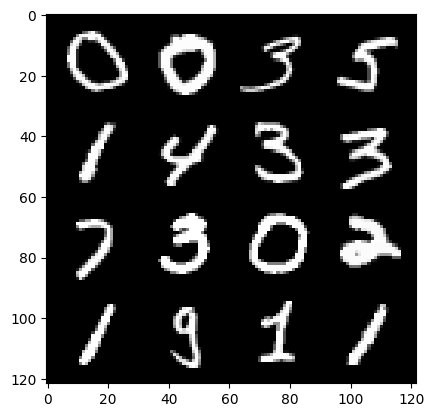

115:step 54000 / Gen loss: 2.495471411148707 / Disc loss: 0.2169988372176887


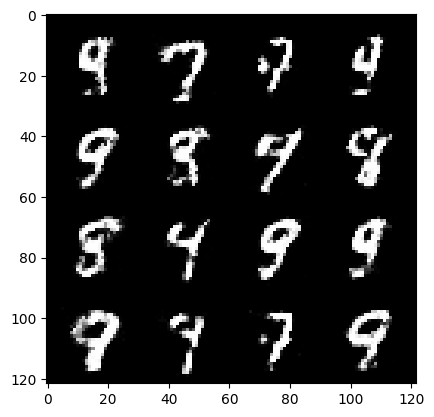

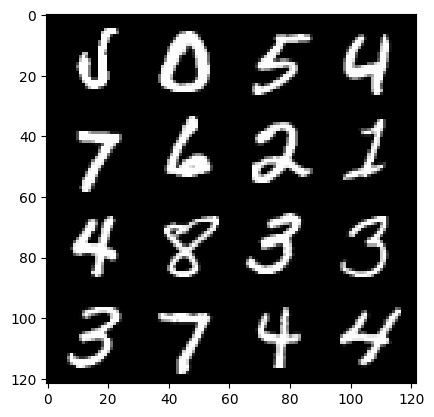

115:step 54300 / Gen loss: 2.440310494502386 / Disc loss: 0.23436661606033635


  0%|          | 0/469 [00:00<?, ?it/s]

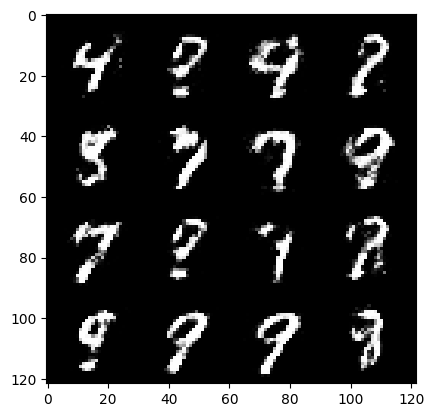

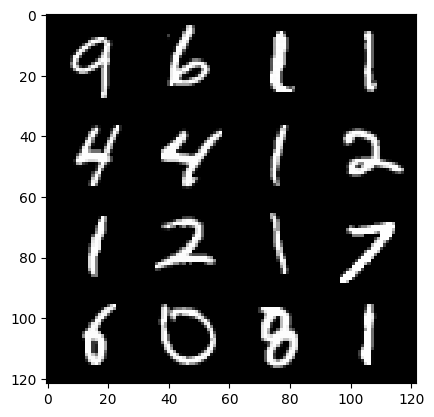

116:step 54600 / Gen loss: 2.457542696793874 / Disc loss: 0.2260650024314725


  0%|          | 0/469 [00:00<?, ?it/s]

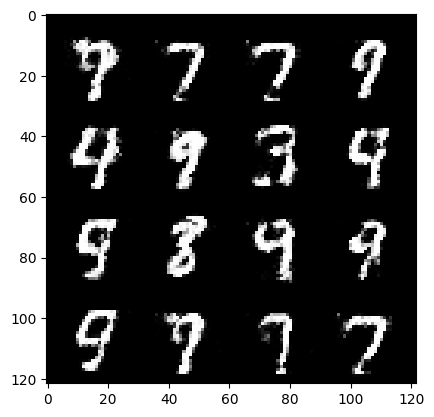

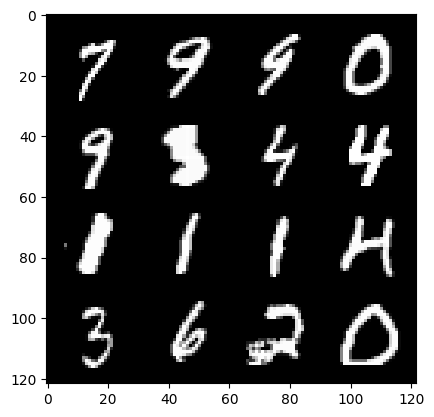

117:step 54900 / Gen loss: 2.4782380171616865 / Disc loss: 0.23713143562277156


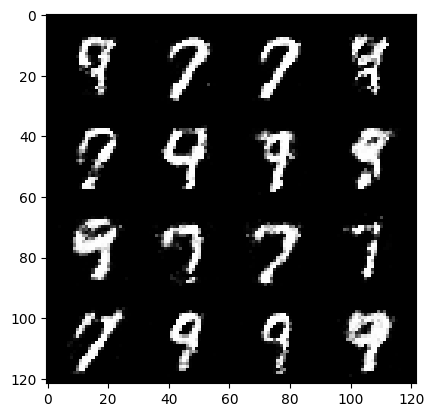

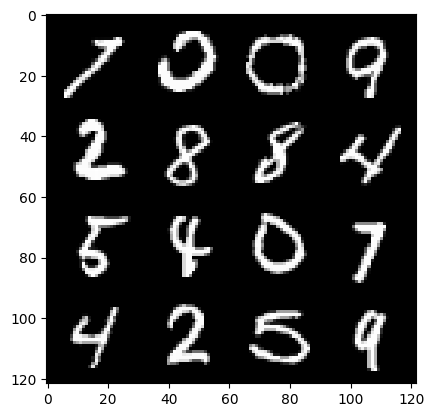

117:step 55200 / Gen loss: 2.337304520606995 / Disc loss: 0.25829555923740066


  0%|          | 0/469 [00:00<?, ?it/s]

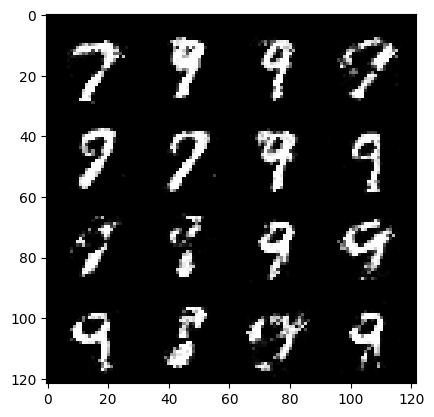

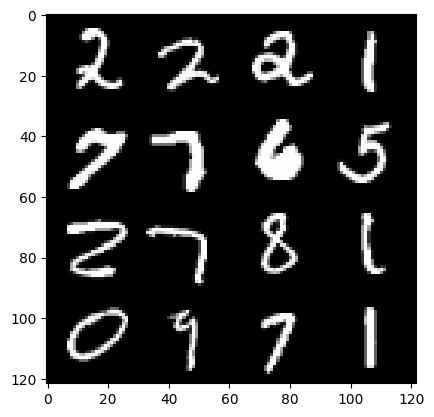

118:step 55500 / Gen loss: 2.4562025507291145 / Disc loss: 0.21207937816778827


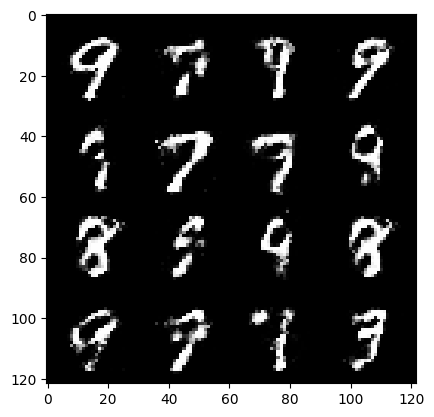

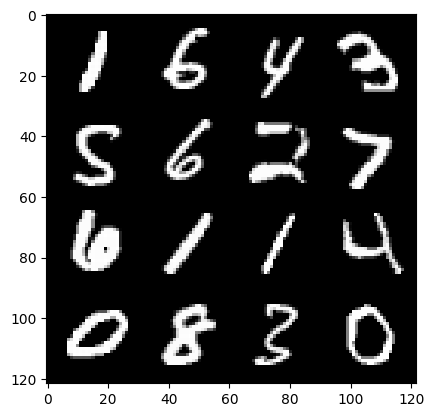

118:step 55800 / Gen loss: 2.5456768965721137 / Disc loss: 0.21533919697006546


  0%|          | 0/469 [00:00<?, ?it/s]

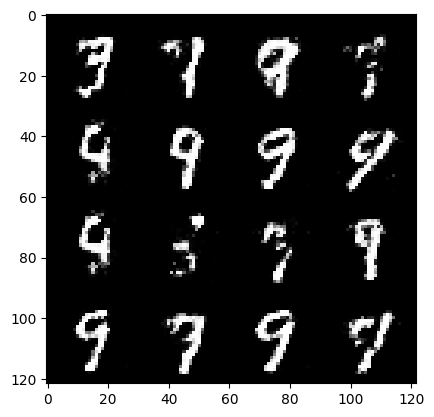

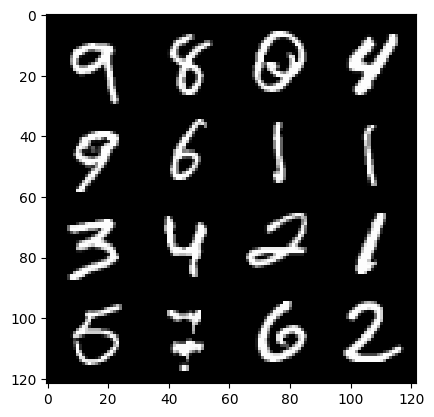

119:step 56100 / Gen loss: 2.5155382517973552 / Disc loss: 0.21195186786353573


  0%|          | 0/469 [00:00<?, ?it/s]

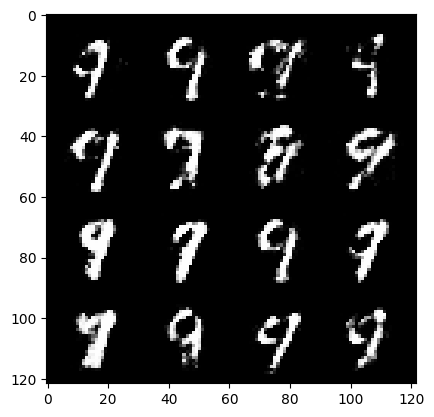

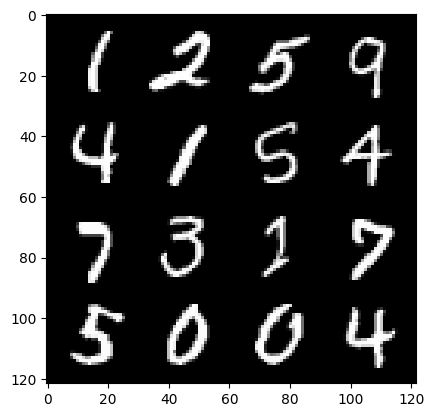

120:step 56400 / Gen loss: 2.539979275067646 / Disc loss: 0.22712322466075419


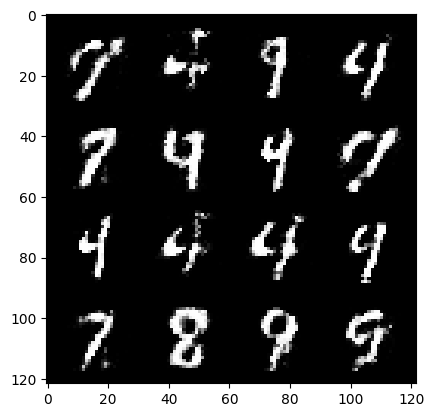

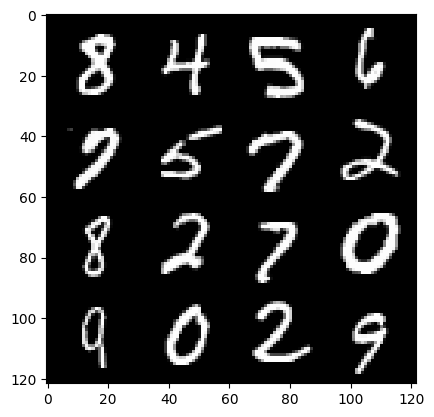

120:step 56700 / Gen loss: 2.395111626784007 / Disc loss: 0.24625459998846055


  0%|          | 0/469 [00:00<?, ?it/s]

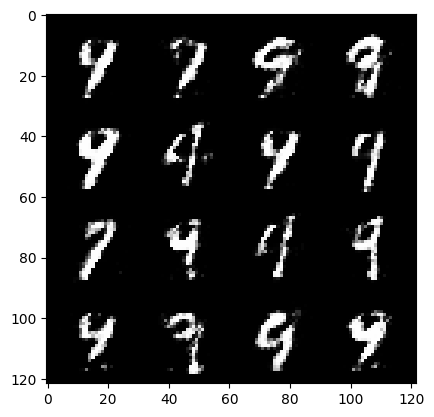

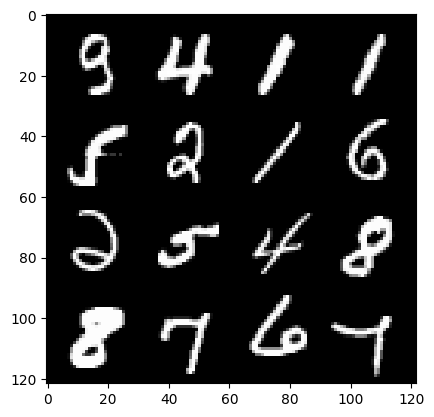

121:step 57000 / Gen loss: 2.380315325657526 / Disc loss: 0.24520805334051454


  0%|          | 0/469 [00:00<?, ?it/s]

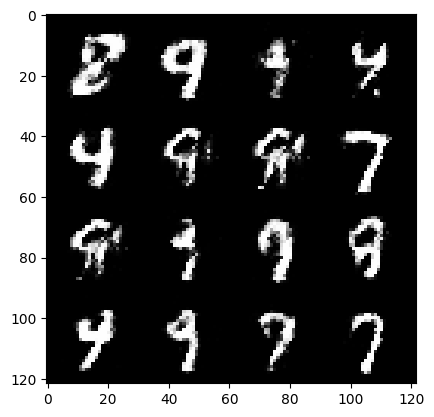

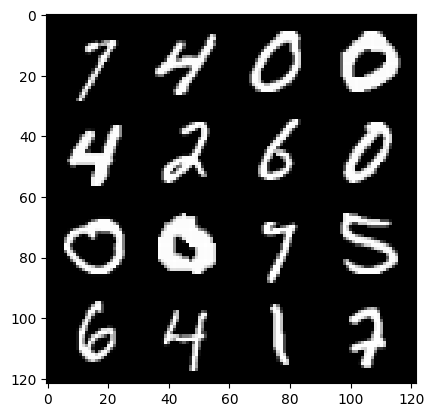

122:step 57300 / Gen loss: 2.252584316333135 / Disc loss: 0.2565677643815676


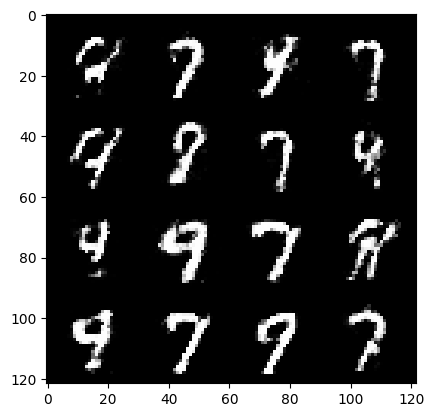

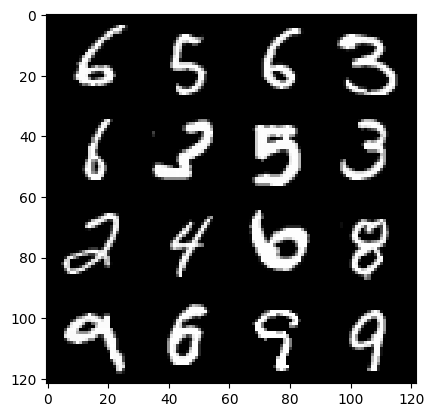

122:step 57600 / Gen loss: 2.3225172702471415 / Disc loss: 0.2430507318675518


  0%|          | 0/469 [00:00<?, ?it/s]

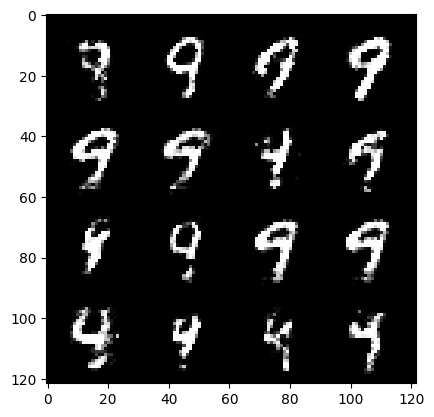

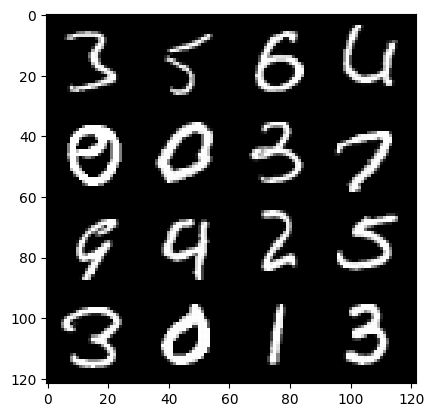

123:step 57900 / Gen loss: 2.3361918179194134 / Disc loss: 0.2324007681012153


  0%|          | 0/469 [00:00<?, ?it/s]

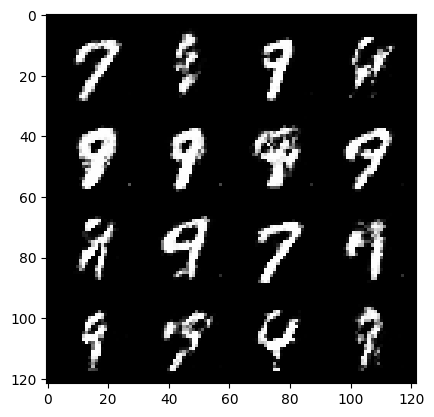

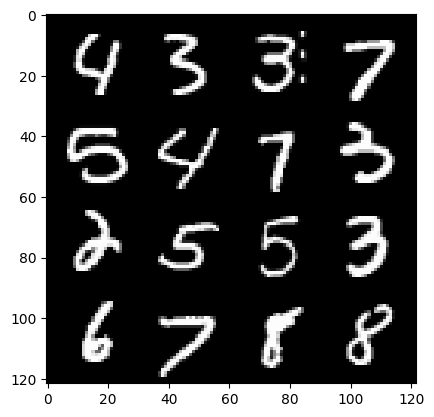

124:step 58200 / Gen loss: 2.369736270904538 / Disc loss: 0.23665130158265438


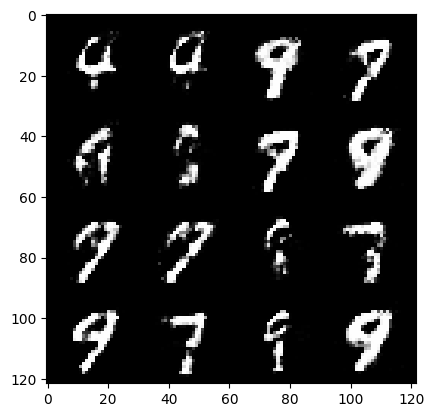

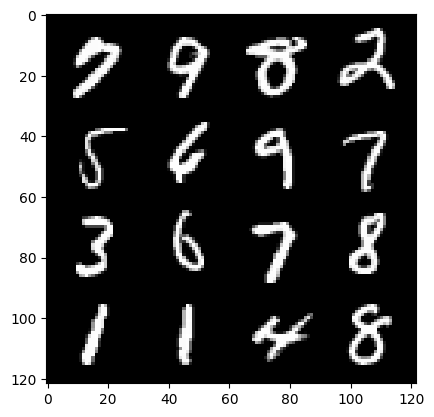

124:step 58500 / Gen loss: 2.3346557867527 / Disc loss: 0.23487330531080555


  0%|          | 0/469 [00:00<?, ?it/s]

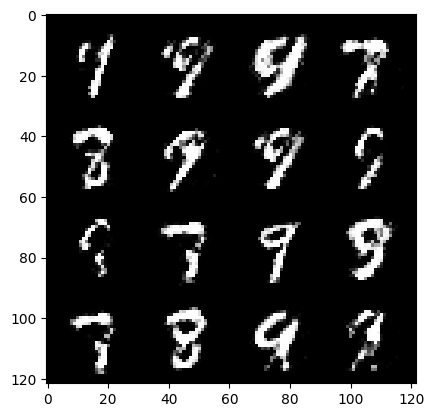

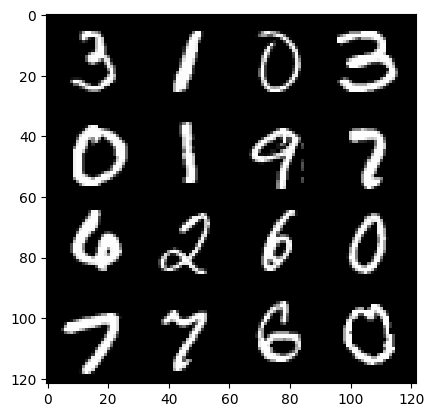

125:step 58800 / Gen loss: 2.319474154710771 / Disc loss: 0.23734599197904246


  0%|          | 0/469 [00:00<?, ?it/s]

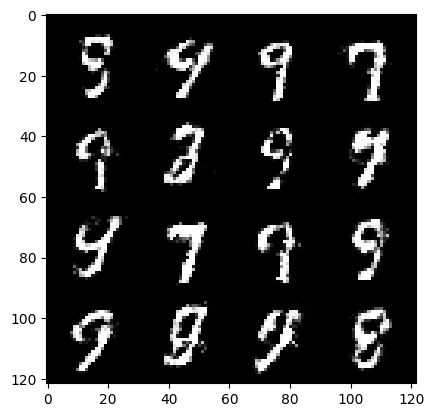

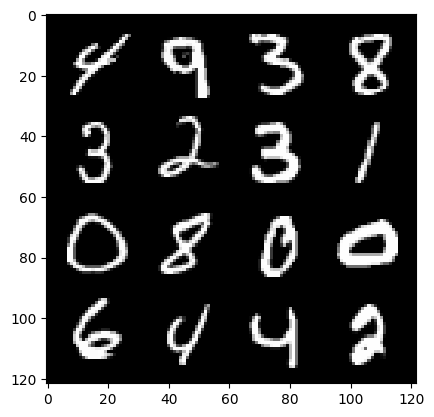

126:step 59100 / Gen loss: 2.3947461708386744 / Disc loss: 0.2311436789234478


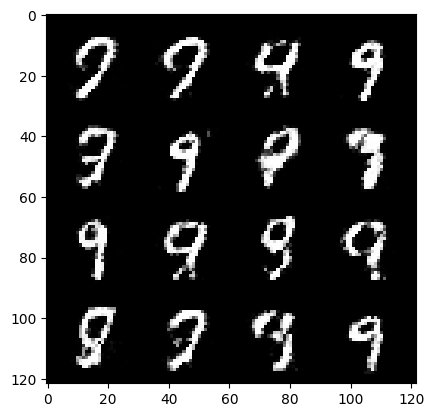

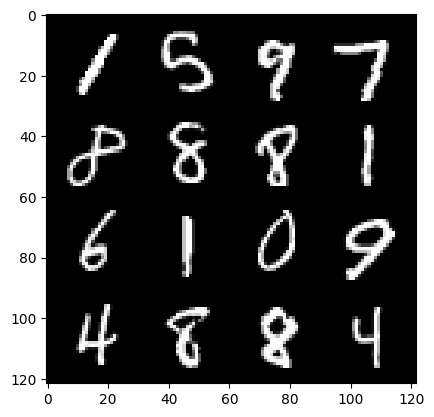

126:step 59400 / Gen loss: 2.2862414336204533 / Disc loss: 0.2552485392491023


  0%|          | 0/469 [00:00<?, ?it/s]

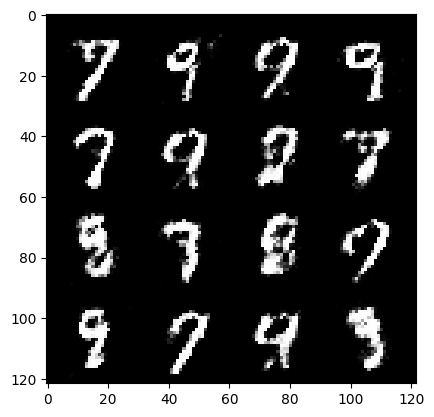

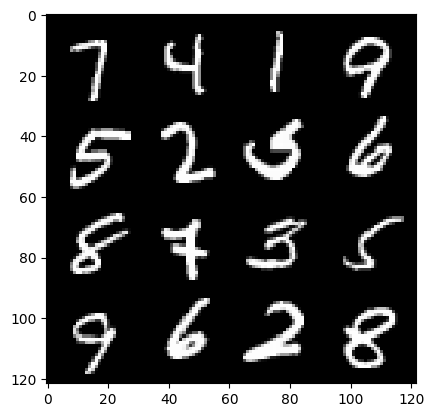

127:step 59700 / Gen loss: 2.307119263013204 / Disc loss: 0.2628445329765478


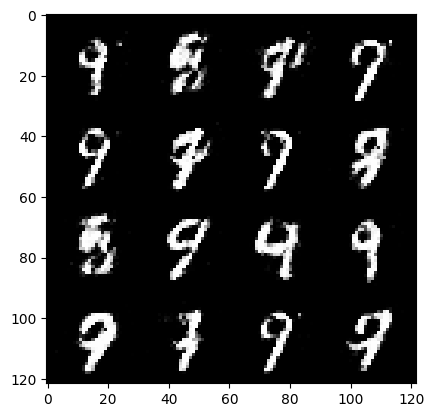

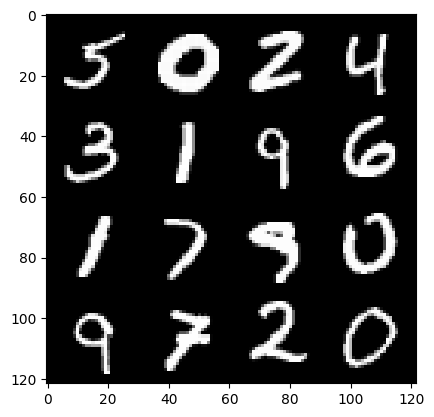

127:step 60000 / Gen loss: 2.3202541315555574 / Disc loss: 0.2454712036252022


  0%|          | 0/469 [00:00<?, ?it/s]

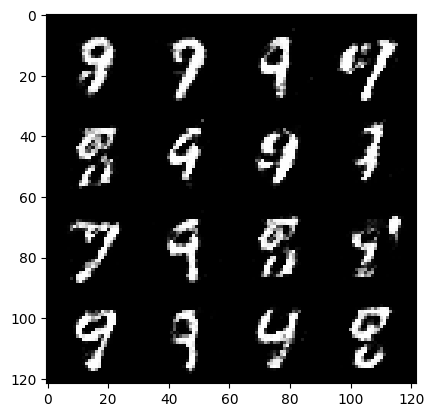

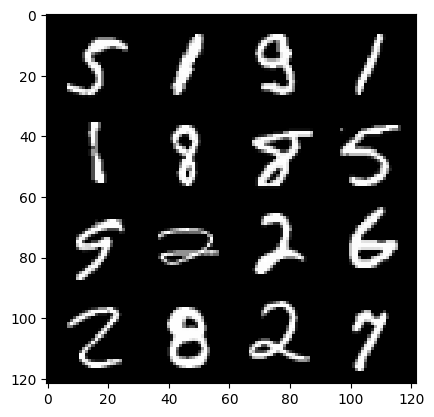

128:step 60300 / Gen loss: 2.3604565866788243 / Disc loss: 0.24323808054129292


  0%|          | 0/469 [00:00<?, ?it/s]

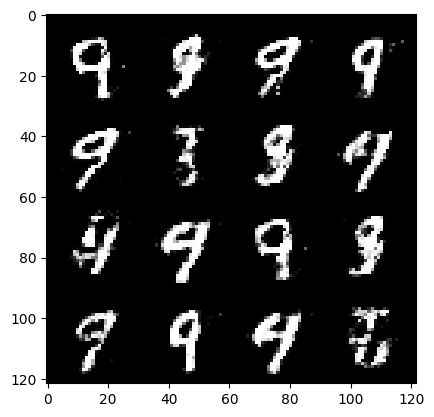

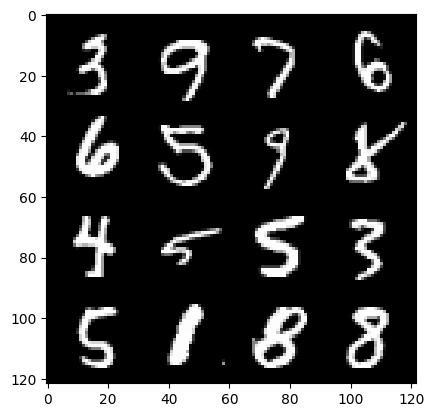

129:step 60600 / Gen loss: 2.3298490766684212 / Disc loss: 0.24970187748471895


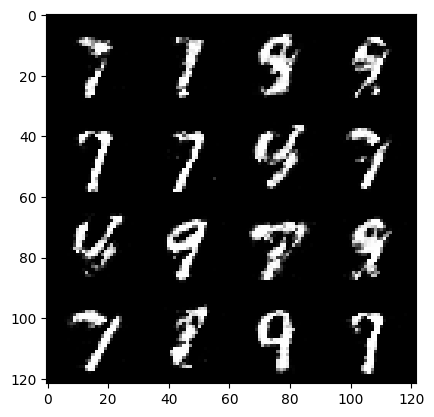

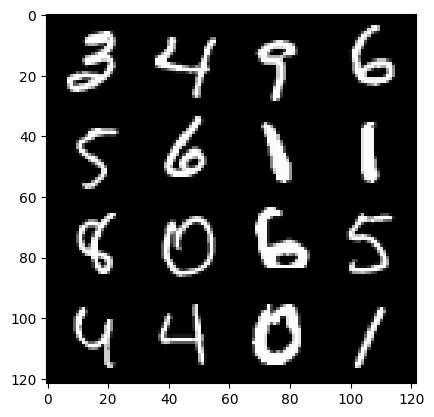

129:step 60900 / Gen loss: 2.4028154583772032 / Disc loss: 0.23197409311930348


  0%|          | 0/469 [00:00<?, ?it/s]

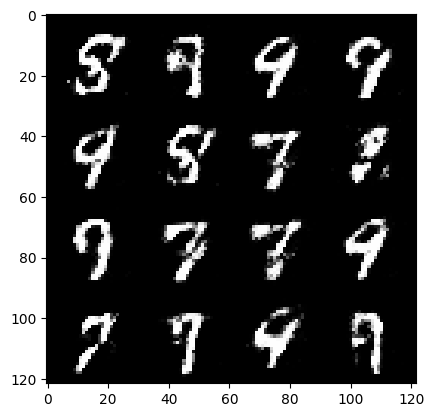

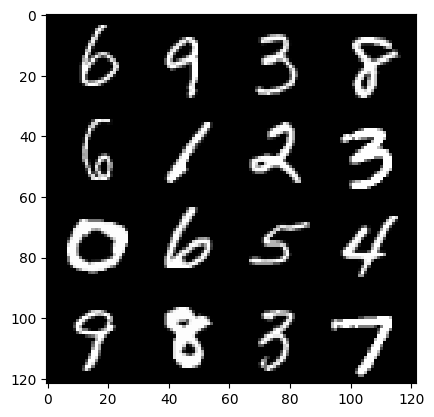

130:step 61200 / Gen loss: 2.4039314587910967 / Disc loss: 0.2404953767359258


  0%|          | 0/469 [00:00<?, ?it/s]

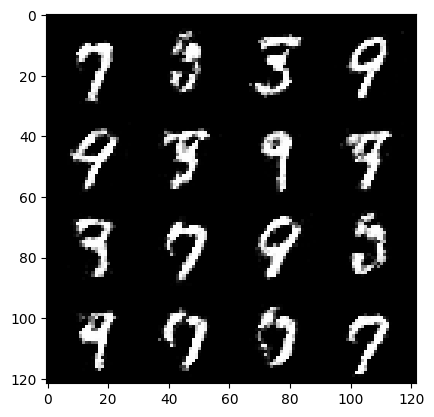

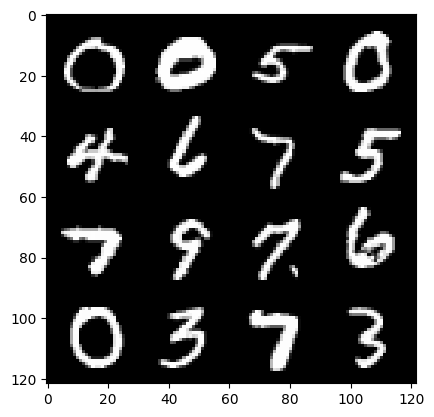

131:step 61500 / Gen loss: 2.2920575865109774 / Disc loss: 0.25880295043190343


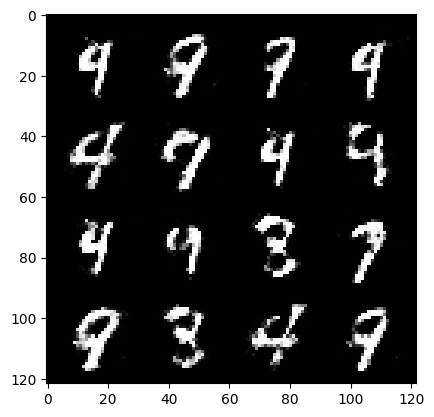

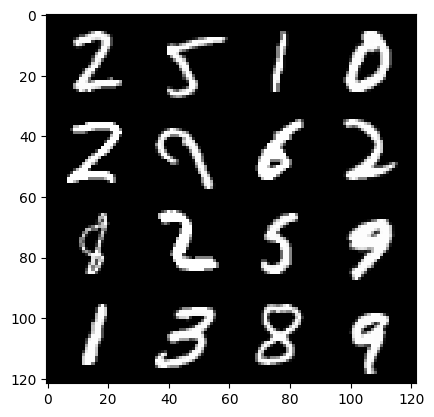

131:step 61800 / Gen loss: 2.3280397427082065 / Disc loss: 0.2417570501069228


  0%|          | 0/469 [00:00<?, ?it/s]

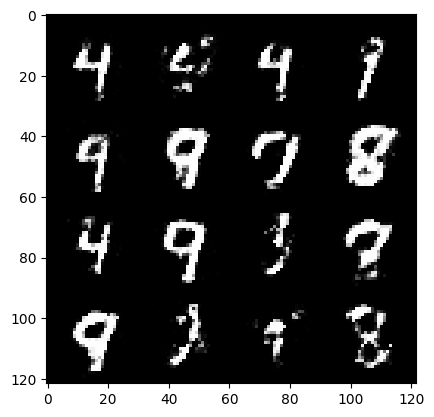

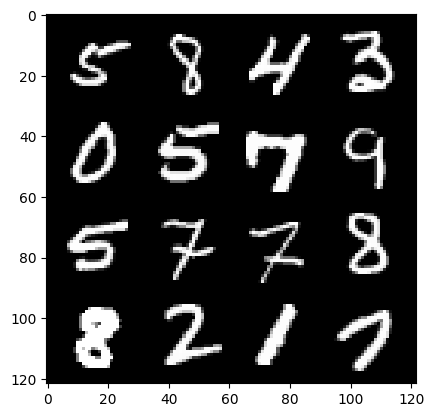

132:step 62100 / Gen loss: 2.330107647577922 / Disc loss: 0.23289330859979002


  0%|          | 0/469 [00:00<?, ?it/s]

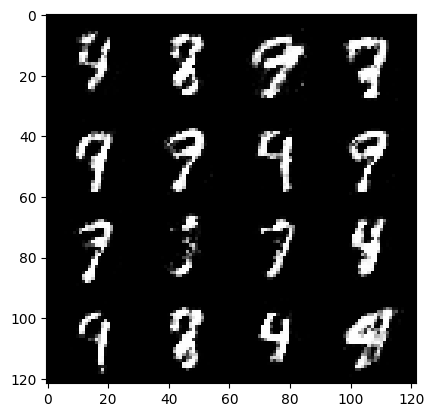

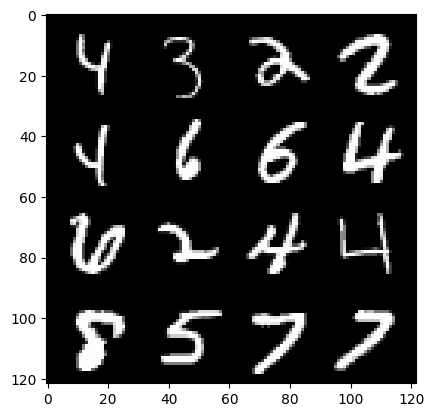

133:step 62400 / Gen loss: 2.331468739906945 / Disc loss: 0.24258806864420568


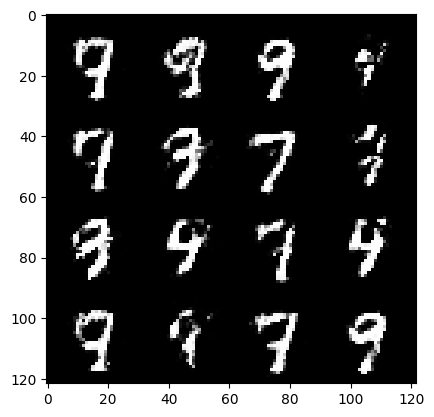

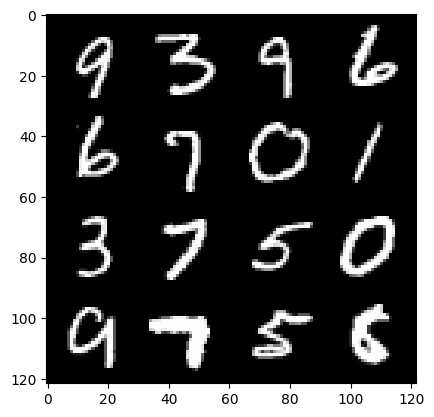

133:step 62700 / Gen loss: 2.2493339908123025 / Disc loss: 0.24960974574089057


  0%|          | 0/469 [00:00<?, ?it/s]

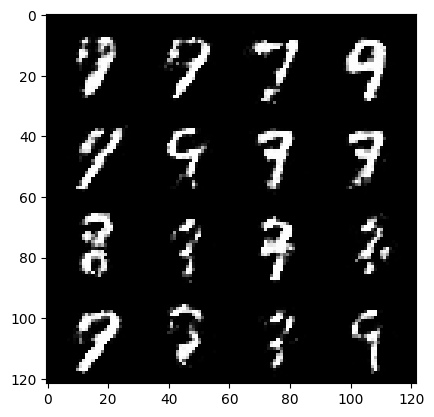

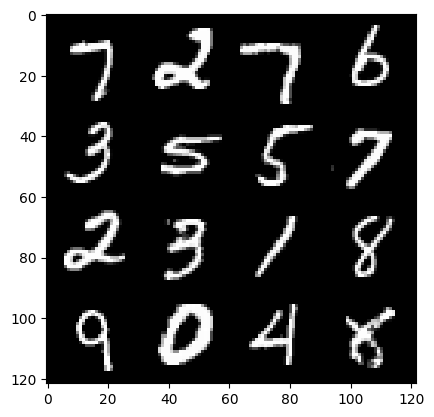

134:step 63000 / Gen loss: 2.35852581659953 / Disc loss: 0.23573139712214478


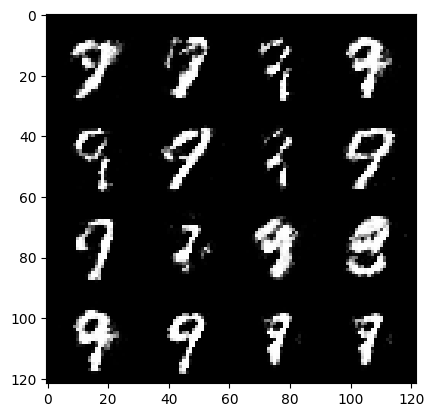

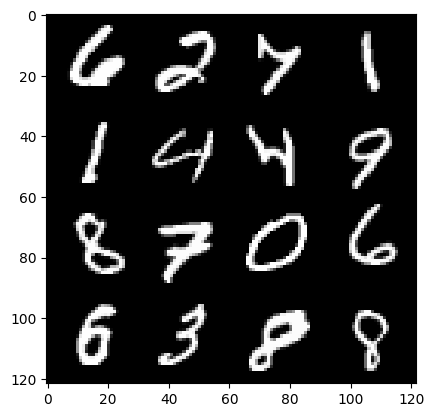

134:step 63300 / Gen loss: 2.3195662581920633 / Disc loss: 0.23953479439020142


  0%|          | 0/469 [00:00<?, ?it/s]

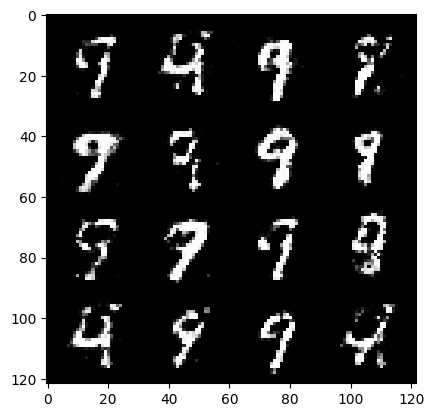

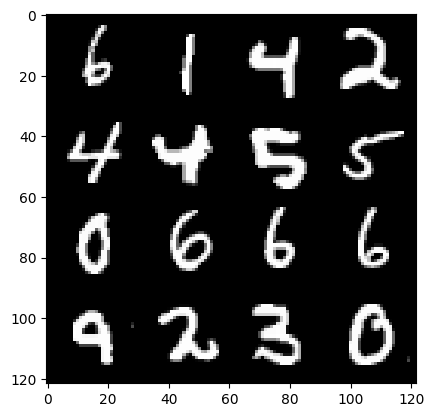

135:step 63600 / Gen loss: 2.327589929103851 / Disc loss: 0.23338242004315063


  0%|          | 0/469 [00:00<?, ?it/s]

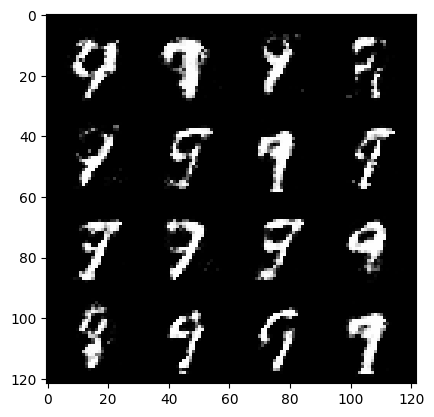

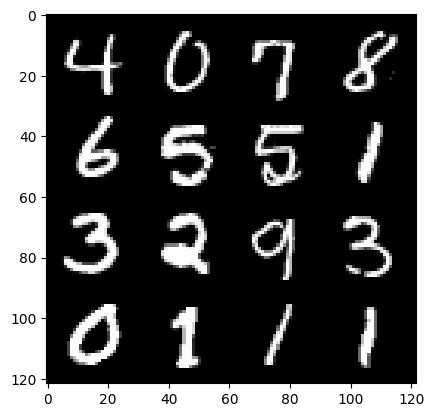

136:step 63900 / Gen loss: 2.2960914107163757 / Disc loss: 0.2300044209758441


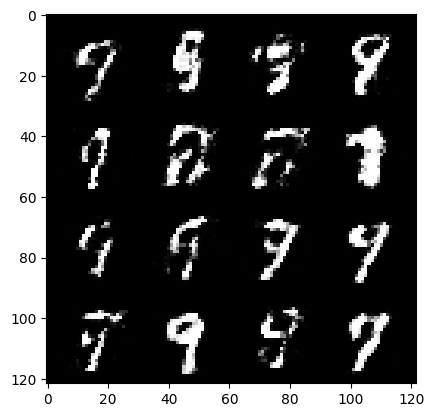

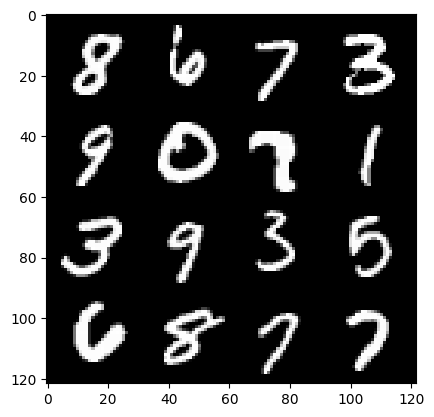

136:step 64200 / Gen loss: 2.350733931064604 / Disc loss: 0.2327102387944858


  0%|          | 0/469 [00:00<?, ?it/s]

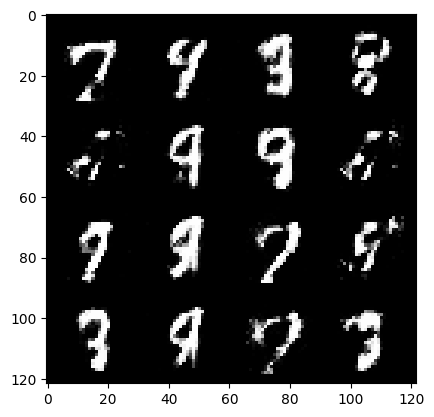

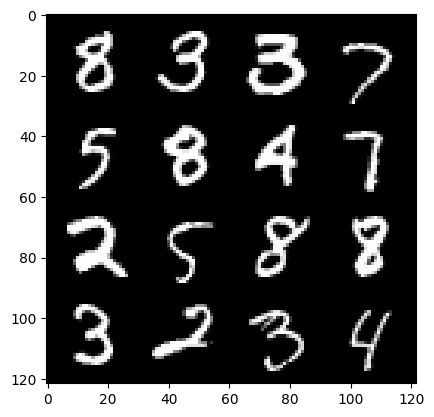

137:step 64500 / Gen loss: 2.4293860673904417 / Disc loss: 0.23886660913626337


  0%|          | 0/469 [00:00<?, ?it/s]

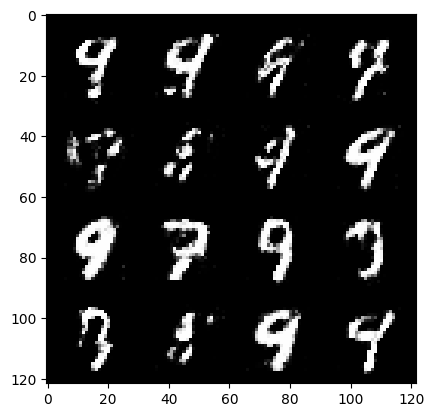

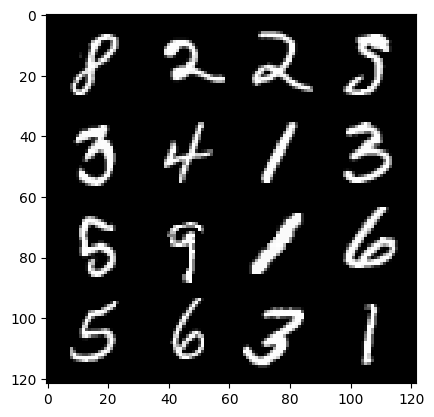

138:step 64800 / Gen loss: 2.309755210876464 / Disc loss: 0.245974610199531


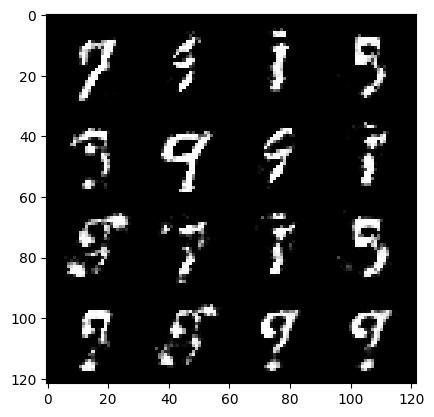

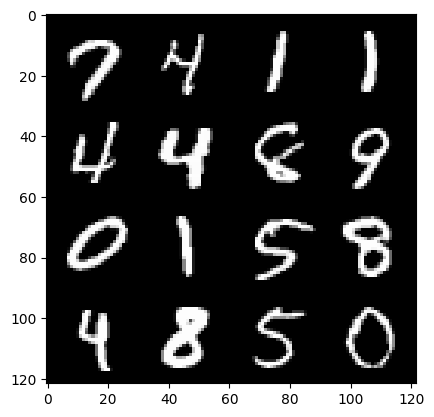

138:step 65100 / Gen loss: 2.3811479723453512 / Disc loss: 0.24520566185315426


  0%|          | 0/469 [00:00<?, ?it/s]

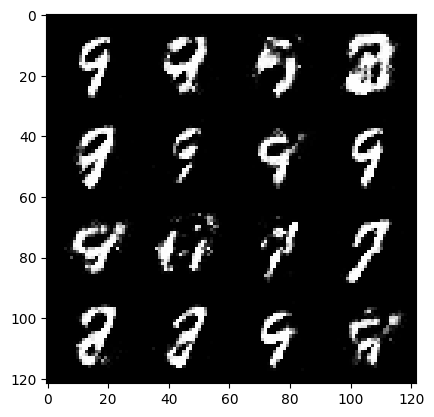

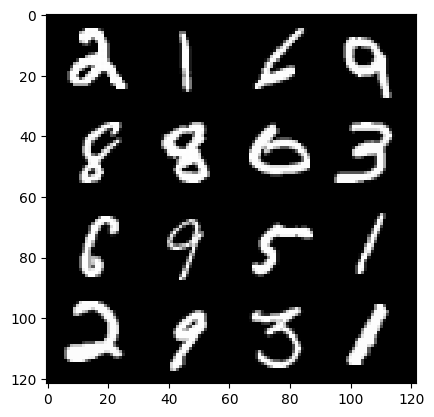

139:step 65400 / Gen loss: 2.182909880876543 / Disc loss: 0.2724046626190345


  0%|          | 0/469 [00:00<?, ?it/s]

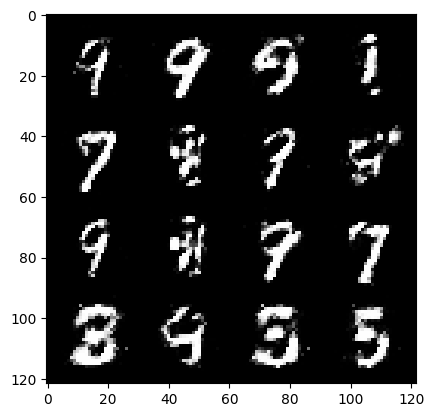

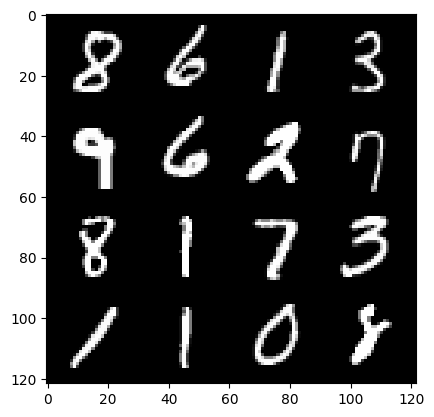

140:step 65700 / Gen loss: 2.2957628258069356 / Disc loss: 0.2451818208893138


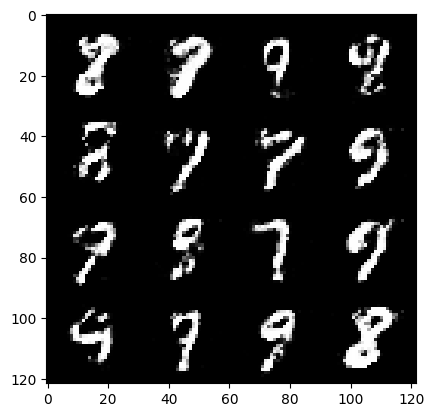

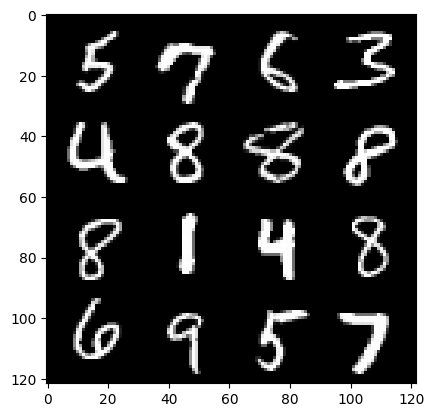

140:step 66000 / Gen loss: 2.306653975248337 / Disc loss: 0.24318681011597323


  0%|          | 0/469 [00:00<?, ?it/s]

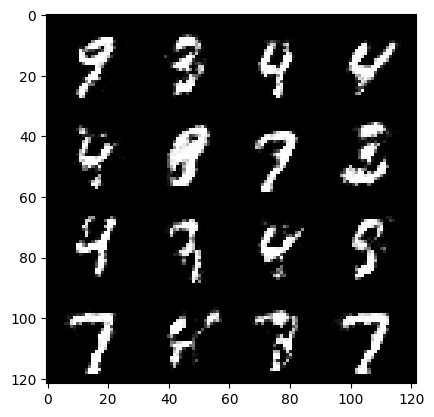

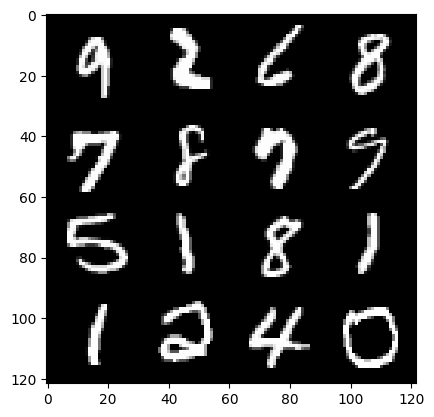

141:step 66300 / Gen loss: 2.187643496195475 / Disc loss: 0.2663143574198086


  0%|          | 0/469 [00:00<?, ?it/s]

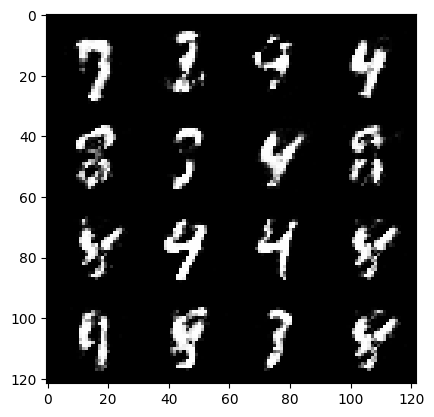

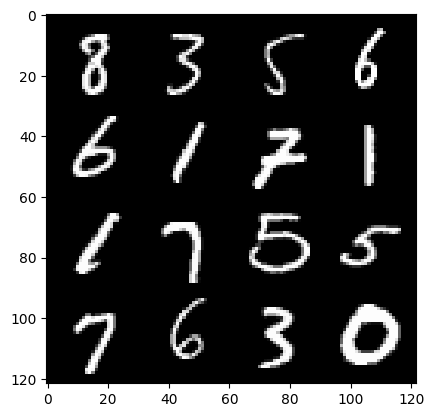

142:step 66600 / Gen loss: 2.1778982905546838 / Disc loss: 0.27677005300919194


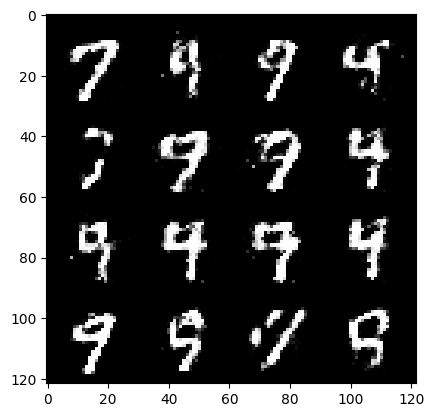

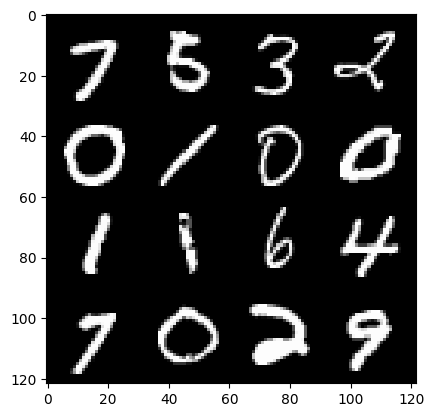

142:step 66900 / Gen loss: 2.1809422393639886 / Disc loss: 0.26188064008951184


  0%|          | 0/469 [00:00<?, ?it/s]

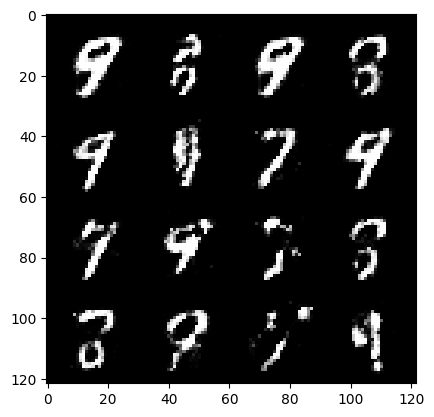

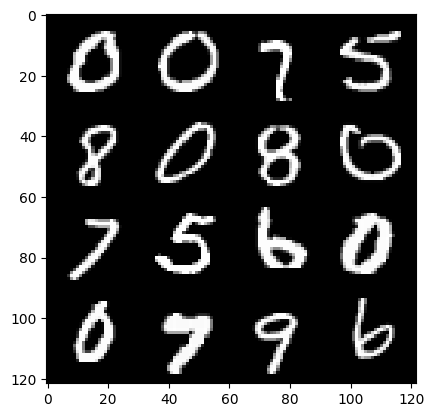

143:step 67200 / Gen loss: 2.259119763771693 / Disc loss: 0.2412967052559058


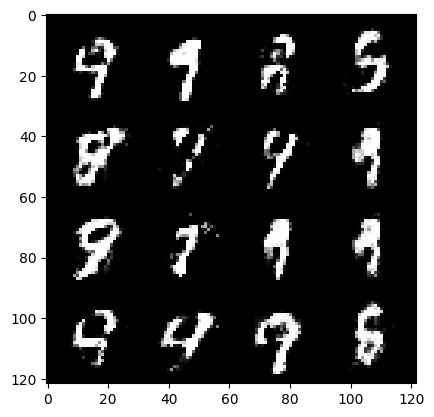

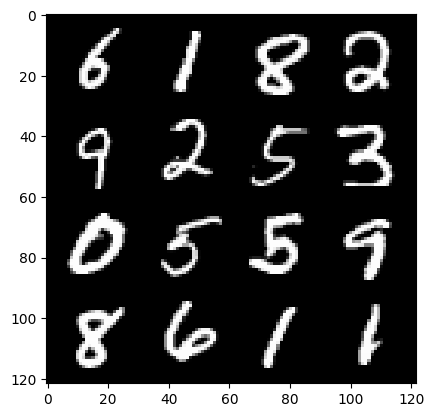

143:step 67500 / Gen loss: 2.2426277454694112 / Disc loss: 0.2581977676351865


  0%|          | 0/469 [00:00<?, ?it/s]

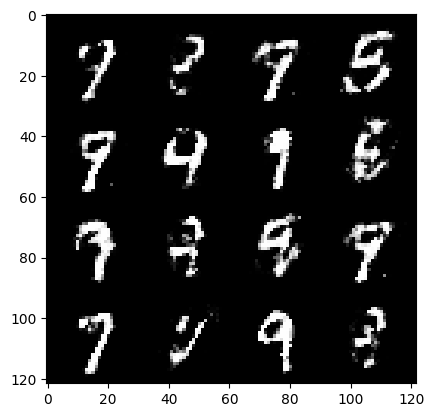

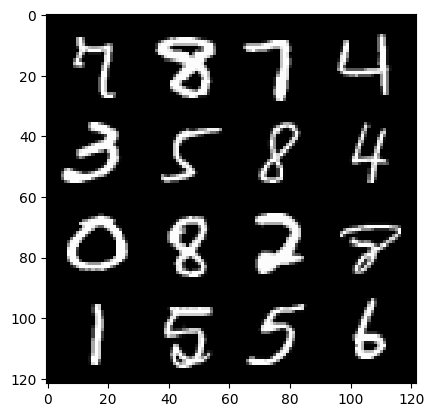

144:step 67800 / Gen loss: 2.195018957853317 / Disc loss: 0.2616574031611284


  0%|          | 0/469 [00:00<?, ?it/s]

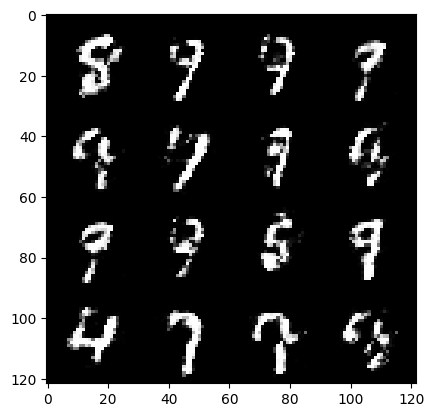

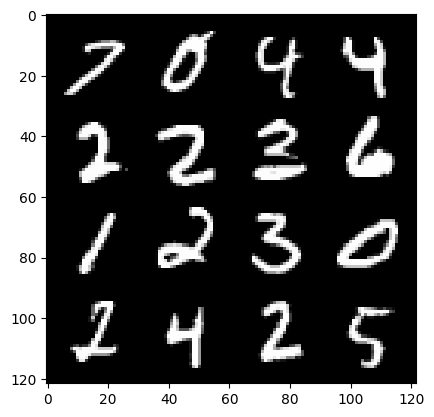

145:step 68100 / Gen loss: 2.1589943464597083 / Disc loss: 0.2570242446660995


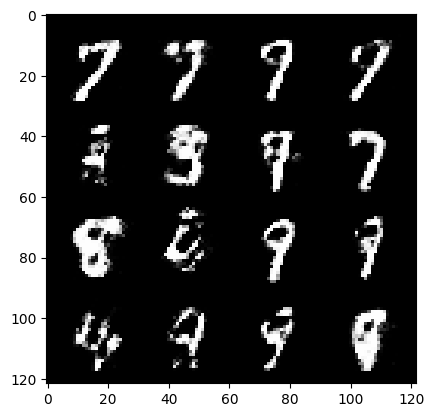

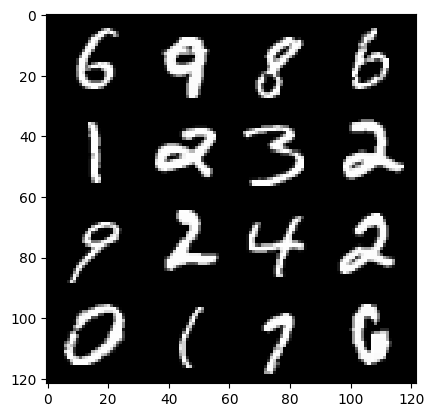

145:step 68400 / Gen loss: 2.2280443982283273 / Disc loss: 0.25214800581336033


  0%|          | 0/469 [00:00<?, ?it/s]

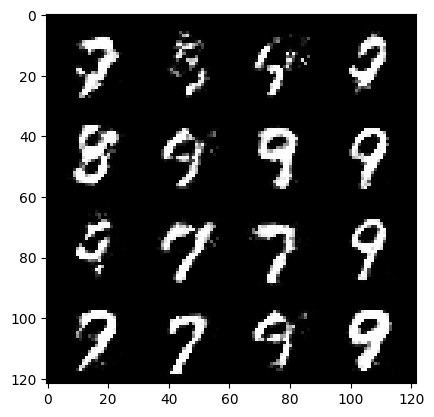

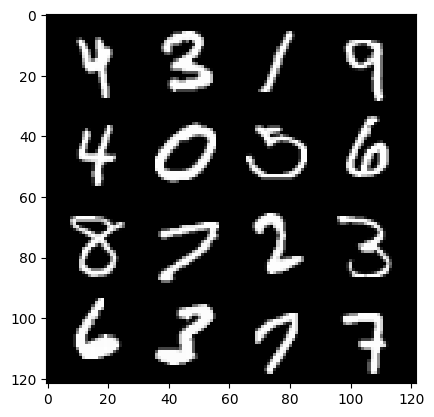

146:step 68700 / Gen loss: 2.033130601247153 / Disc loss: 0.29906926095485714


  0%|          | 0/469 [00:00<?, ?it/s]

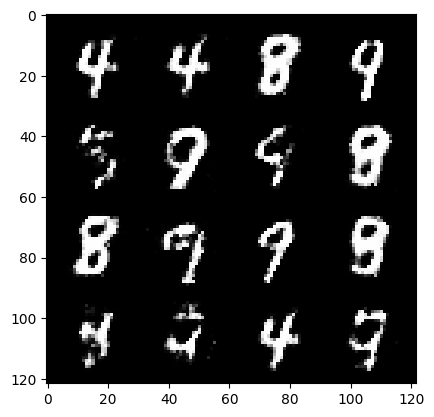

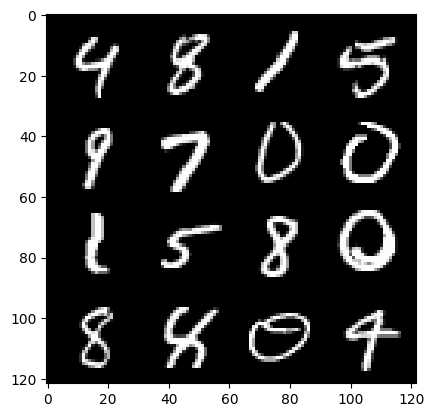

147:step 69000 / Gen loss: 2.0028403584162384 / Disc loss: 0.3033258179823559


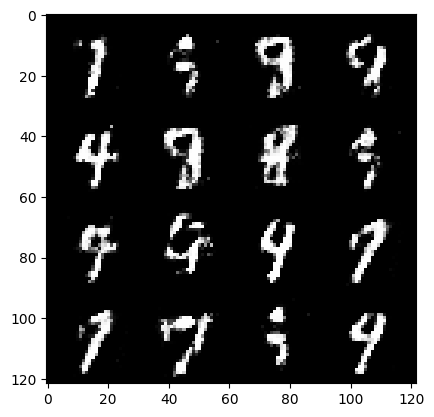

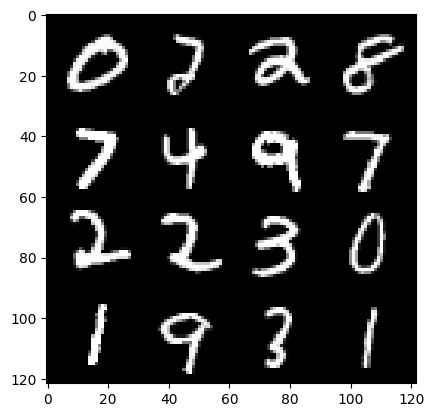

147:step 69300 / Gen loss: 2.1088487279415125 / Disc loss: 0.27151190161705024


  0%|          | 0/469 [00:00<?, ?it/s]

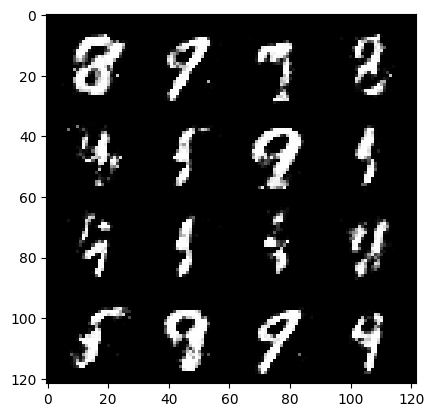

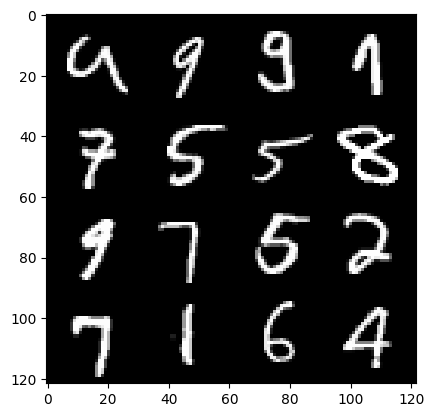

148:step 69600 / Gen loss: 2.1792892742156966 / Disc loss: 0.26759196837743127


  0%|          | 0/469 [00:00<?, ?it/s]

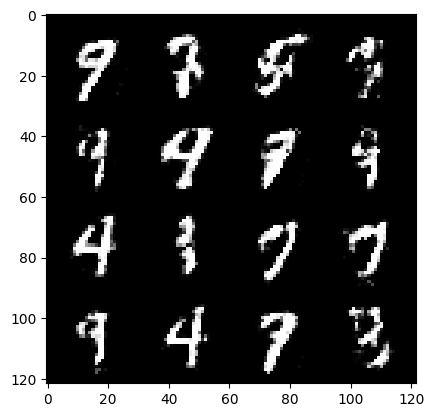

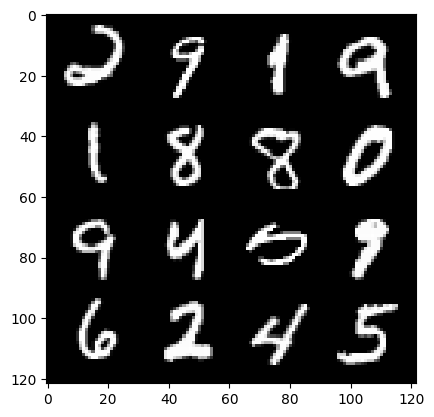

149:step 69900 / Gen loss: 2.1503842469056456 / Disc loss: 0.27307912041743604


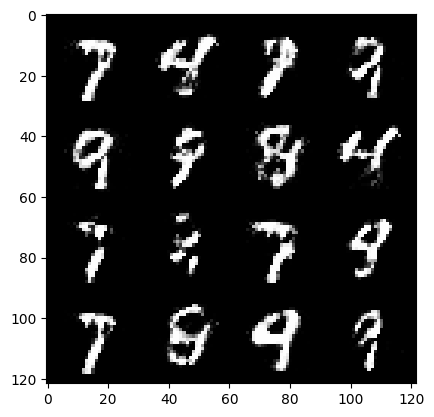

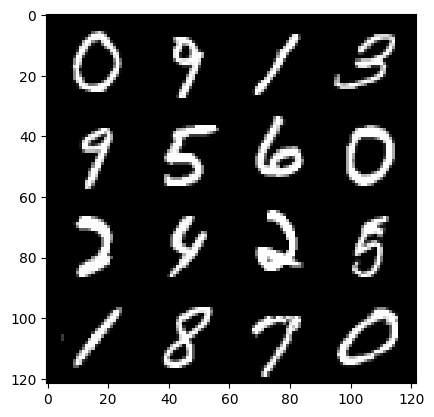

149:step 70200 / Gen loss: 2.0907155617078135 / Disc loss: 0.287425383478403


  0%|          | 0/469 [00:00<?, ?it/s]

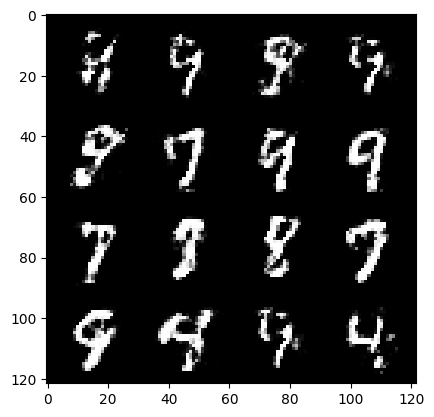

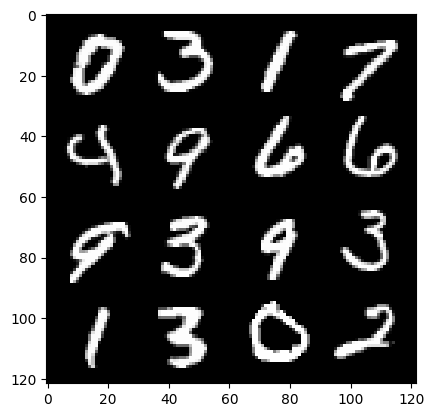

150:step 70500 / Gen loss: 1.9891709772745758 / Disc loss: 0.30414596304297414


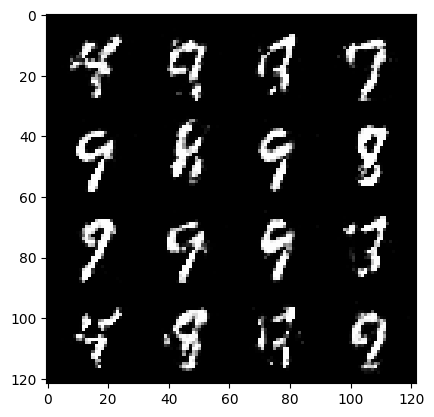

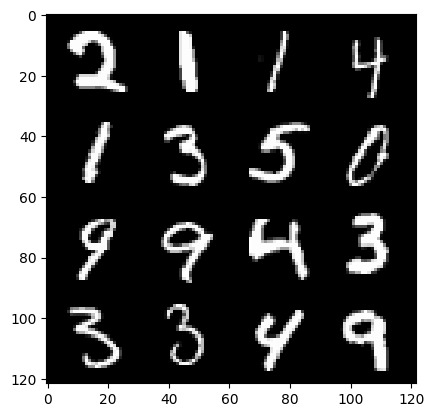

150:step 70800 / Gen loss: 2.04993796547254 / Disc loss: 0.2962112472454708


  0%|          | 0/469 [00:00<?, ?it/s]

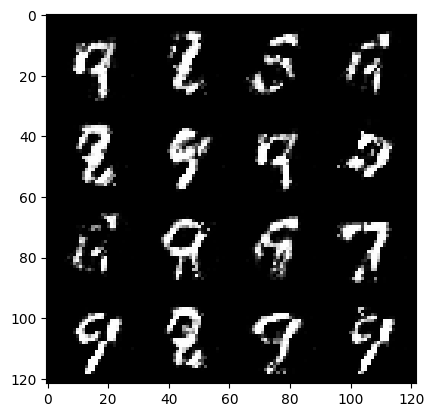

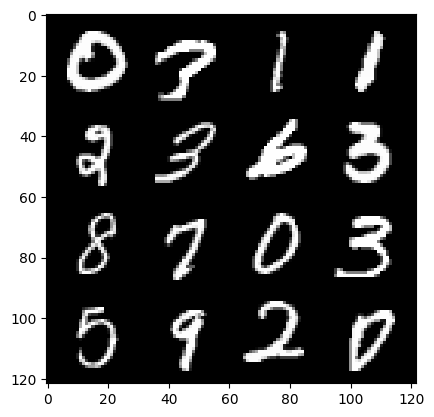

151:step 71100 / Gen loss: 2.104810802141826 / Disc loss: 0.2864118557671707


  0%|          | 0/469 [00:00<?, ?it/s]

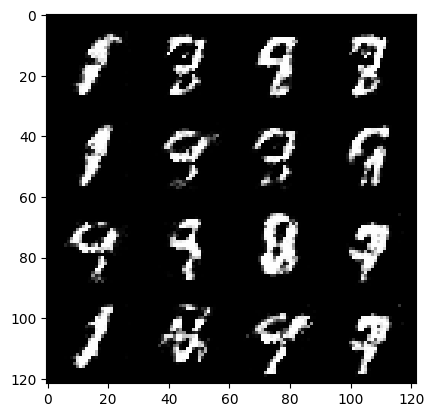

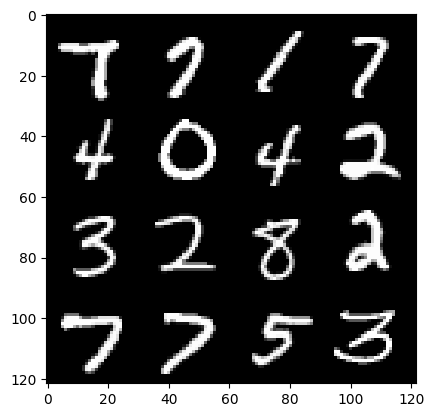

152:step 71400 / Gen loss: 2.1943894684314733 / Disc loss: 0.27959901760021827


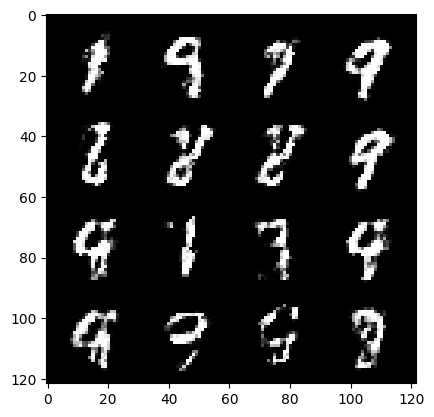

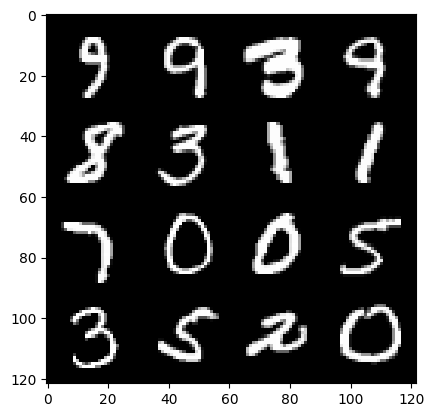

152:step 71700 / Gen loss: 2.0914366273085276 / Disc loss: 0.2933448092639447


  0%|          | 0/469 [00:00<?, ?it/s]

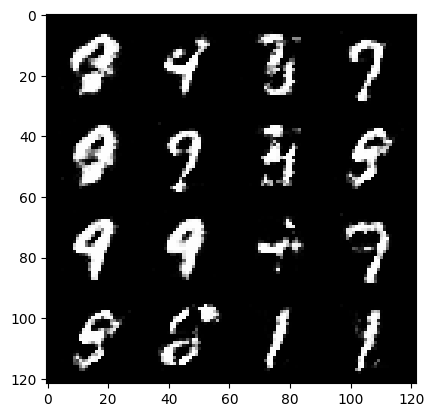

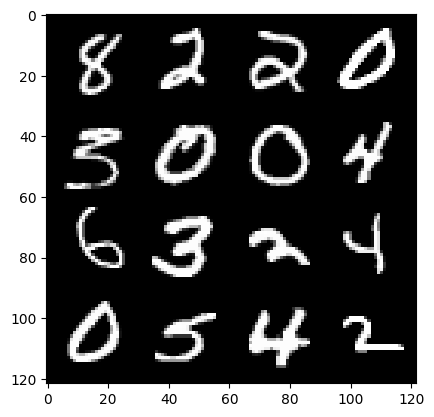

153:step 72000 / Gen loss: 2.024916067520777 / Disc loss: 0.30326745654145876


  0%|          | 0/469 [00:00<?, ?it/s]

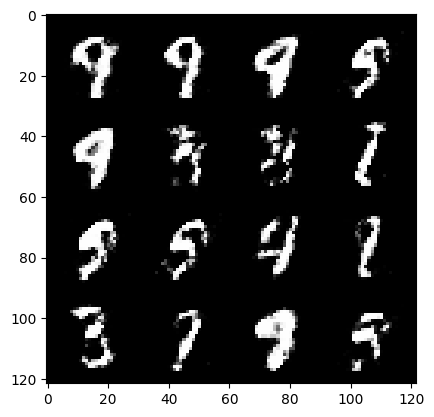

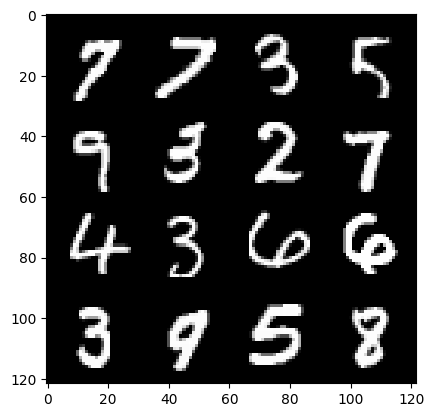

154:step 72300 / Gen loss: 2.075183438062669 / Disc loss: 0.29468352819482496


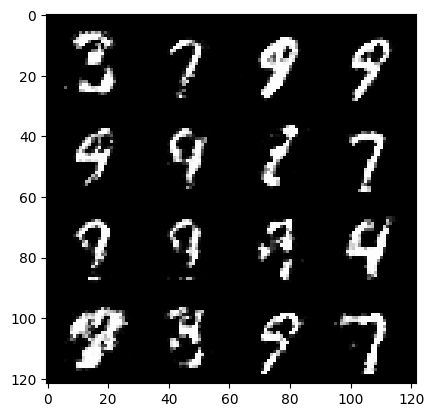

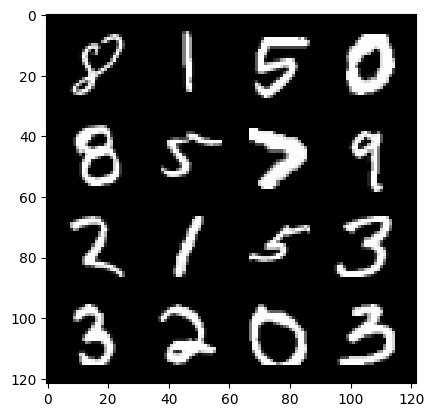

154:step 72600 / Gen loss: 2.041843834718068 / Disc loss: 0.28950929577151935


  0%|          | 0/469 [00:00<?, ?it/s]

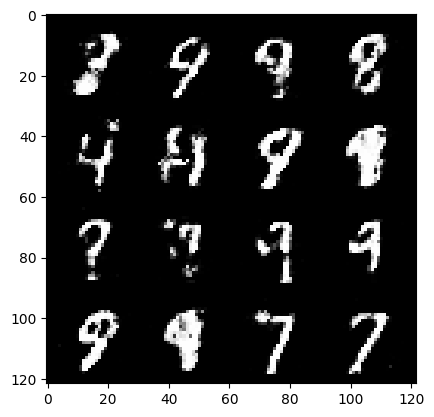

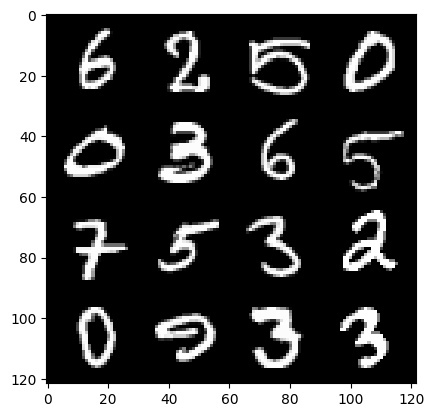

155:step 72900 / Gen loss: 2.0259809760252634 / Disc loss: 0.28403240511814754


  0%|          | 0/469 [00:00<?, ?it/s]

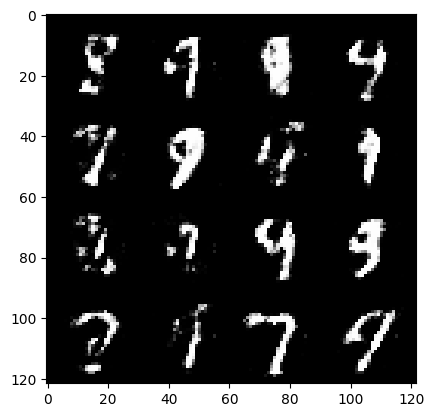

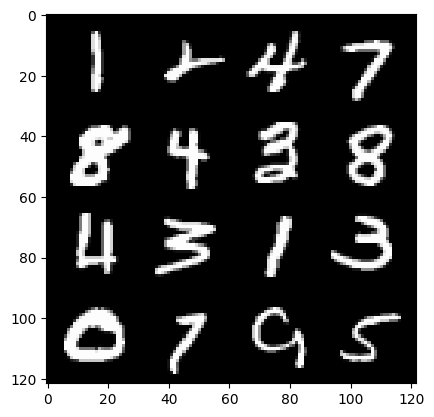

156:step 73200 / Gen loss: 1.965689825216929 / Disc loss: 0.30111246839165684


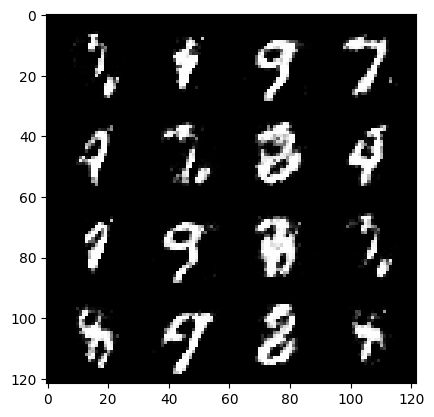

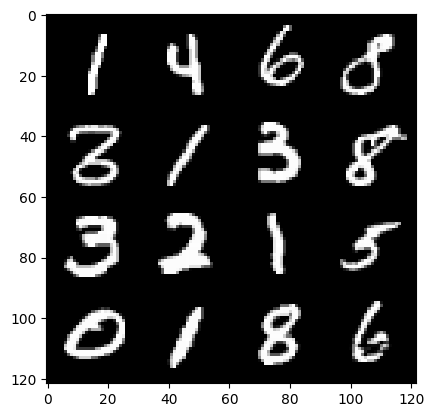

156:step 73500 / Gen loss: 1.880899220705032 / Disc loss: 0.3255374589562417


  0%|          | 0/469 [00:00<?, ?it/s]

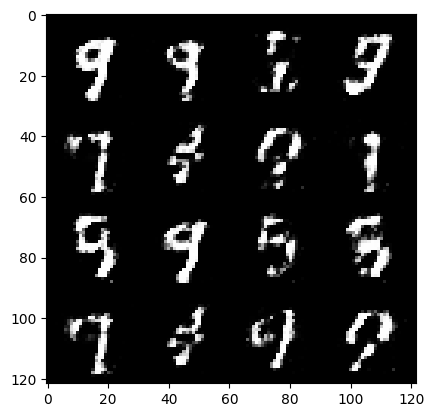

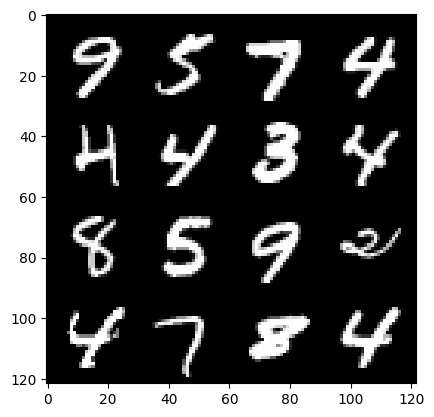

157:step 73800 / Gen loss: 1.9046359900633507 / Disc loss: 0.3098096105456354


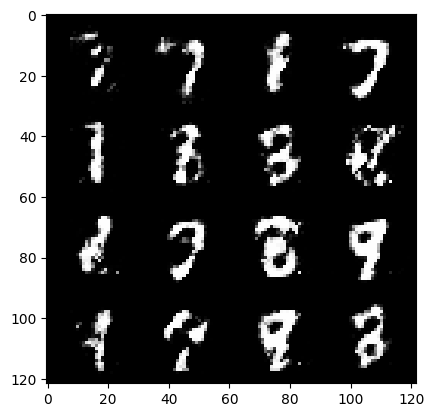

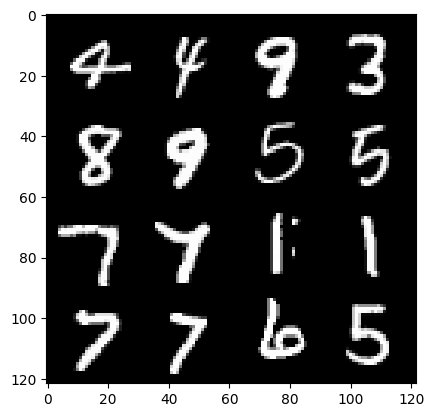

157:step 74100 / Gen loss: 2.014717882871629 / Disc loss: 0.2944594616194567


  0%|          | 0/469 [00:00<?, ?it/s]

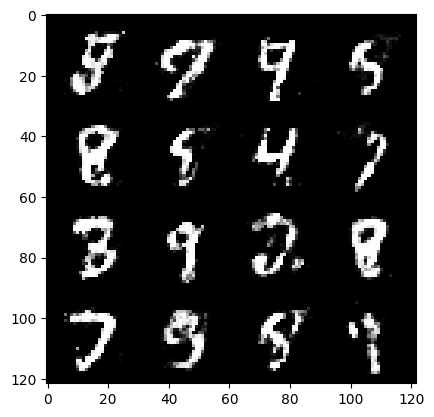

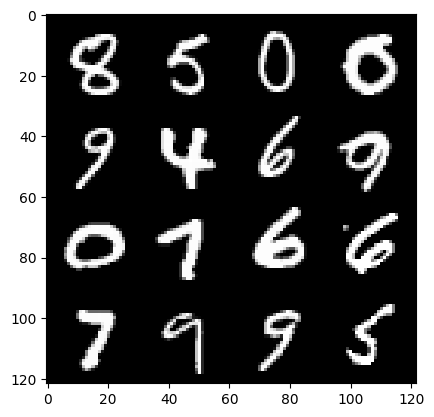

158:step 74400 / Gen loss: 1.97240118821462 / Disc loss: 0.3097748263180258


  0%|          | 0/469 [00:00<?, ?it/s]

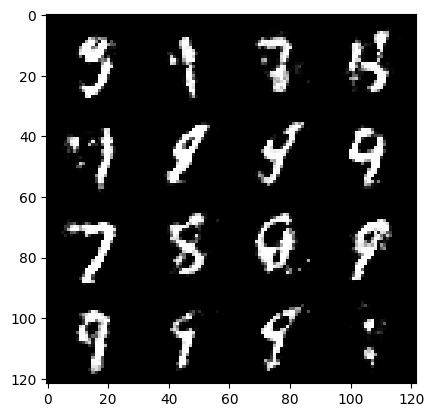

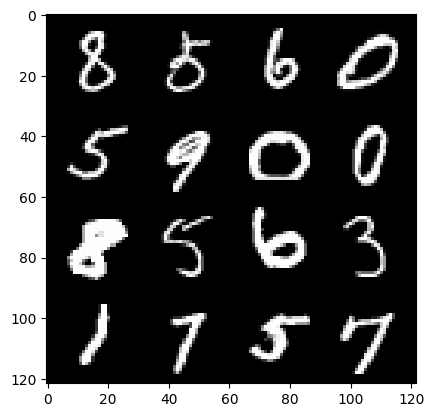

159:step 74700 / Gen loss: 1.9435937877496074 / Disc loss: 0.31121678600708635


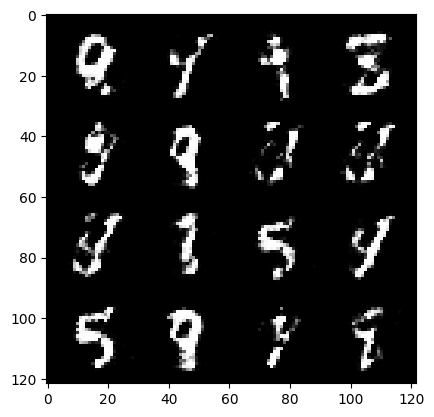

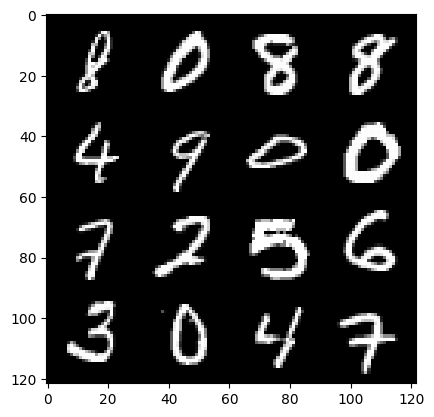

159:step 75000 / Gen loss: 1.9970080463091537 / Disc loss: 0.2911806733409564


  0%|          | 0/469 [00:00<?, ?it/s]

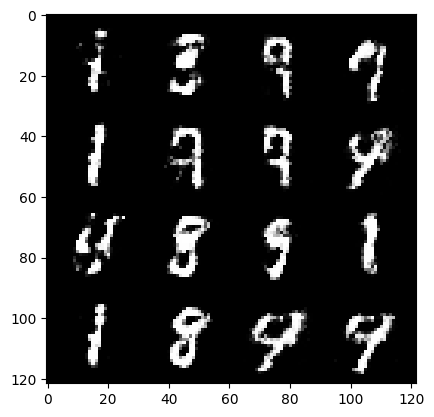

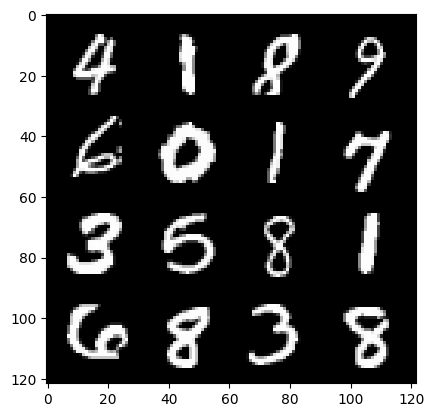

160:step 75300 / Gen loss: 1.9722267937660218 / Disc loss: 0.2978189988434315


  0%|          | 0/469 [00:00<?, ?it/s]

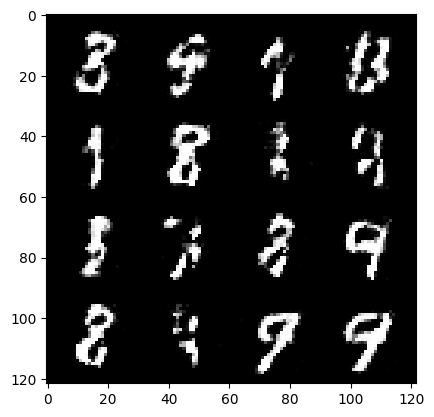

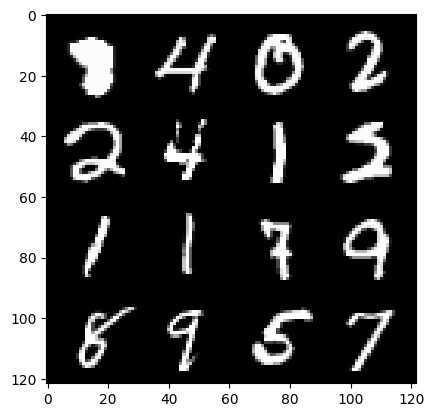

161:step 75600 / Gen loss: 1.967570902109146 / Disc loss: 0.2956155331432819


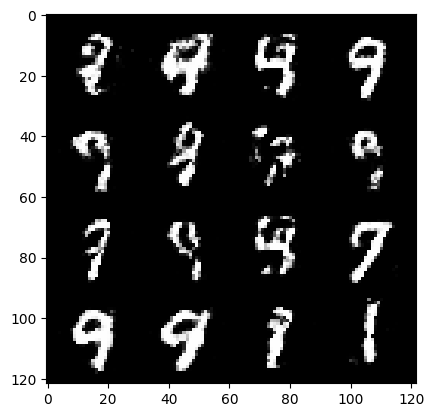

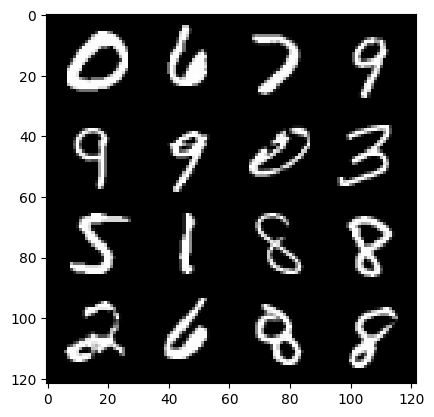

161:step 75900 / Gen loss: 1.965602068106334 / Disc loss: 0.30356420268615075


  0%|          | 0/469 [00:00<?, ?it/s]

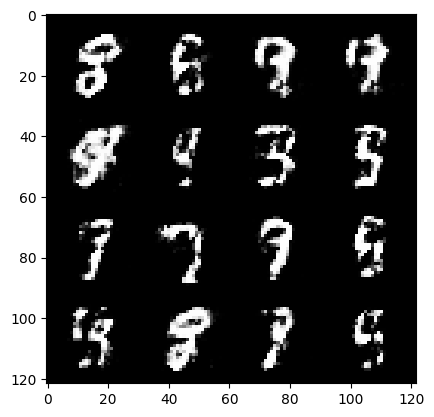

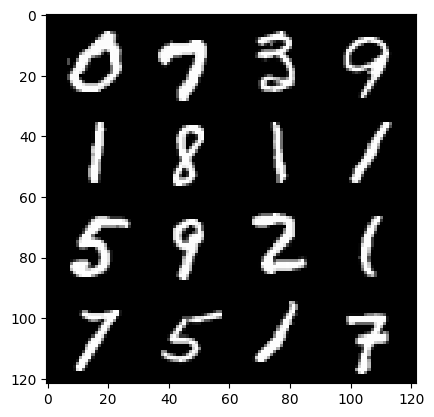

162:step 76200 / Gen loss: 1.8643597745895404 / Disc loss: 0.3155798902114232


  0%|          | 0/469 [00:00<?, ?it/s]

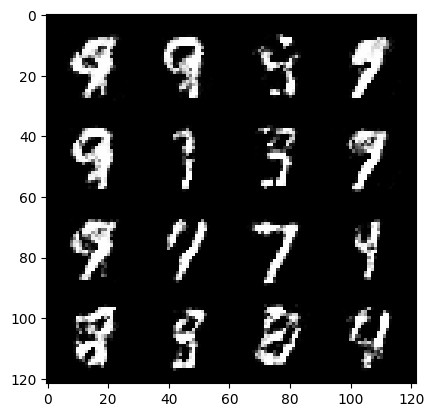

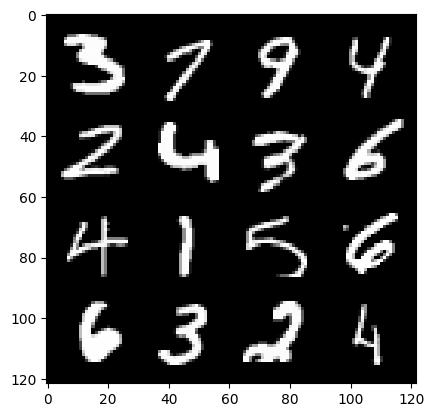

163:step 76500 / Gen loss: 1.8458005483945226 / Disc loss: 0.3179308991630872


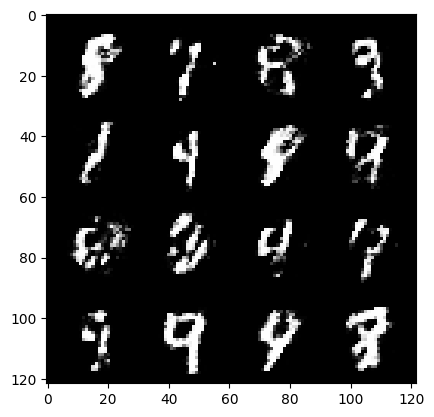

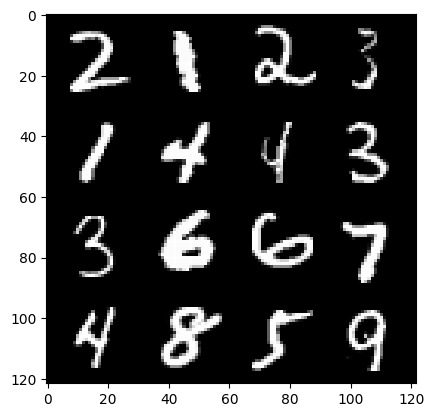

163:step 76800 / Gen loss: 1.8743122537930808 / Disc loss: 0.31608928422133115


  0%|          | 0/469 [00:00<?, ?it/s]

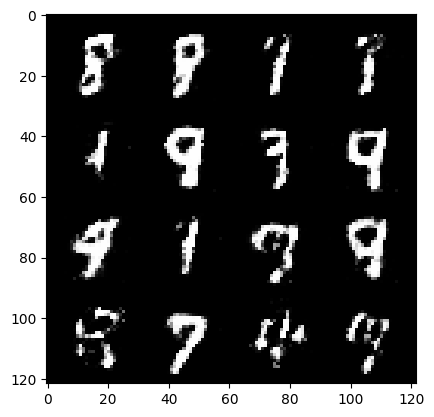

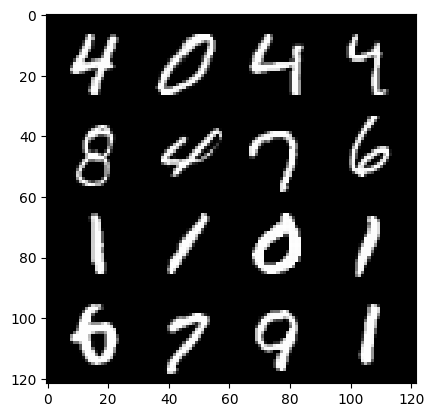

164:step 77100 / Gen loss: 1.8894822231928503 / Disc loss: 0.30557869349916766


  0%|          | 0/469 [00:00<?, ?it/s]

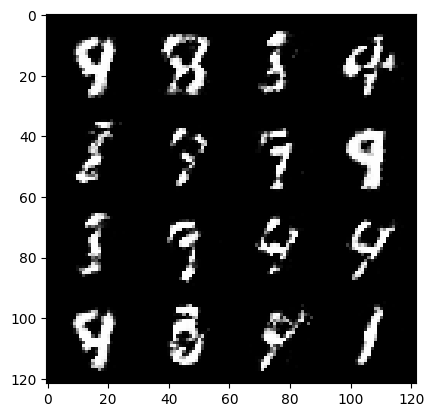

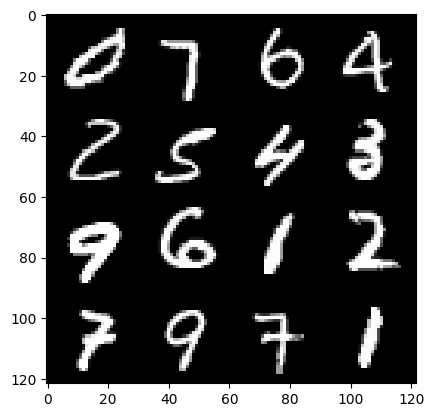

165:step 77400 / Gen loss: 1.95405873854955 / Disc loss: 0.2919880330562589


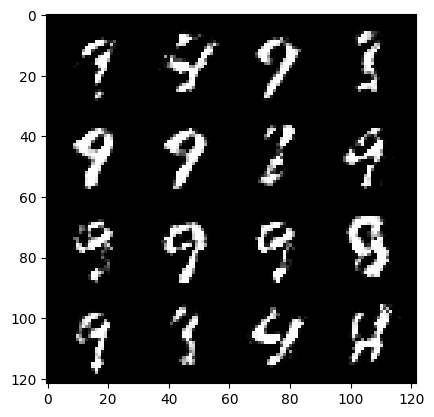

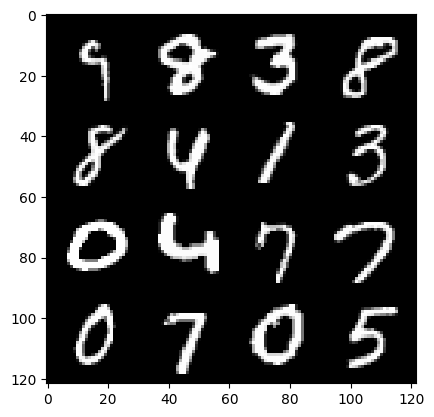

165:step 77700 / Gen loss: 2.0102248318990075 / Disc loss: 0.2859288778404393


  0%|          | 0/469 [00:00<?, ?it/s]

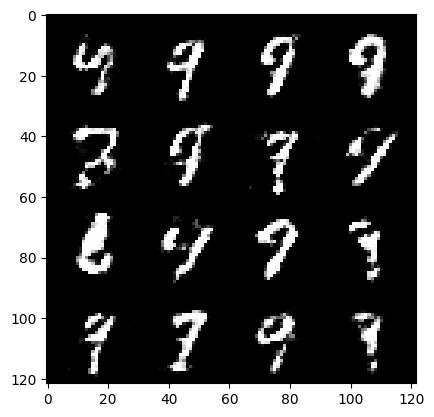

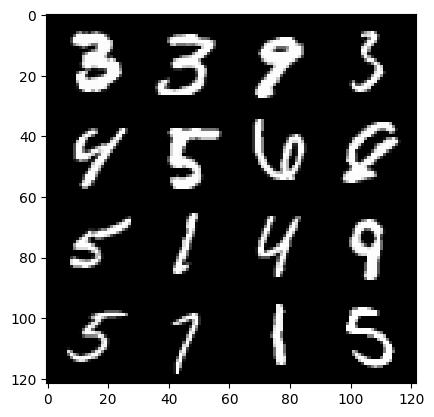

166:step 78000 / Gen loss: 1.942118527094524 / Disc loss: 0.29635620916883126


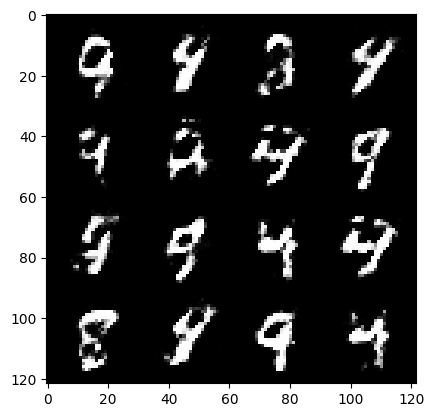

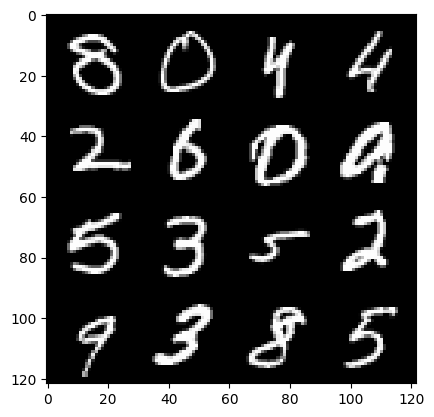

166:step 78300 / Gen loss: 1.9857387141386658 / Disc loss: 0.3005722257991631


  0%|          | 0/469 [00:00<?, ?it/s]

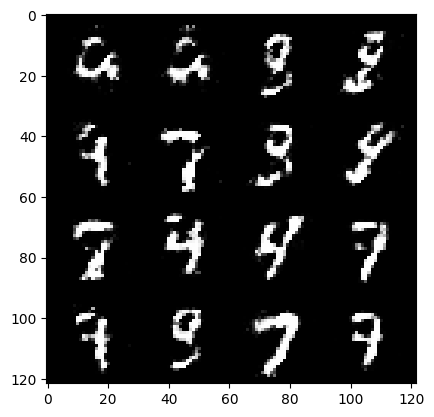

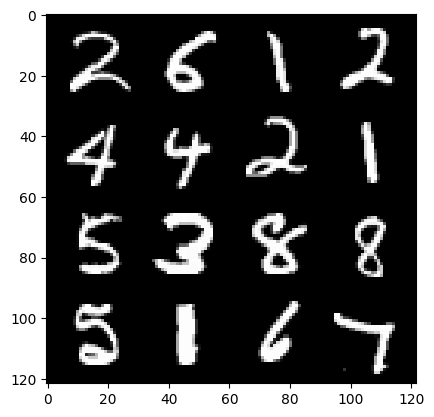

167:step 78600 / Gen loss: 1.8661698778470368 / Disc loss: 0.31881163358688364


  0%|          | 0/469 [00:00<?, ?it/s]

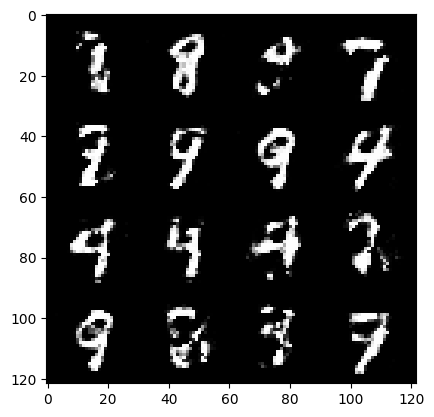

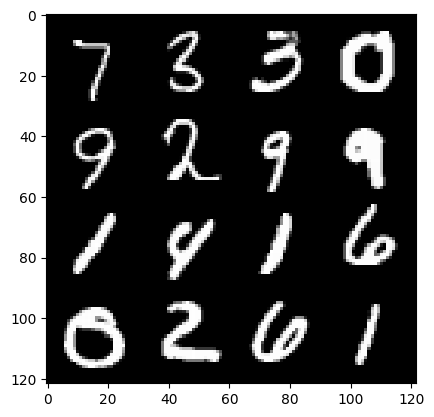

168:step 78900 / Gen loss: 2.0319673848152155 / Disc loss: 0.2959535694122315


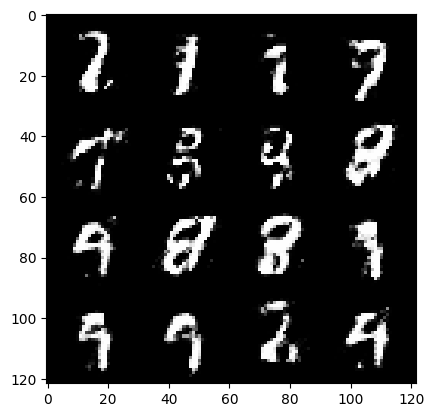

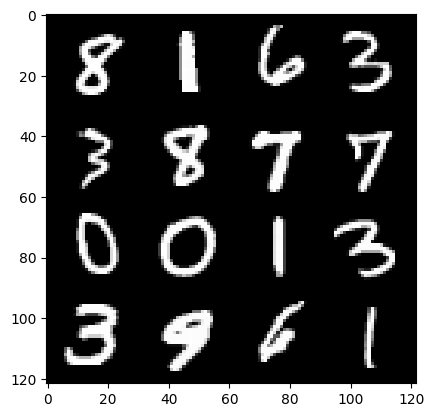

168:step 79200 / Gen loss: 1.9555965908368407 / Disc loss: 0.30979255646467224


  0%|          | 0/469 [00:00<?, ?it/s]

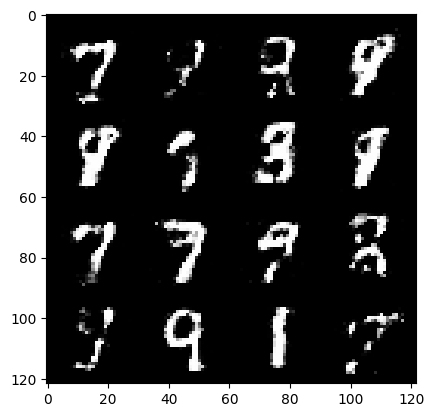

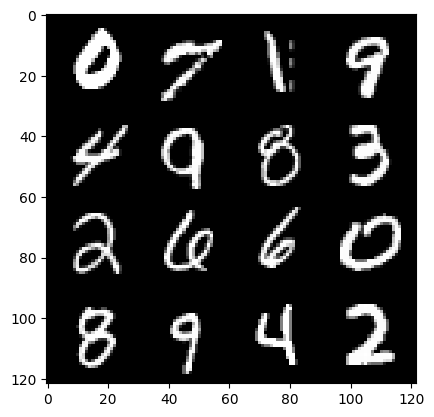

169:step 79500 / Gen loss: 1.9586022241910295 / Disc loss: 0.30382609412074074


  0%|          | 0/469 [00:00<?, ?it/s]

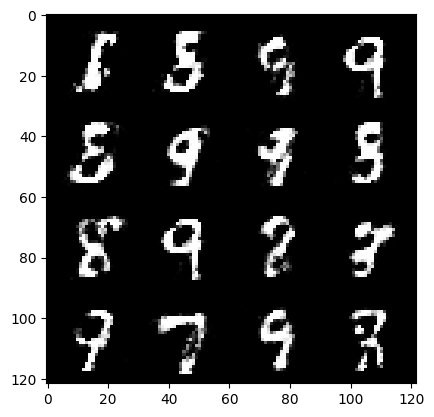

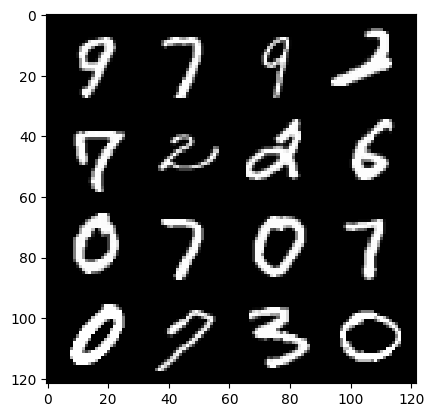

170:step 79800 / Gen loss: 1.979173161188761 / Disc loss: 0.30490351041158076


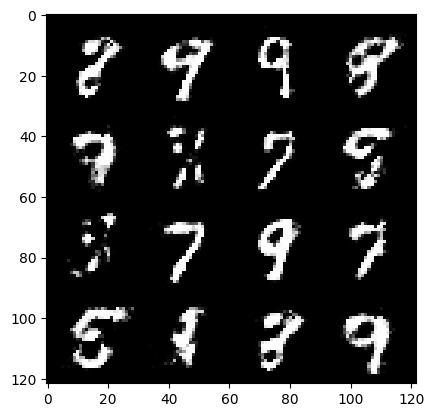

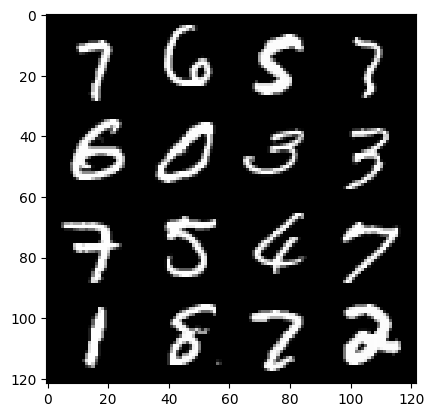

170:step 80100 / Gen loss: 1.904470522006352 / Disc loss: 0.3052219660083453


  0%|          | 0/469 [00:00<?, ?it/s]

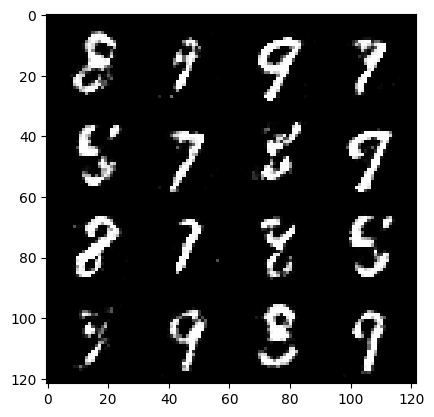

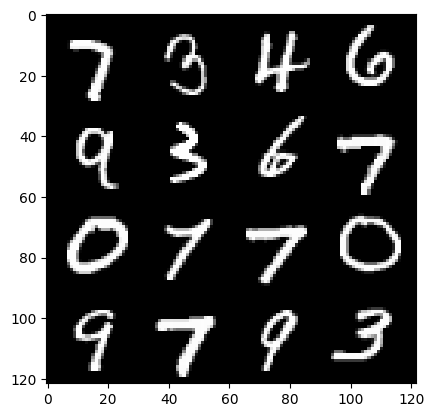

171:step 80400 / Gen loss: 1.9517561117808024 / Disc loss: 0.3060936965545019


  0%|          | 0/469 [00:00<?, ?it/s]

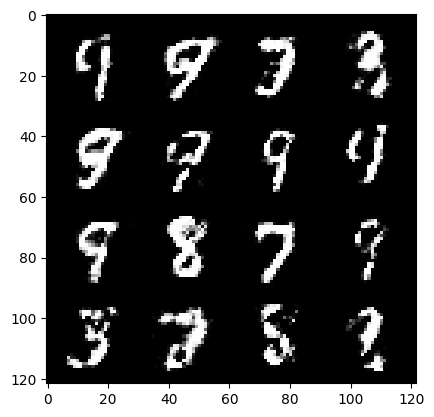

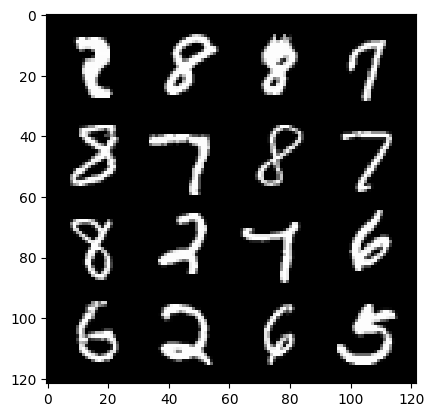

172:step 80700 / Gen loss: 1.9041844109694164 / Disc loss: 0.31300117755929674


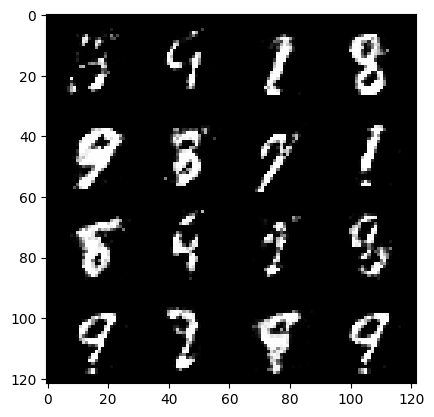

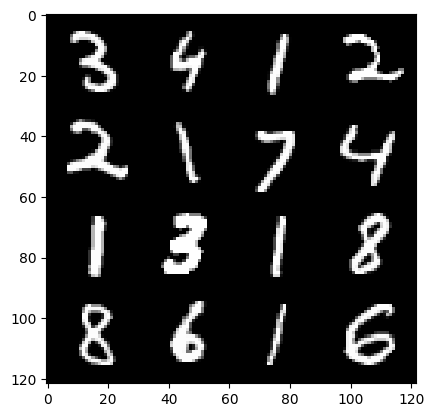

172:step 81000 / Gen loss: 1.998653732935587 / Disc loss: 0.2931655709942183


  0%|          | 0/469 [00:00<?, ?it/s]

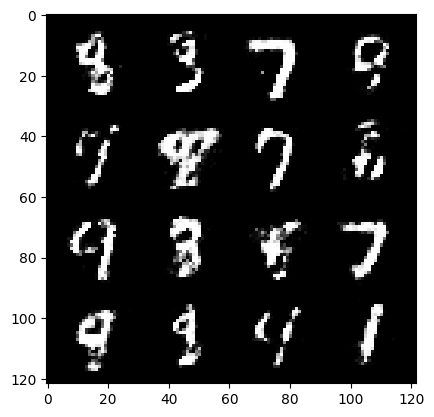

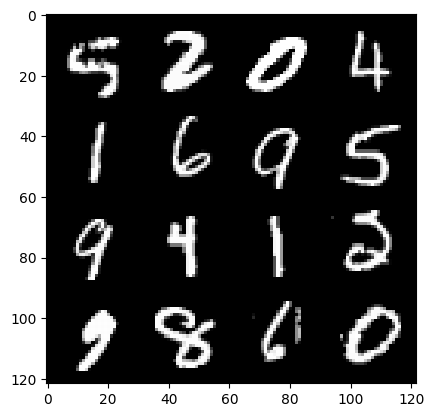

173:step 81300 / Gen loss: 1.883931376934052 / Disc loss: 0.31991113021969775


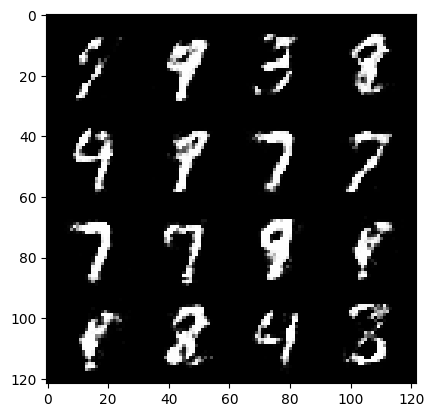

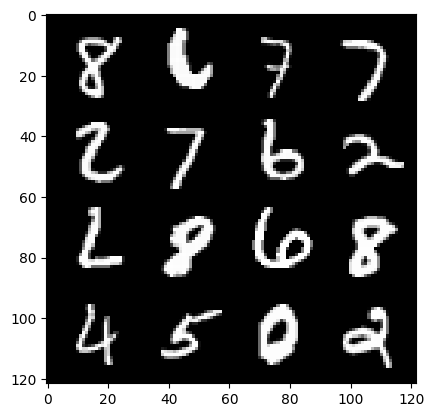

173:step 81600 / Gen loss: 1.8491217950979877 / Disc loss: 0.32164290691415476


  0%|          | 0/469 [00:00<?, ?it/s]

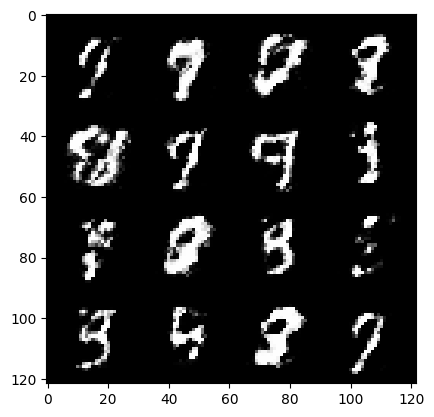

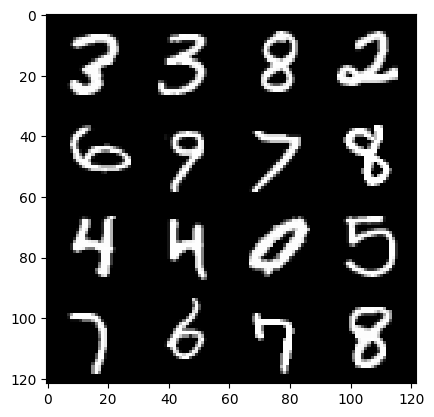

174:step 81900 / Gen loss: 1.865354729096095 / Disc loss: 0.3191057969133061


  0%|          | 0/469 [00:00<?, ?it/s]

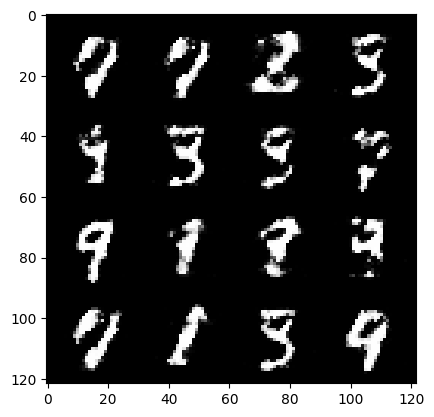

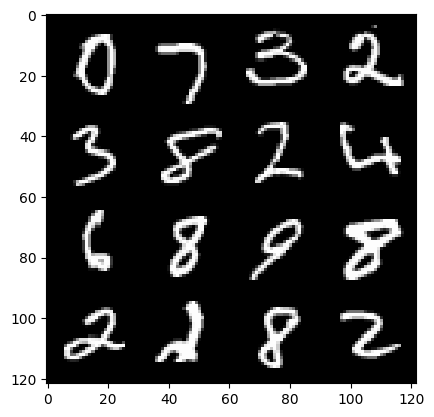

175:step 82200 / Gen loss: 1.9009704244136802 / Disc loss: 0.32682140678167354


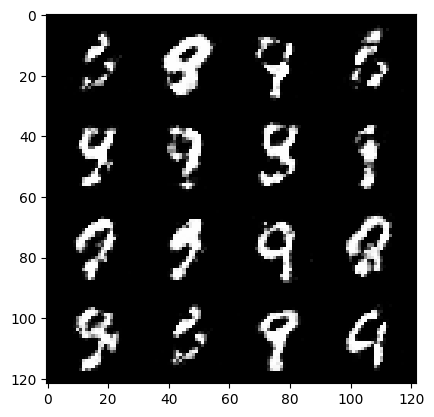

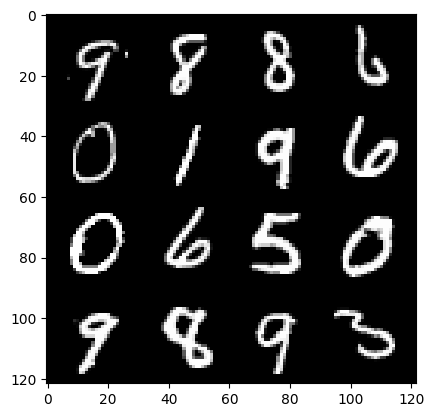

175:step 82500 / Gen loss: 1.8941827189922347 / Disc loss: 0.3305760784943897


  0%|          | 0/469 [00:00<?, ?it/s]

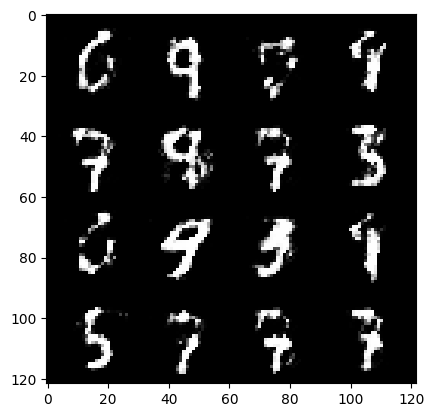

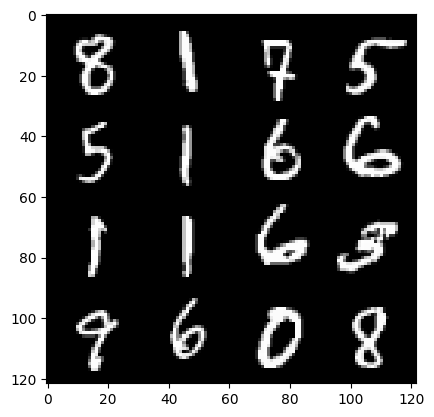

176:step 82800 / Gen loss: 1.8538867330551134 / Disc loss: 0.33503558188676824


  0%|          | 0/469 [00:00<?, ?it/s]

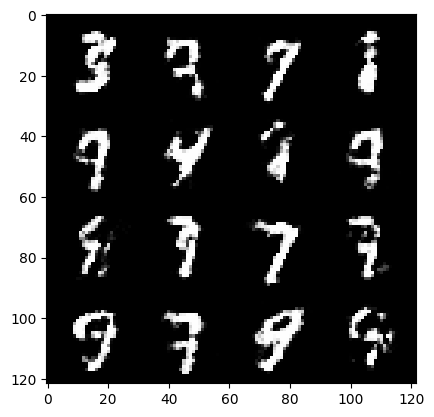

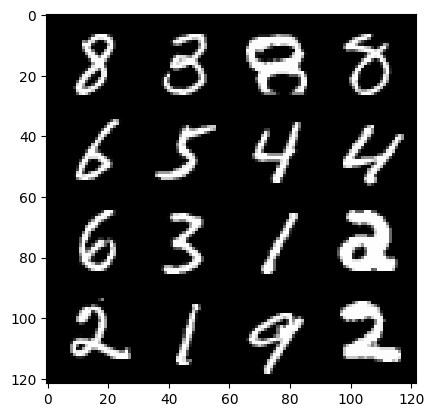

177:step 83100 / Gen loss: 1.8728383278846745 / Disc loss: 0.3325945952534676


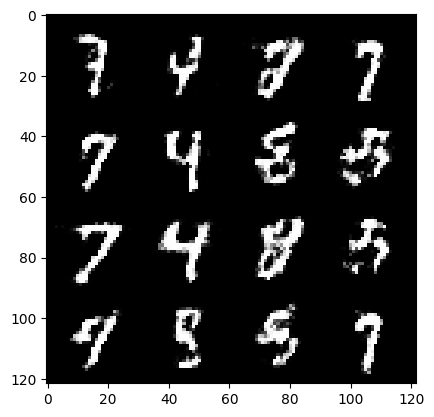

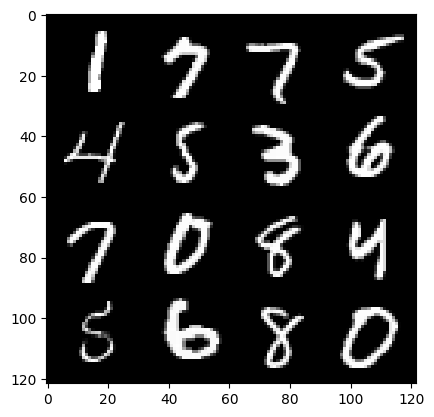

177:step 83400 / Gen loss: 1.8208903384208681 / Disc loss: 0.33929395735263845


  0%|          | 0/469 [00:00<?, ?it/s]

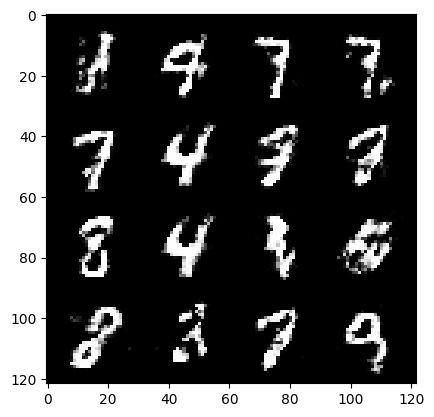

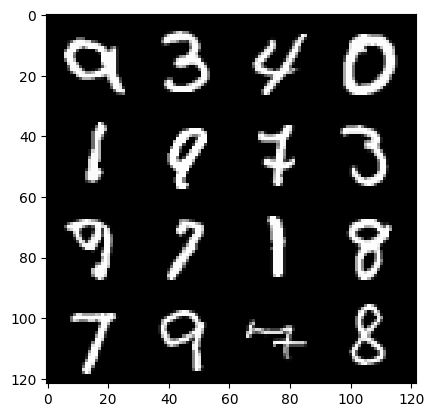

178:step 83700 / Gen loss: 1.8619877688090005 / Disc loss: 0.33009077757596966


  0%|          | 0/469 [00:00<?, ?it/s]

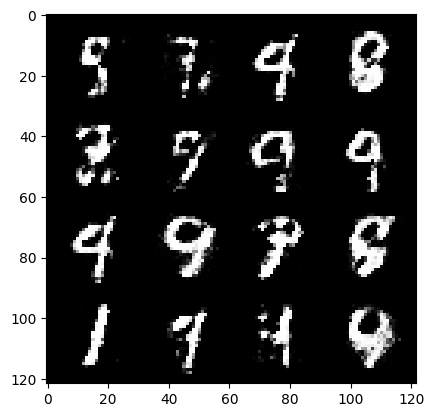

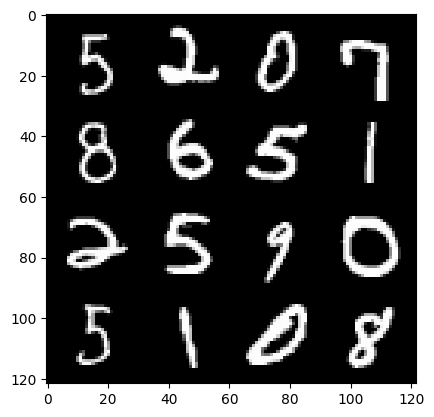

179:step 84000 / Gen loss: 1.8174060364564257 / Disc loss: 0.33928092047572117


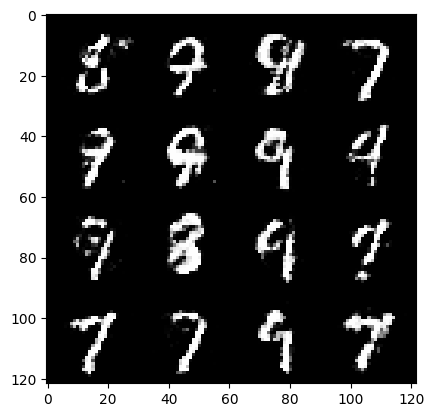

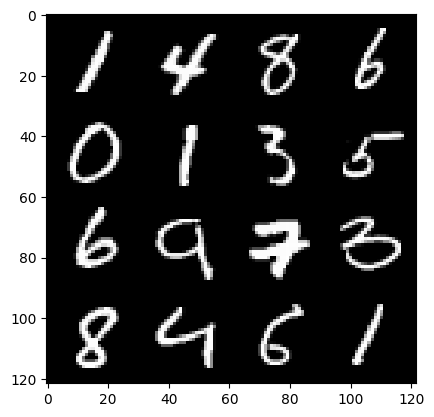

179:step 84300 / Gen loss: 1.850708141326903 / Disc loss: 0.3278929647803305


  0%|          | 0/469 [00:00<?, ?it/s]

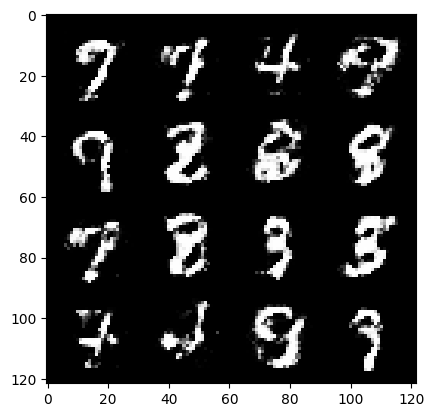

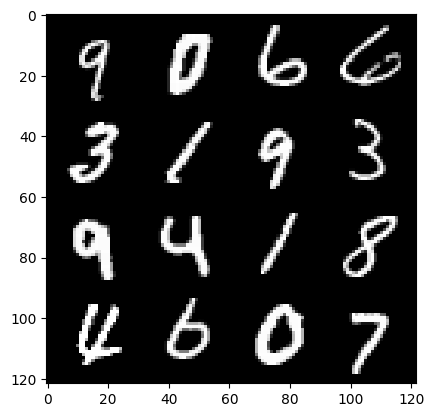

180:step 84600 / Gen loss: 1.7974589494864126 / Disc loss: 0.3464153761665027


  0%|          | 0/469 [00:00<?, ?it/s]

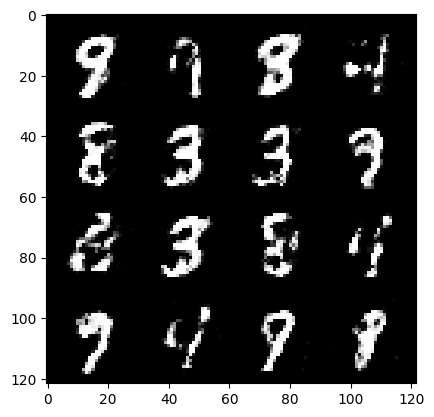

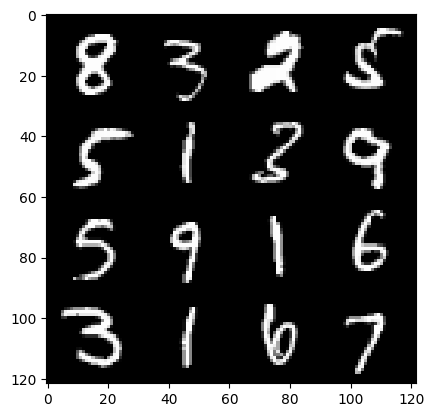

181:step 84900 / Gen loss: 1.6808436377843214 / Disc loss: 0.3679223189751305


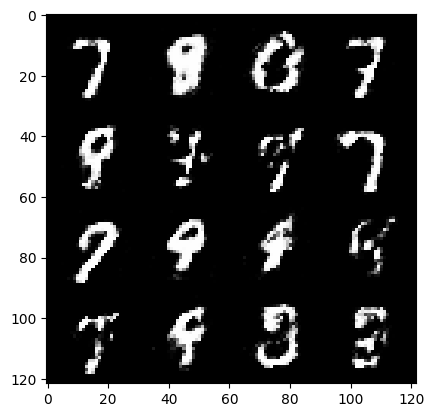

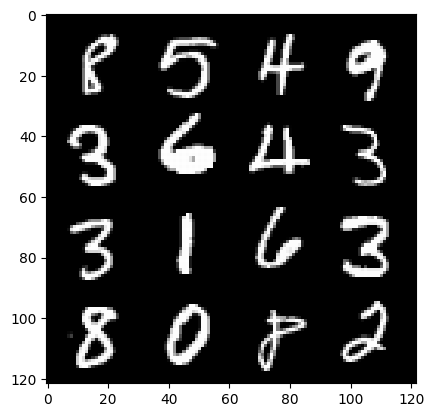

181:step 85200 / Gen loss: 1.750409004688263 / Disc loss: 0.3515094087521233


  0%|          | 0/469 [00:00<?, ?it/s]

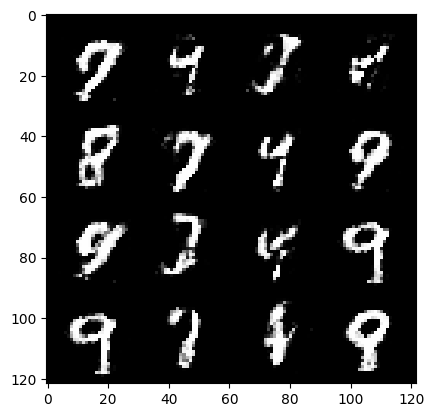

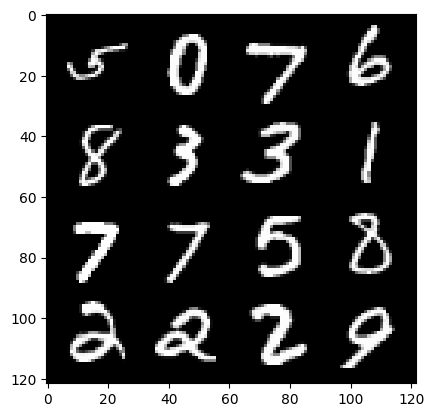

182:step 85500 / Gen loss: 1.68397163748741 / Disc loss: 0.36389327824115736


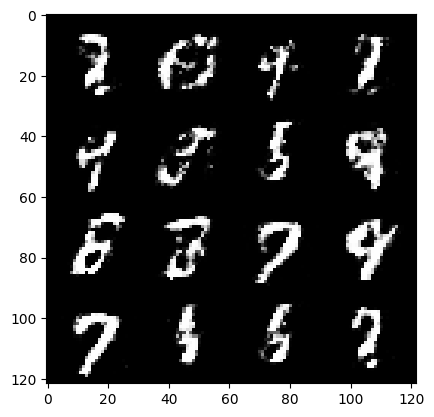

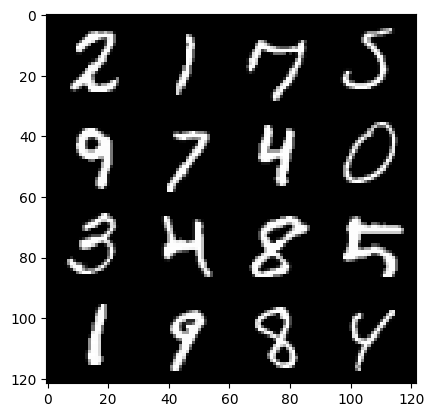

182:step 85800 / Gen loss: 1.75144253373146 / Disc loss: 0.34085744346181557


  0%|          | 0/469 [00:00<?, ?it/s]

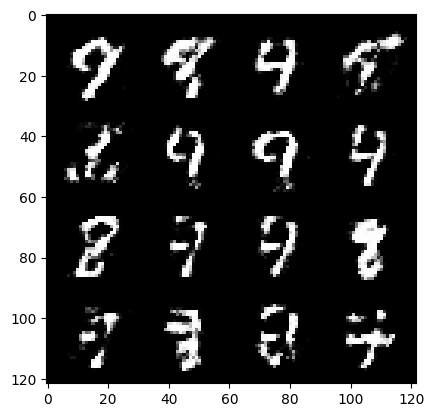

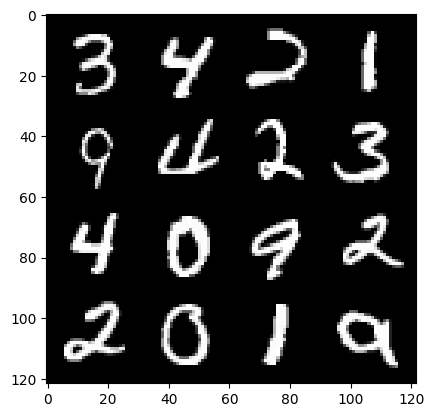

183:step 86100 / Gen loss: 1.7670434176921836 / Disc loss: 0.3492687680323917


  0%|          | 0/469 [00:00<?, ?it/s]

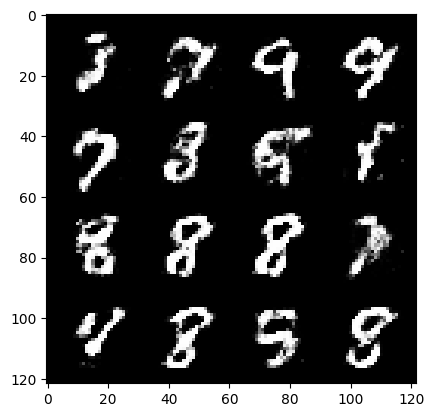

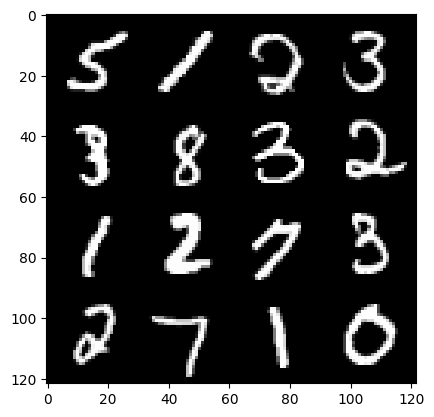

184:step 86400 / Gen loss: 1.6882885754108437 / Disc loss: 0.36207804650068276


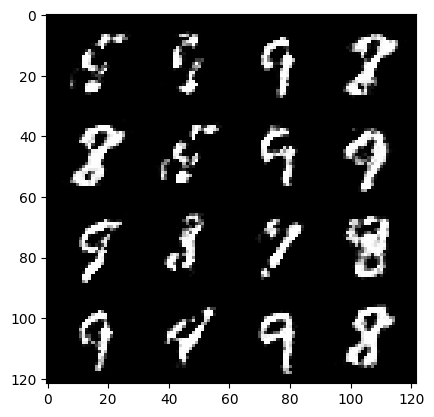

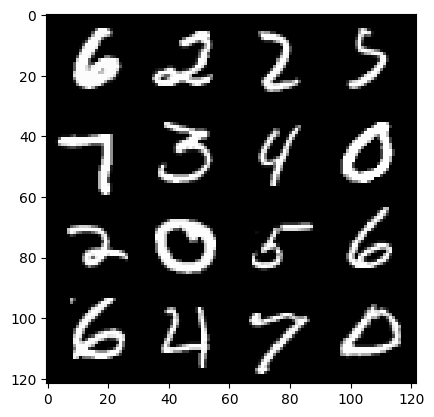

184:step 86700 / Gen loss: 1.7803999710083005 / Disc loss: 0.338667439321677


  0%|          | 0/469 [00:00<?, ?it/s]

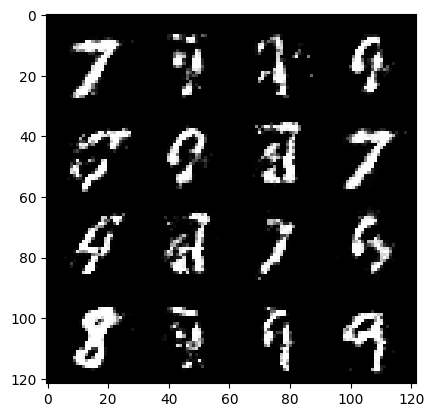

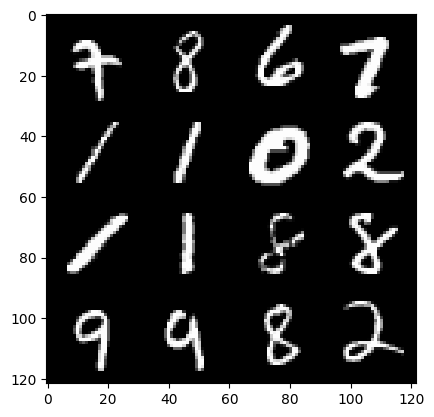

185:step 87000 / Gen loss: 1.6848313005765279 / Disc loss: 0.37115108301242156


  0%|          | 0/469 [00:00<?, ?it/s]

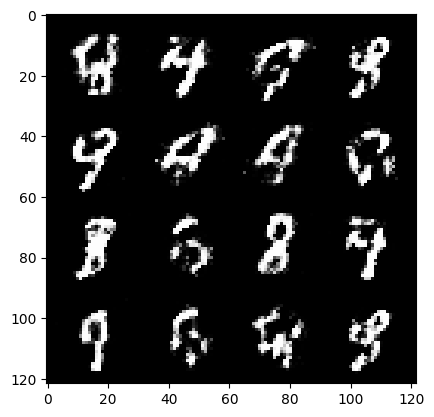

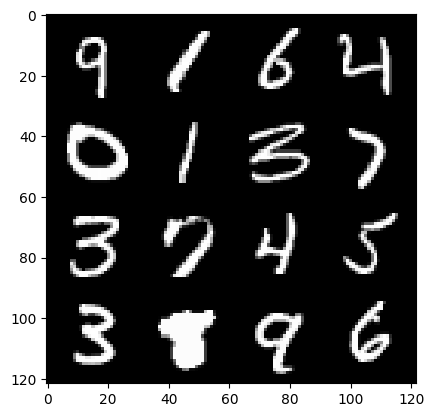

186:step 87300 / Gen loss: 1.714404846827189 / Disc loss: 0.35417072604099903


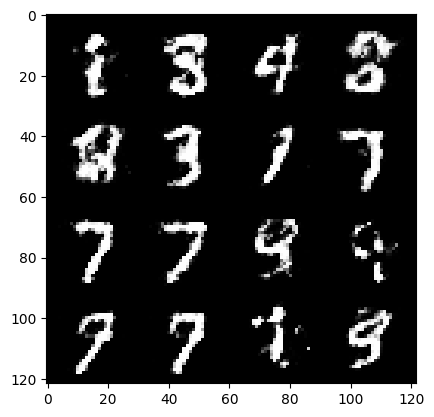

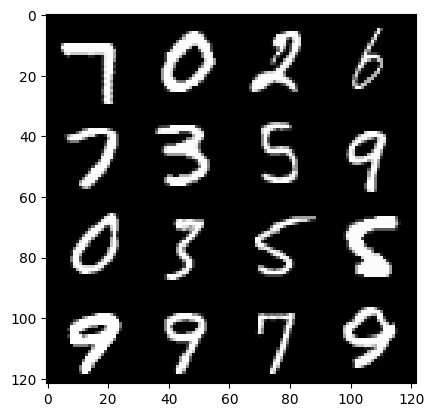

186:step 87600 / Gen loss: 1.6830534303188336 / Disc loss: 0.37325364251931514


  0%|          | 0/469 [00:00<?, ?it/s]

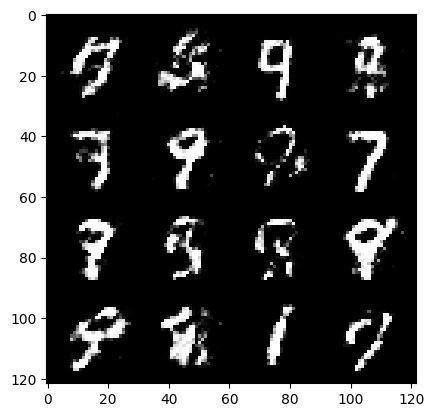

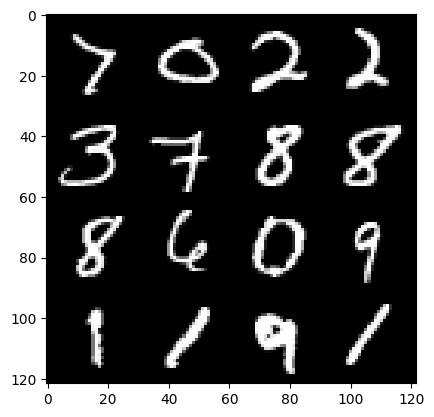

187:step 87900 / Gen loss: 1.661236606836319 / Disc loss: 0.37411071876684837


  0%|          | 0/469 [00:00<?, ?it/s]

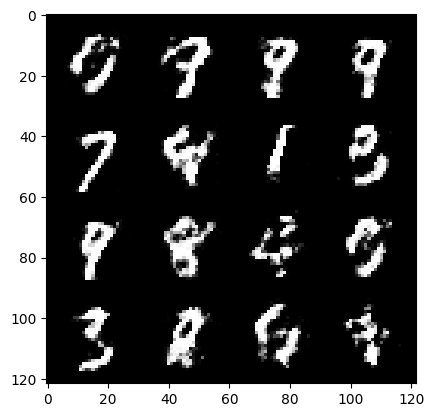

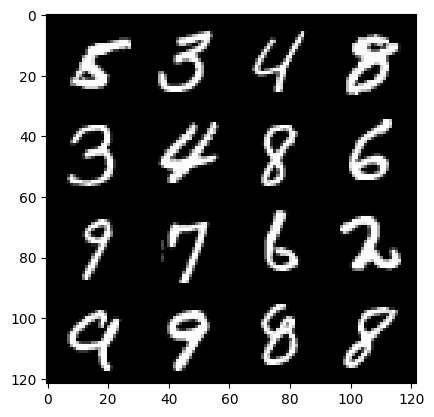

188:step 88200 / Gen loss: 1.682954852581024 / Disc loss: 0.37226651072502126


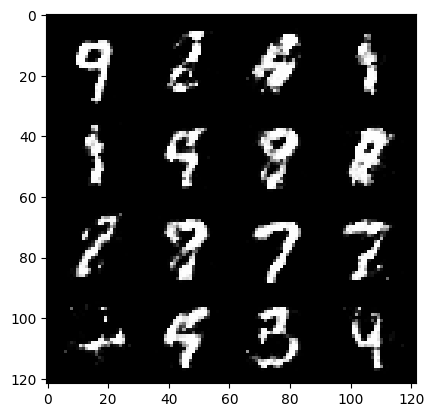

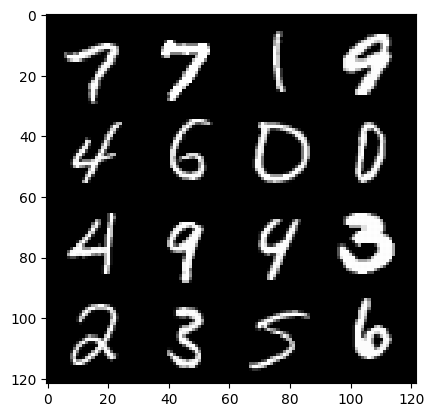

188:step 88500 / Gen loss: 1.6215749581654875 / Disc loss: 0.38496240357557926


  0%|          | 0/469 [00:00<?, ?it/s]

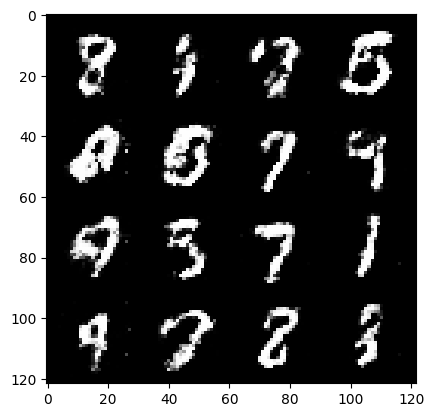

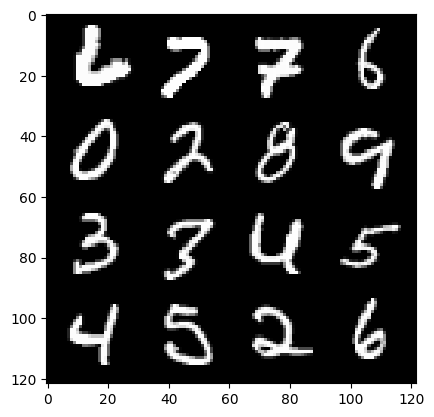

189:step 88800 / Gen loss: 1.6430434469381976 / Disc loss: 0.37516241431236264


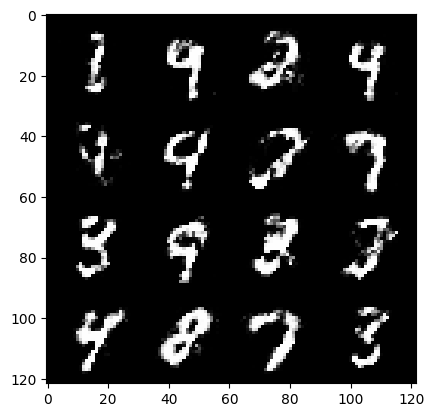

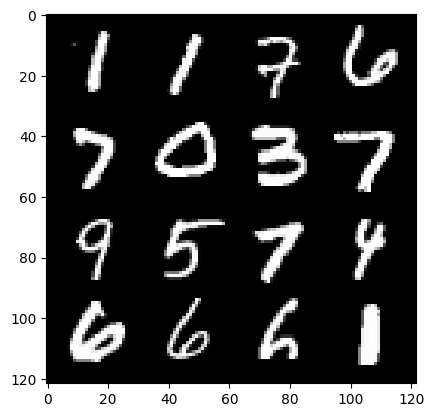

189:step 89100 / Gen loss: 1.6591648443539944 / Disc loss: 0.3759118733803429


  0%|          | 0/469 [00:00<?, ?it/s]

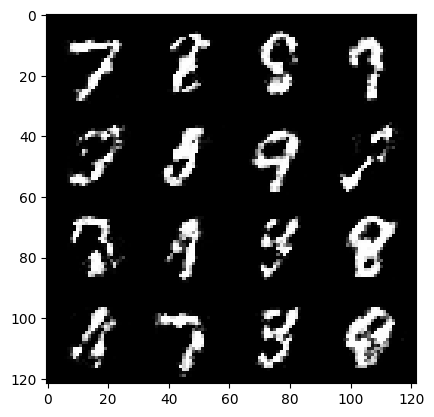

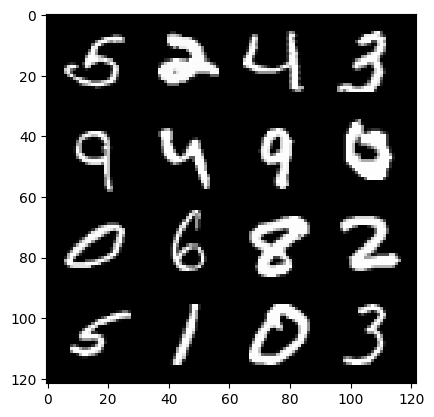

190:step 89400 / Gen loss: 1.617268183628718 / Disc loss: 0.38111072868108725


  0%|          | 0/469 [00:00<?, ?it/s]

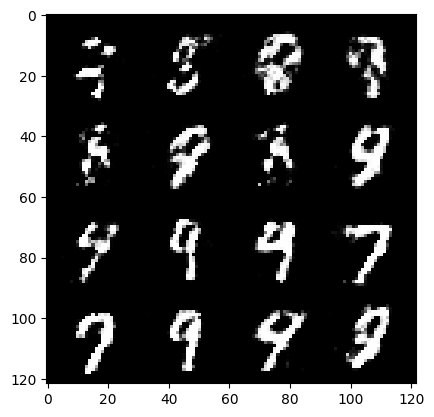

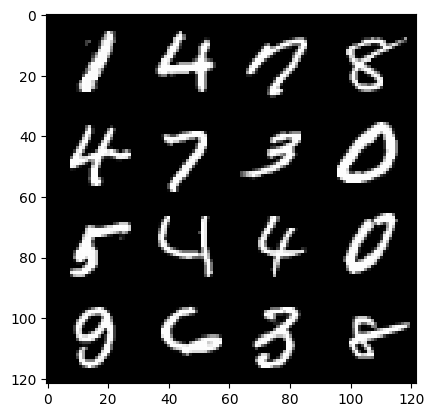

191:step 89700 / Gen loss: 1.6562476698557533 / Disc loss: 0.3675402750571568


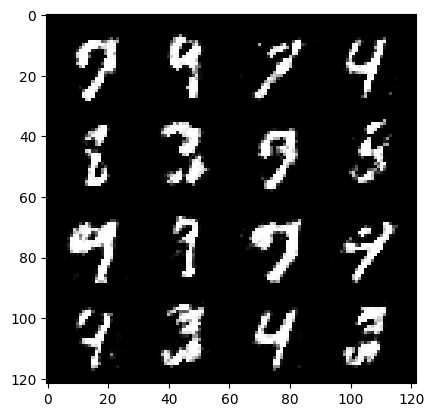

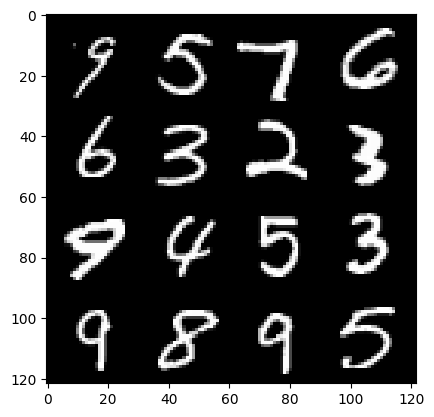

191:step 90000 / Gen loss: 1.676697479089101 / Disc loss: 0.3630007093151408


  0%|          | 0/469 [00:00<?, ?it/s]

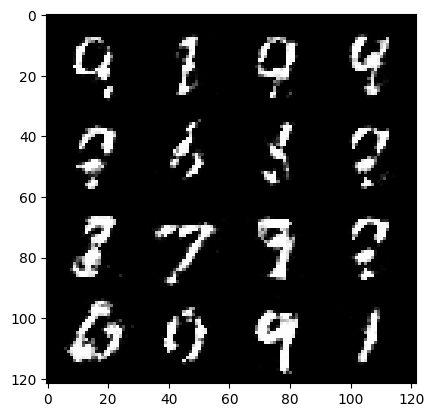

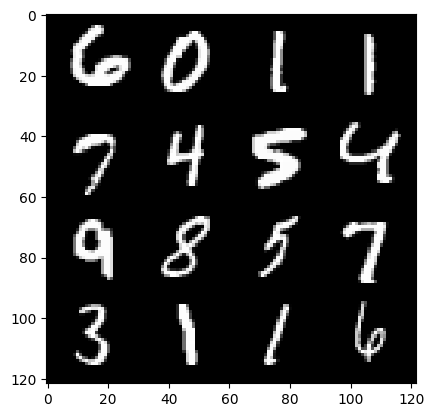

192:step 90300 / Gen loss: 1.7047937464714042 / Disc loss: 0.35854840507109964


  0%|          | 0/469 [00:00<?, ?it/s]

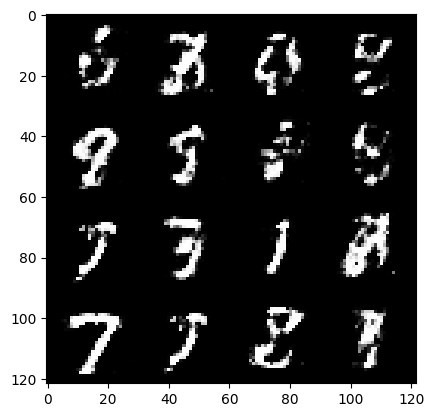

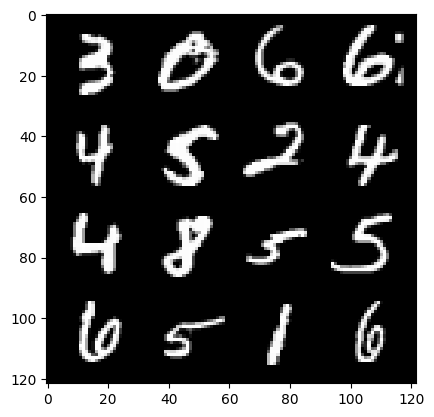

193:step 90600 / Gen loss: 1.6285488112767523 / Disc loss: 0.37332944050431277


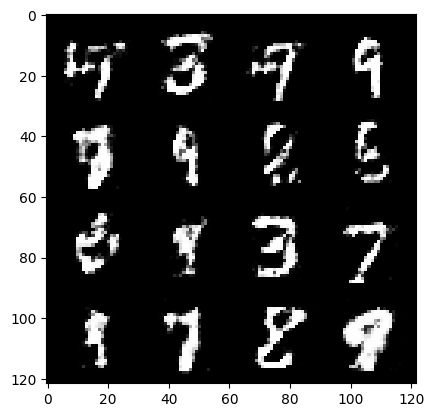

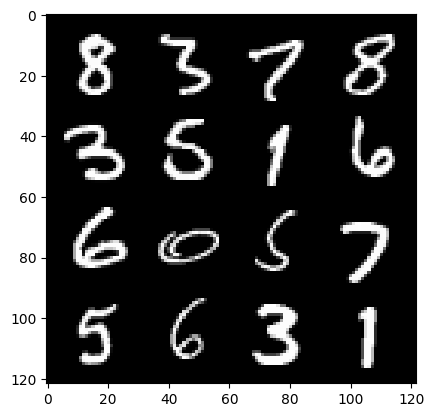

193:step 90900 / Gen loss: 1.6798183107376088 / Disc loss: 0.3703276207049691


  0%|          | 0/469 [00:00<?, ?it/s]

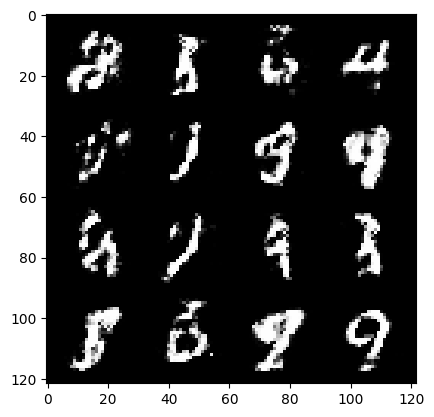

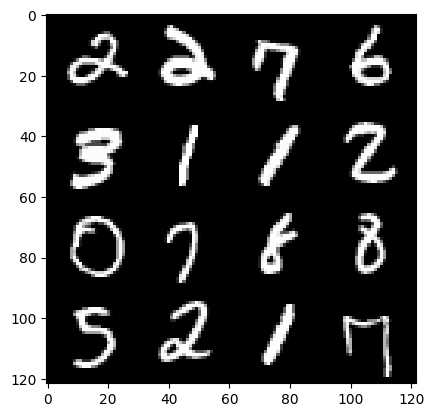

194:step 91200 / Gen loss: 1.6152707223097484 / Disc loss: 0.3881293923656145


  0%|          | 0/469 [00:00<?, ?it/s]

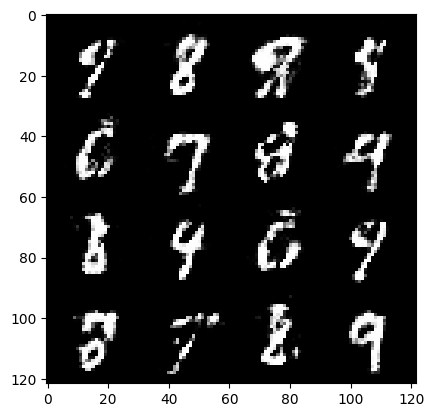

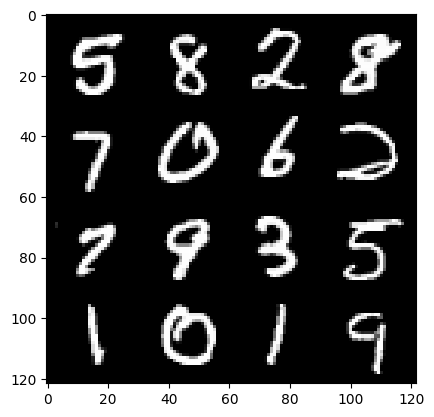

195:step 91500 / Gen loss: 1.5794023517767601 / Disc loss: 0.3873810026049612


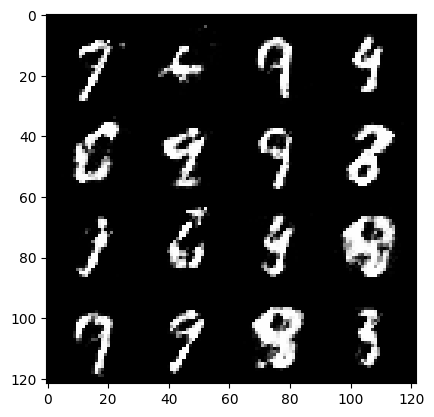

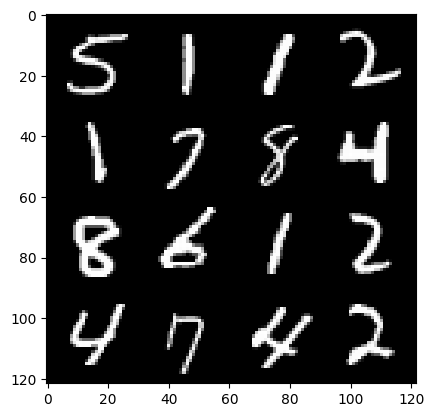

195:step 91800 / Gen loss: 1.5955847815672564 / Disc loss: 0.3882574515541397


  0%|          | 0/469 [00:00<?, ?it/s]

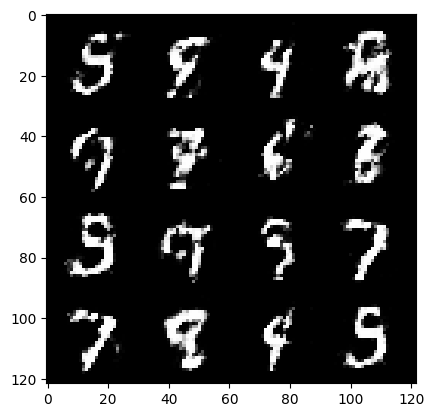

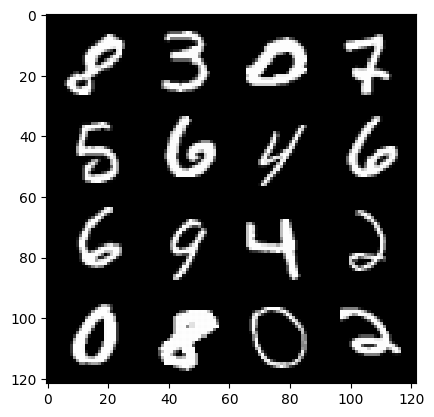

196:step 92100 / Gen loss: 1.5599905824661249 / Disc loss: 0.392382200161616


  0%|          | 0/469 [00:00<?, ?it/s]

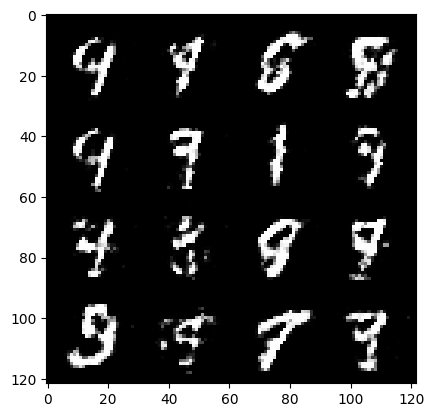

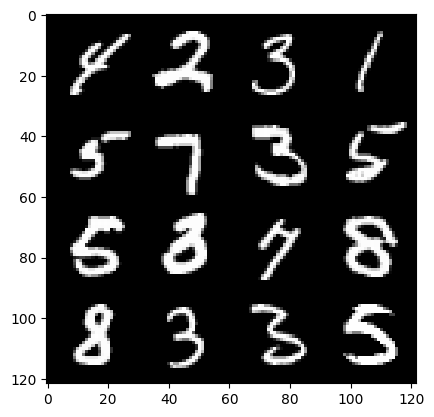

197:step 92400 / Gen loss: 1.6154175599416114 / Disc loss: 0.38174562484025953


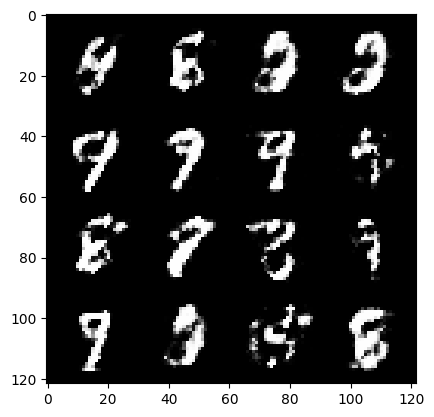

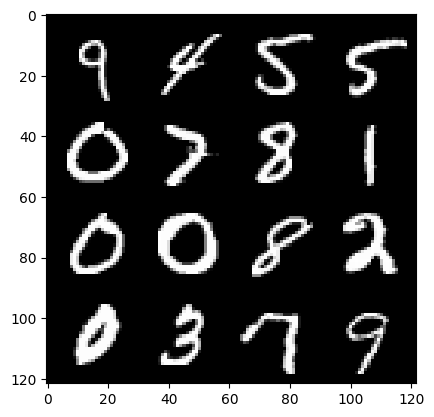

197:step 92700 / Gen loss: 1.6040969375769287 / Disc loss: 0.3893591584761934


  0%|          | 0/469 [00:00<?, ?it/s]

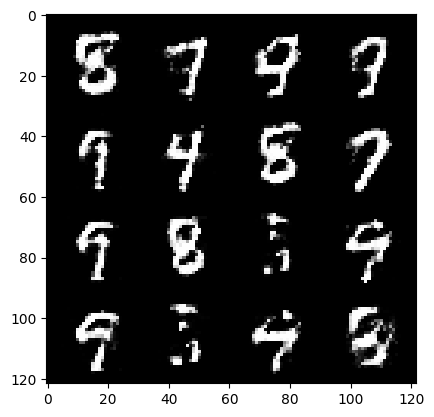

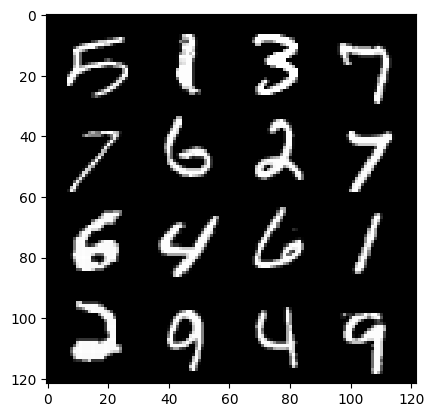

198:step 93000 / Gen loss: 1.5746186693509416 / Disc loss: 0.4061167242129643


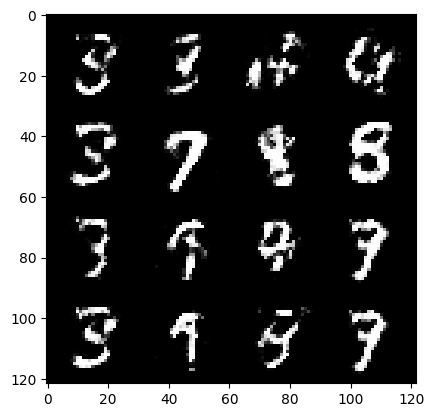

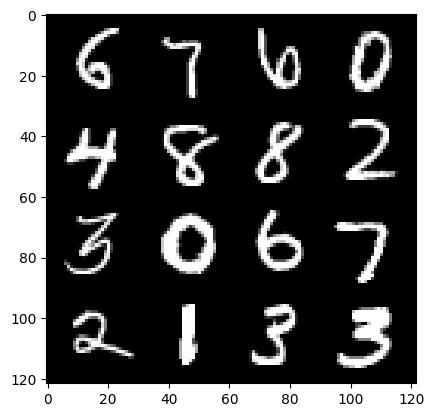

198:step 93300 / Gen loss: 1.4966653899351774 / Disc loss: 0.4118829858303073


  0%|          | 0/469 [00:00<?, ?it/s]

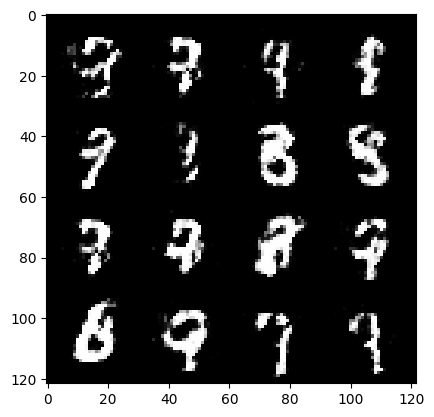

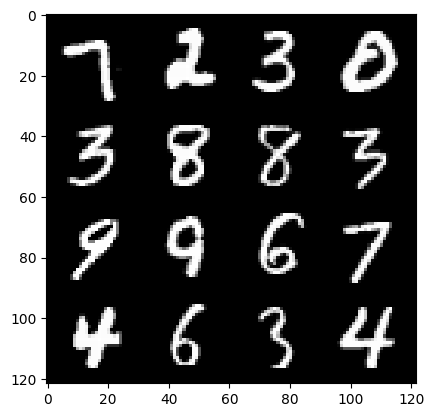

199:step 93600 / Gen loss: 1.5258182946840915 / Disc loss: 0.4070151809851329


  0%|          | 0/469 [00:00<?, ?it/s]

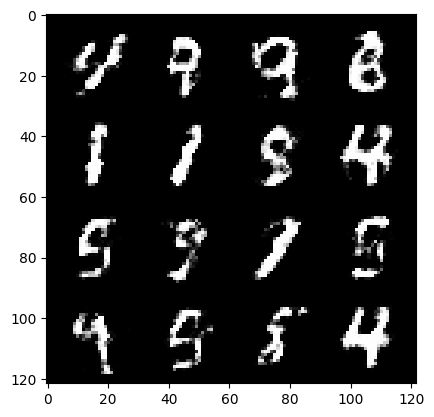

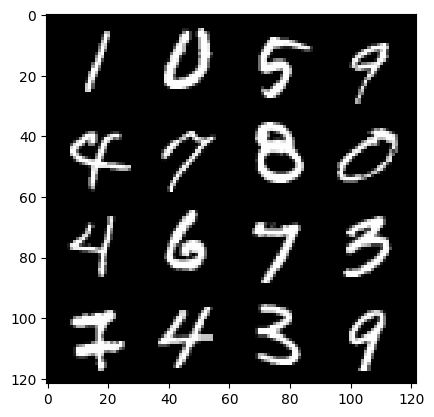

200:step 93900 / Gen loss: 1.4828117533524832 / Disc loss: 0.4243050412336987


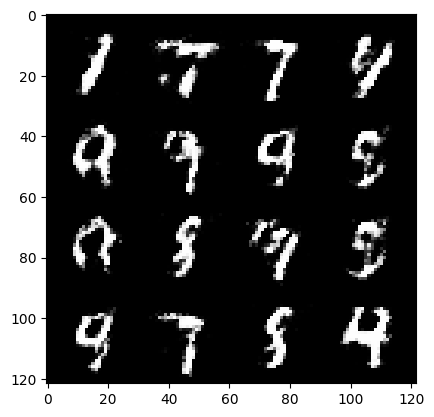

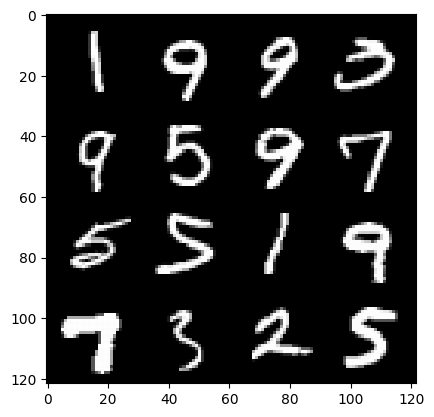

200:step 94200 / Gen loss: 1.4957407041390733 / Disc loss: 0.41127031604448955


  0%|          | 0/469 [00:00<?, ?it/s]

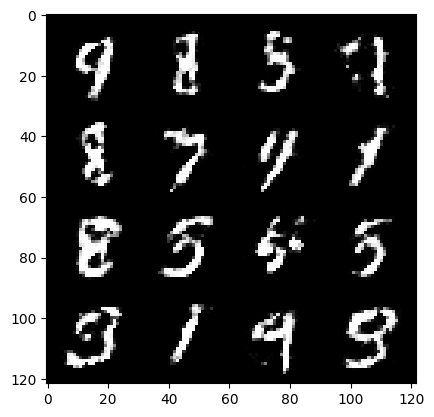

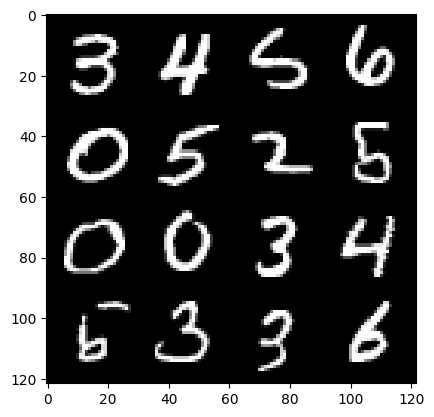

201:step 94500 / Gen loss: 1.547875584363938 / Disc loss: 0.4047490407029788


  0%|          | 0/469 [00:00<?, ?it/s]

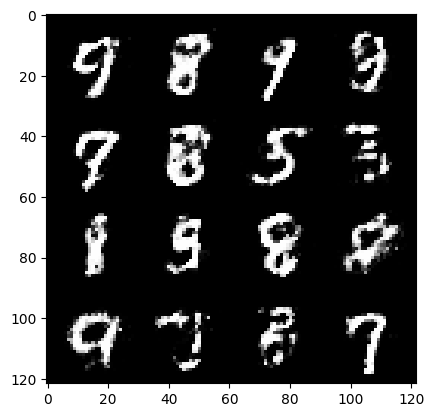

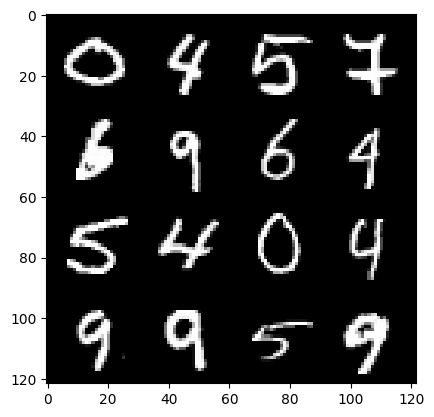

202:step 94800 / Gen loss: 1.419228953123093 / Disc loss: 0.4401059327522914


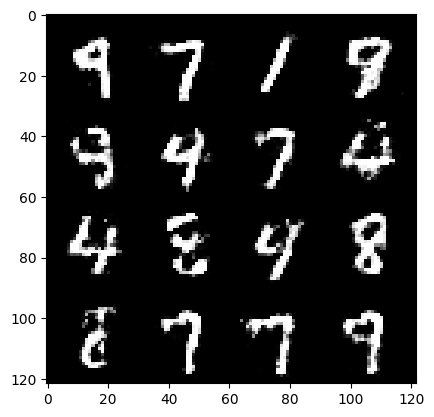

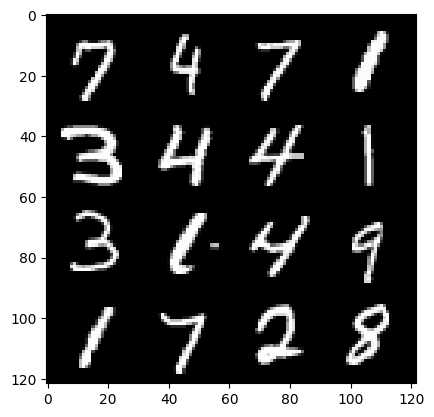

202:step 95100 / Gen loss: 1.39630795399348 / Disc loss: 0.4394375062982244


  0%|          | 0/469 [00:00<?, ?it/s]

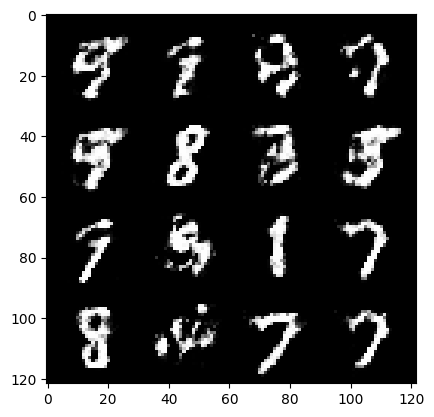

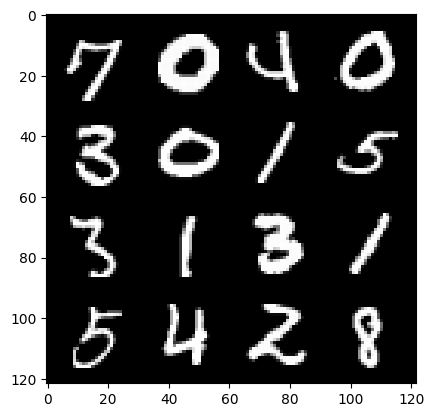

203:step 95400 / Gen loss: 1.410725922187169 / Disc loss: 0.4348767777283986


  0%|          | 0/469 [00:00<?, ?it/s]

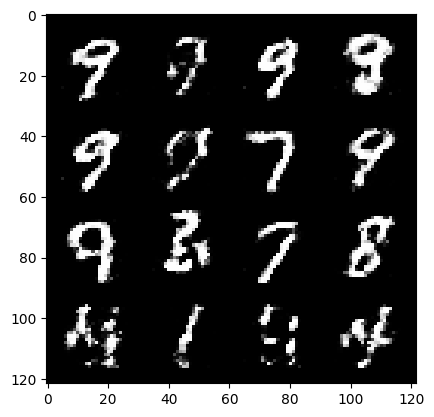

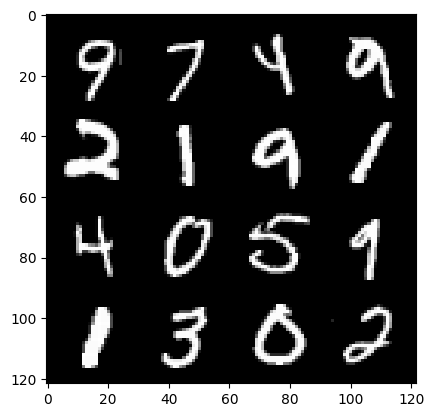

204:step 95700 / Gen loss: 1.4734007326761875 / Disc loss: 0.41253137648105626


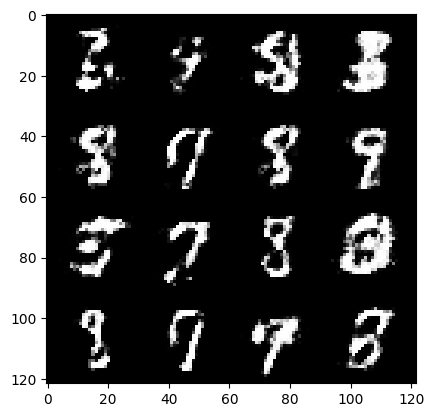

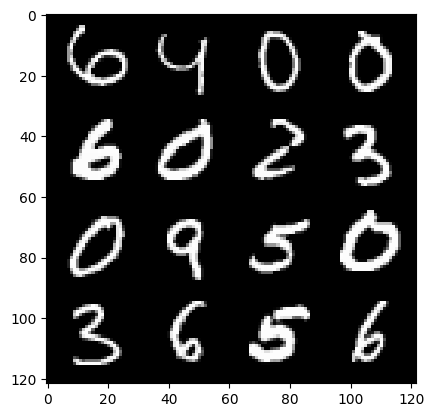

204:step 96000 / Gen loss: 1.4989800747235624 / Disc loss: 0.40504450450340906


  0%|          | 0/469 [00:00<?, ?it/s]

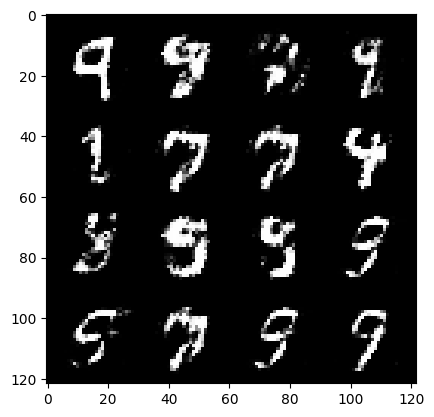

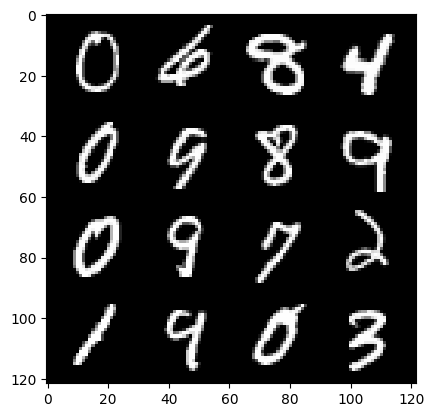

205:step 96300 / Gen loss: 1.4973141050338745 / Disc loss: 0.4010618290305138


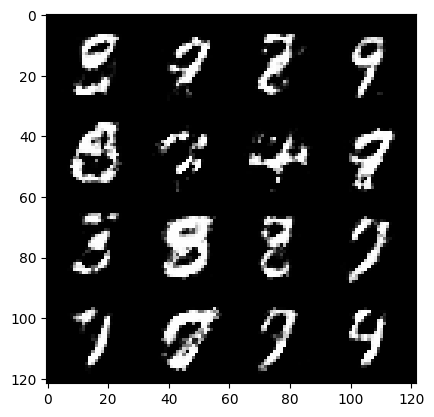

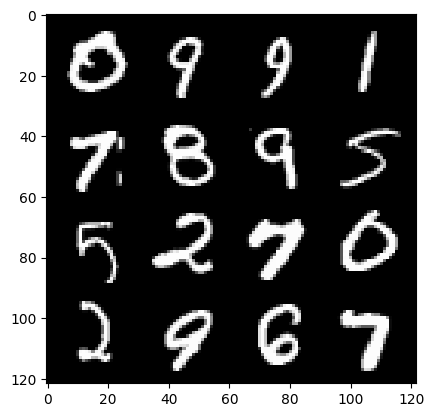

205:step 96600 / Gen loss: 1.5422431715329492 / Disc loss: 0.3976836264133454


  0%|          | 0/469 [00:00<?, ?it/s]

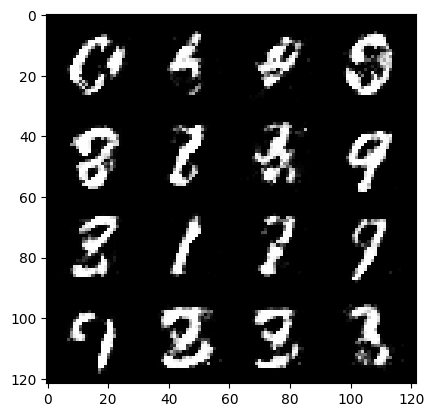

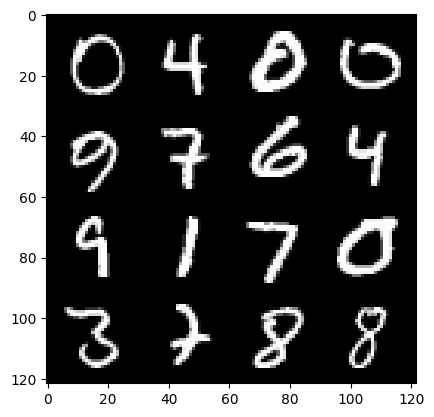

206:step 96900 / Gen loss: 1.5647512098153435 / Disc loss: 0.3948475690682725


  0%|          | 0/469 [00:00<?, ?it/s]

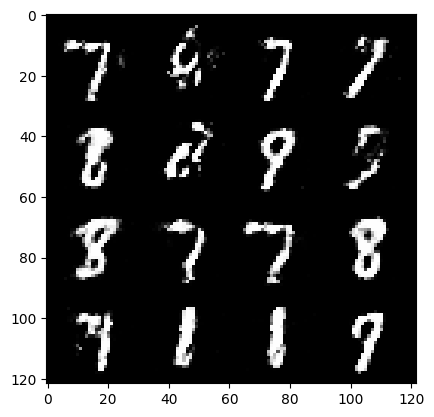

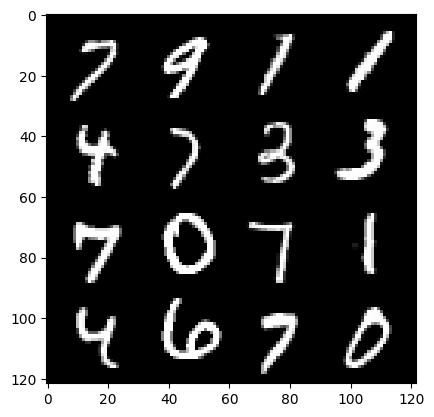

207:step 97200 / Gen loss: 1.564082686503729 / Disc loss: 0.39858846316734964


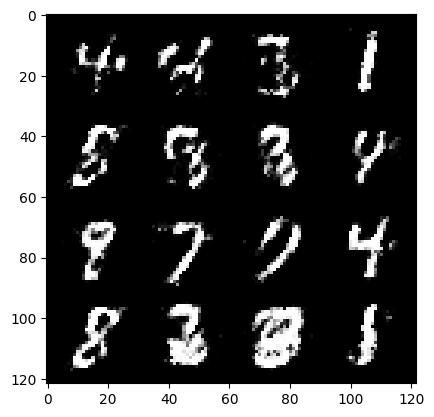

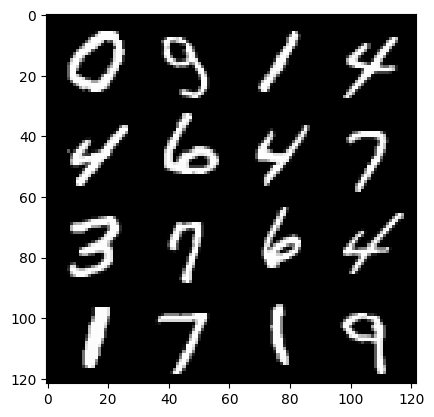

207:step 97500 / Gen loss: 1.5895721014340731 / Disc loss: 0.38566821167866383


  0%|          | 0/469 [00:00<?, ?it/s]

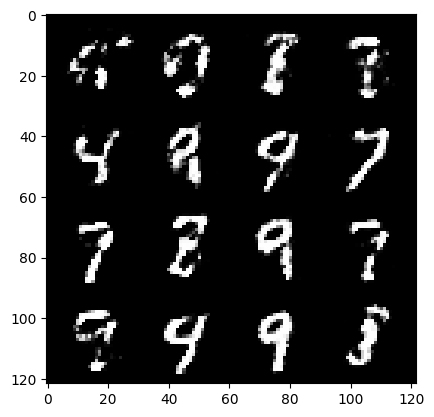

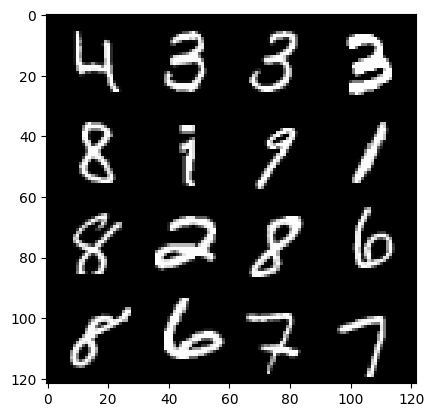

208:step 97800 / Gen loss: 1.4624328207969663 / Disc loss: 0.4190928882360459


  0%|          | 0/469 [00:00<?, ?it/s]

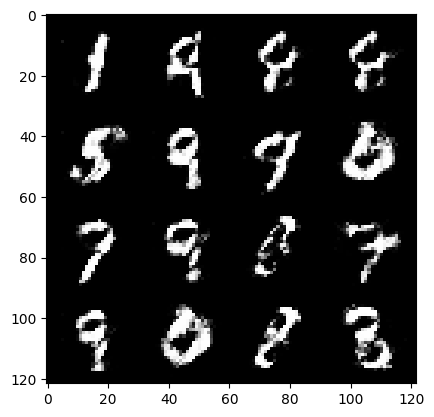

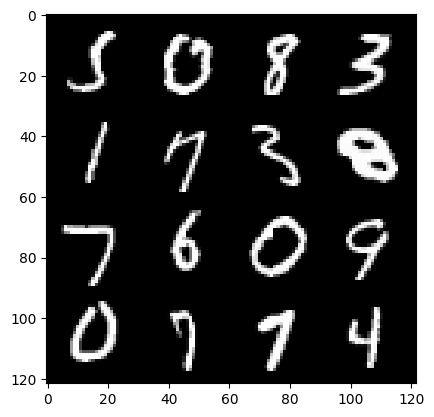

209:step 98100 / Gen loss: 1.4484676182270044 / Disc loss: 0.4153683255116144


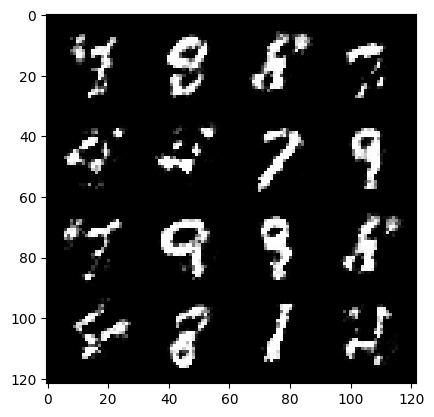

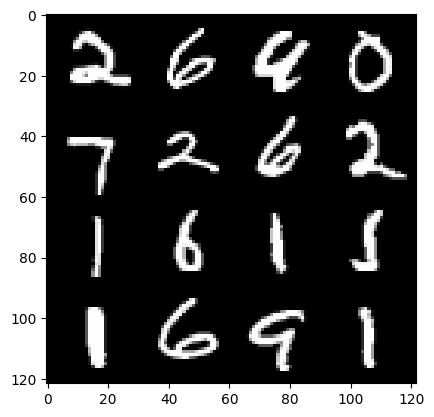

209:step 98400 / Gen loss: 1.4535825979709616 / Disc loss: 0.4304069100817045


  0%|          | 0/469 [00:00<?, ?it/s]

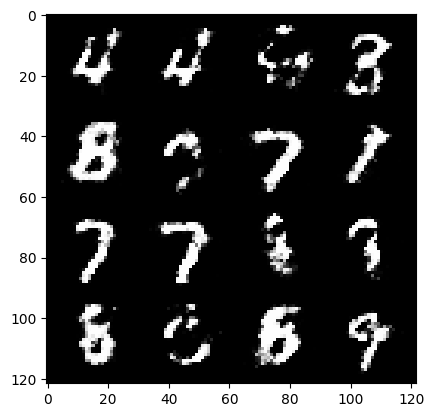

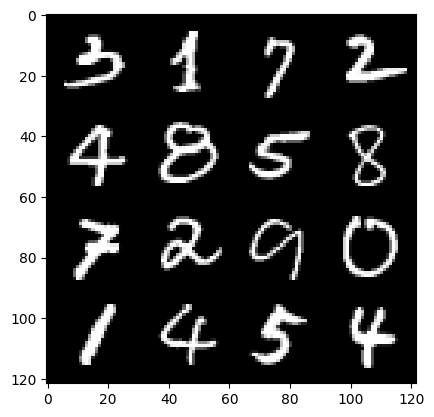

210:step 98700 / Gen loss: 1.423059544165931 / Disc loss: 0.42964274535576474


  0%|          | 0/469 [00:00<?, ?it/s]

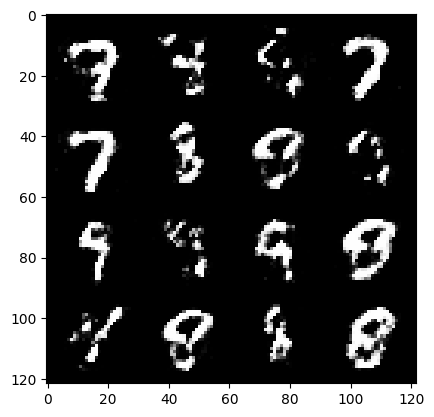

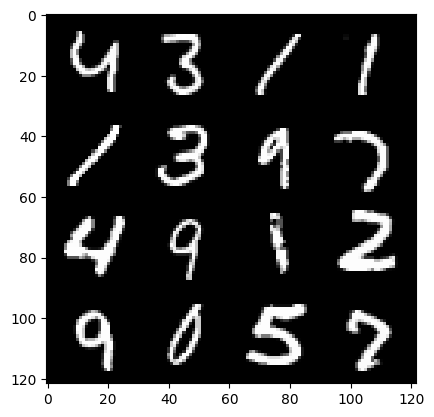

211:step 99000 / Gen loss: 1.5144015288352966 / Disc loss: 0.39978419522444386


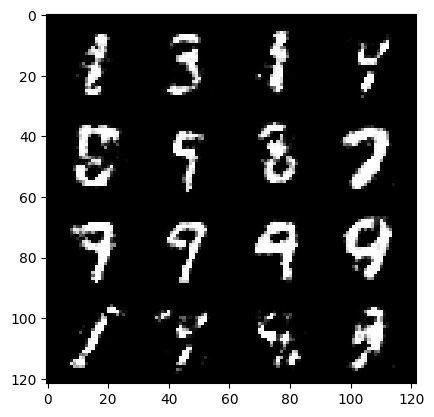

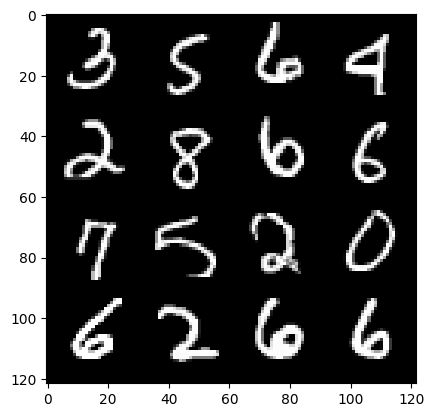

211:step 99300 / Gen loss: 1.5138766189416253 / Disc loss: 0.3960484913984934


  0%|          | 0/469 [00:00<?, ?it/s]

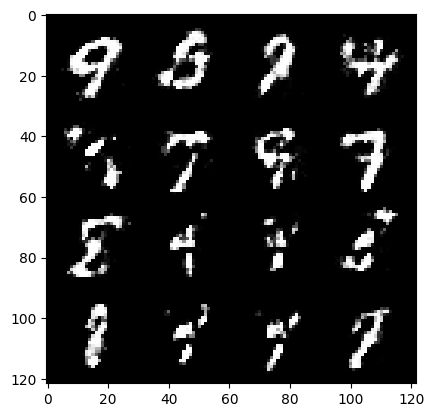

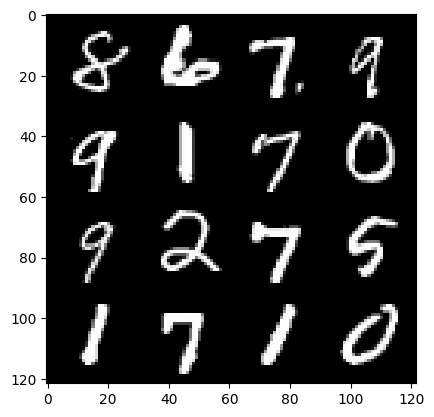

212:step 99600 / Gen loss: 1.4783579417069754 / Disc loss: 0.4099812884132065


  0%|          | 0/469 [00:00<?, ?it/s]

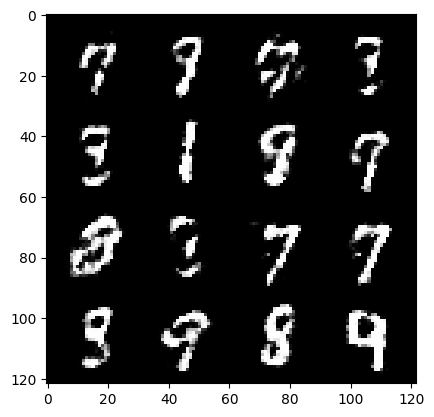

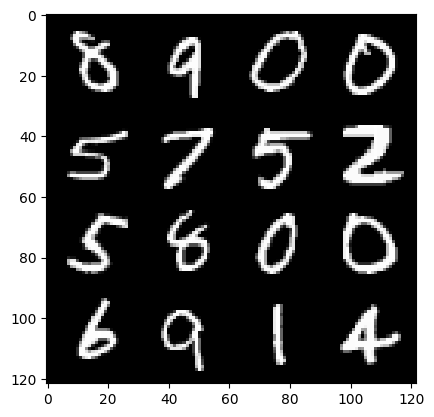

213:step 99900 / Gen loss: 1.518088116645813 / Disc loss: 0.40820717583099997


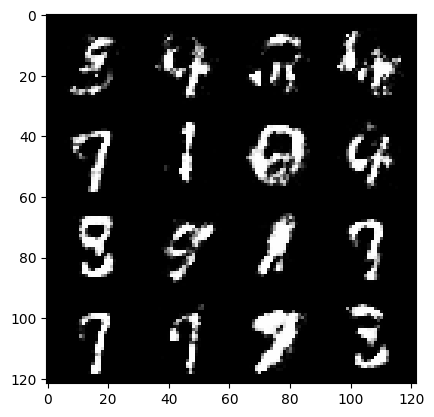

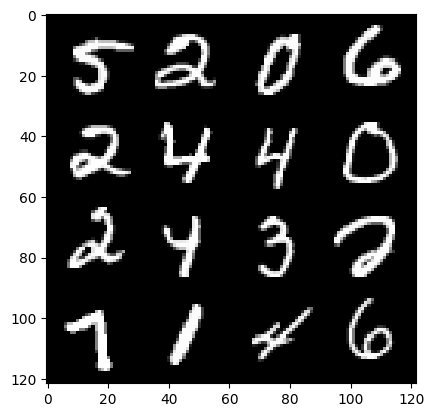

213:step 100200 / Gen loss: 1.4550933917363482 / Disc loss: 0.4201889493068062


  0%|          | 0/469 [00:00<?, ?it/s]

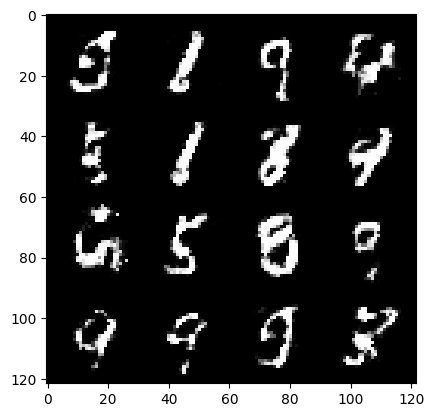

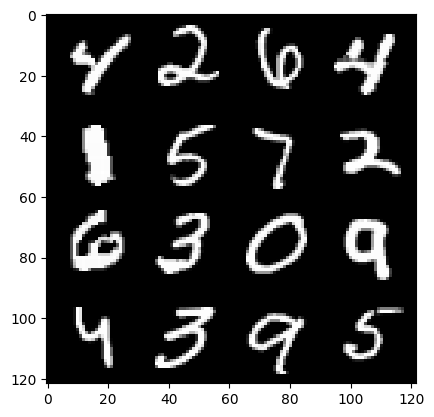

214:step 100500 / Gen loss: 1.4549874671300242 / Disc loss: 0.41126011629899323


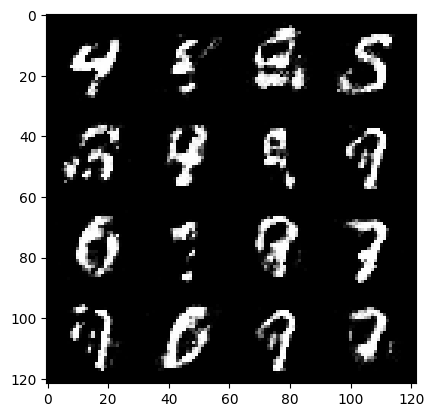

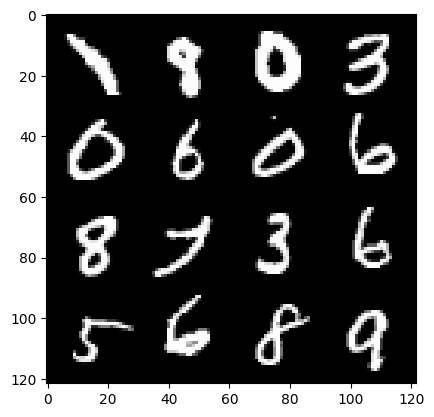

214:step 100800 / Gen loss: 1.4486756241321557 / Disc loss: 0.419160765906175


  0%|          | 0/469 [00:00<?, ?it/s]

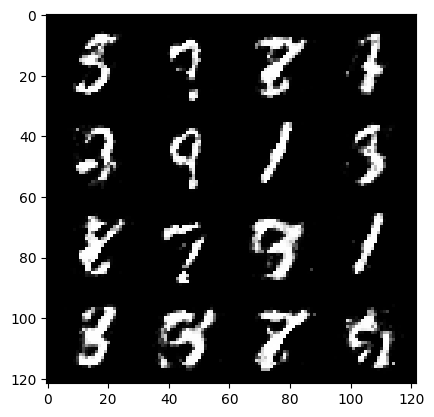

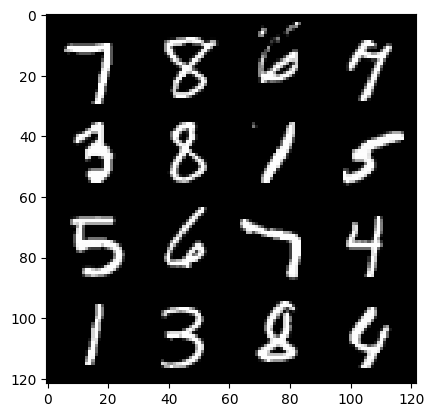

215:step 101100 / Gen loss: 1.366248253981272 / Disc loss: 0.4425483837723732


  0%|          | 0/469 [00:00<?, ?it/s]

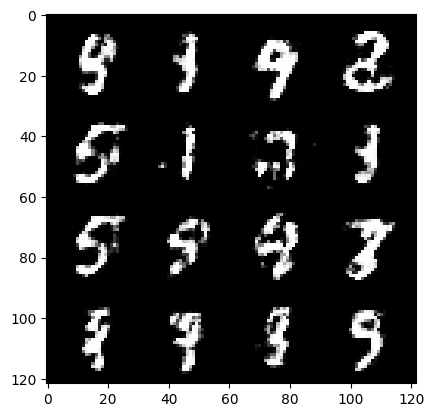

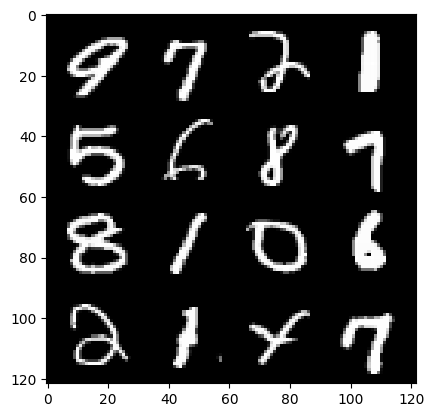

216:step 101400 / Gen loss: 1.4721427933375044 / Disc loss: 0.40804367860158297


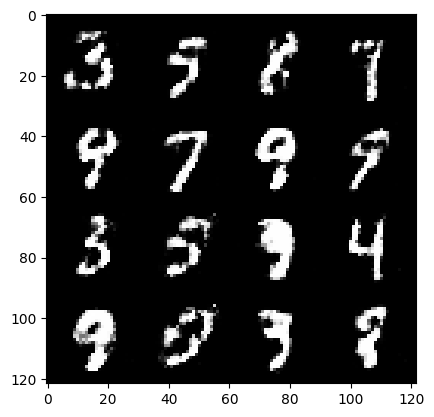

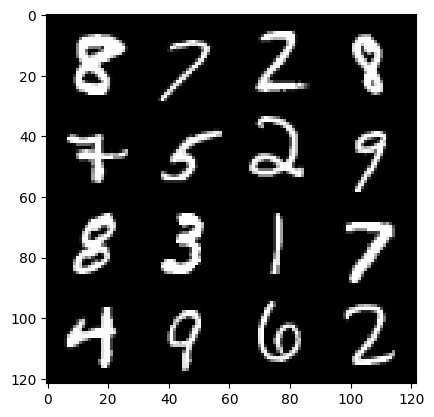

216:step 101700 / Gen loss: 1.4760722955067958 / Disc loss: 0.41856274555126816


  0%|          | 0/469 [00:00<?, ?it/s]

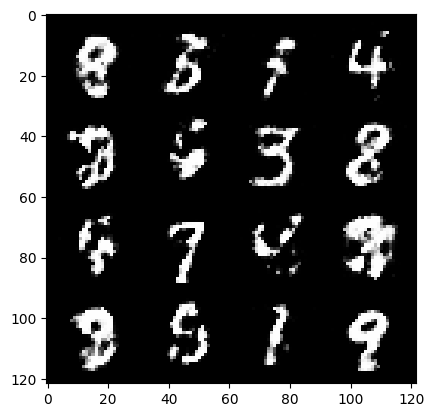

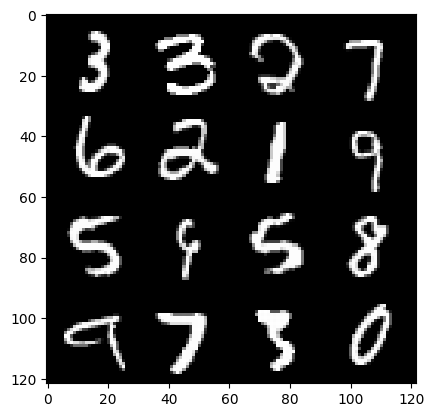

217:step 102000 / Gen loss: 1.3527870941162112 / Disc loss: 0.4517647940913835


  0%|          | 0/469 [00:00<?, ?it/s]

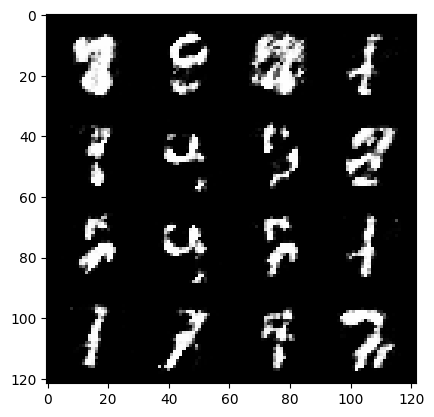

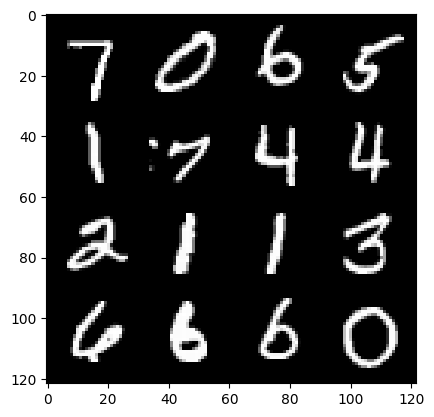

218:step 102300 / Gen loss: 1.3927288214365643 / Disc loss: 0.42591785659392695


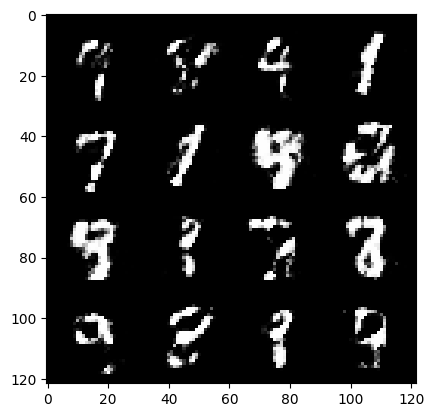

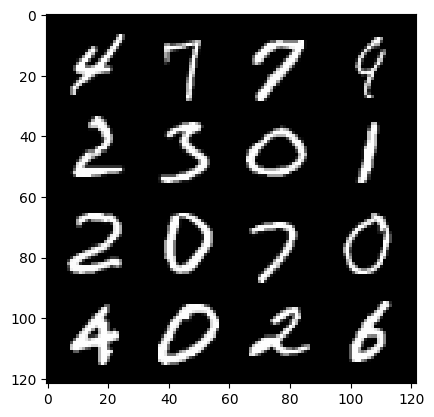

218:step 102600 / Gen loss: 1.4718348793188745 / Disc loss: 0.40775762846072483


  0%|          | 0/469 [00:00<?, ?it/s]

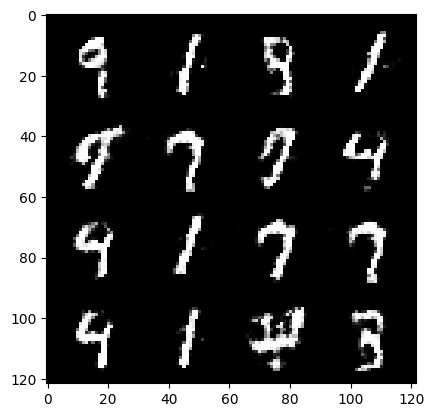

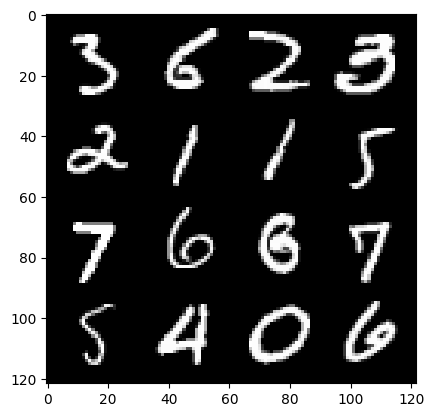

219:step 102900 / Gen loss: 1.3841463704903922 / Disc loss: 0.4383060825864474


  0%|          | 0/469 [00:00<?, ?it/s]

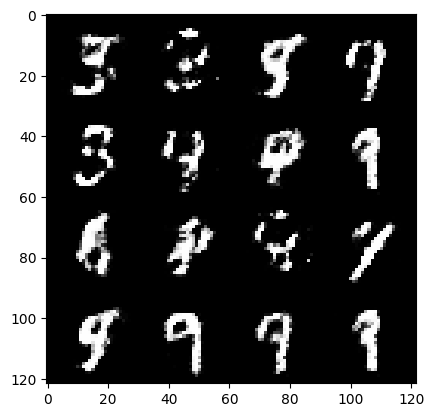

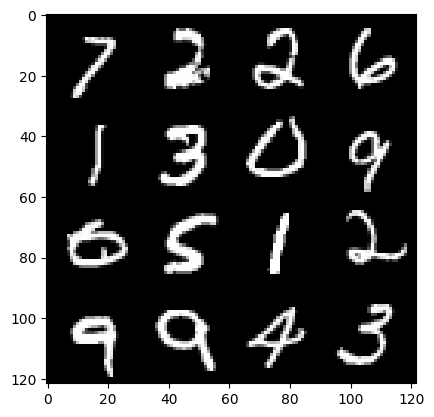

220:step 103200 / Gen loss: 1.4273752375443776 / Disc loss: 0.42586042255163203


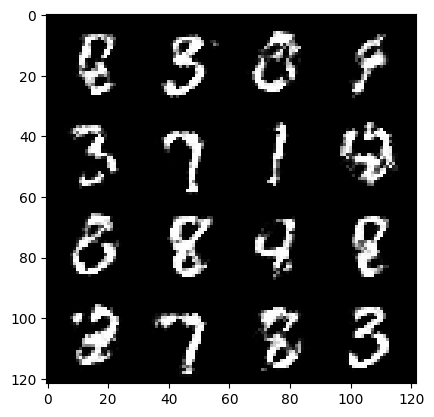

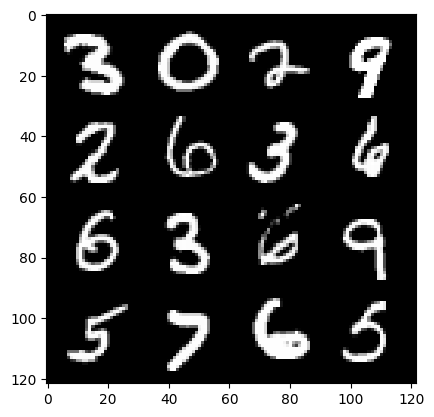

220:step 103500 / Gen loss: 1.4222303533554075 / Disc loss: 0.43708143760760615


  0%|          | 0/469 [00:00<?, ?it/s]

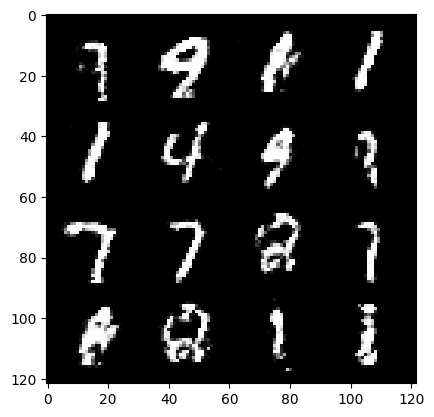

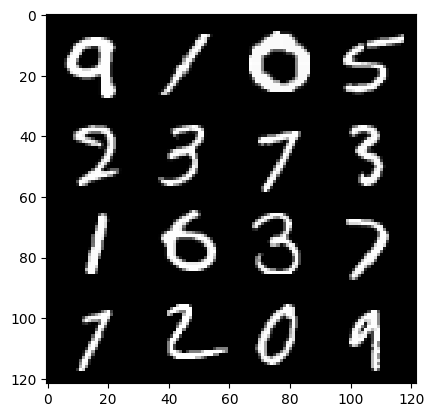

221:step 103800 / Gen loss: 1.3573871938387565 / Disc loss: 0.446905719935894


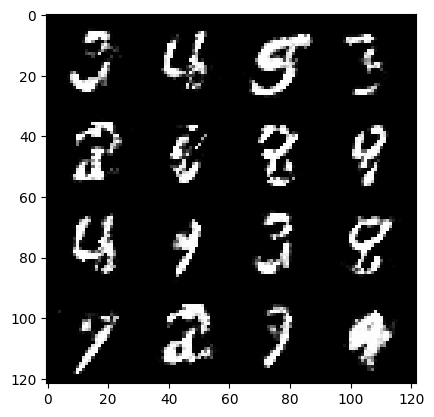

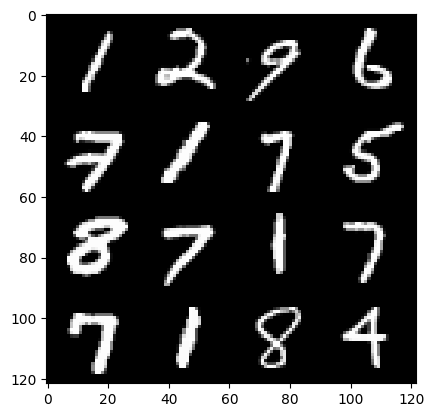

221:step 104100 / Gen loss: 1.3960441168149298 / Disc loss: 0.43597127517064427


  0%|          | 0/469 [00:00<?, ?it/s]

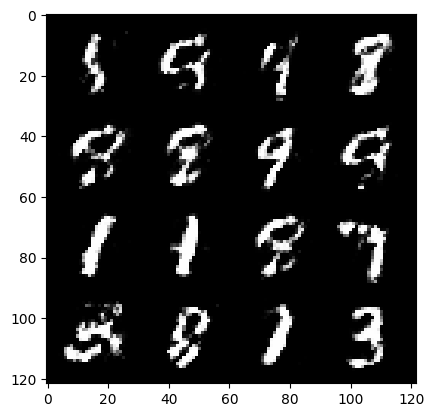

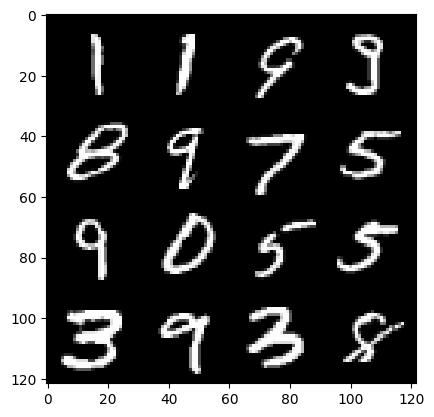

222:step 104400 / Gen loss: 1.421183502276739 / Disc loss: 0.42737345516681646


  0%|          | 0/469 [00:00<?, ?it/s]

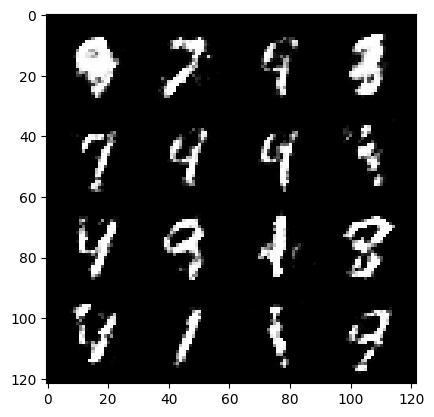

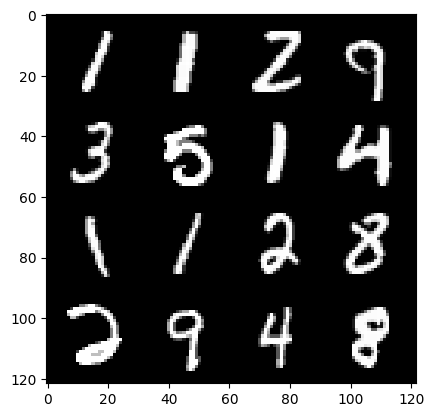

223:step 104700 / Gen loss: 1.447327311436335 / Disc loss: 0.4178028277556103


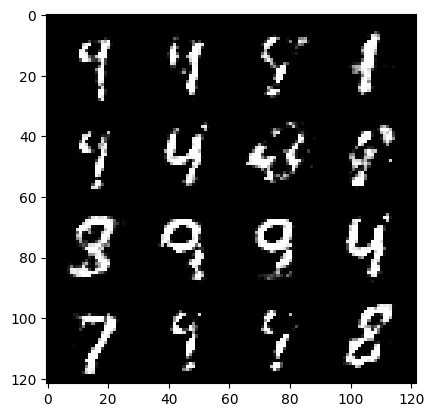

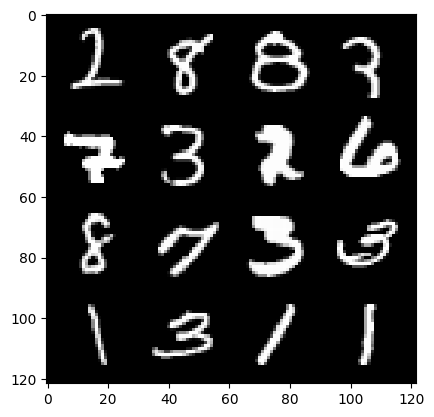

223:step 105000 / Gen loss: 1.3561732085545848 / Disc loss: 0.4380063740412394


  0%|          | 0/469 [00:00<?, ?it/s]

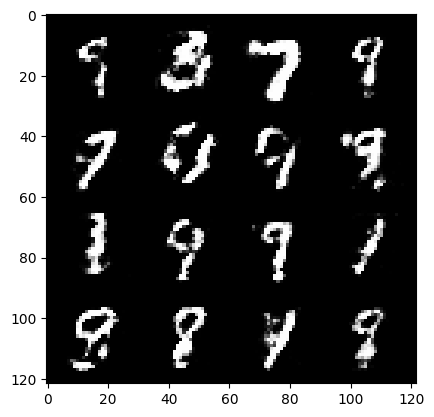

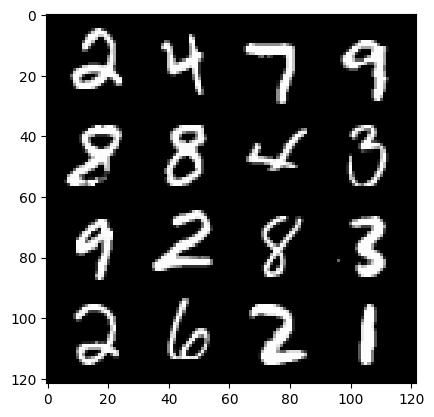

224:step 105300 / Gen loss: 1.4694924489657084 / Disc loss: 0.4029599368572235


  0%|          | 0/469 [00:00<?, ?it/s]

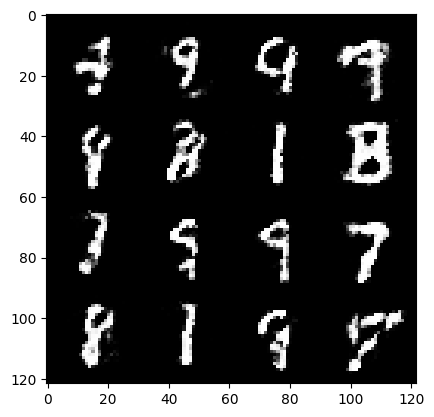

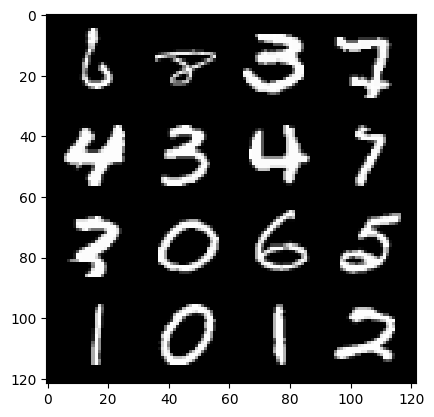

225:step 105600 / Gen loss: 1.482534692287446 / Disc loss: 0.4075938081741337


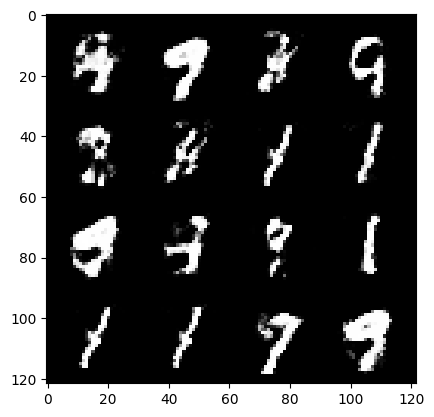

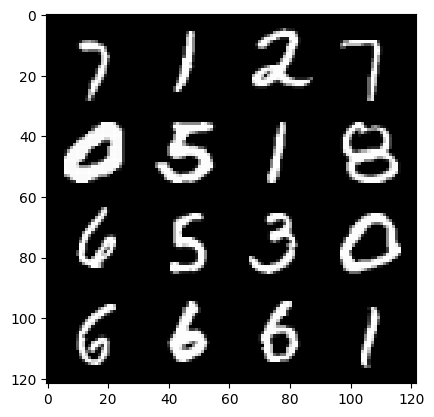

225:step 105900 / Gen loss: 1.44261342604955 / Disc loss: 0.42039845198392856


  0%|          | 0/469 [00:00<?, ?it/s]

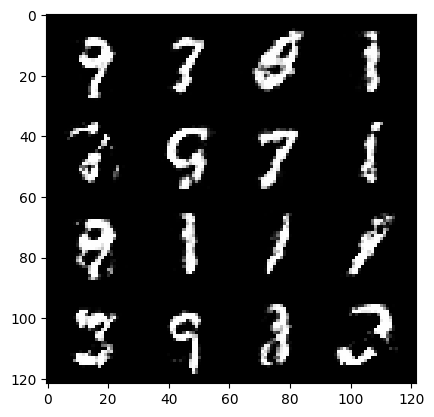

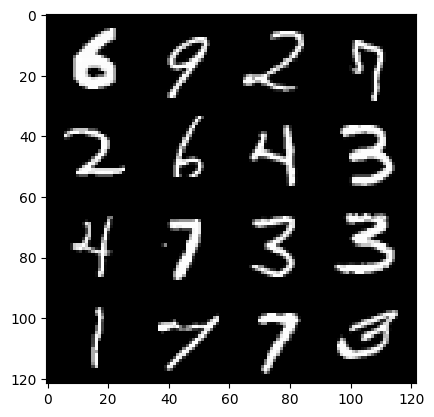

226:step 106200 / Gen loss: 1.3987641811370841 / Disc loss: 0.4309071218967439


  0%|          | 0/469 [00:00<?, ?it/s]

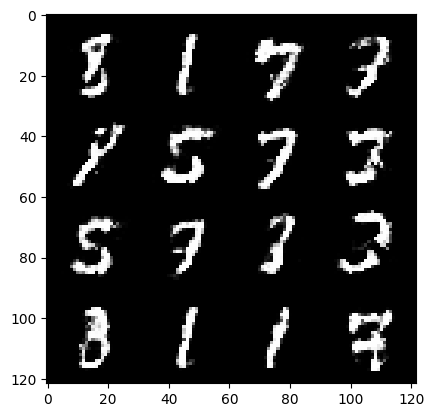

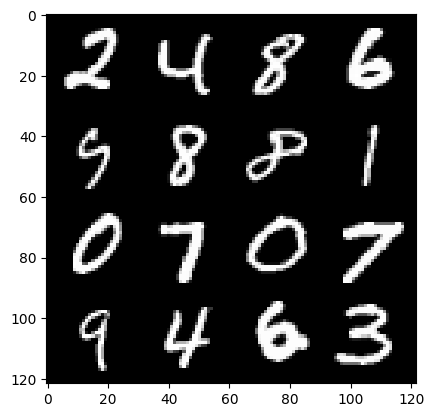

227:step 106500 / Gen loss: 1.4659098843733465 / Disc loss: 0.41262630999088284


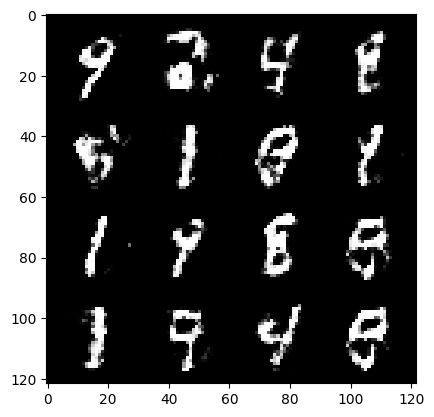

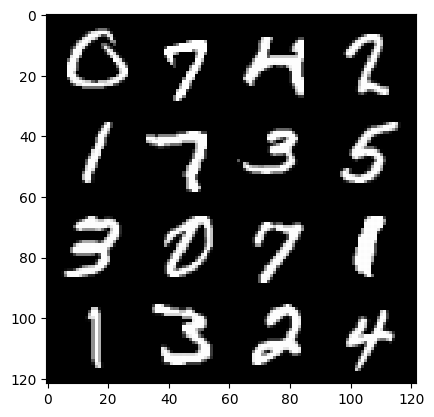

227:step 106800 / Gen loss: 1.4431725752353672 / Disc loss: 0.4218515471617381


  0%|          | 0/469 [00:00<?, ?it/s]

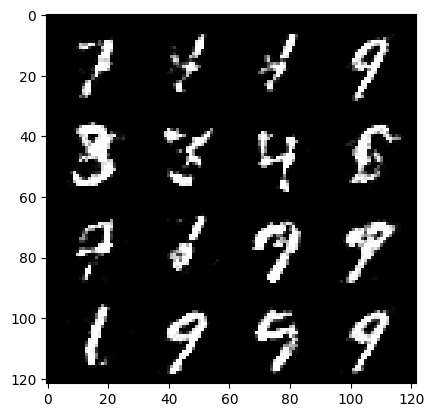

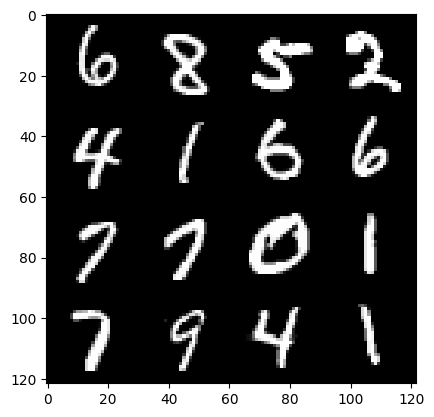

228:step 107100 / Gen loss: 1.466764427423477 / Disc loss: 0.41280057956775024


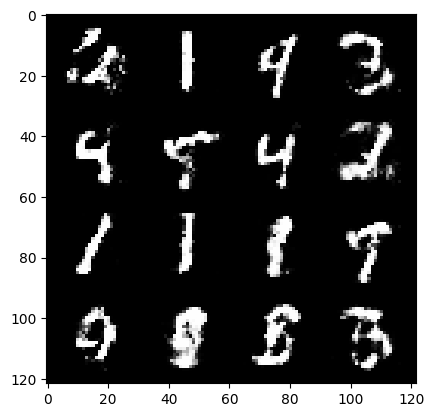

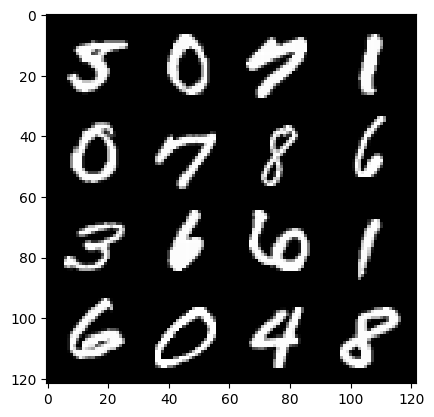

228:step 107400 / Gen loss: 1.3991908764839167 / Disc loss: 0.4362753840287529


  0%|          | 0/469 [00:00<?, ?it/s]

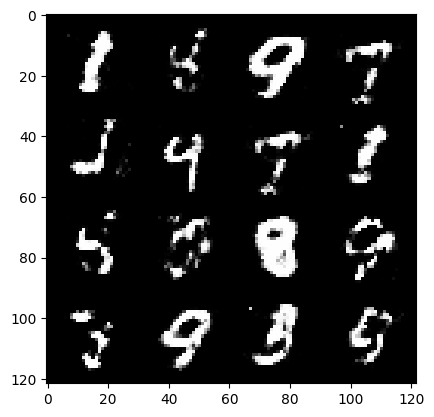

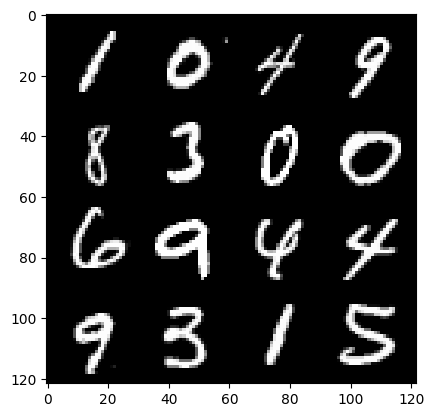

229:step 107700 / Gen loss: 1.3636653792858127 / Disc loss: 0.43949337909619


  0%|          | 0/469 [00:00<?, ?it/s]

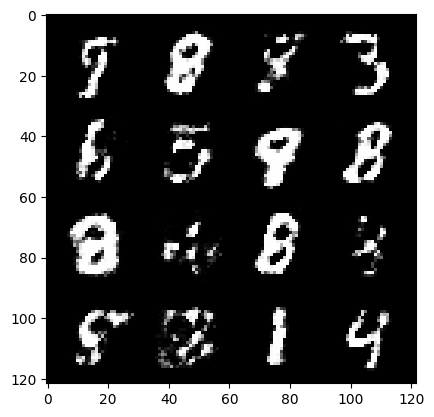

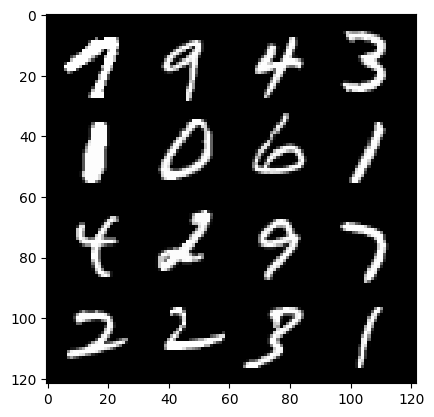

230:step 108000 / Gen loss: 1.4148738046487175 / Disc loss: 0.4243424764275554


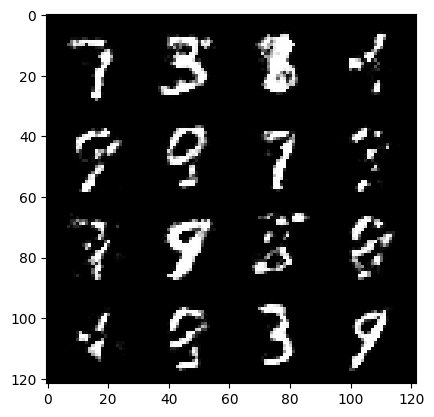

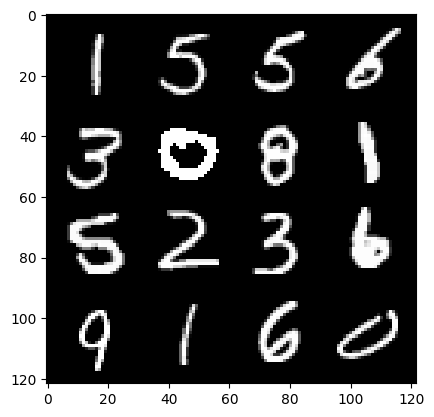

230:step 108300 / Gen loss: 1.3363613156477612 / Disc loss: 0.44100845237572983


  0%|          | 0/469 [00:00<?, ?it/s]

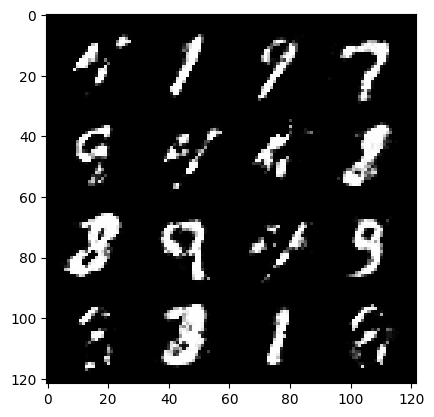

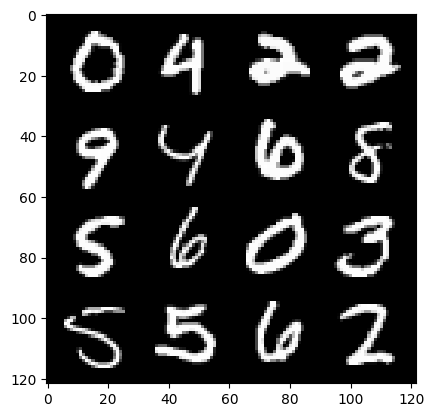

231:step 108600 / Gen loss: 1.3704319536685932 / Disc loss: 0.44232140262921654


  0%|          | 0/469 [00:00<?, ?it/s]

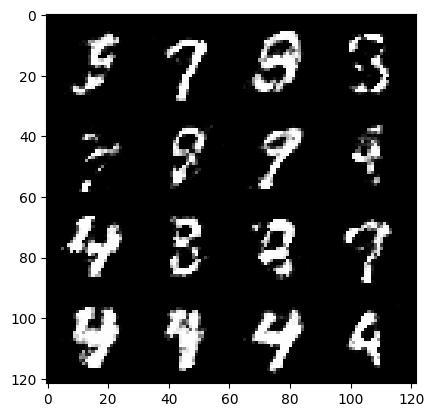

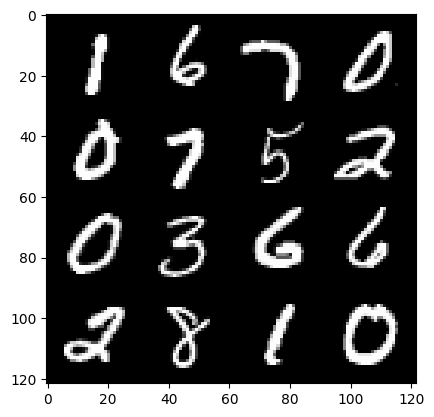

232:step 108900 / Gen loss: 1.35919943412145 / Disc loss: 0.4426383354266484


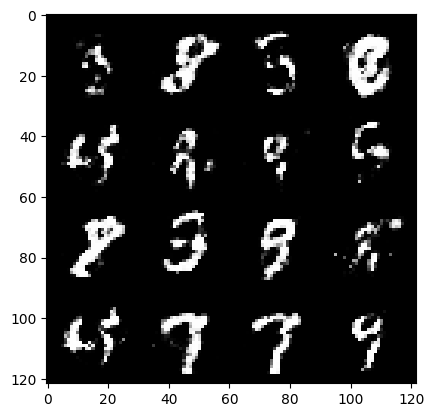

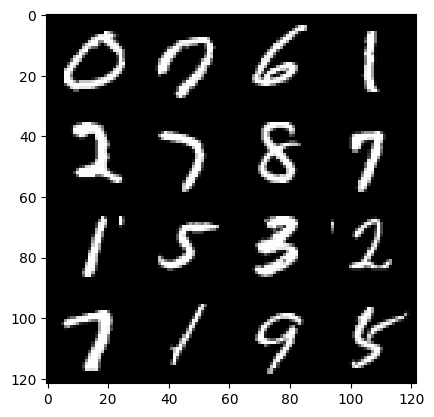

232:step 109200 / Gen loss: 1.3644135530789698 / Disc loss: 0.4293492766221362


  0%|          | 0/469 [00:00<?, ?it/s]

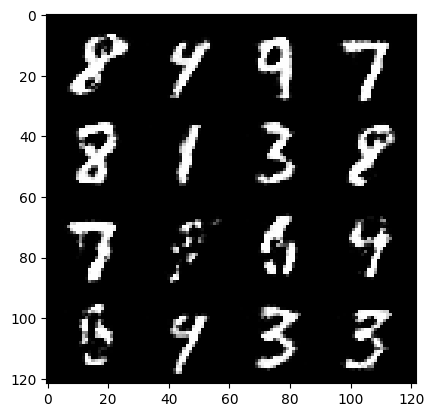

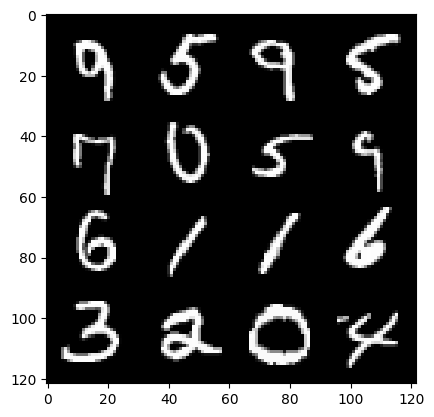

233:step 109500 / Gen loss: 1.3785270289580014 / Disc loss: 0.42548604547977453


  0%|          | 0/469 [00:00<?, ?it/s]

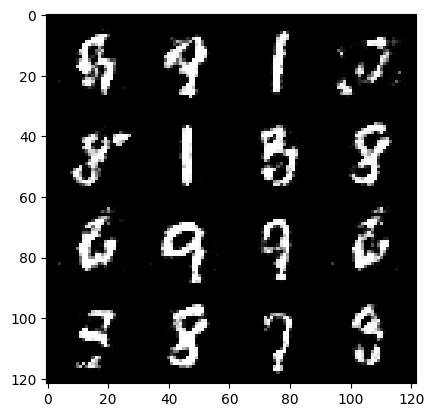

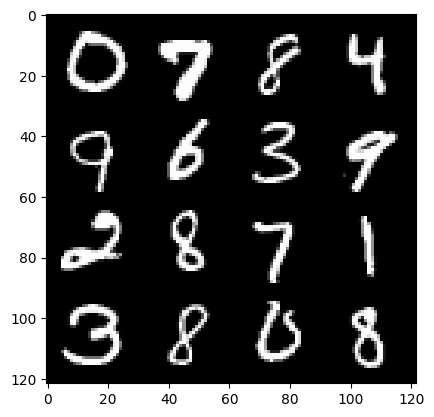

234:step 109800 / Gen loss: 1.3245354676246637 / Disc loss: 0.4487012459834412


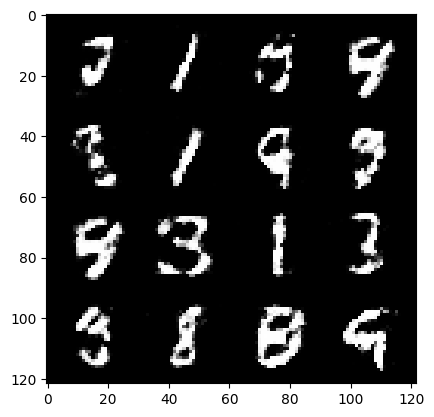

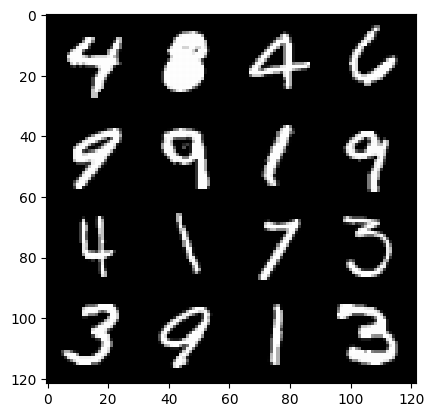

234:step 110100 / Gen loss: 1.3668385660648357 / Disc loss: 0.4353978139162063


  0%|          | 0/469 [00:00<?, ?it/s]

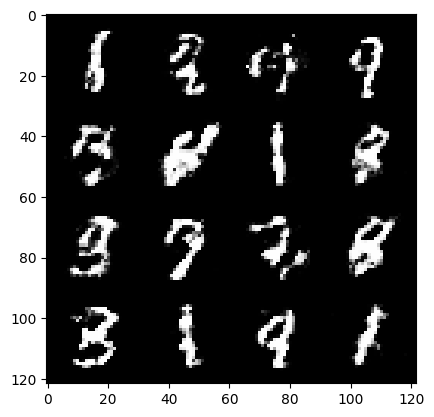

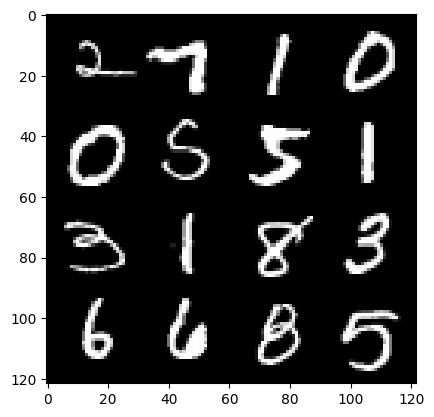

235:step 110400 / Gen loss: 1.4139955826600388 / Disc loss: 0.42442271381616614


  0%|          | 0/469 [00:00<?, ?it/s]

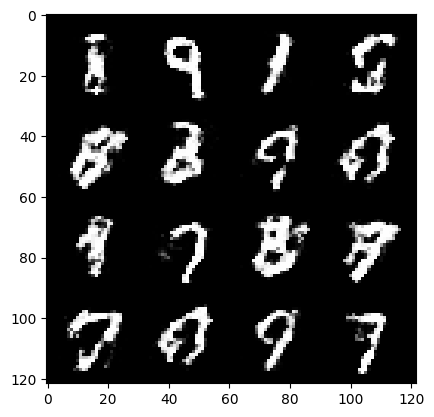

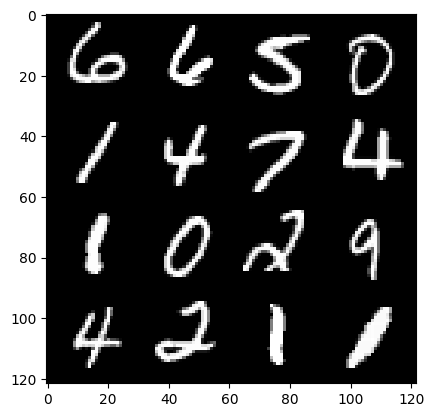

236:step 110700 / Gen loss: 1.3776193106174464 / Disc loss: 0.43907077242930737


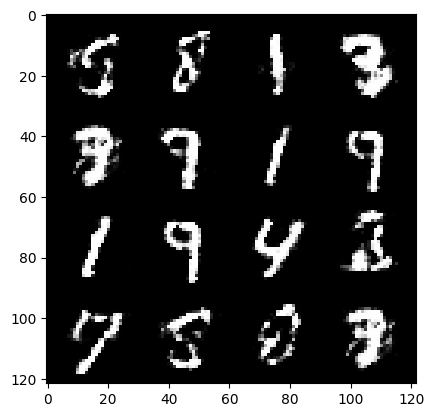

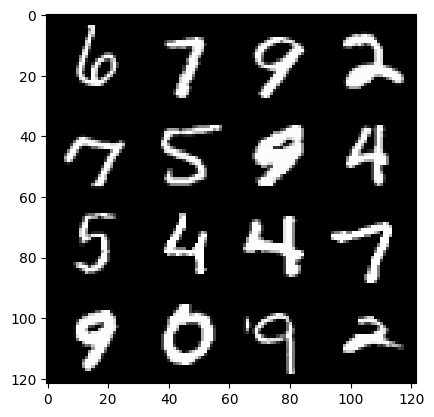

236:step 111000 / Gen loss: 1.3694648456573486 / Disc loss: 0.44651935935020454


  0%|          | 0/469 [00:00<?, ?it/s]

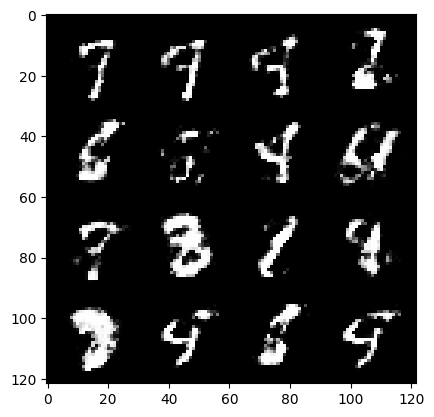

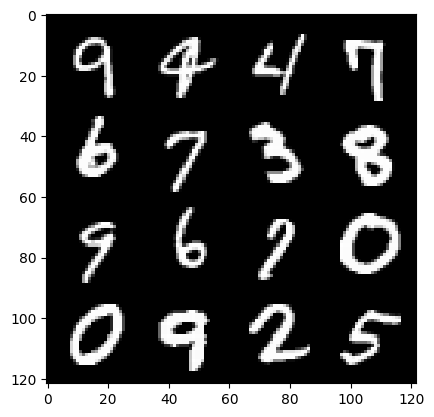

237:step 111300 / Gen loss: 1.2876791830857603 / Disc loss: 0.46584265609582237


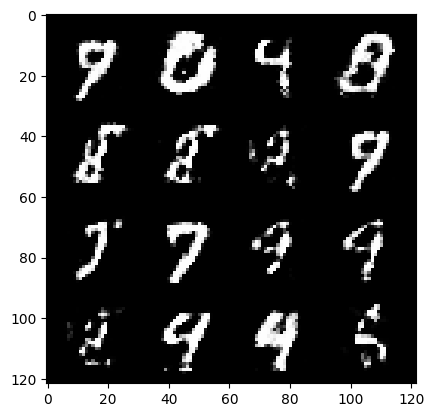

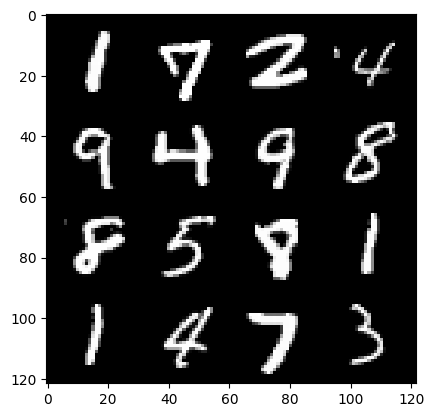

237:step 111600 / Gen loss: 1.2737451485792795 / Disc loss: 0.45990258187055616


  0%|          | 0/469 [00:00<?, ?it/s]

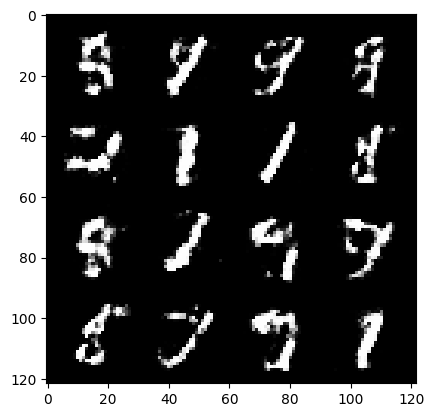

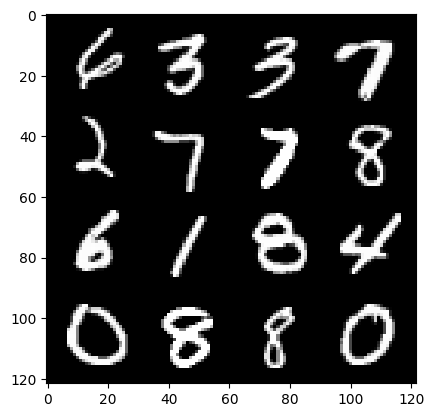

238:step 111900 / Gen loss: 1.3195849800109865 / Disc loss: 0.44684526652097684


  0%|          | 0/469 [00:00<?, ?it/s]

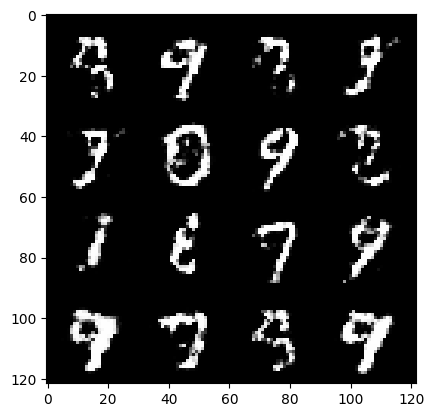

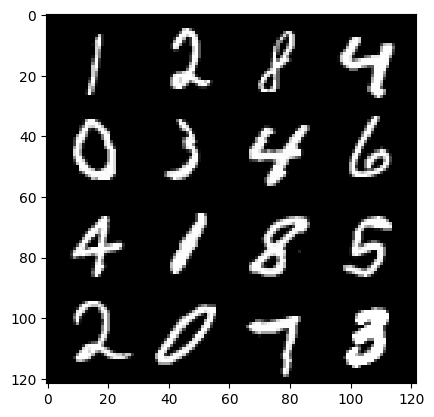

239:step 112200 / Gen loss: 1.3413520618279773 / Disc loss: 0.45813383062680574


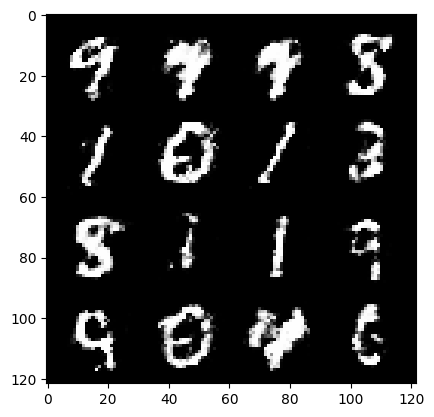

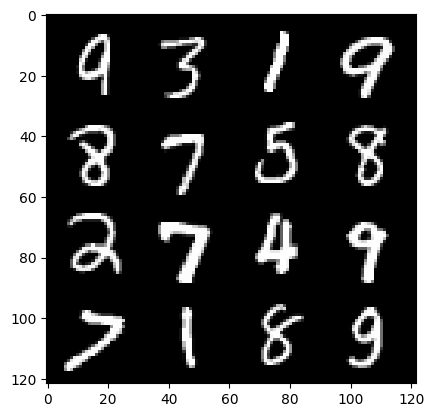

239:step 112500 / Gen loss: 1.3183880170186357 / Disc loss: 0.4656461474299431


  0%|          | 0/469 [00:00<?, ?it/s]

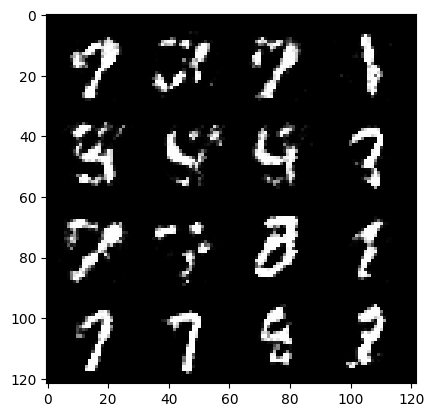

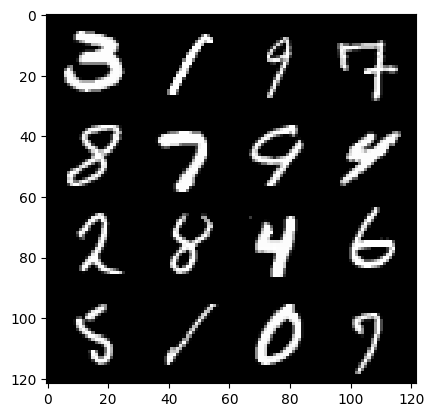

240:step 112800 / Gen loss: 1.3336370575428014 / Disc loss: 0.4531367097298309


  0%|          | 0/469 [00:00<?, ?it/s]

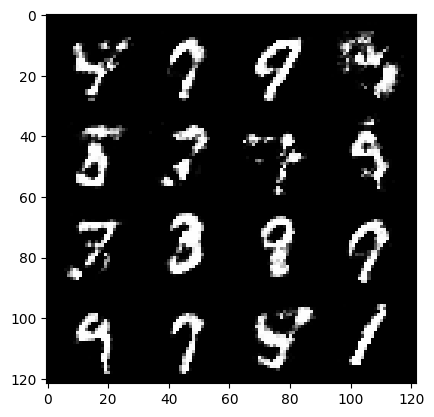

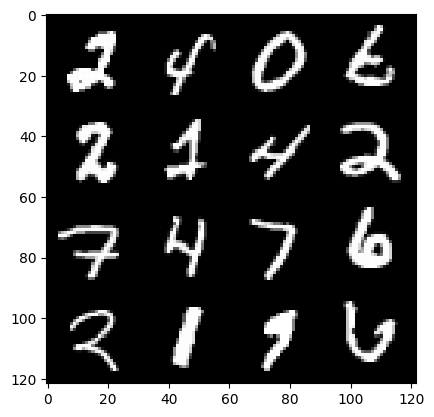

241:step 113100 / Gen loss: 1.305762577056884 / Disc loss: 0.4669913347562158


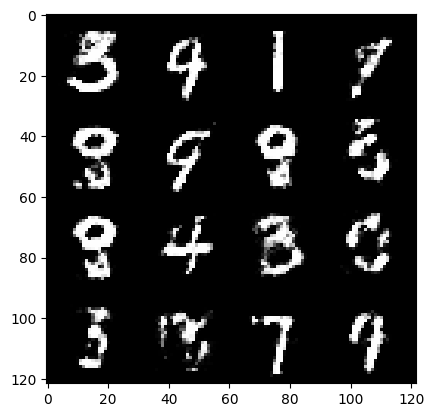

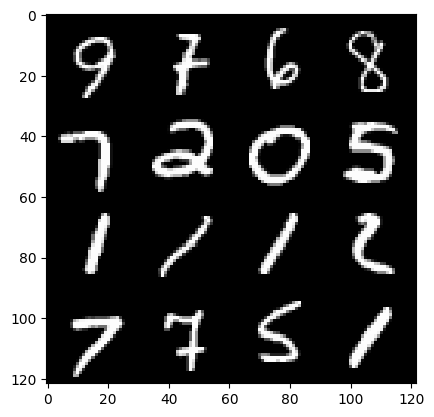

241:step 113400 / Gen loss: 1.2936613035202023 / Disc loss: 0.4721027158697442


  0%|          | 0/469 [00:00<?, ?it/s]

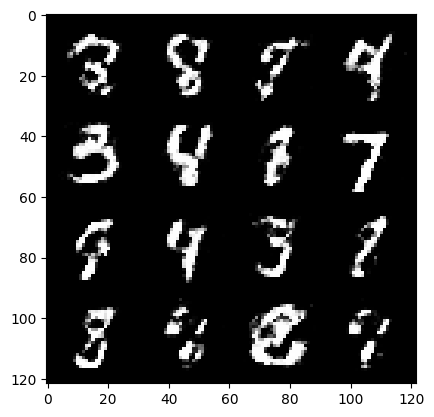

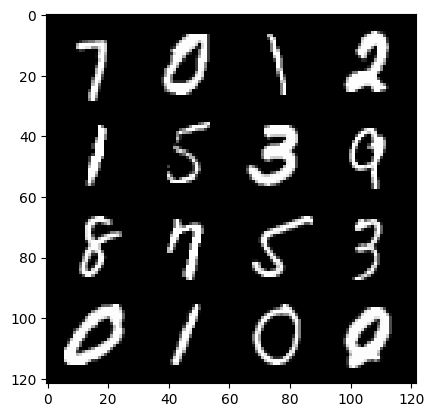

242:step 113700 / Gen loss: 1.328886287609736 / Disc loss: 0.4577559234698612


  0%|          | 0/469 [00:00<?, ?it/s]

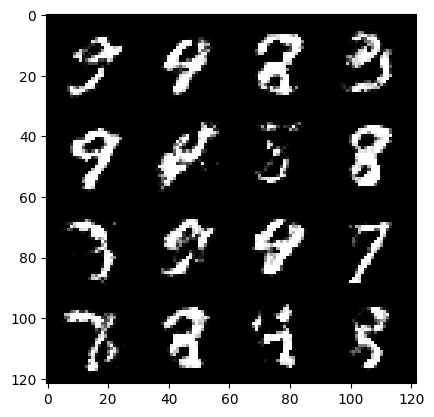

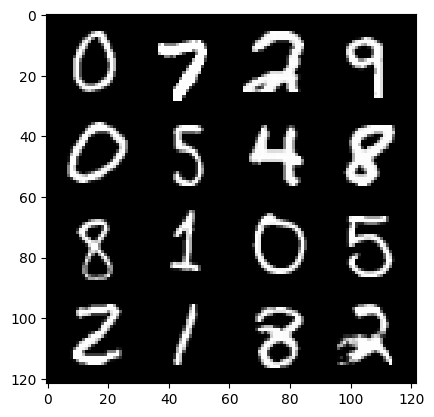

243:step 114000 / Gen loss: 1.2906635884443904 / Disc loss: 0.4657767843206721


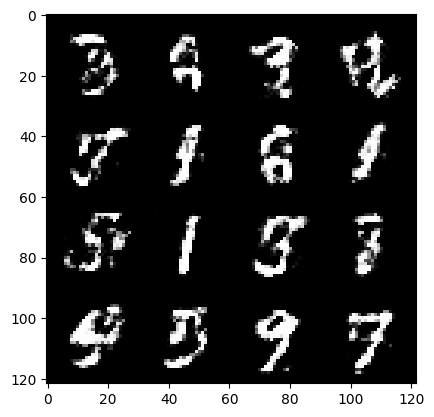

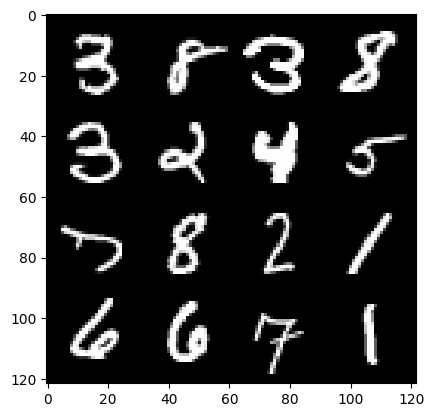

243:step 114300 / Gen loss: 1.1933974611759186 / Disc loss: 0.5014433561762172


  0%|          | 0/469 [00:00<?, ?it/s]

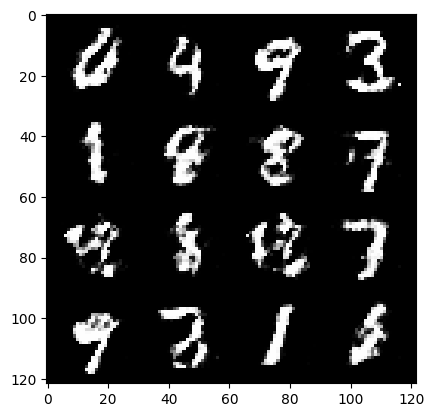

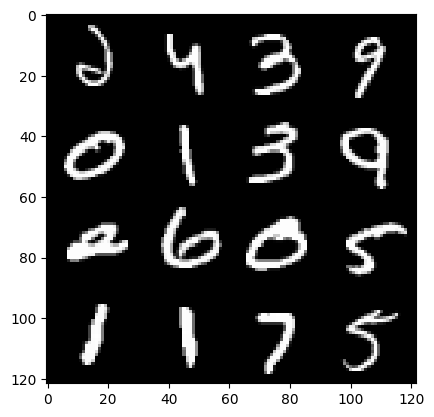

244:step 114600 / Gen loss: 1.1541024740537016 / Disc loss: 0.5124141886830329


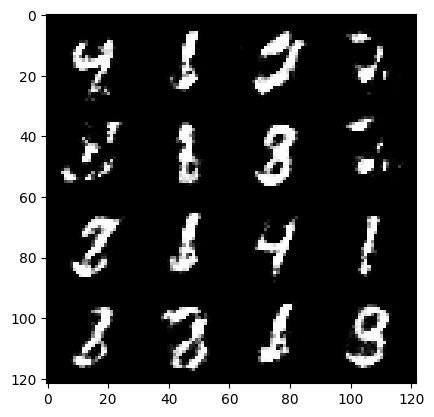

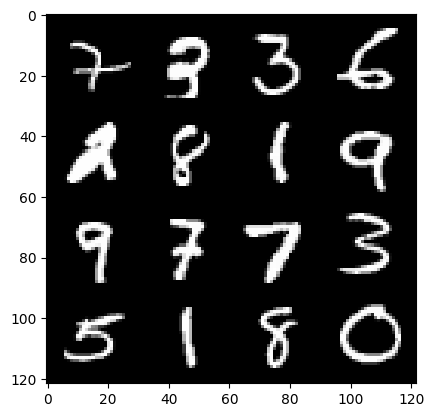

244:step 114900 / Gen loss: 1.2906040950616195 / Disc loss: 0.46167775342861817


  0%|          | 0/469 [00:00<?, ?it/s]

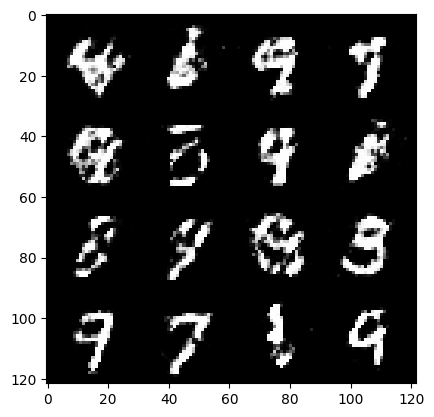

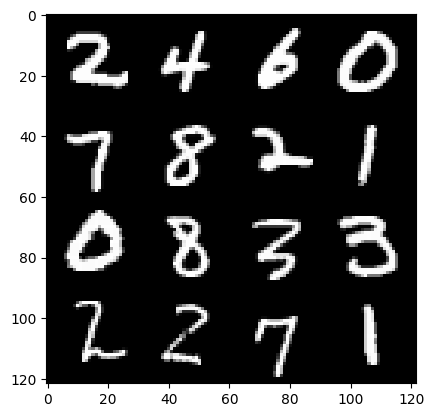

245:step 115200 / Gen loss: 1.2931922058264418 / Disc loss: 0.4534333842992781


  0%|          | 0/469 [00:00<?, ?it/s]

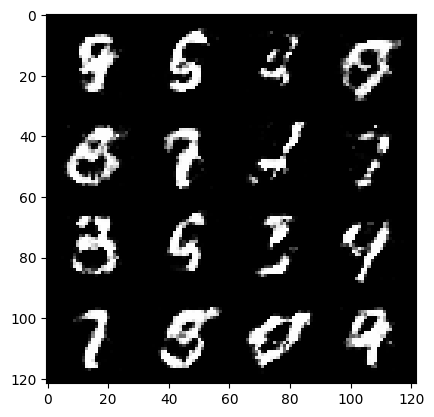

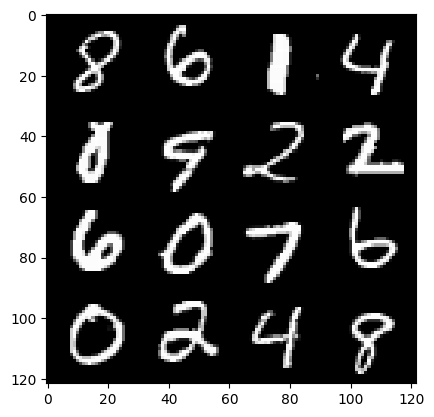

246:step 115500 / Gen loss: 1.335942858457565 / Disc loss: 0.44769004503885945


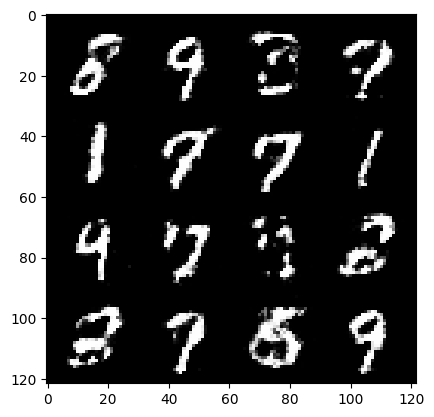

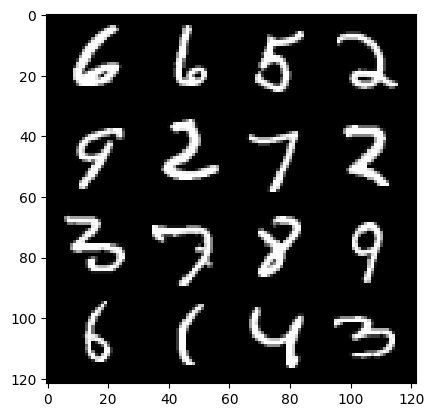

246:step 115800 / Gen loss: 1.2363161166508996 / Disc loss: 0.4681749440232913


  0%|          | 0/469 [00:00<?, ?it/s]

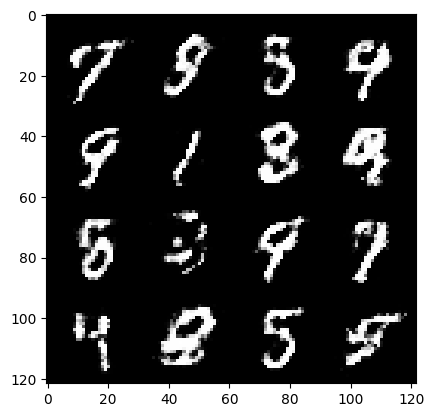

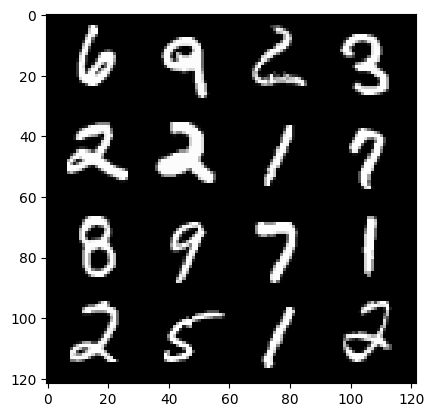

247:step 116100 / Gen loss: 1.2399925283590956 / Disc loss: 0.47380444407463074


  0%|          | 0/469 [00:00<?, ?it/s]

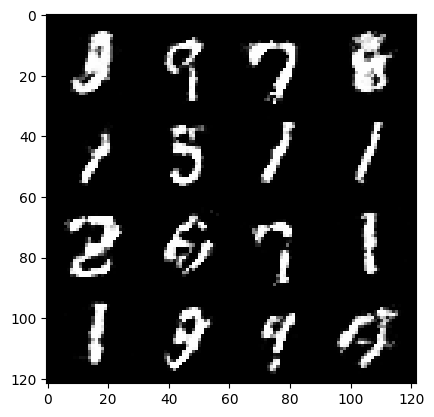

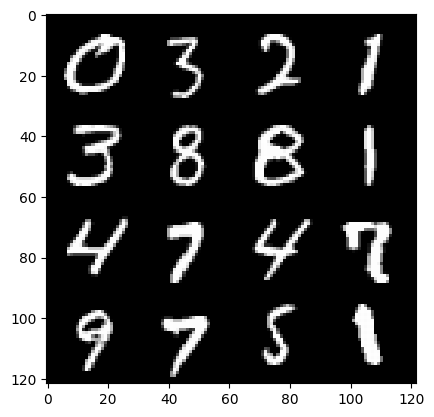

248:step 116400 / Gen loss: 1.2185917266209918 / Disc loss: 0.4844323806961377


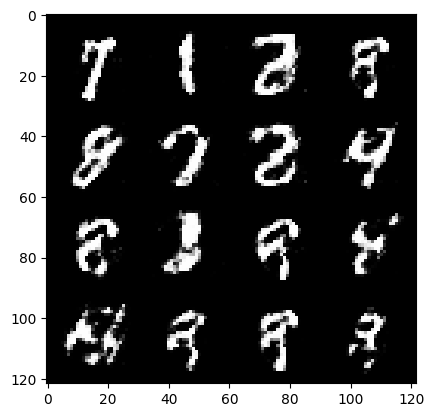

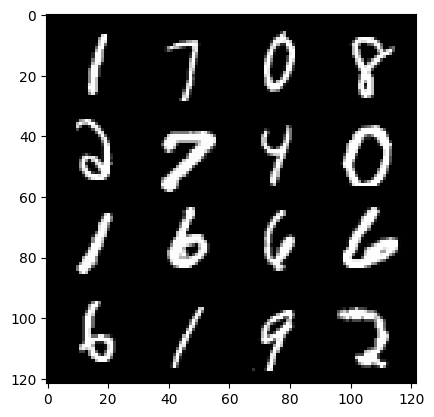

248:step 116700 / Gen loss: 1.2442675987879428 / Disc loss: 0.4775811529159544


  0%|          | 0/469 [00:00<?, ?it/s]

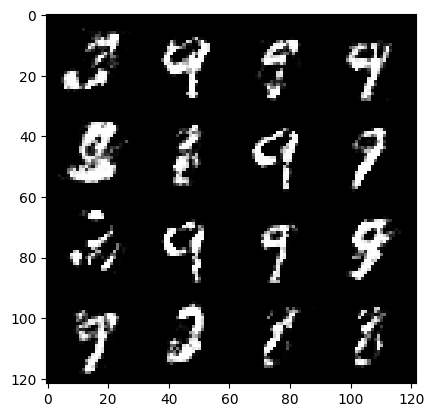

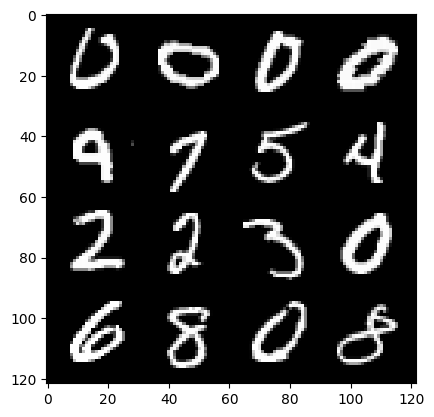

249:step 117000 / Gen loss: 1.3886719596385952 / Disc loss: 0.42997544527053866


  0%|          | 0/469 [00:00<?, ?it/s]

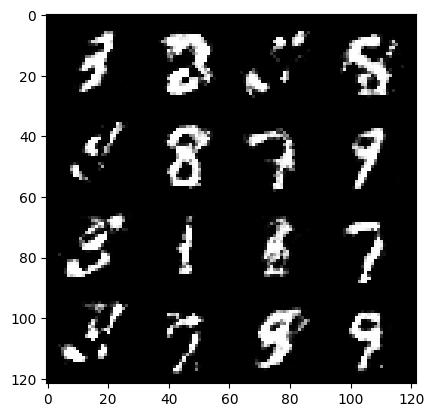

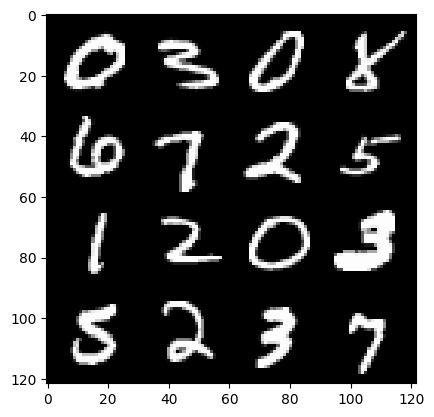

250:step 117300 / Gen loss: 1.3665119910240173 / Disc loss: 0.4381583584348362


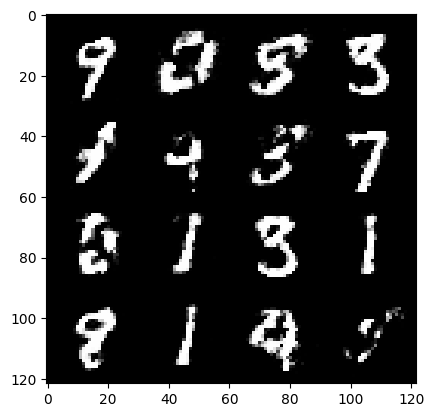

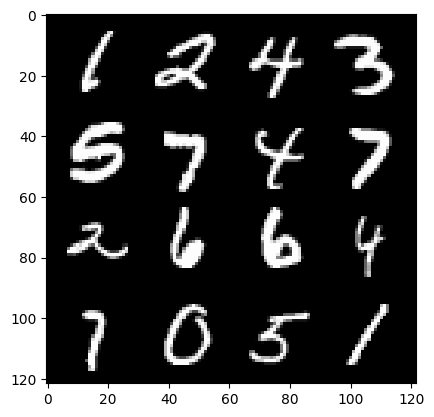

250:step 117600 / Gen loss: 1.2813185977935788 / Disc loss: 0.4675218331813812


  0%|          | 0/469 [00:00<?, ?it/s]

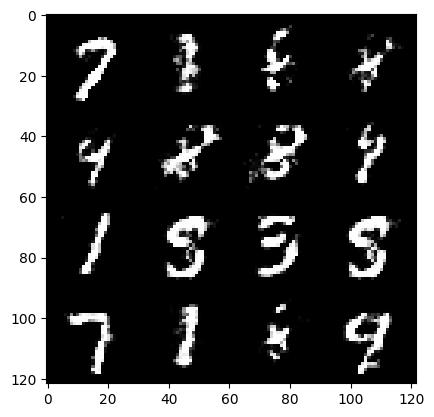

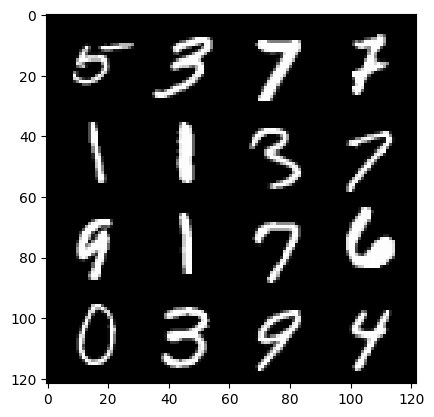

251:step 117900 / Gen loss: 1.305697567065557 / Disc loss: 0.4536236615975698


  0%|          | 0/469 [00:00<?, ?it/s]

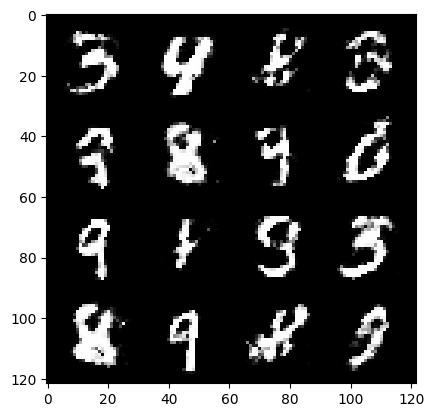

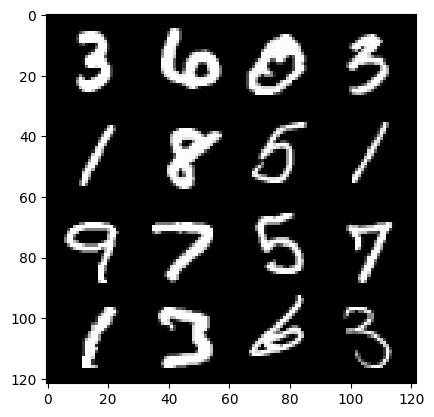

252:step 118200 / Gen loss: 1.2130843152602504 / Disc loss: 0.4834471680720646


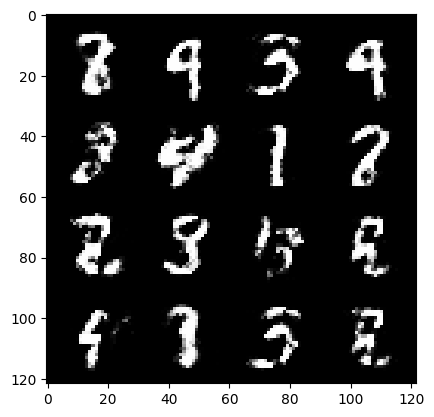

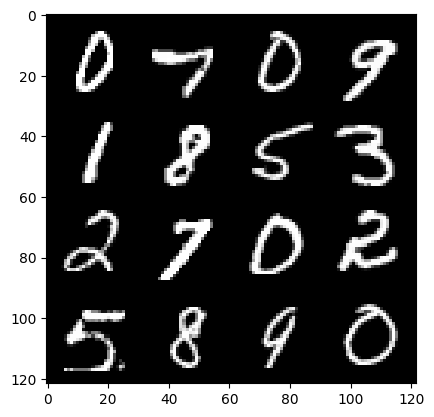

252:step 118500 / Gen loss: 1.2485475711027785 / Disc loss: 0.46116703132788345


  0%|          | 0/469 [00:00<?, ?it/s]

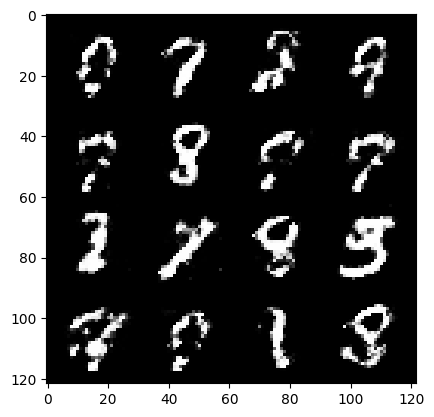

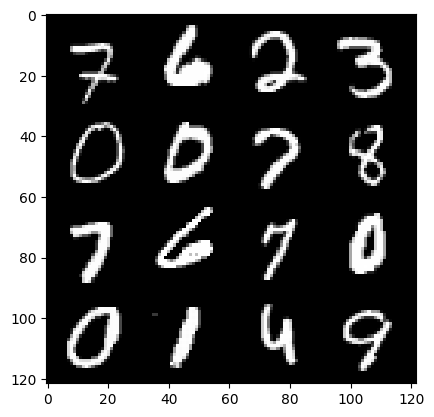

253:step 118800 / Gen loss: 1.299106374581654 / Disc loss: 0.44682865073283523


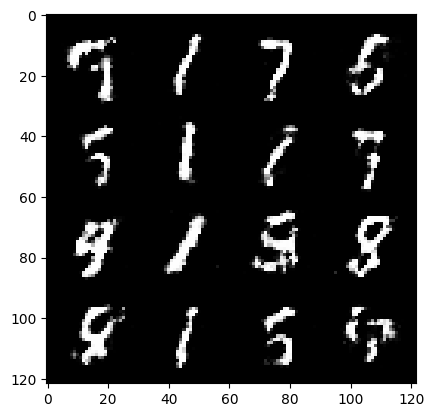

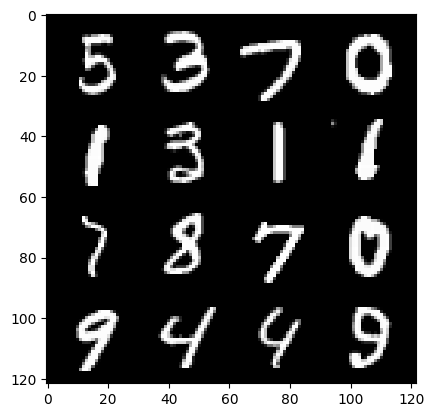

253:step 119100 / Gen loss: 1.2944878482818614 / Disc loss: 0.44555050522089


  0%|          | 0/469 [00:00<?, ?it/s]

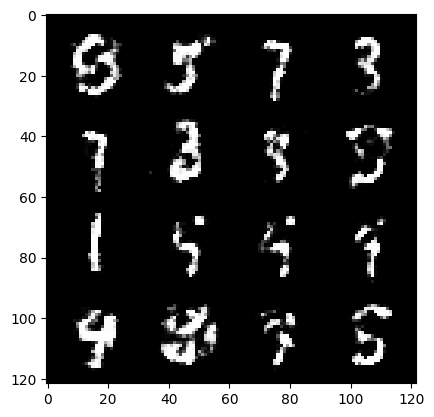

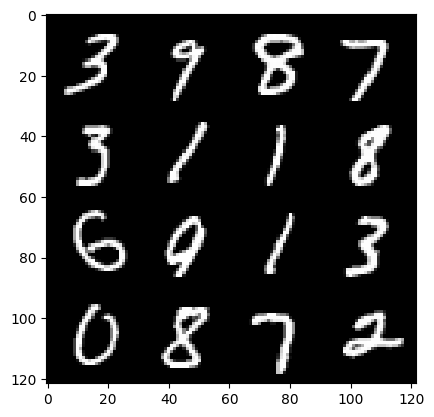

254:step 119400 / Gen loss: 1.2699789373079937 / Disc loss: 0.462488780617714


  0%|          | 0/469 [00:00<?, ?it/s]

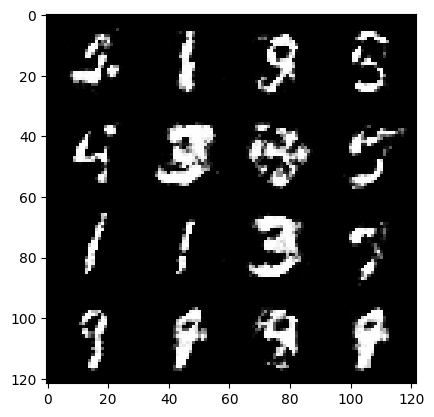

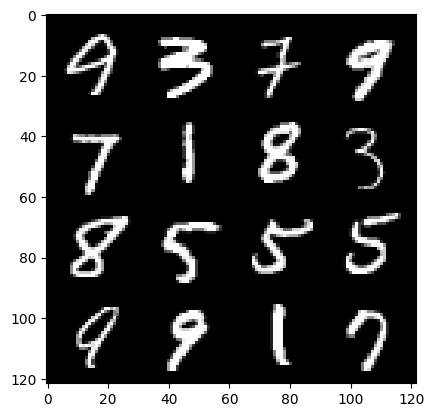

255:step 119700 / Gen loss: 1.2428874460856116 / Disc loss: 0.46645155896743196


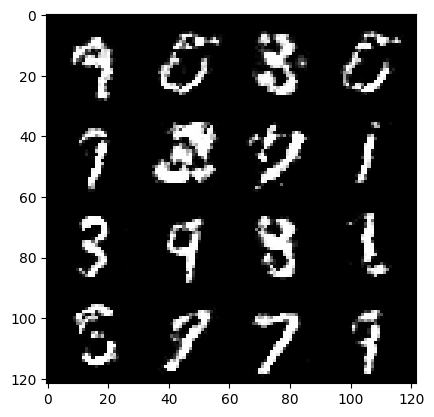

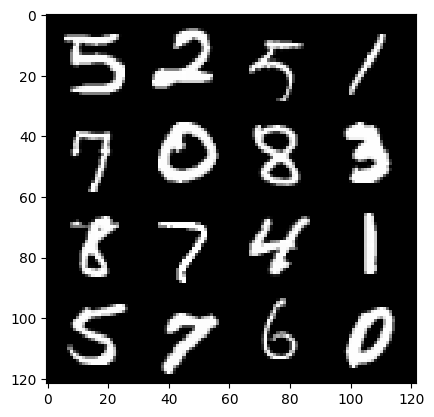

255:step 120000 / Gen loss: 1.2532314558823916 / Disc loss: 0.46850198050340053


  0%|          | 0/469 [00:00<?, ?it/s]

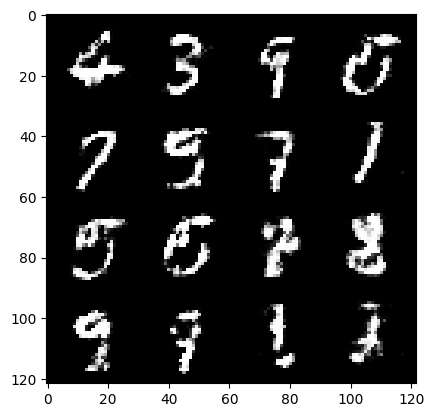

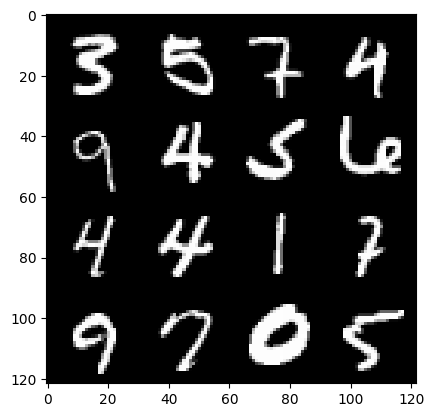

256:step 120300 / Gen loss: 1.2447070070107786 / Disc loss: 0.4765158440669376


  0%|          | 0/469 [00:00<?, ?it/s]

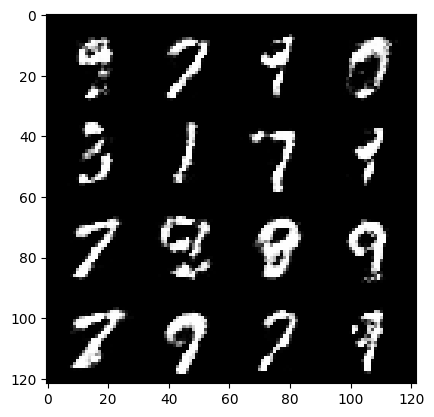

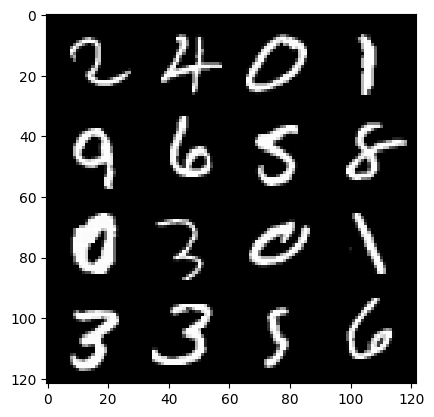

257:step 120600 / Gen loss: 1.3039791754881536 / Disc loss: 0.4509131300449371


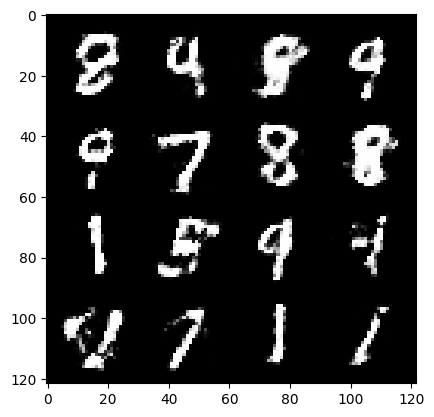

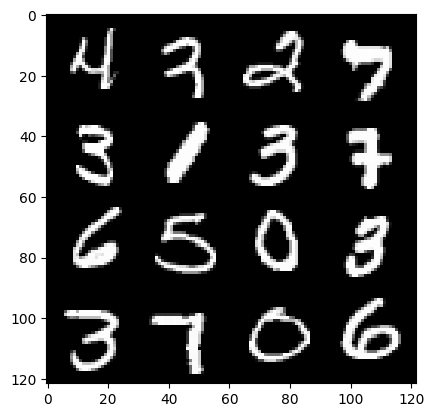

257:step 120900 / Gen loss: 1.29405793627103 / Disc loss: 0.45310152560472483


  0%|          | 0/469 [00:00<?, ?it/s]

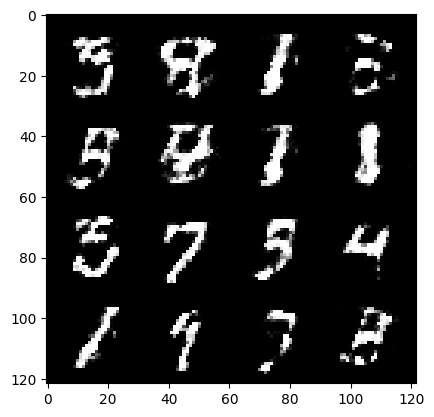

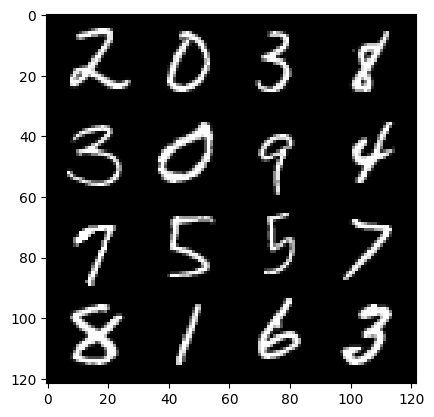

258:step 121200 / Gen loss: 1.3215626692771916 / Disc loss: 0.4526295638084411


  0%|          | 0/469 [00:00<?, ?it/s]

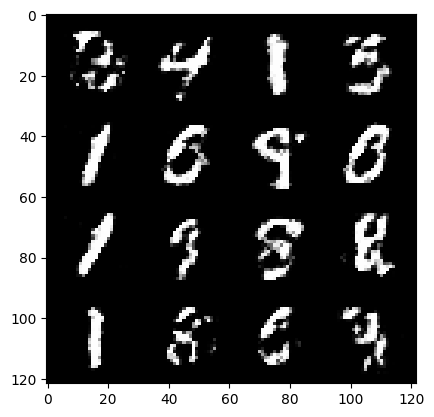

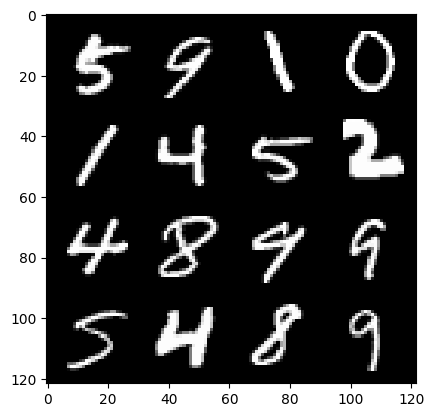

259:step 121500 / Gen loss: 1.1778442672888447 / Disc loss: 0.4965664833784103


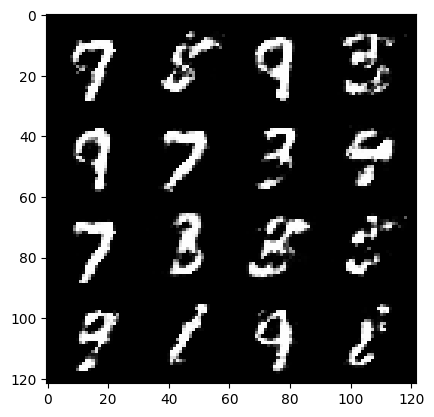

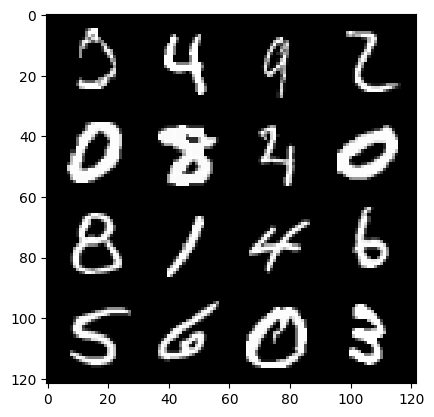

259:step 121800 / Gen loss: 1.2072962892055508 / Disc loss: 0.4883577843507136


  0%|          | 0/469 [00:00<?, ?it/s]

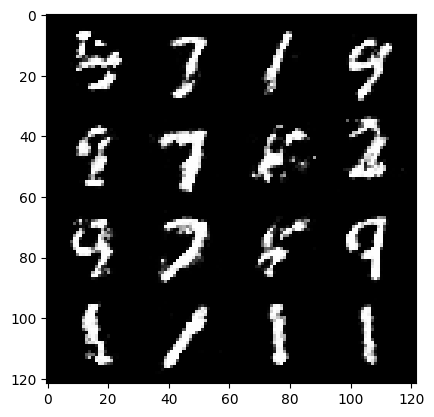

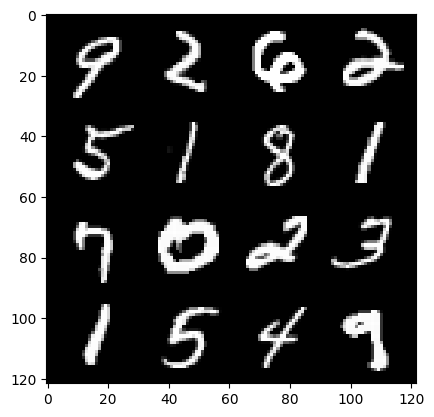

260:step 122100 / Gen loss: 1.1961386535565057 / Disc loss: 0.4871686300635338


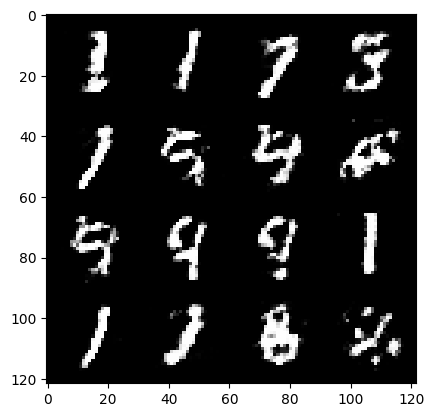

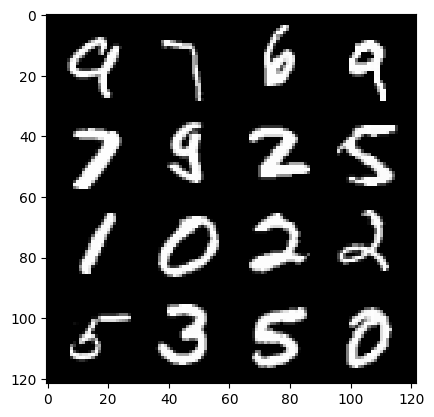

260:step 122400 / Gen loss: 1.1838652455806737 / Disc loss: 0.4930763066808384


  0%|          | 0/469 [00:00<?, ?it/s]

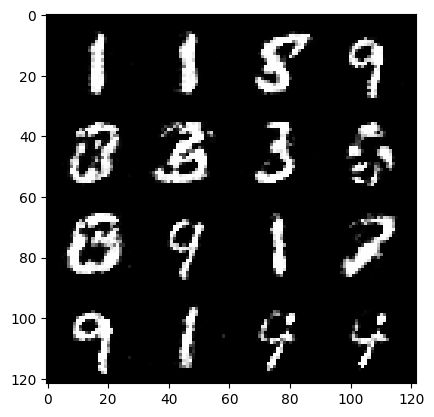

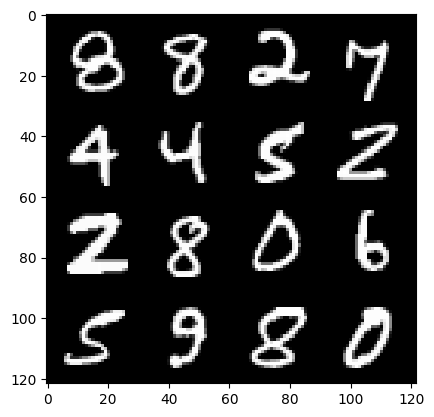

261:step 122700 / Gen loss: 1.2693749856948857 / Disc loss: 0.46335176954666807


  0%|          | 0/469 [00:00<?, ?it/s]

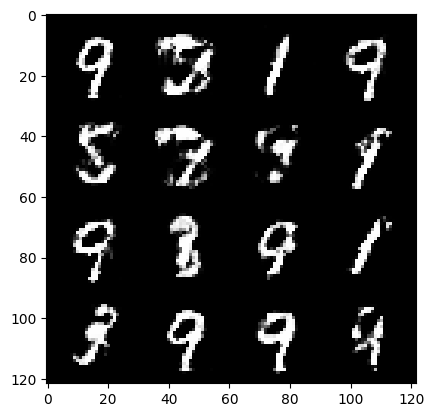

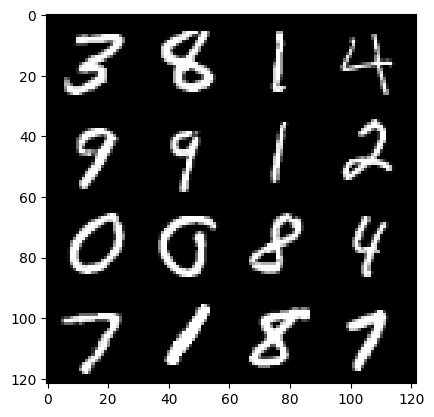

262:step 123000 / Gen loss: 1.1873885464668268 / Disc loss: 0.4796269006530443


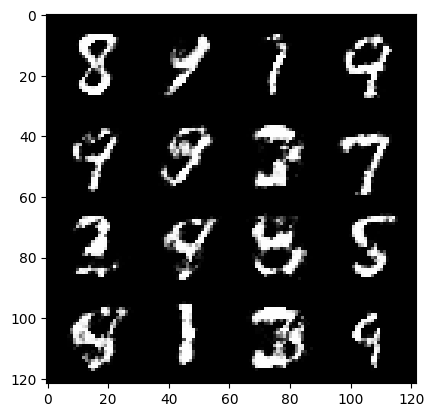

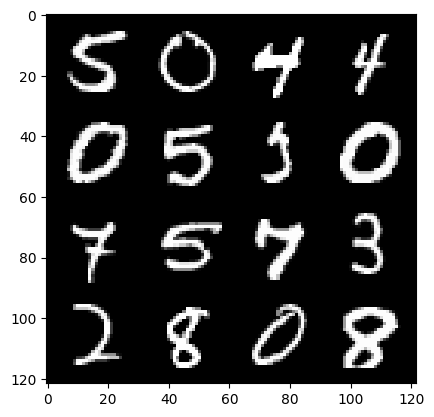

262:step 123300 / Gen loss: 1.1839913376172384 / Disc loss: 0.4971815675497057


  0%|          | 0/469 [00:00<?, ?it/s]

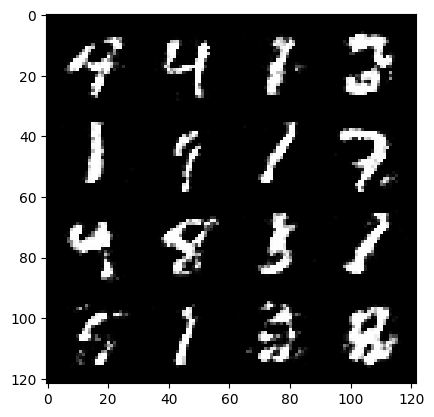

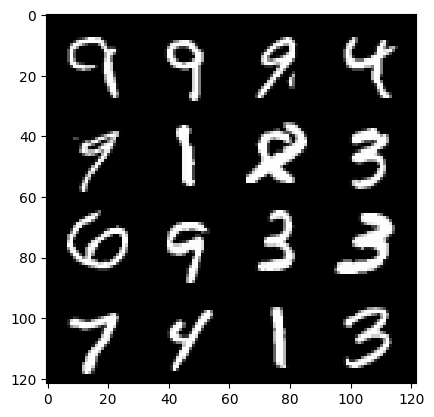

263:step 123600 / Gen loss: 1.172458349466323 / Disc loss: 0.49552007873853043


  0%|          | 0/469 [00:00<?, ?it/s]

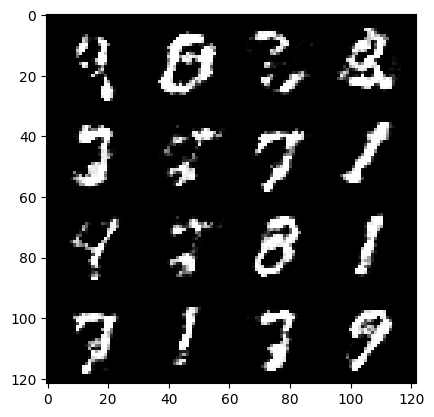

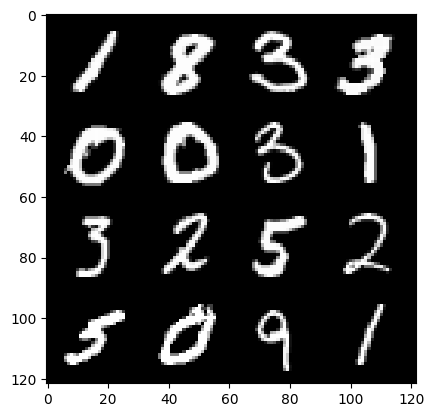

264:step 123900 / Gen loss: 1.2535138241449988 / Disc loss: 0.4639776063958803


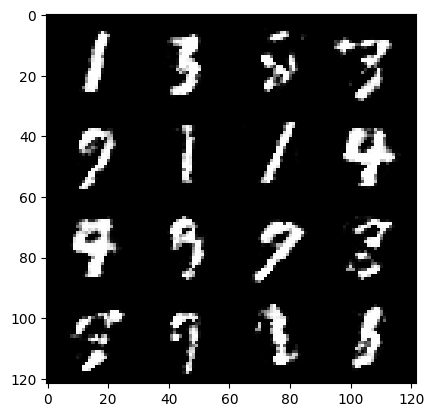

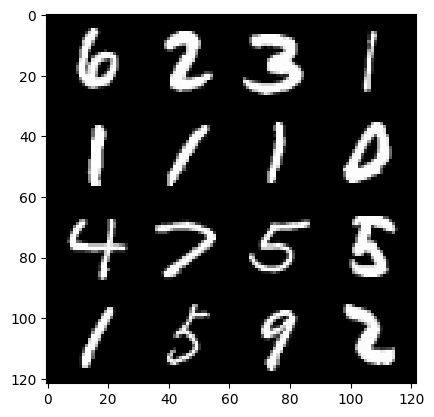

264:step 124200 / Gen loss: 1.2482658270994824 / Disc loss: 0.45957844893137634


  0%|          | 0/469 [00:00<?, ?it/s]

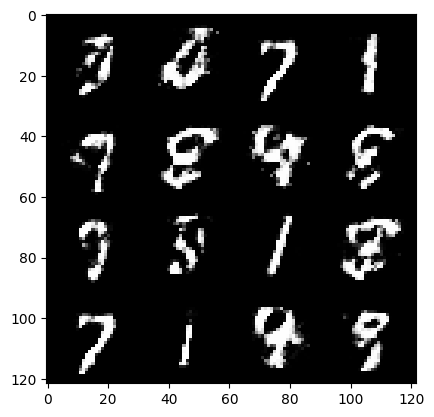

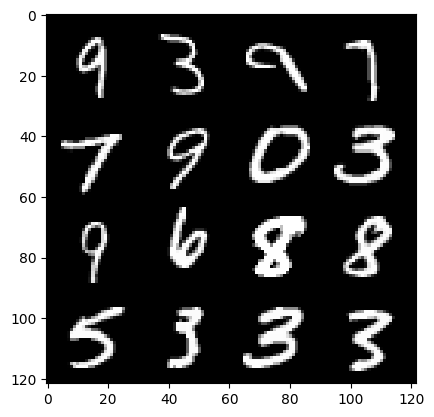

265:step 124500 / Gen loss: 1.2339167682329808 / Disc loss: 0.4758114125331243


  0%|          | 0/469 [00:00<?, ?it/s]

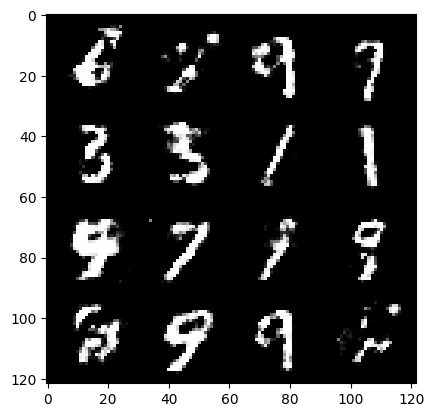

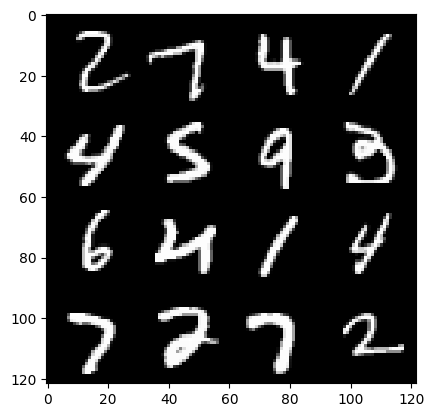

266:step 124800 / Gen loss: 1.2329286364714311 / Disc loss: 0.47868606120347973


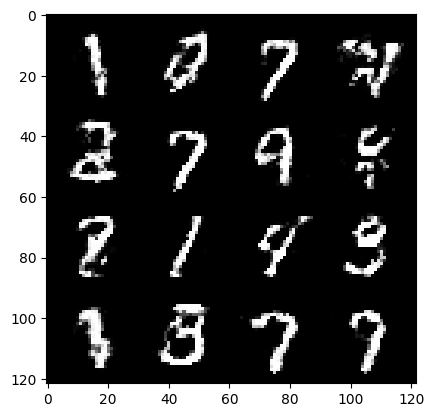

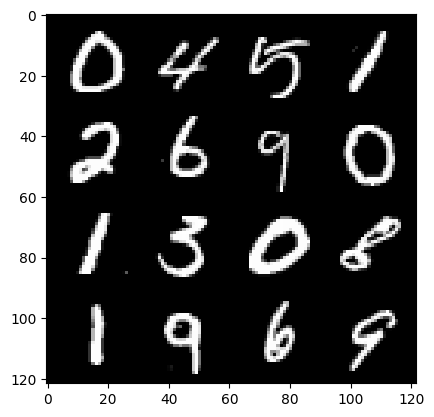

266:step 125100 / Gen loss: 1.1025854019323986 / Disc loss: 0.5157263004779815


  0%|          | 0/469 [00:00<?, ?it/s]

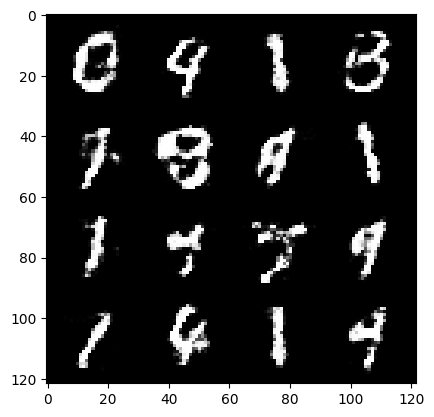

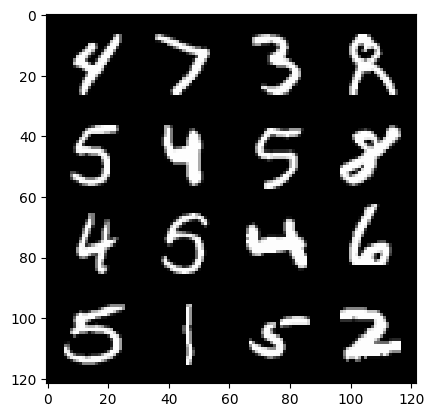

267:step 125400 / Gen loss: 1.1970409635702768 / Disc loss: 0.48491040289402026


  0%|          | 0/469 [00:00<?, ?it/s]

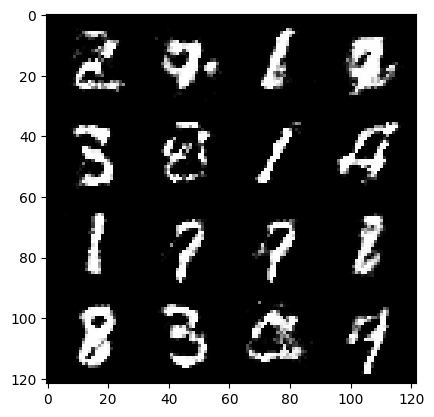

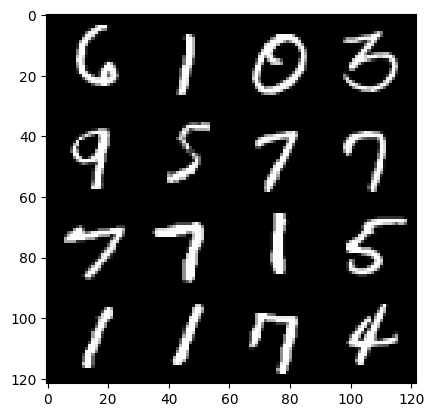

268:step 125700 / Gen loss: 1.182259434858957 / Disc loss: 0.49554298301537847


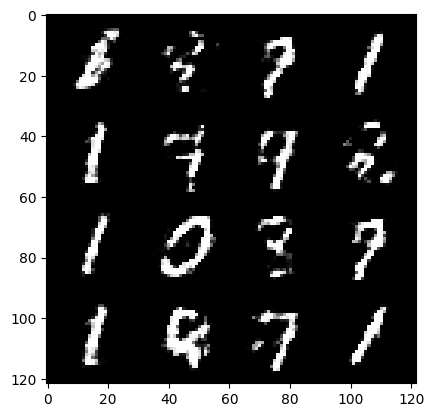

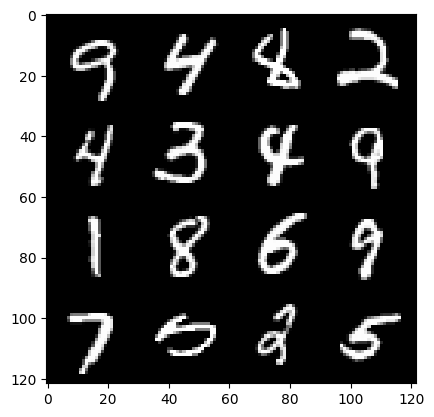

268:step 126000 / Gen loss: 1.204331619143486 / Disc loss: 0.4846882769465443


  0%|          | 0/469 [00:00<?, ?it/s]

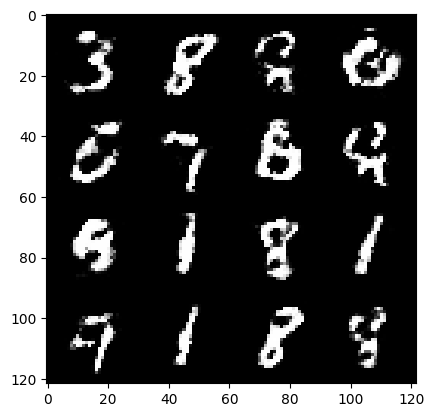

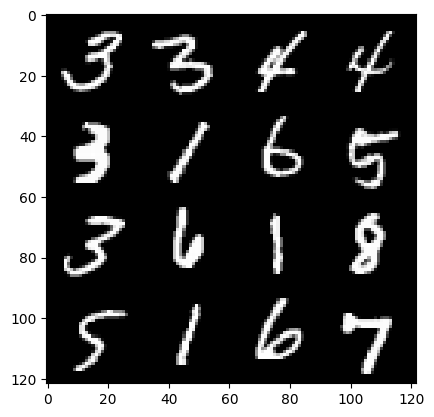

269:step 126300 / Gen loss: 1.201399364074071 / Disc loss: 0.4840893008311591


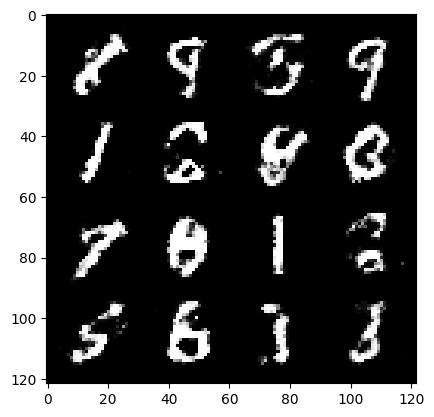

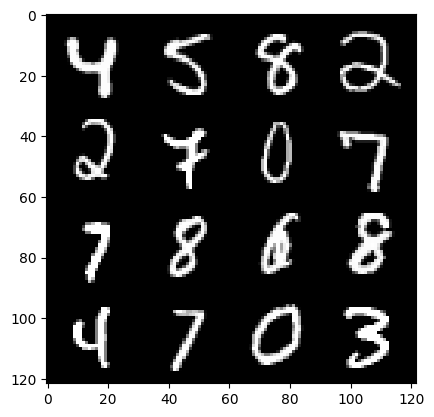

269:step 126600 / Gen loss: 1.1549885064363479 / Disc loss: 0.5022109500567118


  0%|          | 0/469 [00:00<?, ?it/s]

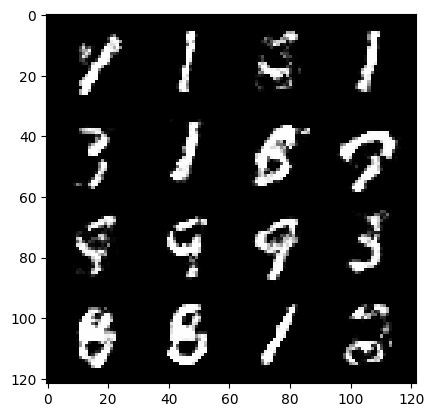

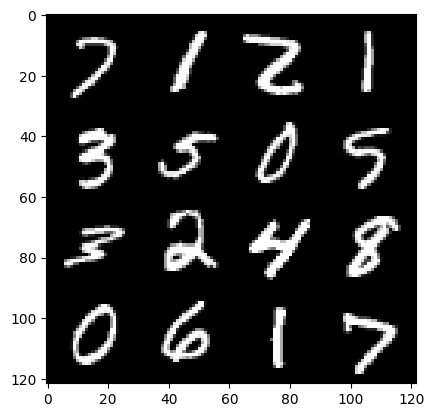

270:step 126900 / Gen loss: 1.1457210592428848 / Disc loss: 0.5061184126138689


  0%|          | 0/469 [00:00<?, ?it/s]

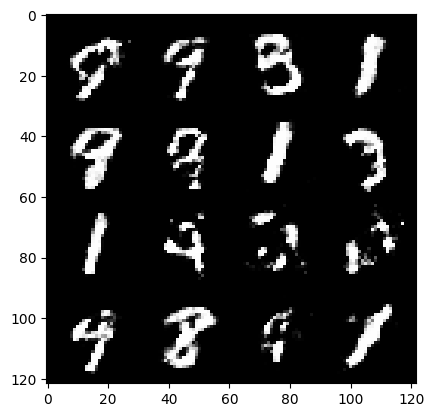

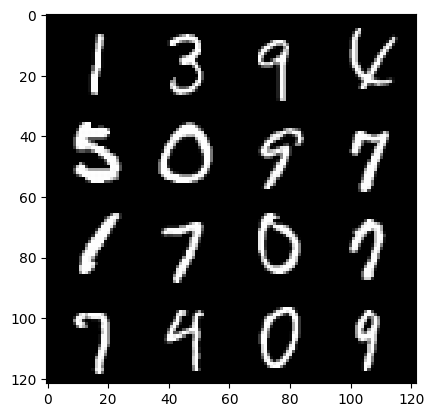

271:step 127200 / Gen loss: 1.161930632193883 / Disc loss: 0.49655997604131735


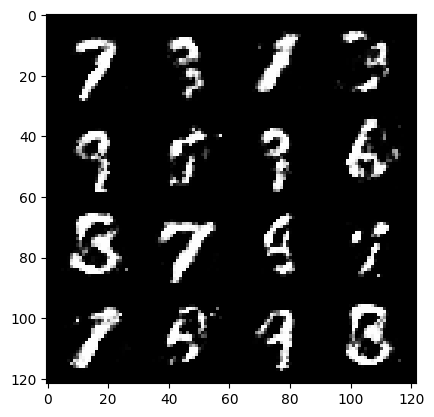

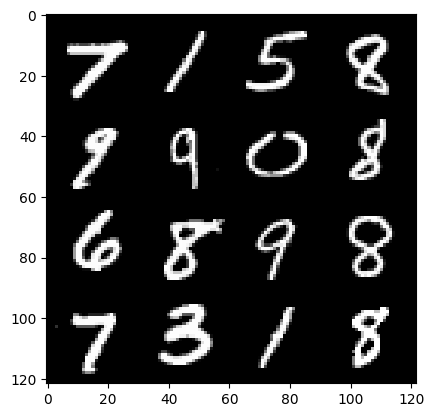

271:step 127500 / Gen loss: 1.2152252980073286 / Disc loss: 0.4869501615564024


  0%|          | 0/469 [00:00<?, ?it/s]

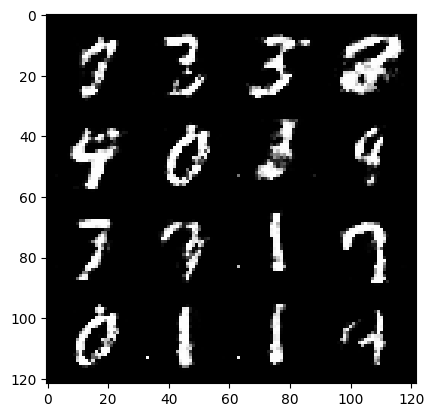

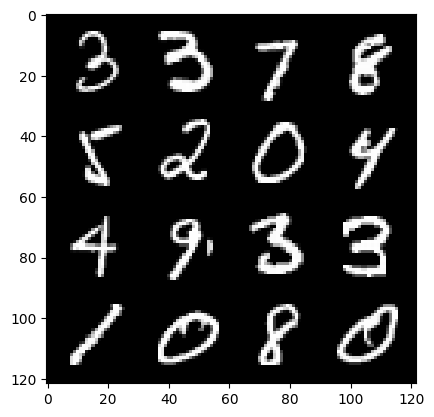

272:step 127800 / Gen loss: 1.1905038472016658 / Disc loss: 0.4964954263965289


  0%|          | 0/469 [00:00<?, ?it/s]

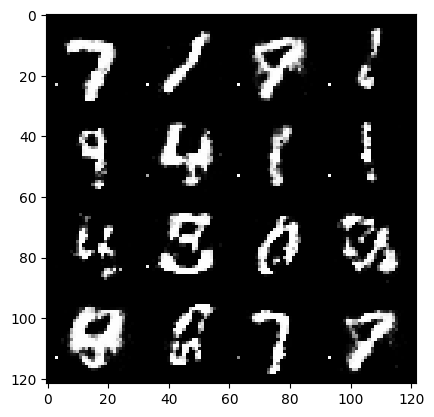

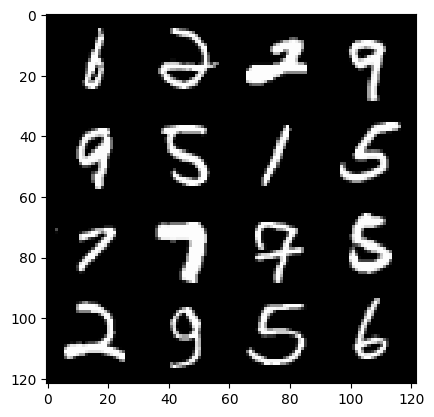

273:step 128100 / Gen loss: 0.7836630962292349 / Disc loss: 0.7209980706373852


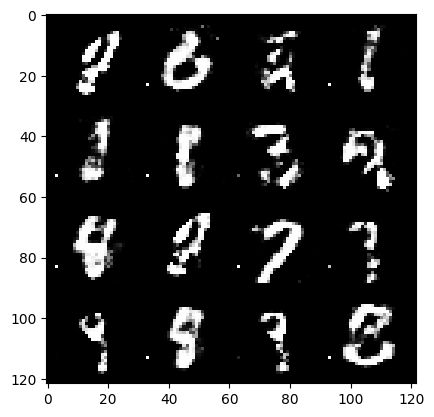

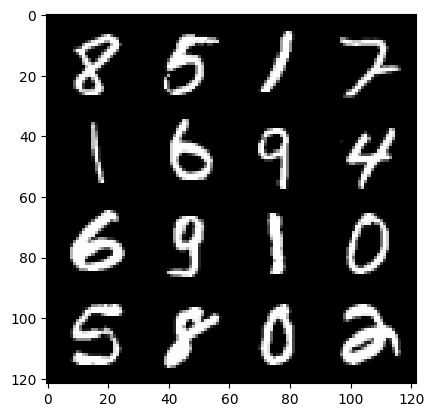

273:step 128400 / Gen loss: 0.7718241161108017 / Disc loss: 0.6532372423013053


  0%|          | 0/469 [00:00<?, ?it/s]

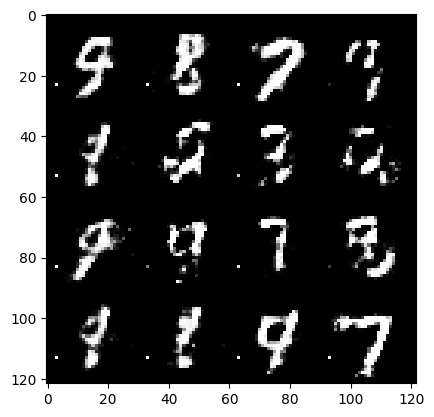

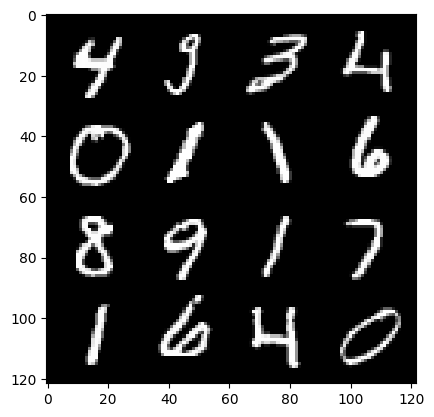

274:step 128700 / Gen loss: 0.8779546387990317 / Disc loss: 0.5659940944115323


  0%|          | 0/469 [00:00<?, ?it/s]

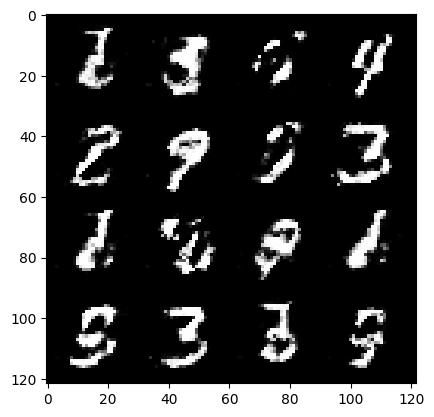

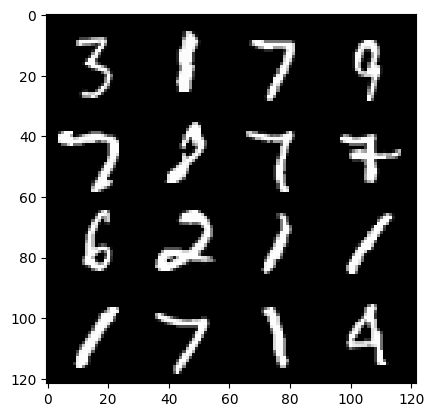

275:step 129000 / Gen loss: 1.0548112863302228 / Disc loss: 0.4962861539920172


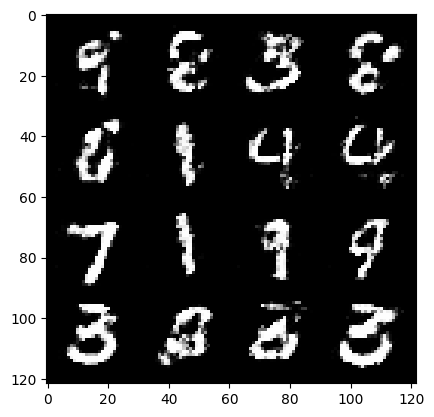

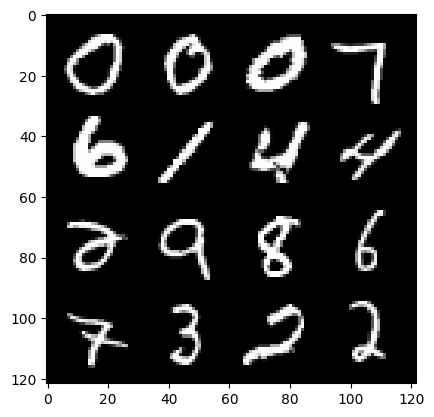

275:step 129300 / Gen loss: 1.1697867810726161 / Disc loss: 0.5102154824137688


  0%|          | 0/469 [00:00<?, ?it/s]

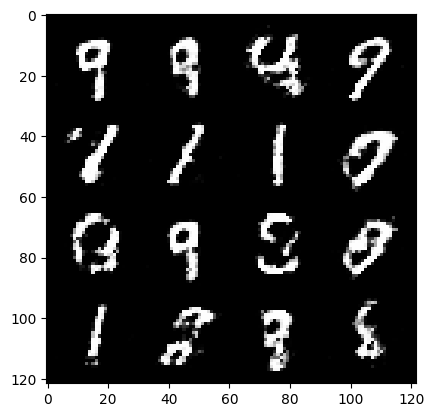

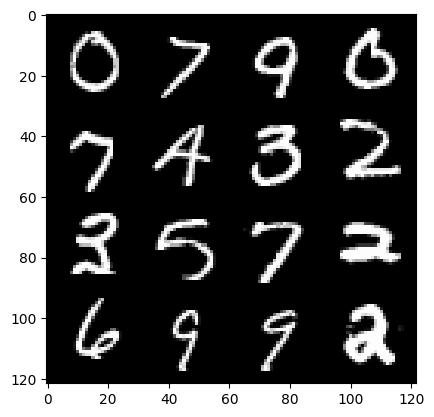

276:step 129600 / Gen loss: 1.1286472888787589 / Disc loss: 0.517883538504442


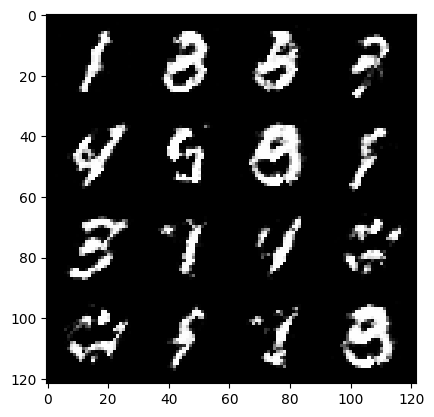

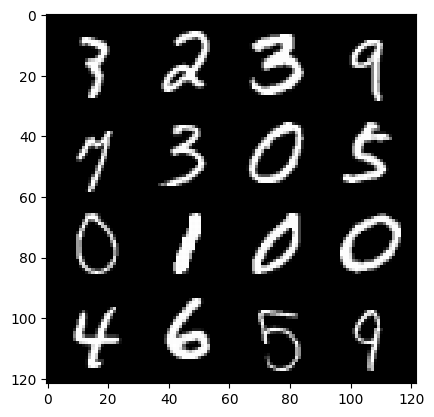

276:step 129900 / Gen loss: 1.1777773569027585 / Disc loss: 0.4949445125460628


  0%|          | 0/469 [00:00<?, ?it/s]

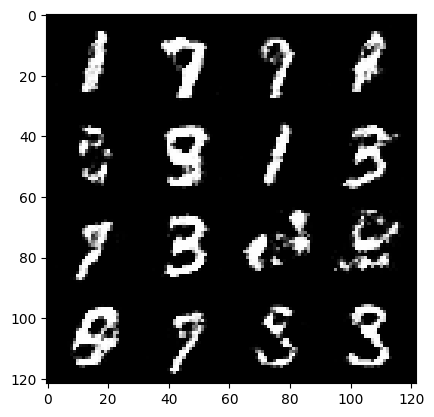

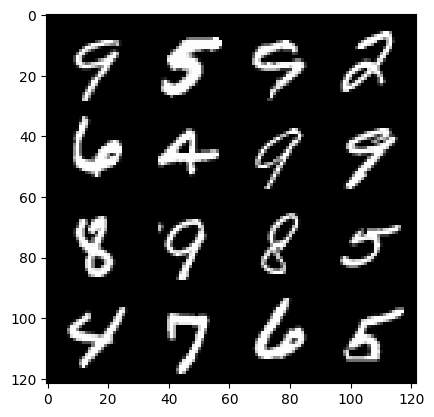

277:step 130200 / Gen loss: 1.2009651764233915 / Disc loss: 0.48095119297504446


  0%|          | 0/469 [00:00<?, ?it/s]

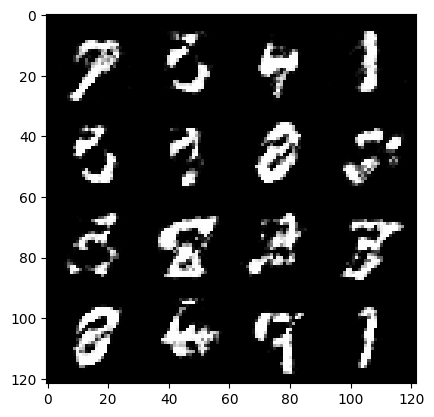

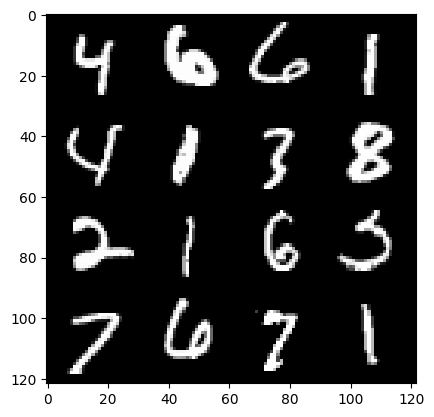

278:step 130500 / Gen loss: 1.2215686666965484 / Disc loss: 0.47584332446257277


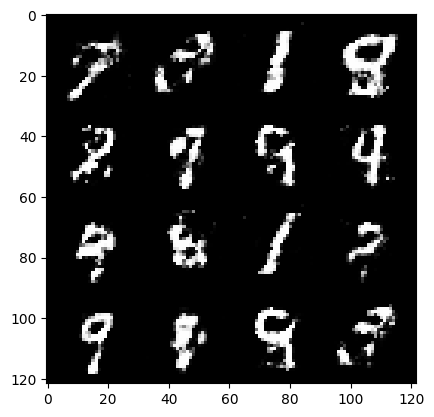

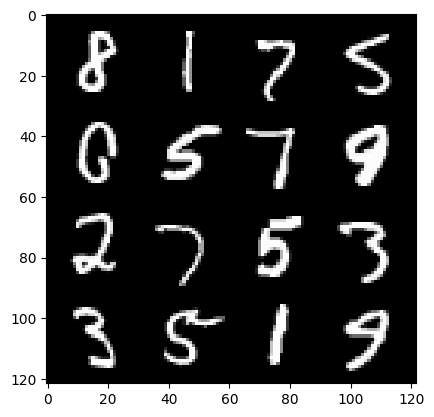

278:step 130800 / Gen loss: 1.2717775269349418 / Disc loss: 0.4601404725511869


  0%|          | 0/469 [00:00<?, ?it/s]

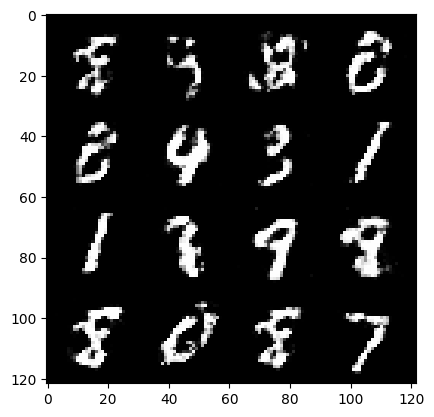

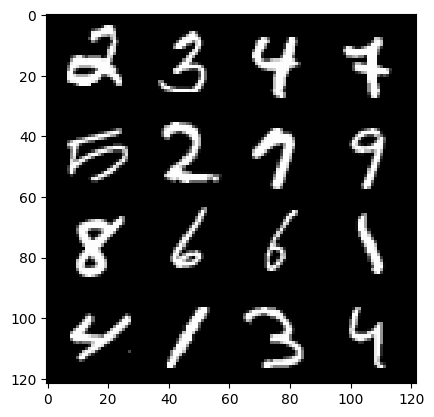

279:step 131100 / Gen loss: 1.2691956158479052 / Disc loss: 0.470269968310992


  0%|          | 0/469 [00:00<?, ?it/s]

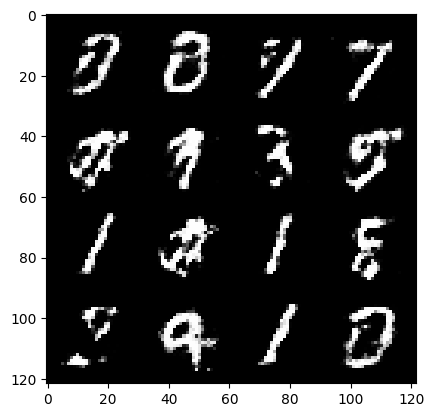

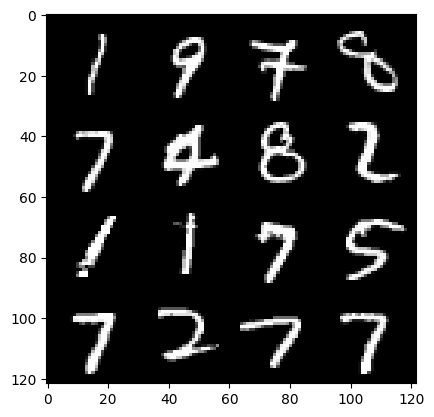

280:step 131400 / Gen loss: 1.2331724735101077 / Disc loss: 0.4816995592912037


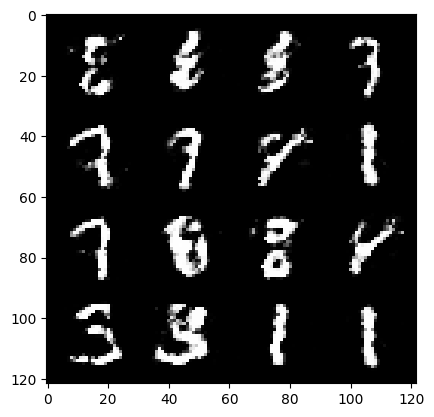

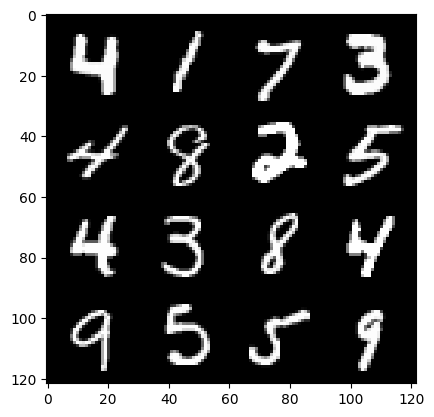

280:step 131700 / Gen loss: 1.2539935016632093 / Disc loss: 0.4700540511806808


  0%|          | 0/469 [00:00<?, ?it/s]

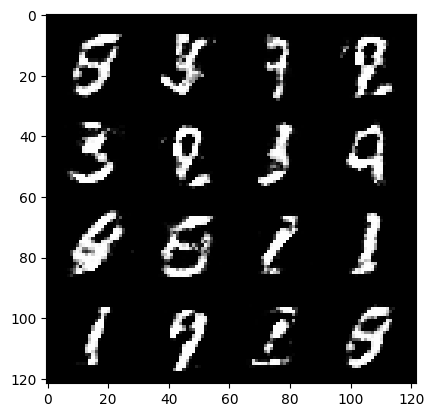

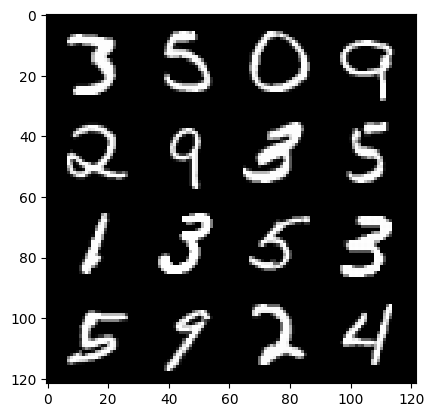

281:step 132000 / Gen loss: 1.2255394099156058 / Disc loss: 0.4720573122302688


  0%|          | 0/469 [00:00<?, ?it/s]

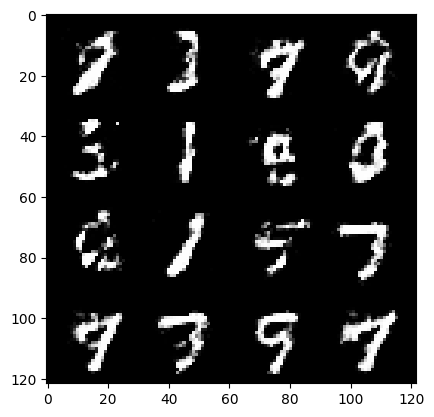

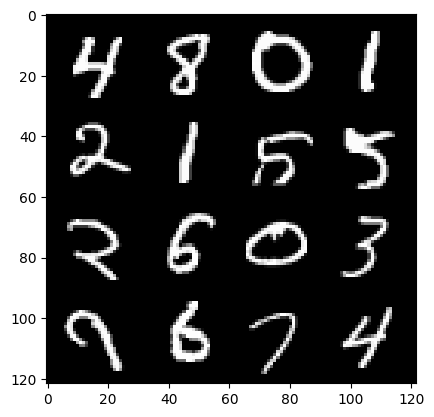

282:step 132300 / Gen loss: 1.2790362501144414 / Disc loss: 0.4704332831501961


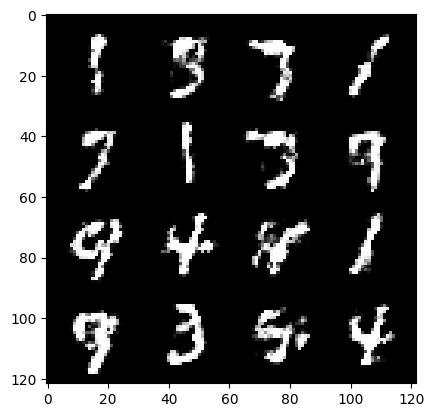

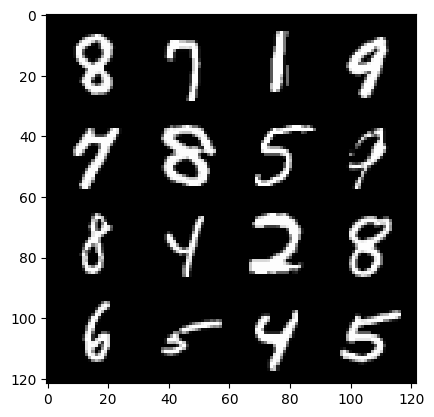

282:step 132600 / Gen loss: 1.2666576198736814 / Disc loss: 0.46940229326486593


  0%|          | 0/469 [00:00<?, ?it/s]

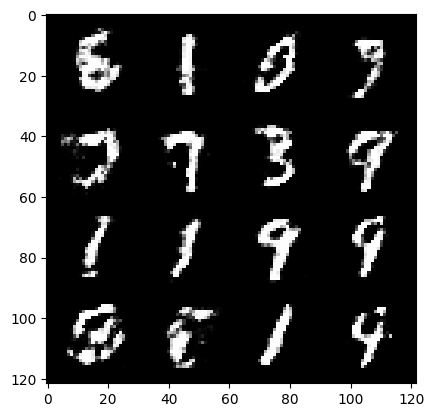

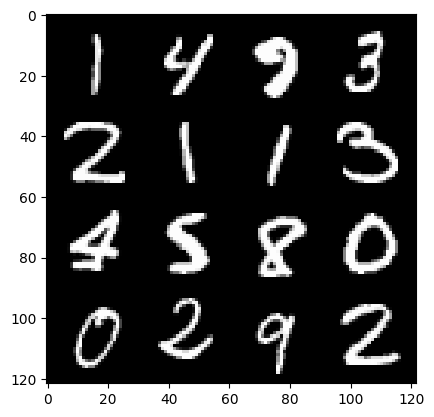

283:step 132900 / Gen loss: 1.2504973769187924 / Disc loss: 0.48041431893904996


  0%|          | 0/469 [00:00<?, ?it/s]

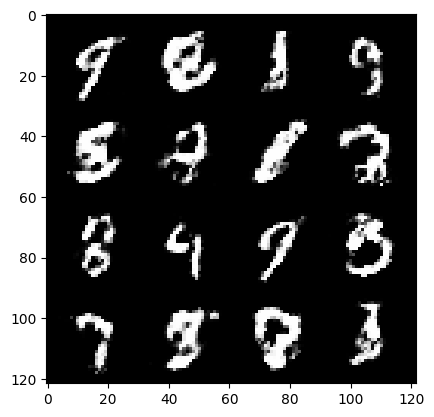

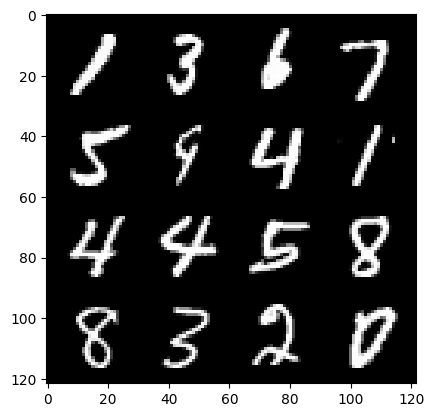

284:step 133200 / Gen loss: 1.2529712200164798 / Disc loss: 0.47821269363164887


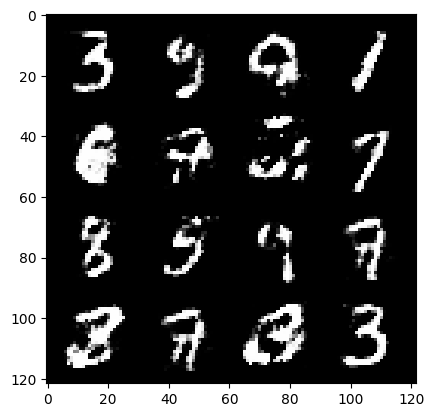

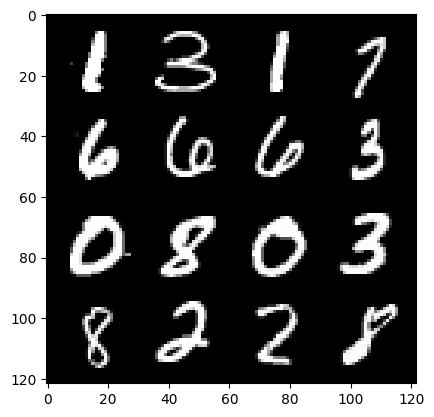

284:step 133500 / Gen loss: 1.2494205188751217 / Disc loss: 0.4696556239326796


  0%|          | 0/469 [00:00<?, ?it/s]

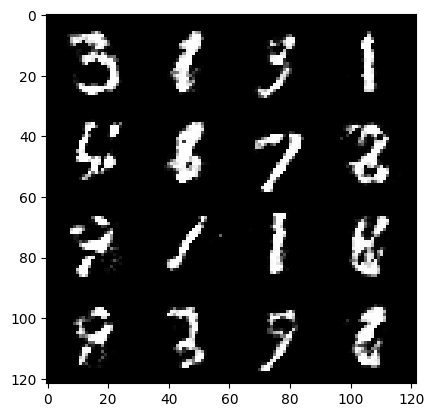

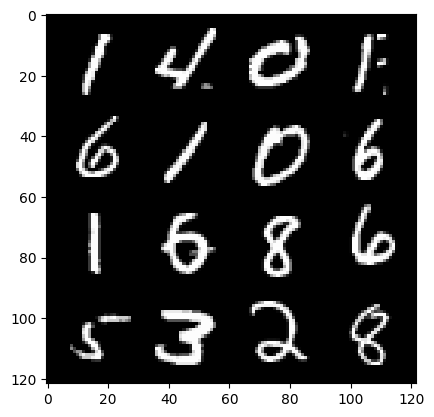

285:step 133800 / Gen loss: 1.2717539548873897 / Disc loss: 0.46260431100924815


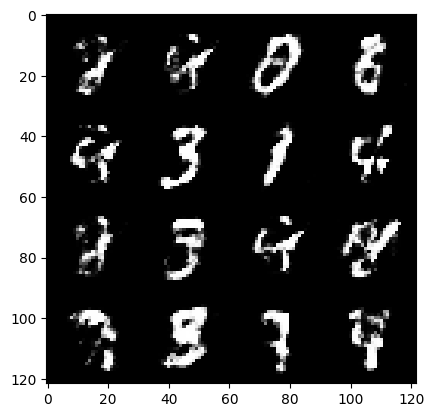

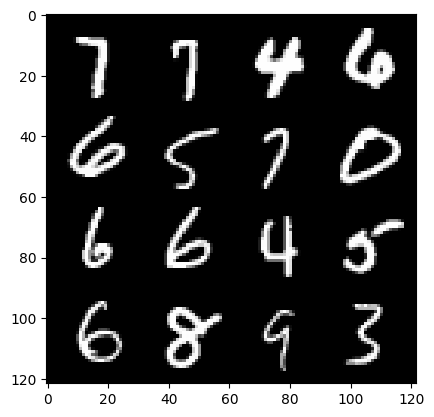

285:step 134100 / Gen loss: 1.2918748593330383 / Disc loss: 0.44939422061045975


  0%|          | 0/469 [00:00<?, ?it/s]

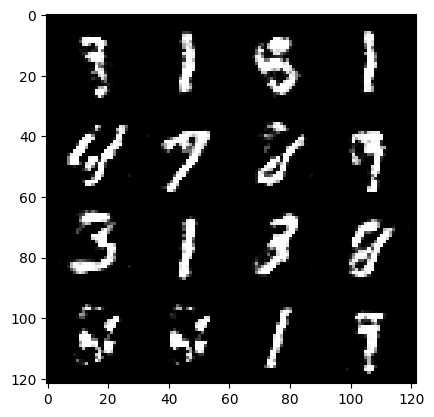

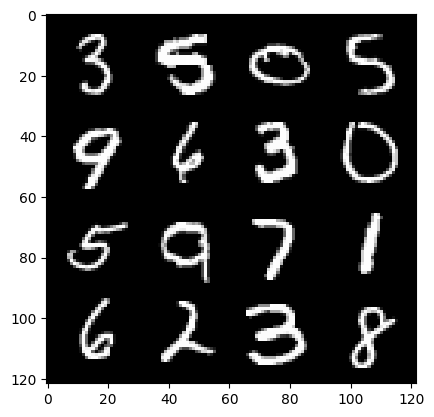

286:step 134400 / Gen loss: 1.279629116853078 / Disc loss: 0.4596642227967581


  0%|          | 0/469 [00:00<?, ?it/s]

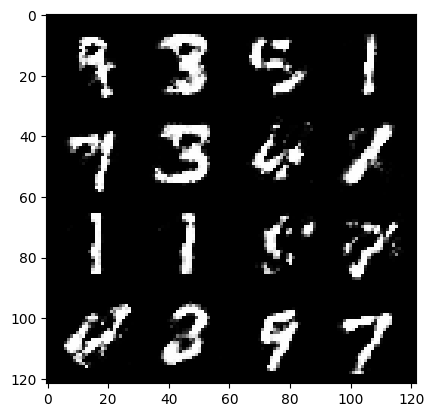

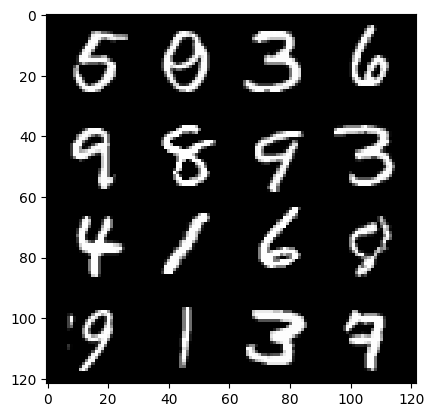

287:step 134700 / Gen loss: 1.2529521101713181 / Disc loss: 0.4656203771630923


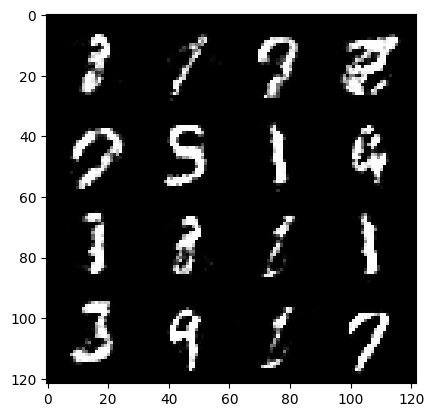

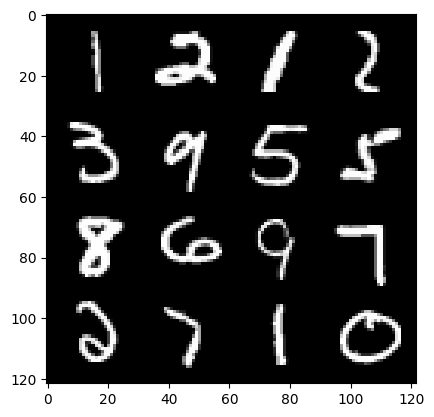

287:step 135000 / Gen loss: 1.219501663049062 / Disc loss: 0.47166572431723275


  0%|          | 0/469 [00:00<?, ?it/s]

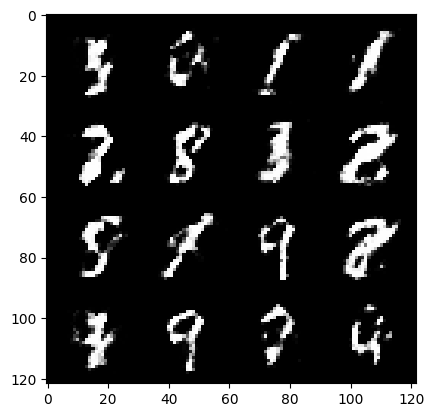

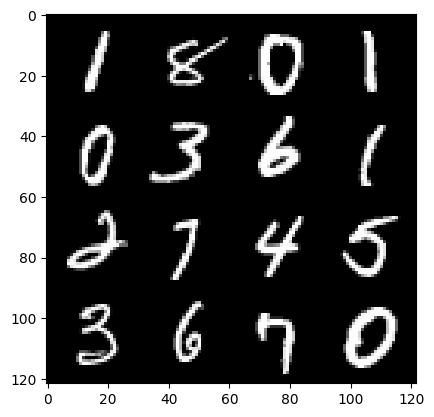

288:step 135300 / Gen loss: 1.1823555650313688 / Disc loss: 0.4821883353590965


  0%|          | 0/469 [00:00<?, ?it/s]

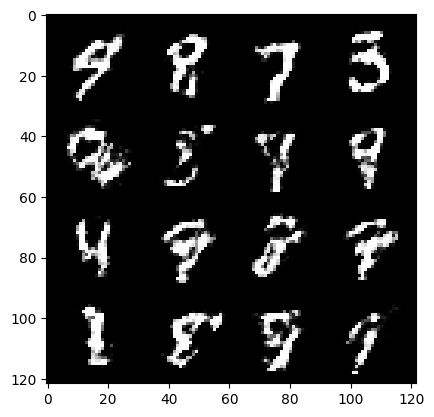

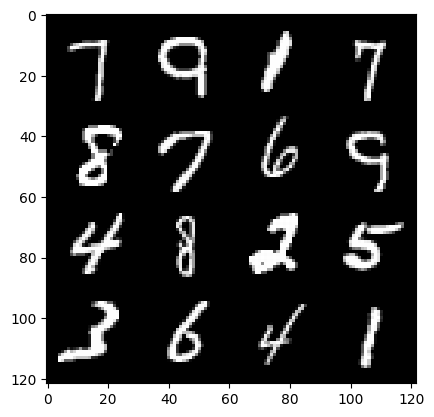

289:step 135600 / Gen loss: 1.228489157557487 / Disc loss: 0.4747830468416215


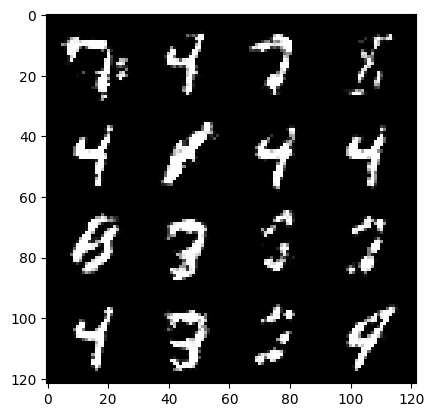

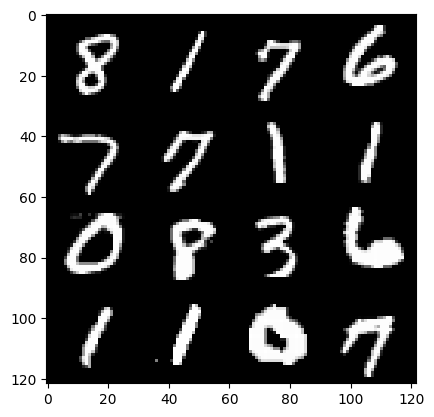

289:step 135900 / Gen loss: 1.292093730767568 / Disc loss: 0.4543952798843387


  0%|          | 0/469 [00:00<?, ?it/s]

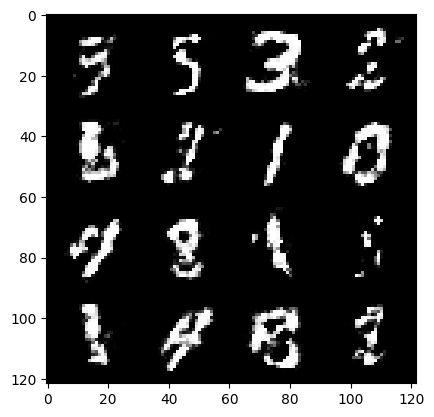

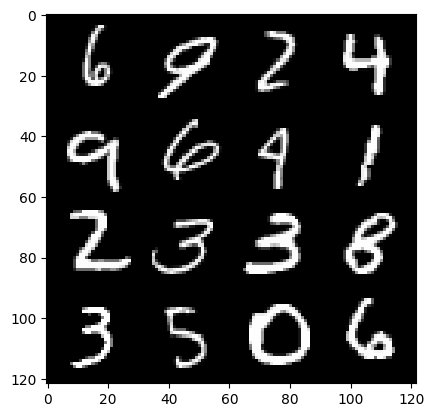

290:step 136200 / Gen loss: 1.2830566887060797 / Disc loss: 0.4553359275062877


  0%|          | 0/469 [00:00<?, ?it/s]

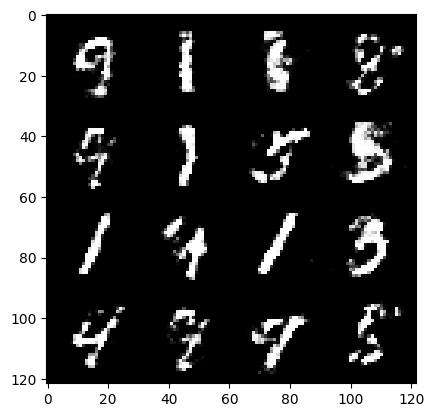

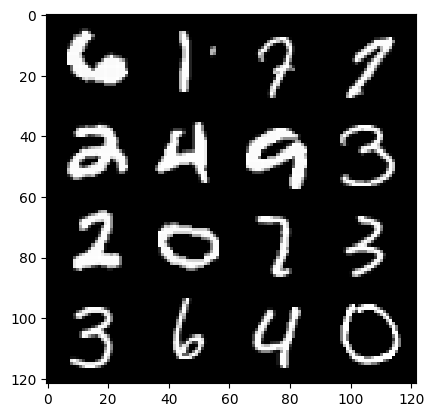

291:step 136500 / Gen loss: 1.2293529852231344 / Disc loss: 0.47128681421279917


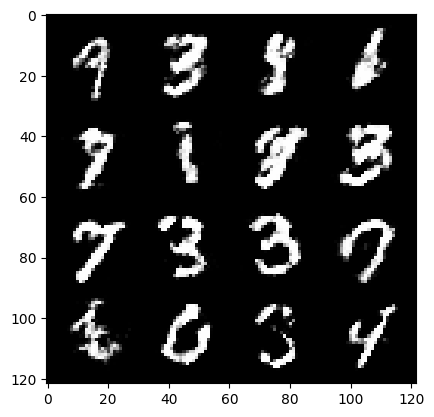

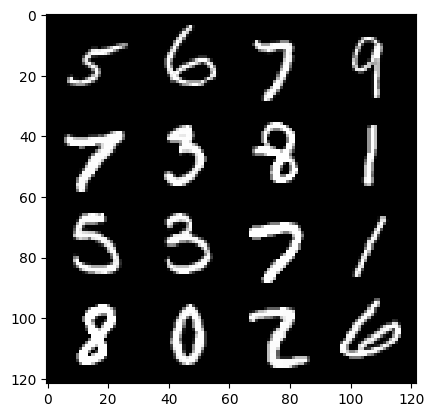

291:step 136800 / Gen loss: 1.2167669590314238 / Disc loss: 0.47149373004833856


  0%|          | 0/469 [00:00<?, ?it/s]

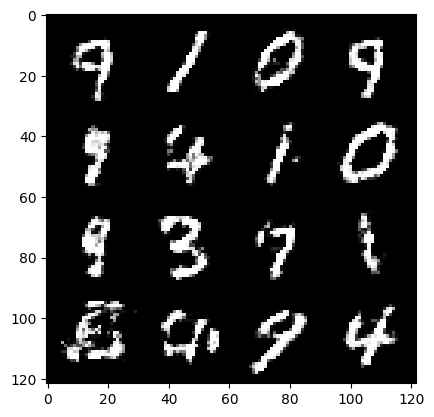

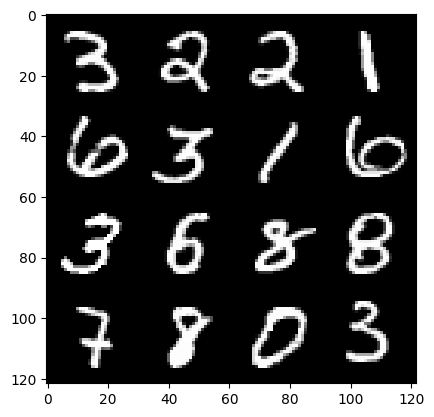

292:step 137100 / Gen loss: 1.2144063552220672 / Disc loss: 0.47507085969050744


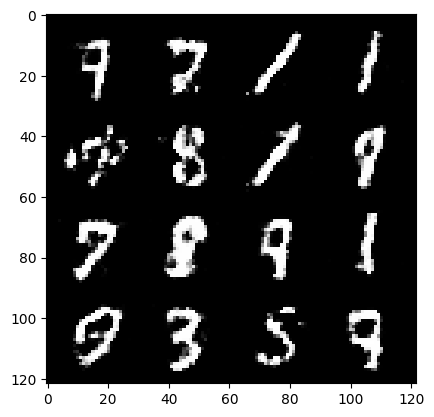

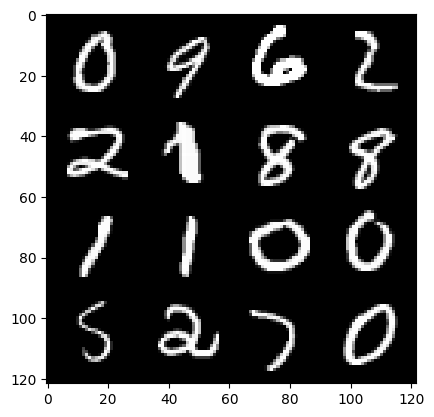

292:step 137400 / Gen loss: 1.238002236684164 / Disc loss: 0.47643220156431193


  0%|          | 0/469 [00:00<?, ?it/s]

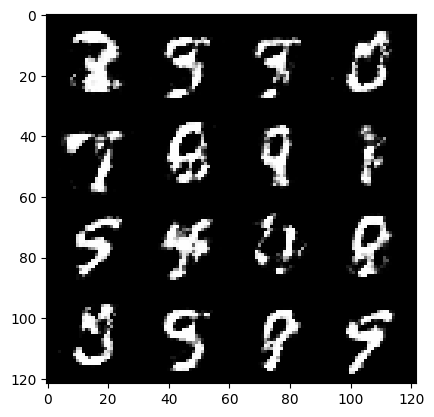

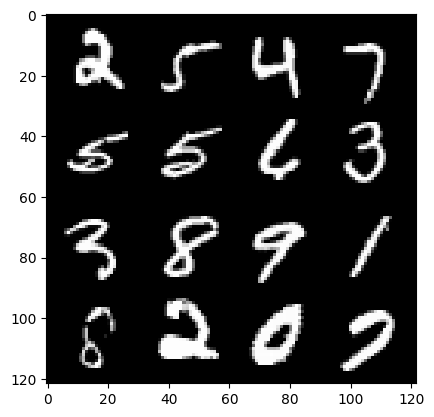

293:step 137700 / Gen loss: 1.2056702613830554 / Disc loss: 0.48694007138411183


  0%|          | 0/469 [00:00<?, ?it/s]

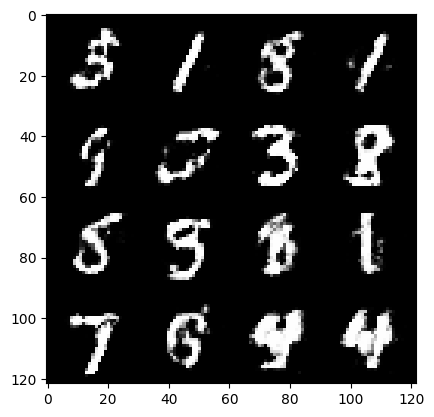

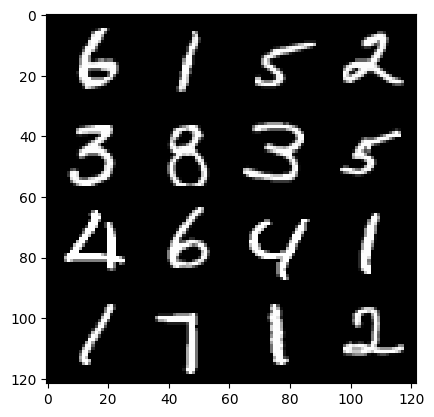

294:step 138000 / Gen loss: 1.2159392452239992 / Disc loss: 0.4815436297655108


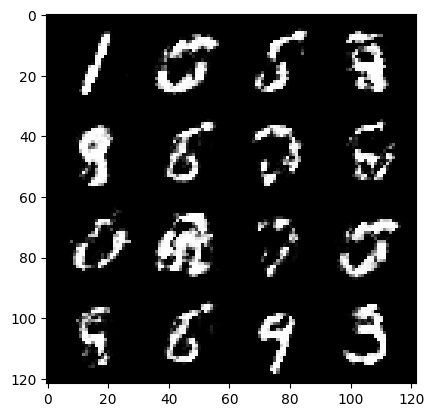

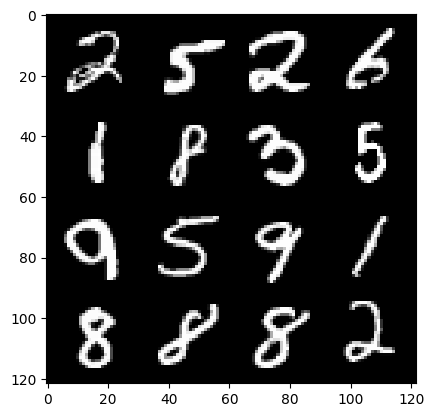

294:step 138300 / Gen loss: 1.278637877305348 / Disc loss: 0.47034489562114074


  0%|          | 0/469 [00:00<?, ?it/s]

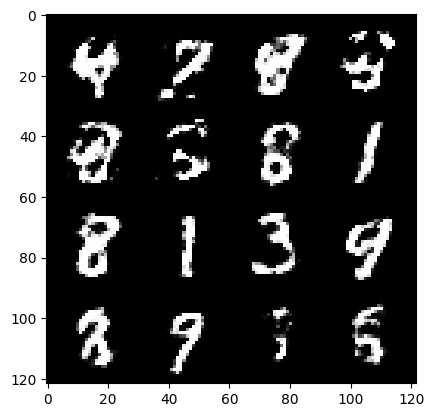

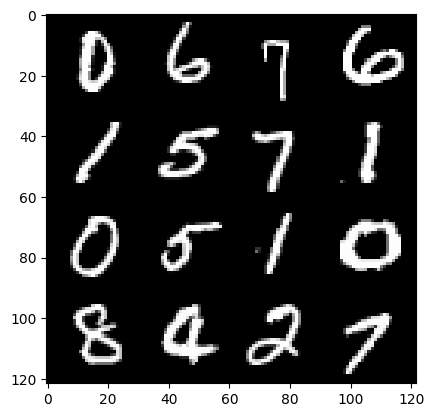

295:step 138600 / Gen loss: 1.2984341033299762 / Disc loss: 0.4650194884339967


  0%|          | 0/469 [00:00<?, ?it/s]

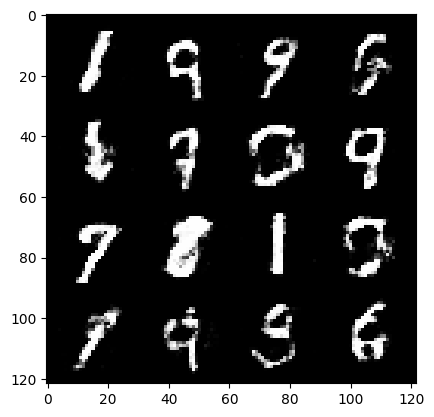

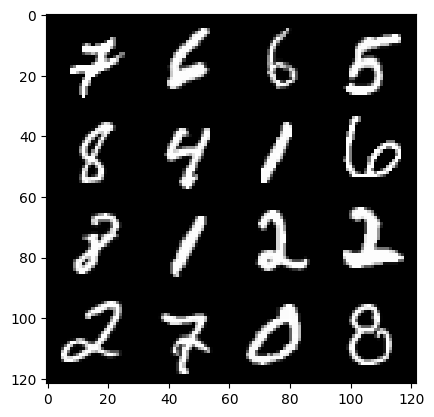

296:step 138900 / Gen loss: 1.2584466775258385 / Disc loss: 0.47842635889848056


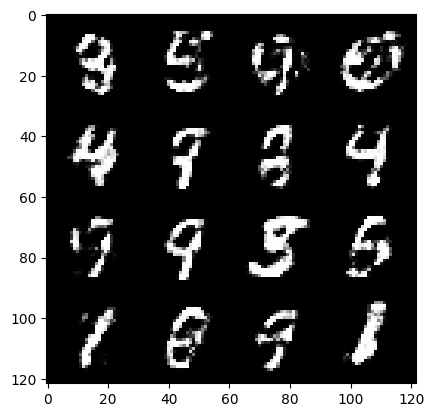

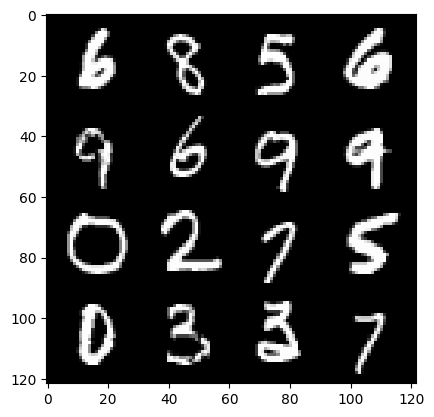

296:step 139200 / Gen loss: 1.2417849014202746 / Disc loss: 0.4770712714393934


  0%|          | 0/469 [00:00<?, ?it/s]

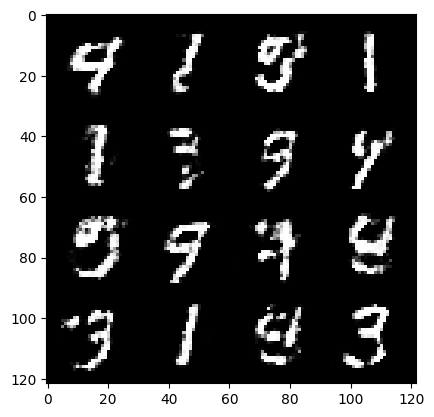

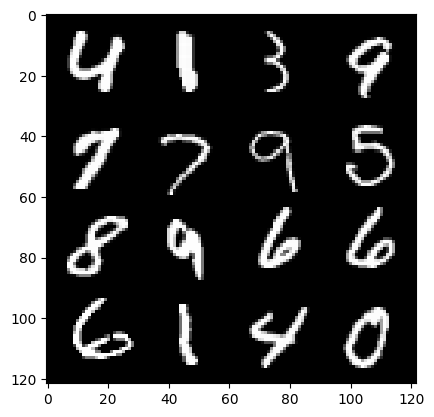

297:step 139500 / Gen loss: 1.1963134479522703 / Disc loss: 0.48104788432518597


  0%|          | 0/469 [00:00<?, ?it/s]

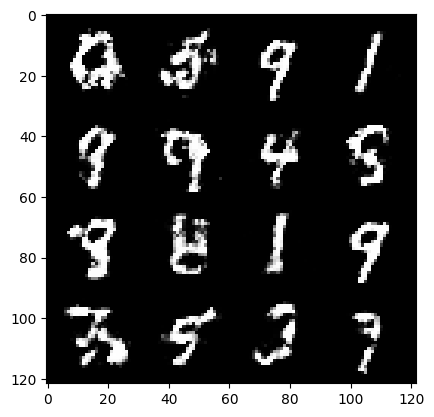

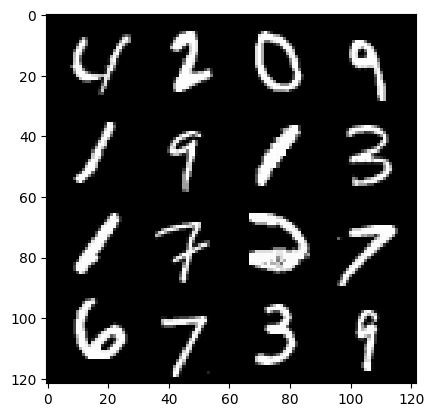

298:step 139800 / Gen loss: 1.2188471361001332 / Disc loss: 0.48079078644514106


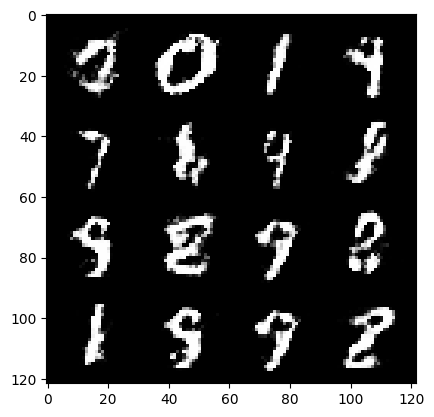

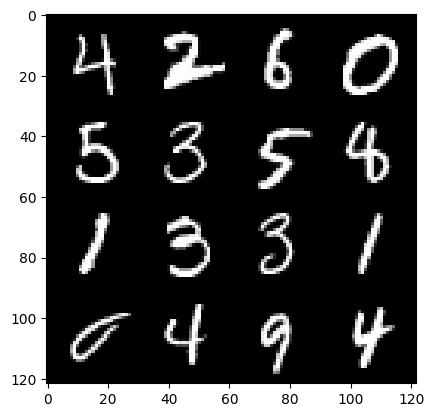

298:step 140100 / Gen loss: 1.183987638552983 / Disc loss: 0.5022070435682929


  0%|          | 0/469 [00:00<?, ?it/s]

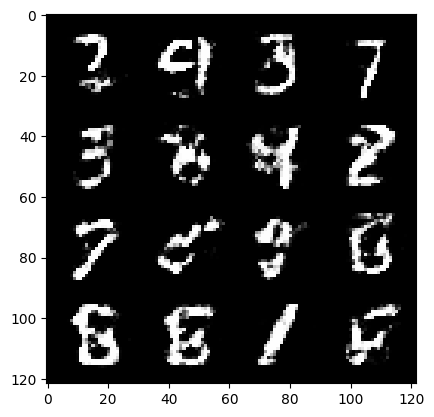

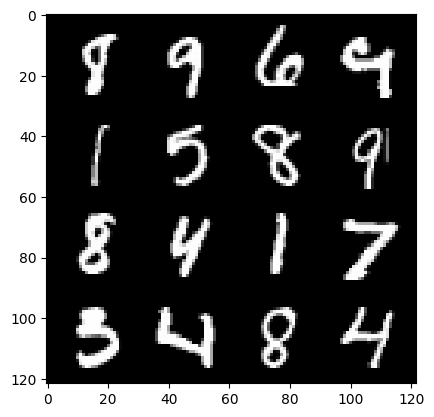

299:step 140400 / Gen loss: 1.1886657536029819 / Disc loss: 0.4899966563781101


In [12]:
### 60000 / 128 = 468.75  = 469 steps in each epoch
### Each step is going to process 128 images = size of the batch (except the last step)

for epoch in range(epochs):
  for real, _ in tqdm(dataloader):
    ### discriminator
    disc_opt.zero_grad()

    cur_bs=len(real) # real: 128 x 1 x 28 x 28
    real = real.view(cur_bs, -1) # 128 x 784
    real = real.to(device)

    disc_loss = calc_disc_loss(loss_func,gen,disc,cur_bs,real,z_dim)
    disc_loss.backward(retain_graph=True)
    disc_opt.step()

    ### generator
    gen_opt.zero_grad()
    gen_loss = calc_gen_loss(loss_func,gen,disc,cur_bs,z_dim)
    gen_loss.backward(retain_graph=True)
    gen_opt.step()

    ### visualization & stats
    mean_disc_loss+=disc_loss.item()/info_step
    mean_gen_loss+=gen_loss.item()/info_step
    
    if cur_step % info_step == 0 and cur_step >0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}:step {cur_step} / Gen loss: {mean_gen_loss} / Disc loss: {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss = 0, 0
    cur_step += 1
    


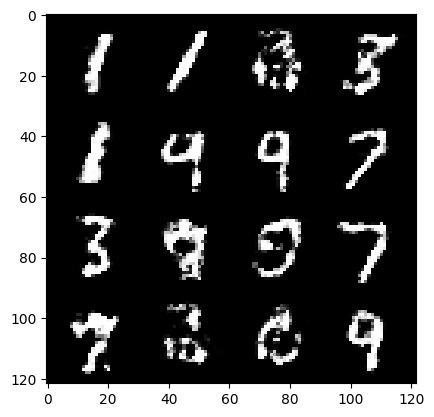

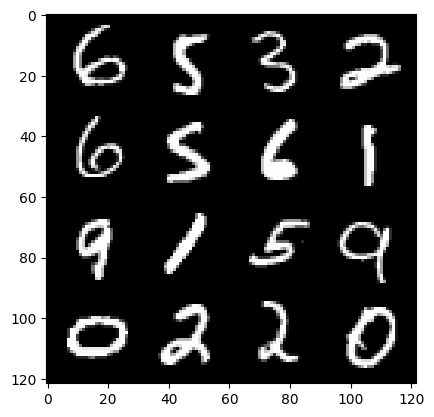

299:step 140700 / Gen loss: 1.213241412242254 / Disc loss: 0.4797172273198762


In [14]:
# final Generator check
fake_noise = gen_noise(cur_bs, z_dim)
fake = gen(fake_noise)
show(fake)
show(real)
print(f"{epoch}:step {cur_step} / Gen loss: {mean_gen_loss} / Disc loss: {mean_disc_loss}")